### BADASS Analysis: NASH (nonalcoholic fatty liver disease) - 2 classes

Can we train an ML model to distinguish between serum samples from two different classes of patient (patients with and without NASH (nonalcoholic fatty liver disease))? And can the model successfully classify samples from patients it has not seen during training?

(In this dataset, include single (median) reading for each patient.)

#### Analytes

Normal:
- Patient 1
- Patient 2
- Patient 3
- Patient 4
- Patient 5
- Patient 6
- Patient 7
- Patient 8
- Patient 9
- Patient 10
- Patient 11
- Patient 12
- Patient 13
- Patient 14
- Patient 29
- Patient 30
- Patient 31
- Patient 32
- Patient 33
- Patient 34
- Patient 35
- Patient 36
- Patient 37
- Patient 38
- Patient 39
- Patient 40
- Patient 41
- Patient 42

NASH:
- Patient 15
- Patient 16
- Patient 17
- Patient 18
- Patient 19
- Patient 20
- Patient 21
- Patient 22
- Patient 23
- Patient 24
- Patient 25
- Patient 26
- Patient 27
- Patient 28

Note that whilst the NASH patients definitely have NASH, the "normal" patients have not been tested to see if they also have NASH or not. Both sets of patients also have a range of other medical conditions (e.g. all of the NASH patients, and half of the "Normal" patients, have CAD (coronary artery disease)). Consequently, in spite of merging the original CAD and Normal classes into a single "Normal" class in this current analysis, these two new classes remain noisy, and this is likely to be reflected in the results!

In [1]:
# Import from array_sensing package
from subroutines.parse_array_data import ParseArrayData
from subroutines.train import RunML, draw_conf_matrices

In [2]:
import copy
import math
import os
import pickle
import random
import shutil
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from collections import OrderedDict
from IPython.display import display
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.dummy import DummyClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.metrics import (
    accuracy_score, recall_score, precision_score, f1_score, make_scorer
)
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import LinearSVC, SVC

%matplotlib inline
plt.rcParams['figure.figsize'] = (10, 10)  # Sets default figure size

#### Parse in input data

NASH data (large array)

In [3]:
nash_fluor_data = ParseArrayData(
    data_dirs_dict={'DPH': '/home/ks17361/ML_environment/BADASS/NASH_serum_data/'
                           'Reformatted_csvs_2_classes_split_illness/'},
    results_dir='/home/ks17361/ML_environment/BADASS/NASH_serum_analysis/NASH_2_classes_split_illness/'
                'NASH_plate_parsing_plots/',
    repeat_labels_list=['repeat_1', 'repeat_2', 'repeat_3', 'repeat_4', 'repeat_5', 'repeat_6', 'repeat_7',
                        'repeat_8', 'repeat_9', 'repeat_10', 'repeat_11', 'repeat_12', 'repeat_13', 'repeat_14',
                        'repeat_15', 'repeat_16', 'repeat_17', 'repeat_18', 'repeat_19', 'repeat_20', 'repeat_21',
                        'repeat_22', 'repeat_23', 'repeat_24', 'repeat_25', 'repeat_26', 'repeat_27', 'repeat_28'],
    peptide_dict = {'DPH': ['No Pep','GRP46', 'GRP51', 'CCHept', 'CCHept-L14A', 'CCHept-I17A-L21A',
                            'CCHept-I17G-L21G', 'CCHept-I24A', 'CCHept-I24P', 'GRP80', 'GRP63', 'GRP52',
                            'CCHex', 'CCPent', 'NLKEIA', 'QLKEIA', 'CCHex2', 'GRP22', 'CCHept-I17H',
                            'CCHept-I17T', 'CCHept-L21H-I24H', 'CCHept-L21N-I24N', 'CCHept-L21S-I24S',
                            'CCHept-L21T-I24T', 'CCHept-I24H', 'CCHept-I24N', 'CCHept-I24S', 'CCHept-I24T',
                            'CCHept-L7K', 'CCHept-I17K', 'CCHept-I17K-I24E', 'CCHept-L21E-I24K', 'CCHept-L21K',
                            'CCHept-L21K-I24E', 'CCHept-I24D', 'CCHept-I24E', 'CCHept-I24K', 'CCHept-L28K',
                            'CCPent-I24K', 'CCHex2-I24K', 'CCHept-L7W', 'CCHept-L7Y', 'CCHept-L21S-I24Y',
                            'CCHept-L21Y-I24S', 'CCHept-I24Y', 'CCHept-L28W', 'CCHept-L28Y', 'GRP35']},
    control_peptides={'DPH': ['GRP35']},
    control_analytes=[]
)

Locate xlsx files

In [4]:
nash_fluor_data.group_xlsx_repeats()

In [5]:
nash_fluor_data.repeat_dict

OrderedDict([('repeat_1',
              OrderedDict([('DPH',
                            ['NASH_fifteenR1_repeat_1.xlsx',
                             'NASH_fifteenR2_repeat_1.xlsx',
                             'NASH_fifteenR3_repeat_1.xlsx',
                             'NASH_fifteenR4_repeat_1.xlsx',
                             'Normal_oneR1_repeat_1.xlsx',
                             'Normal_oneR2_repeat_1.xlsx',
                             'Normal_oneR3_repeat_1.xlsx',
                             'Normal_oneR4_repeat_1.xlsx'])])),
             ('repeat_2',
              OrderedDict([('DPH',
                            ['NASH_sixteenR1_repeat_2.xlsx',
                             'NASH_sixteenR2_repeat_2.xlsx',
                             'NASH_sixteenR3_repeat_2.xlsx',
                             'NASH_sixteenR4_repeat_2.xlsx',
                             'Normal_twoR1_repeat_2.xlsx',
                             'Normal_twoR2_repeat_2.xlsx',
                             'N

Read the data in each xlsx file into a dataframe and perform min-max scaling

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR1_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_fifteenR1_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

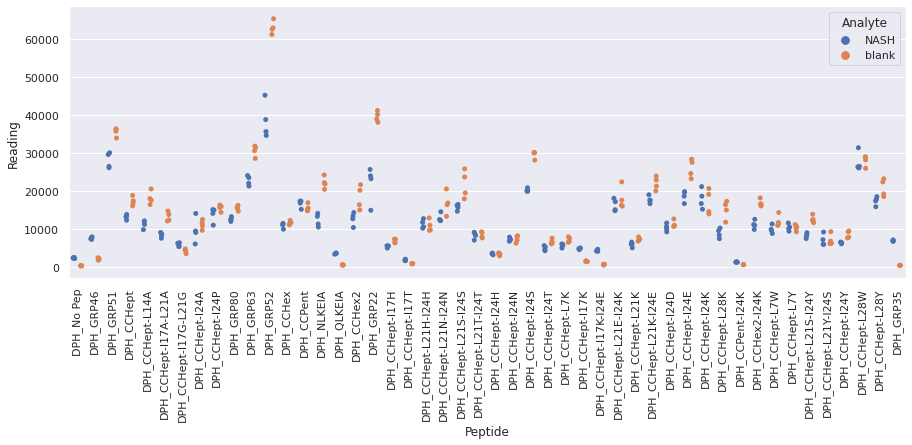

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR2_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_fifteenR2_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

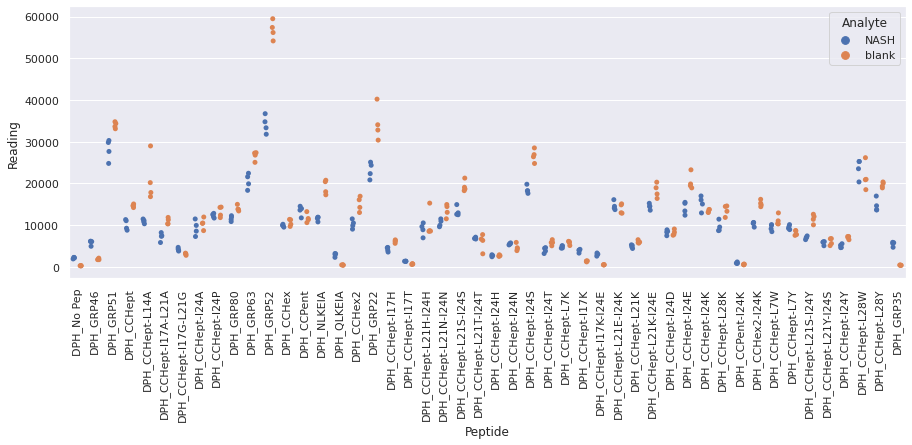

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR3_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_fifteenR3_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

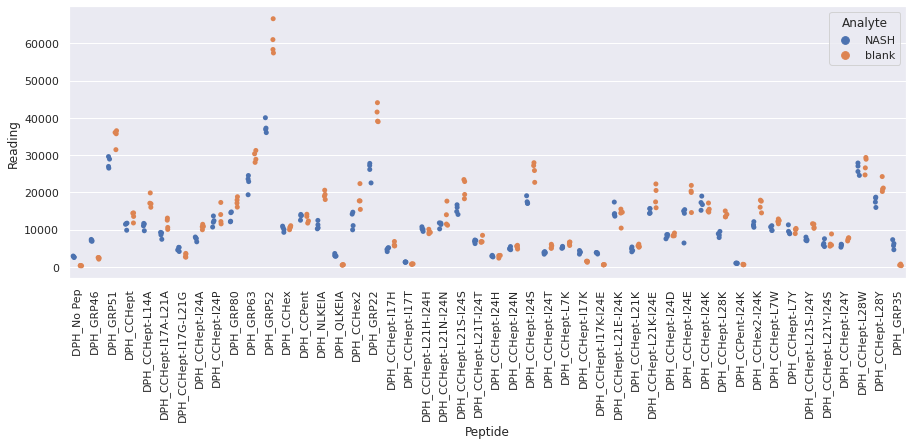

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR4_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_fifteenR4_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

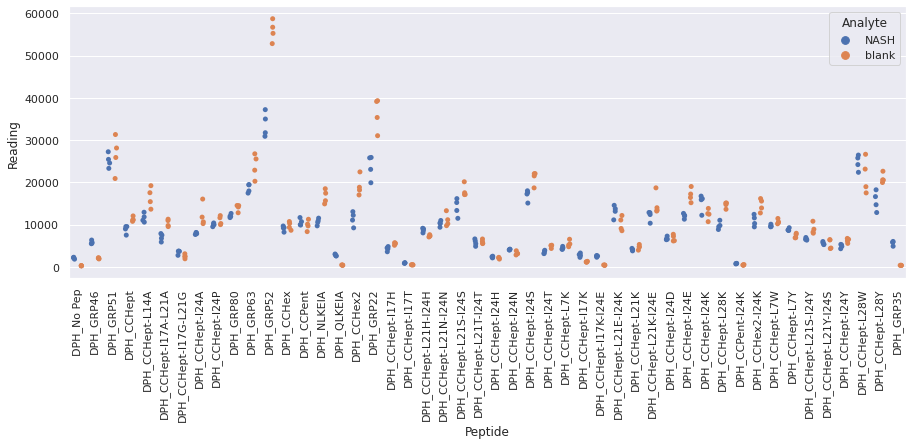

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_oneR1_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_oneR1_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

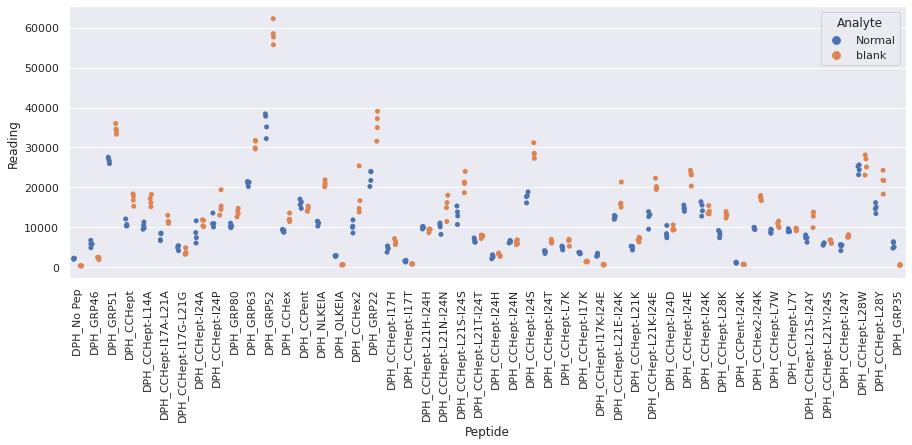

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_oneR2_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_oneR2_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

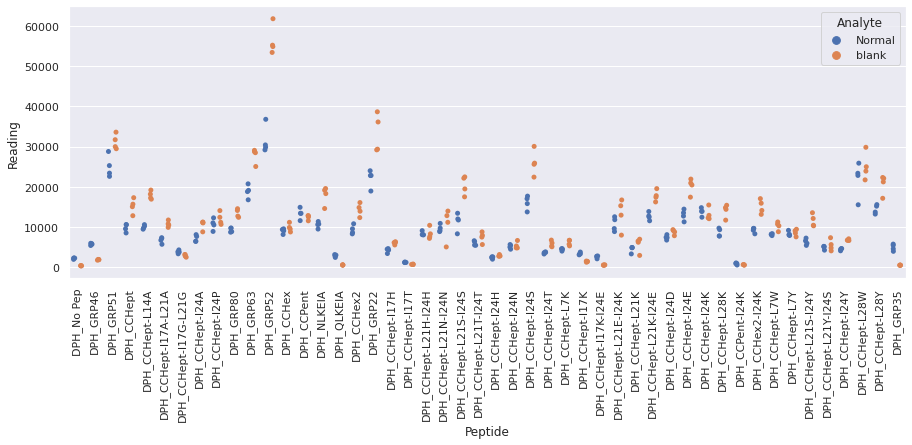

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_oneR3_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_oneR3_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

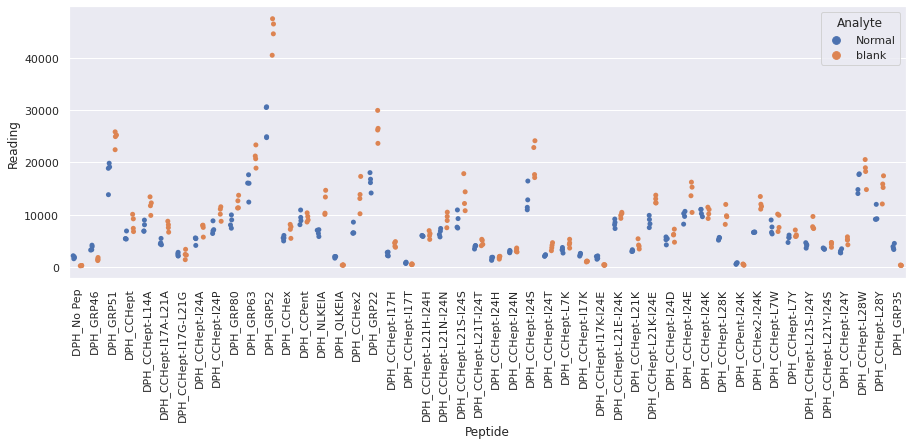

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_oneR4_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_oneR4_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

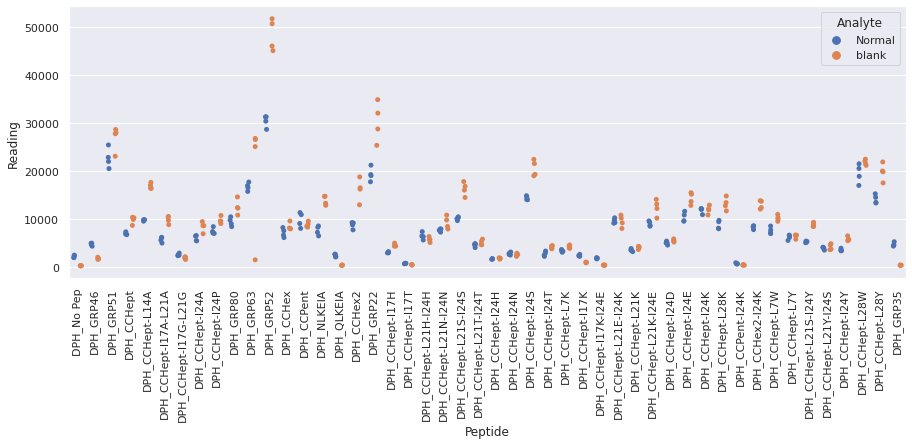

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_sixteenR1_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_sixteenR1_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

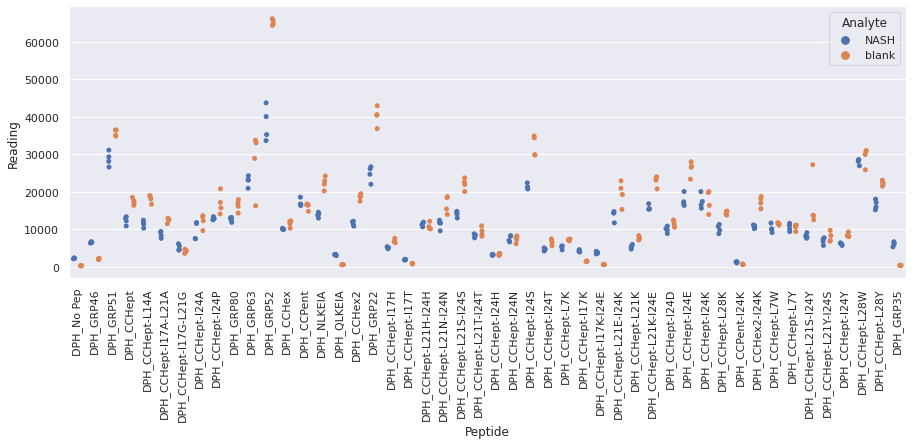

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_sixteenR2_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_sixteenR2_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

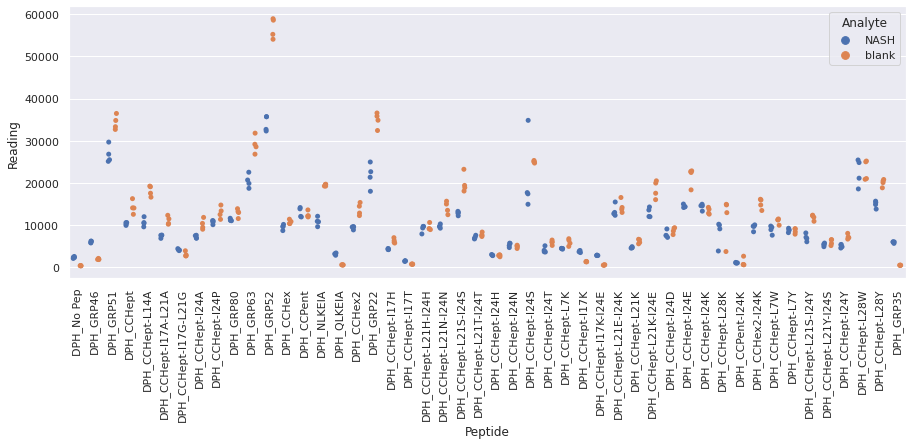

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_sixteenR3_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_sixteenR3_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

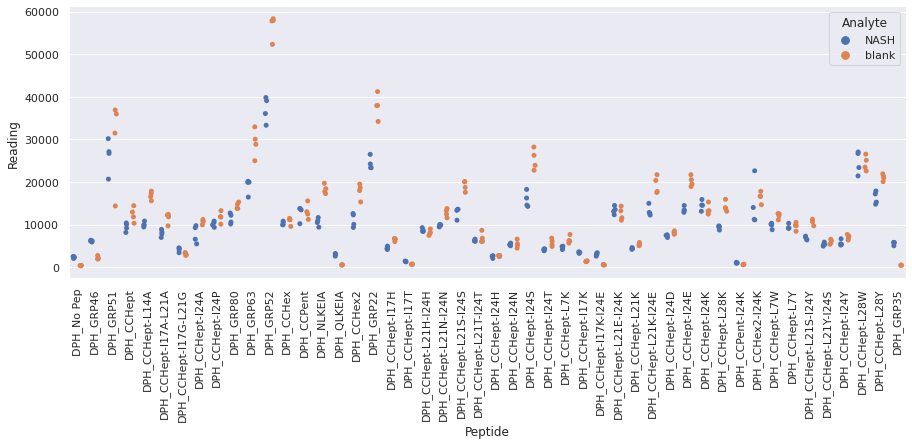

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_sixteenR4_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_sixteenR4_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

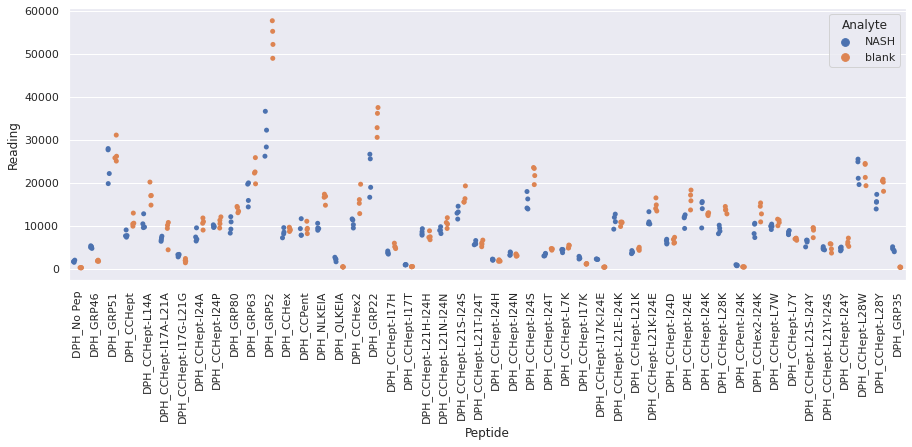

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twoR1_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_twoR1_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

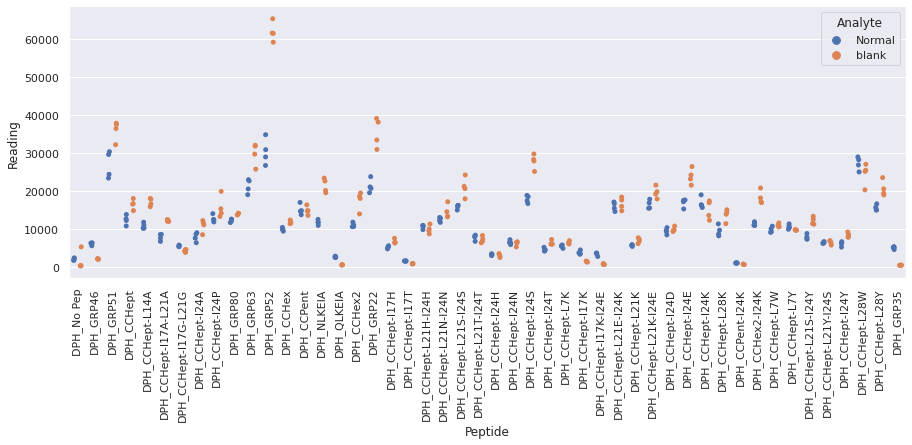

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twoR2_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_twoR2_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

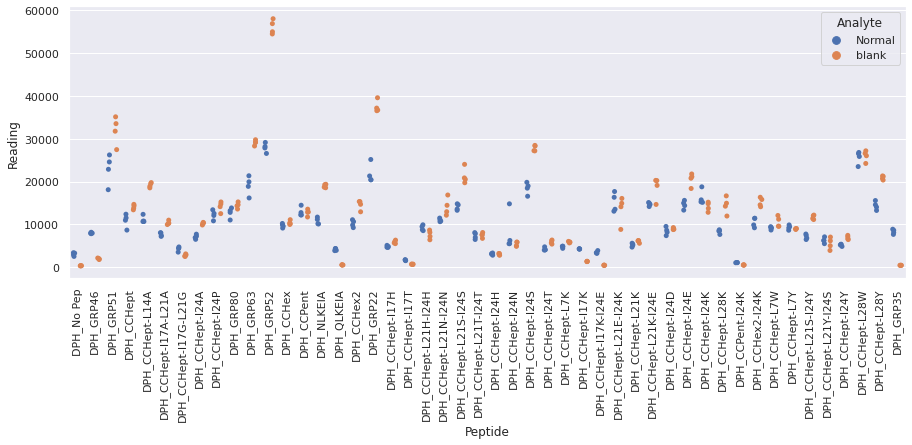

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twoR3_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_twoR3_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

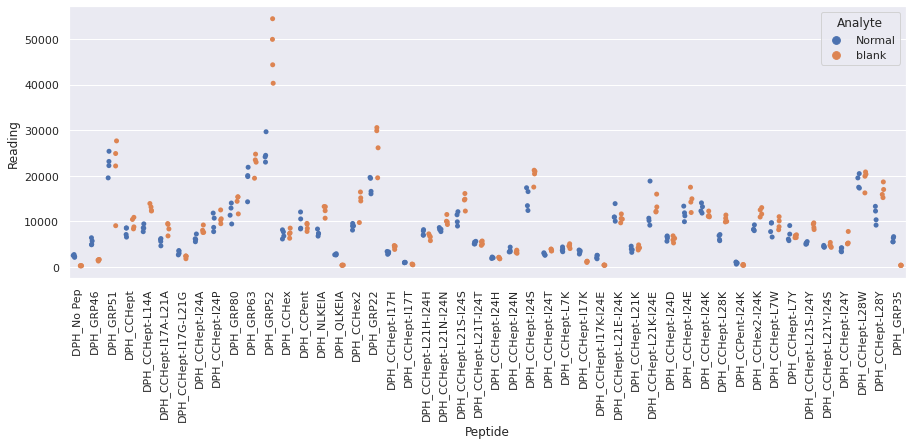

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twoR4_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_twoR4_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

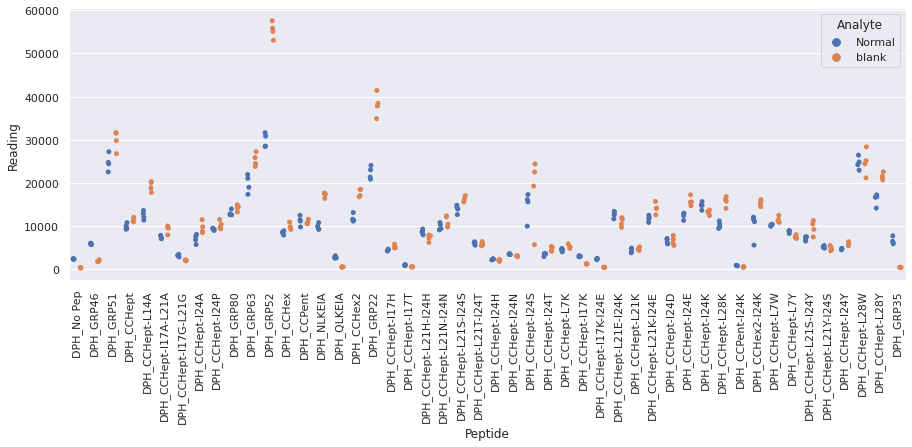

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_seventeenR1_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_seventeenR1_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

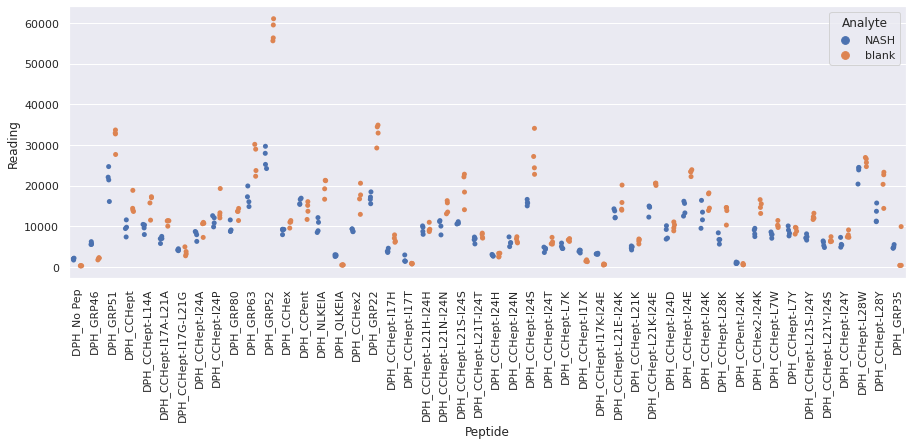

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_seventeenR2_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_seventeenR2_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

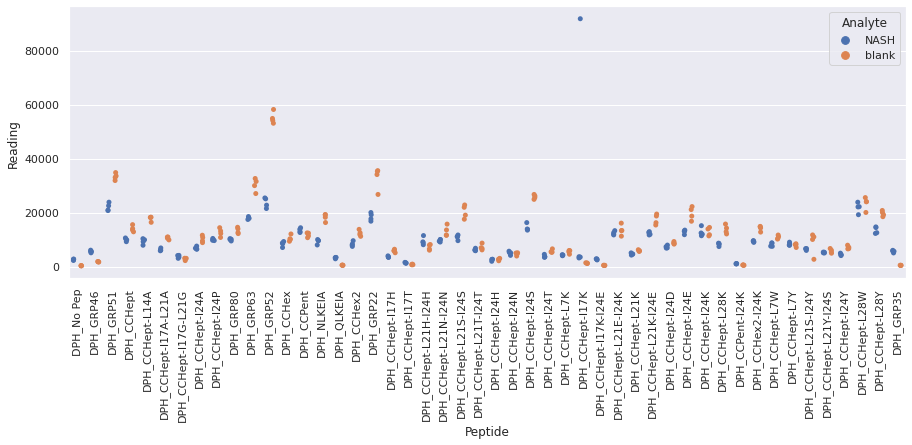

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_seventeenR3_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_seventeenR3_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

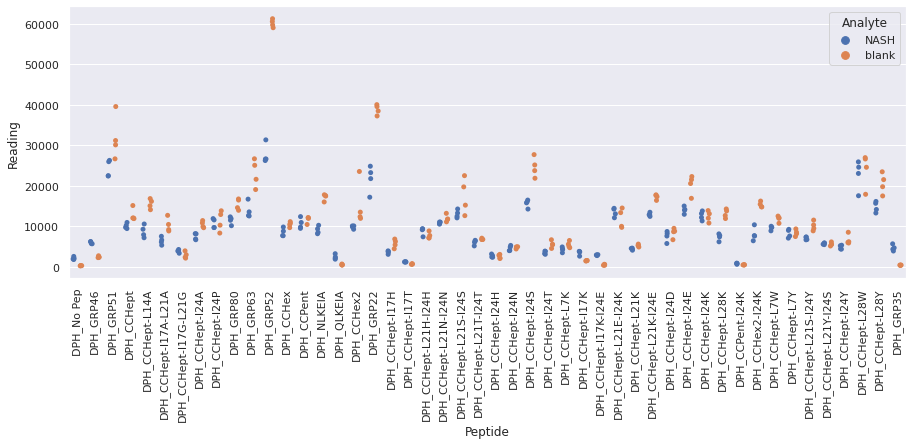

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_seventeenR4_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_seventeenR4_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

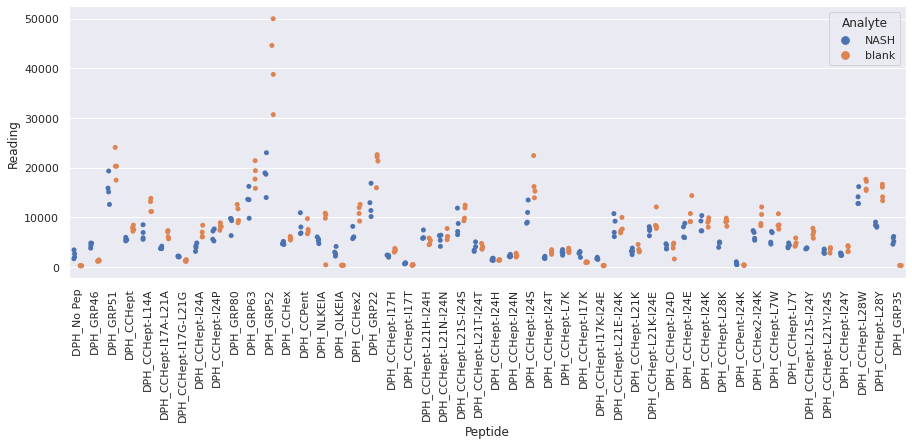

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_threeR1_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_threeR1_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

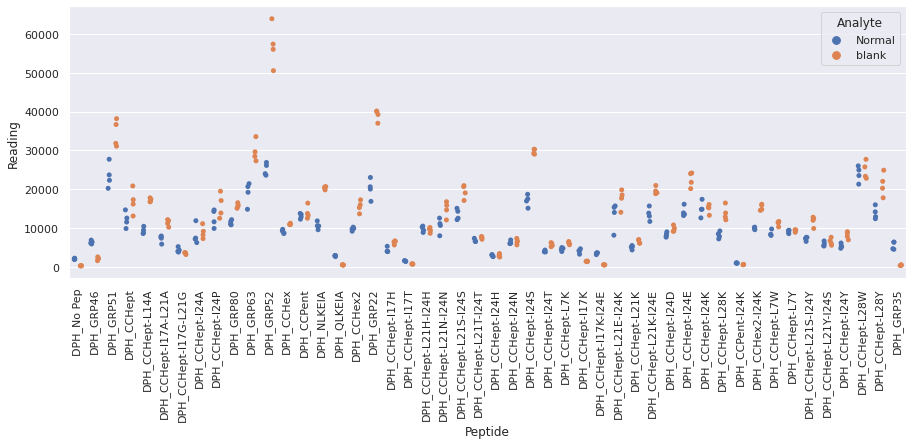

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_threeR2_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_threeR2_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

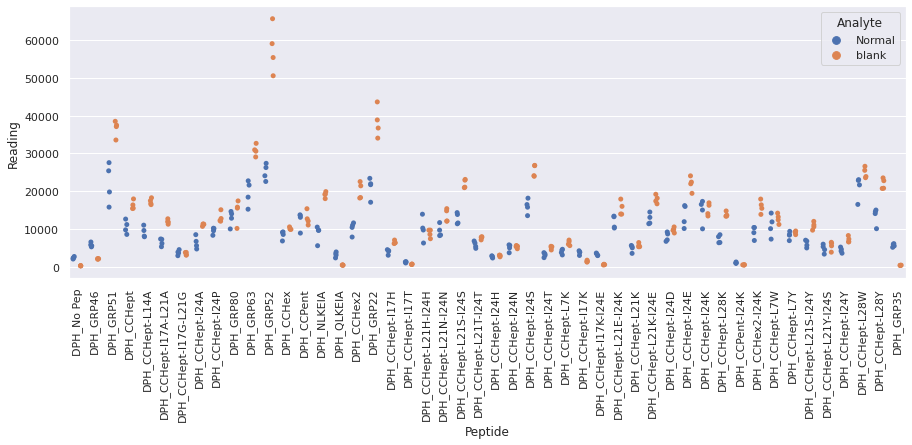

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_threeR3_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_threeR3_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

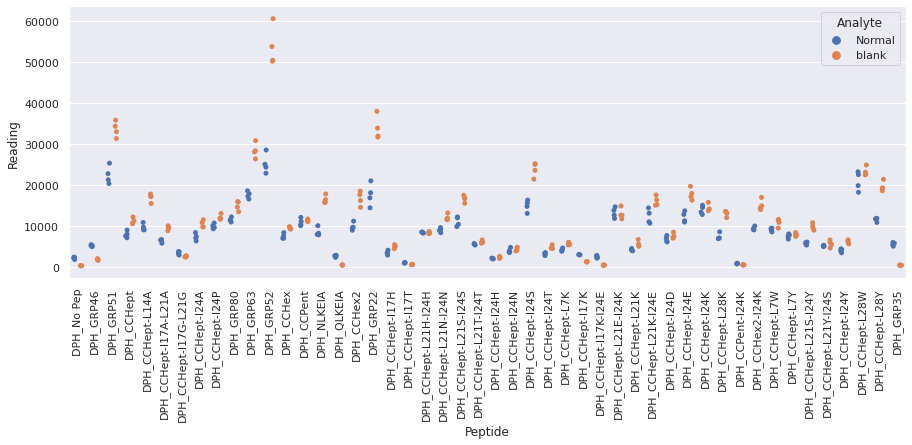

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_threeR4_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_threeR4_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

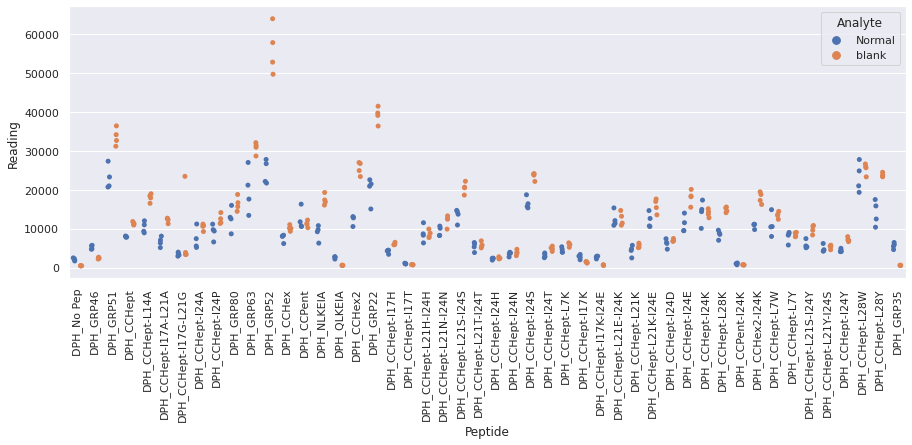

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_eighteenR1_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_eighteenR1_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

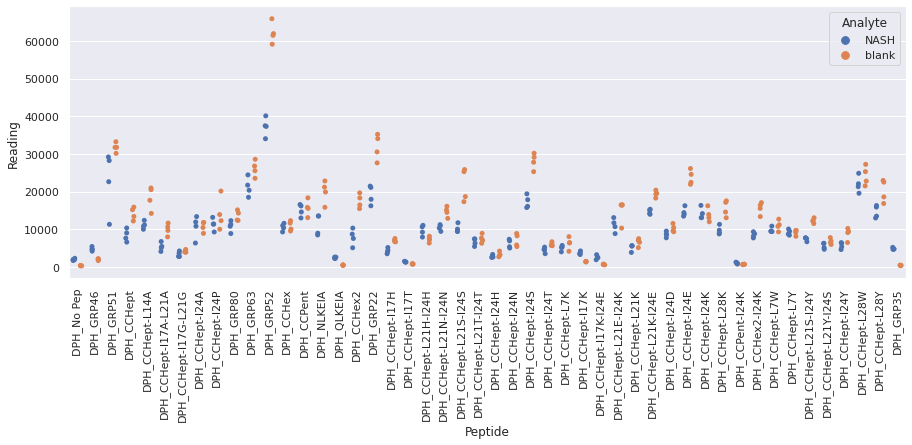

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_eighteenR2_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_eighteenR2_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

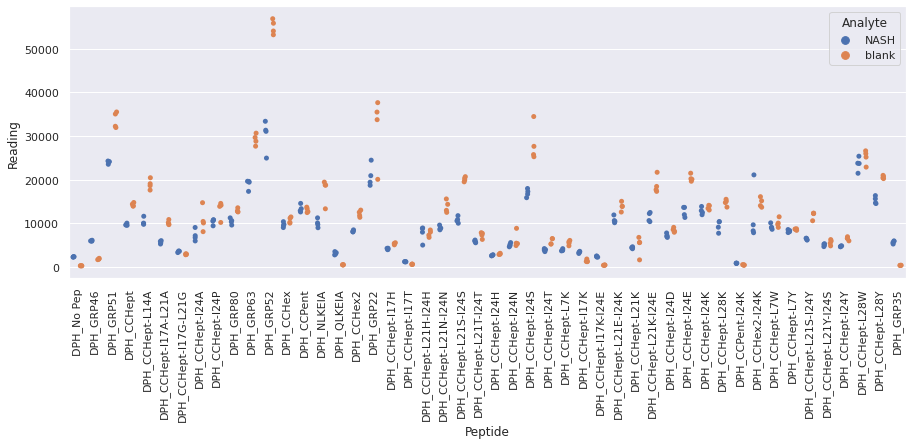

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_eighteenR3_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_eighteenR3_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

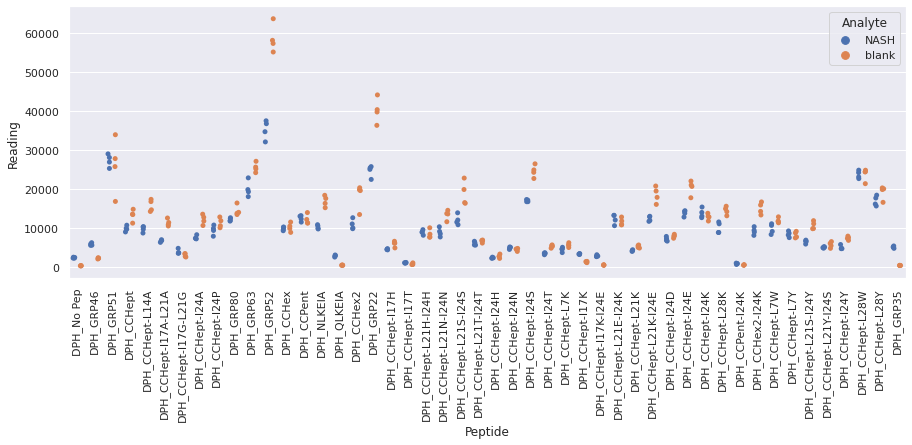

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_eighteenR4_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_eighteenR4_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

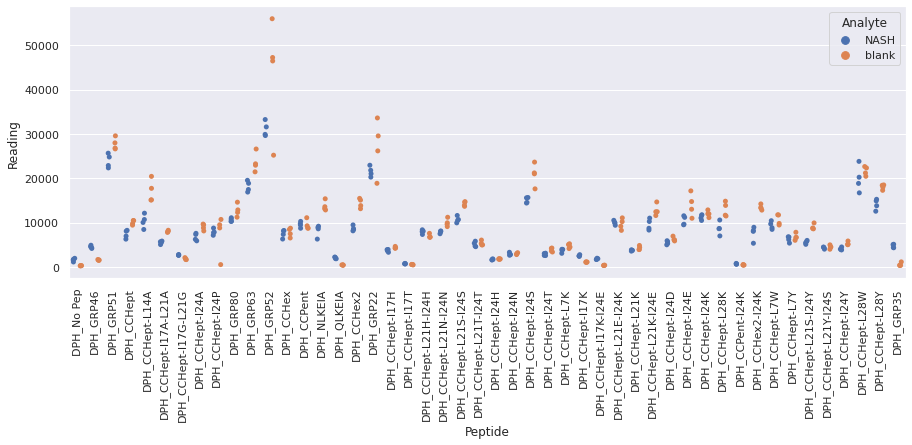

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourR1_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_fourR1_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

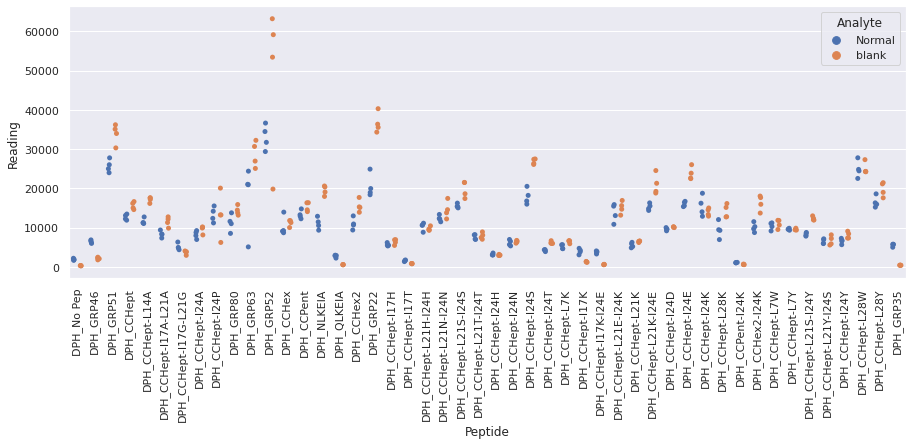

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourR2_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_fourR2_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

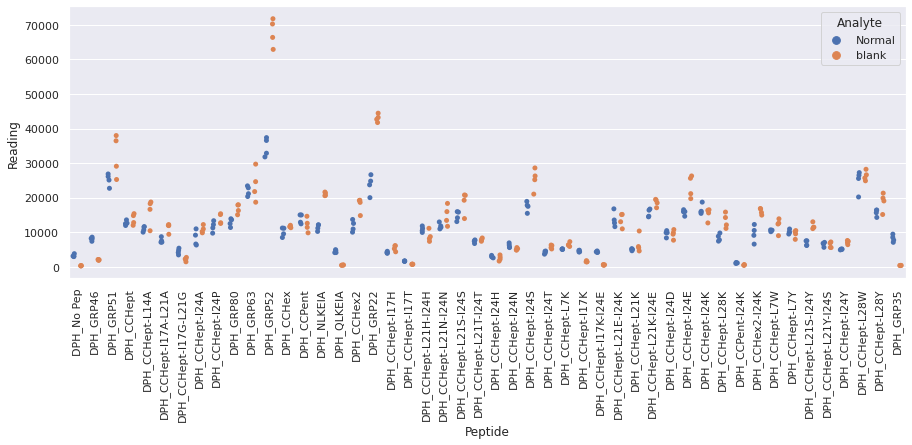

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourR3_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_fourR3_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

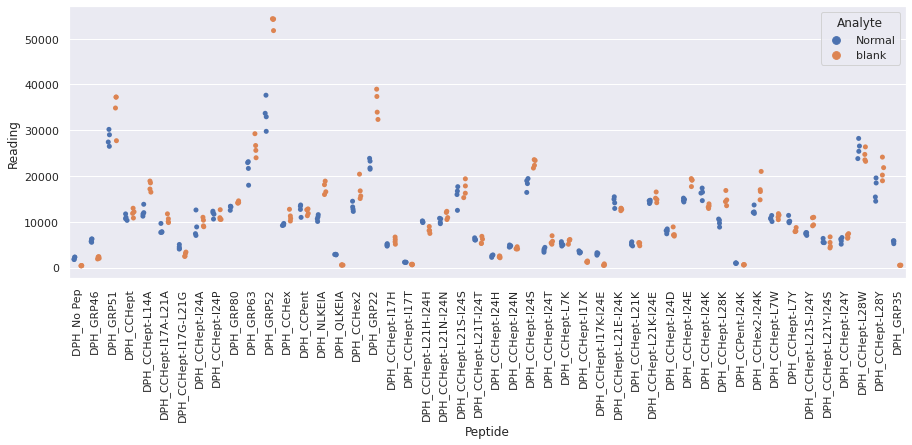

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourR4_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_fourR4_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

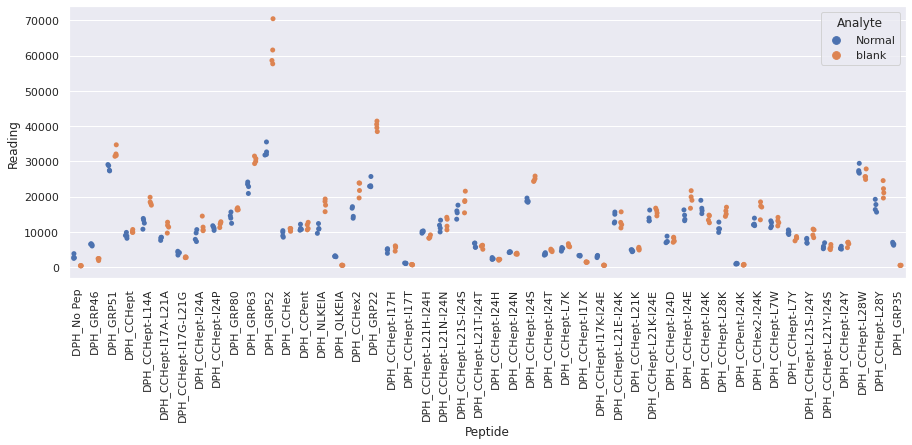

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_nineteenR1_repeat_5.xlsx
Drawing scatter plot of data spread for NASH_nineteenR1_repeat_5 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

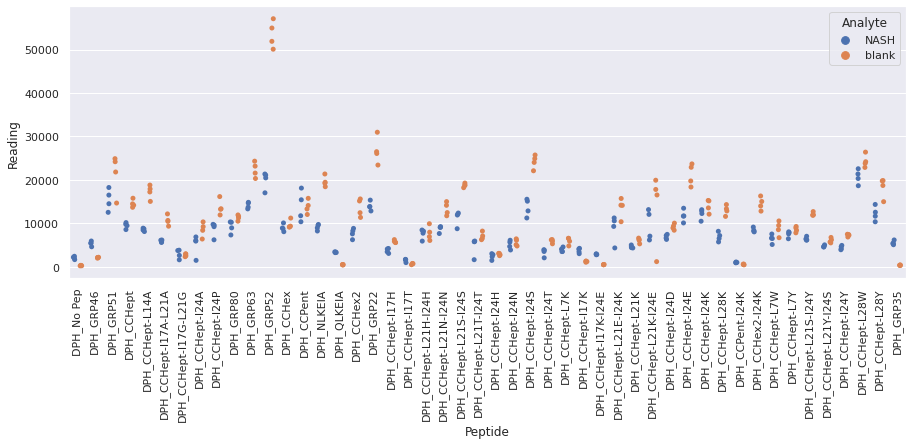

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_nineteenR2_repeat_5.xlsx
Drawing scatter plot of data spread for NASH_nineteenR2_repeat_5 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

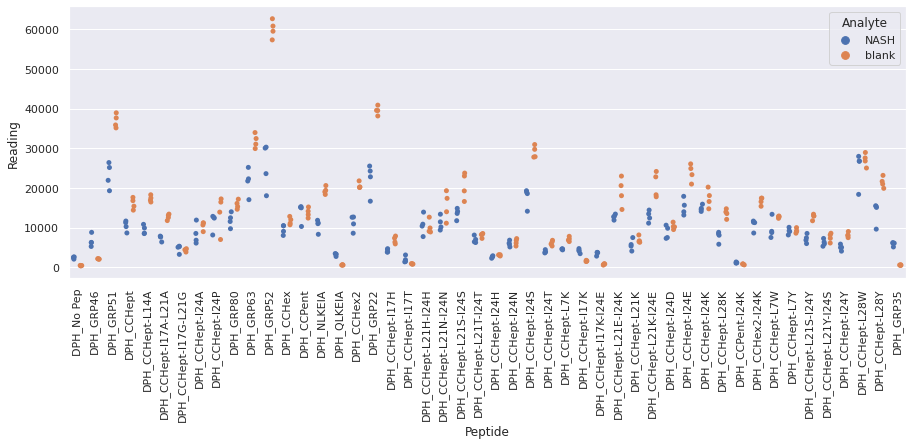

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_nineteenR3_repeat_5.xlsx
Drawing scatter plot of data spread for NASH_nineteenR3_repeat_5 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

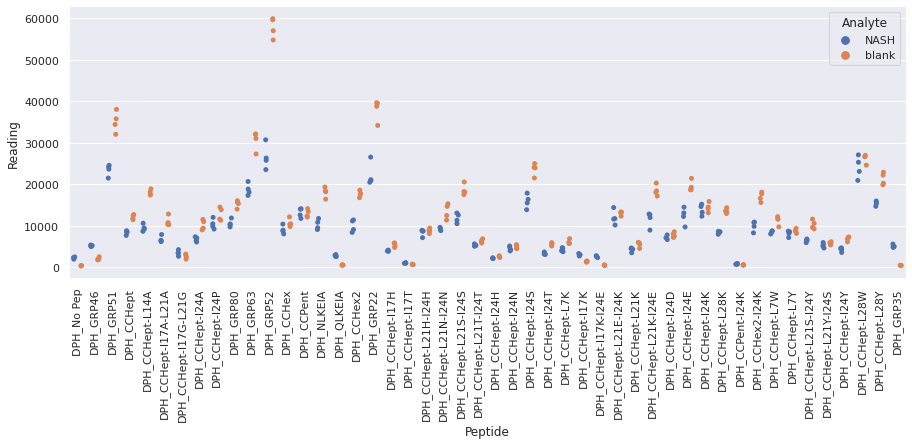

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_nineteenR4_repeat_5.xlsx
Drawing scatter plot of data spread for NASH_nineteenR4_repeat_5 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

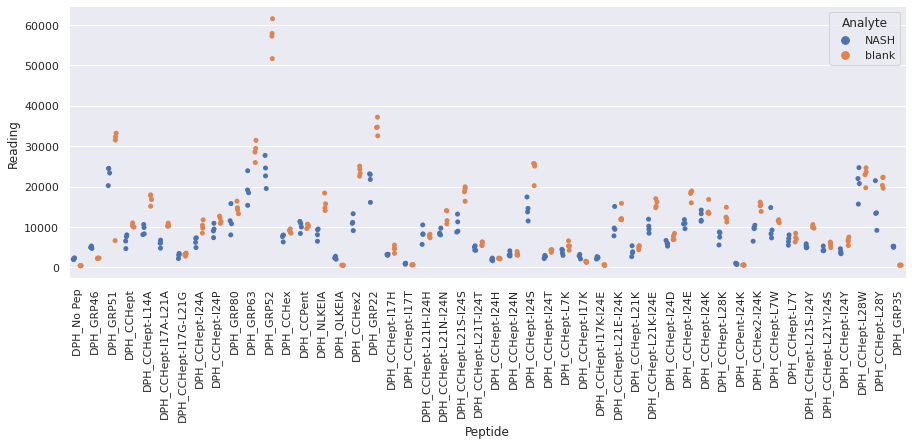

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fiveR1_repeat_5.xlsx
Drawing scatter plot of data spread for Normal_fiveR1_repeat_5 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

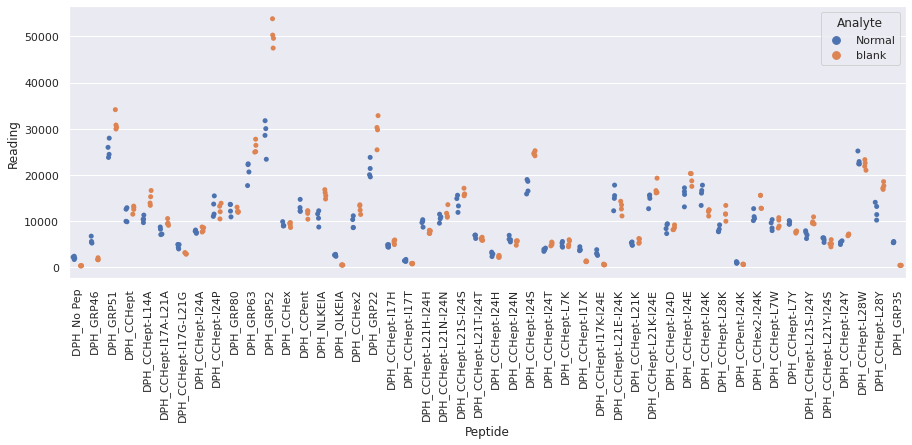

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fiveR2_repeat_5.xlsx
Drawing scatter plot of data spread for Normal_fiveR2_repeat_5 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

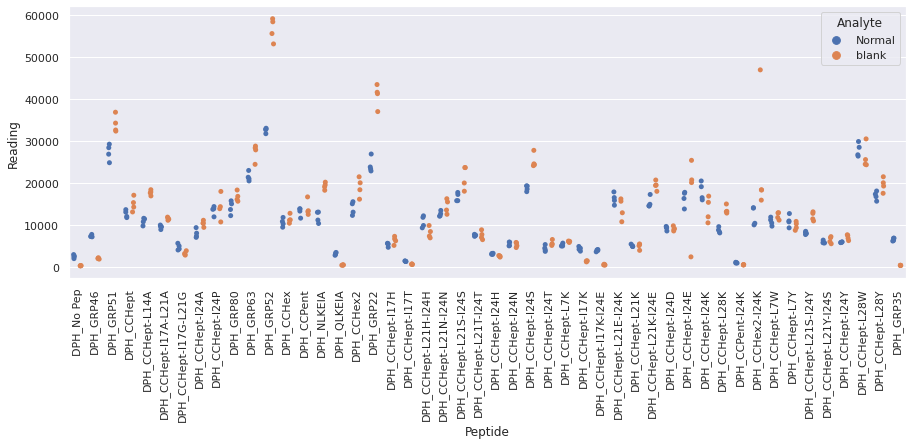

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fiveR3_repeat_5.xlsx
Drawing scatter plot of data spread for Normal_fiveR3_repeat_5 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

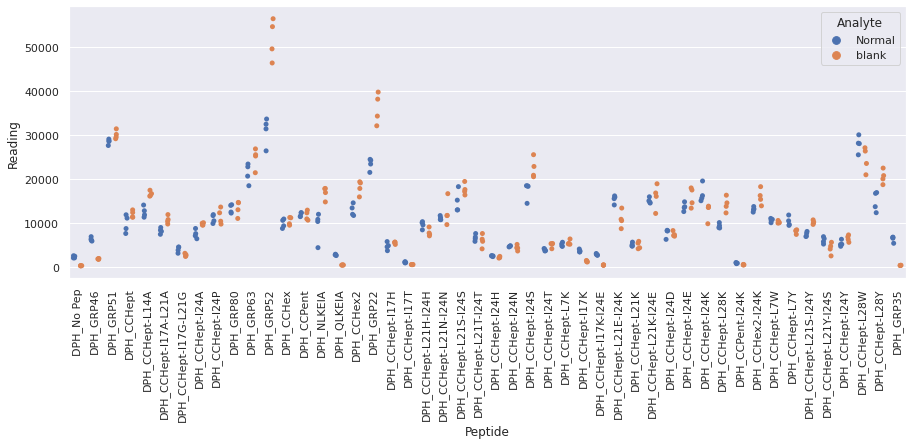

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fiveR4_repeat_5.xlsx
Drawing scatter plot of data spread for Normal_fiveR4_repeat_5 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

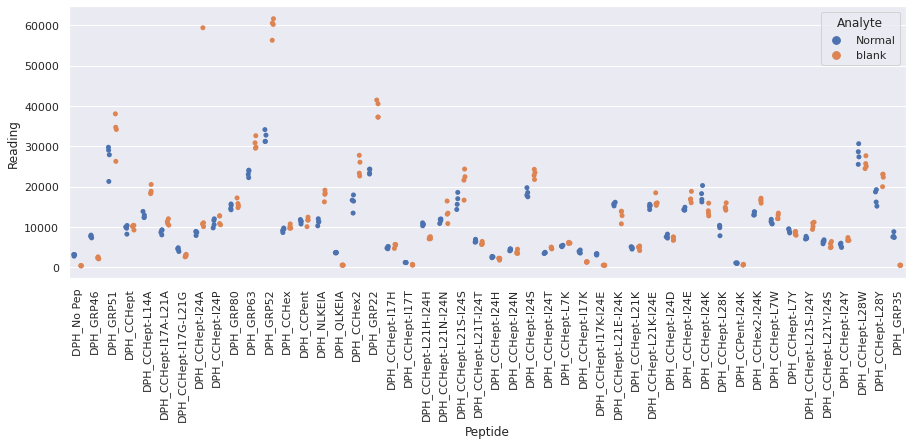

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyR1_repeat_6.xlsx
Drawing scatter plot of data spread for NASH_twentyR1_repeat_6 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

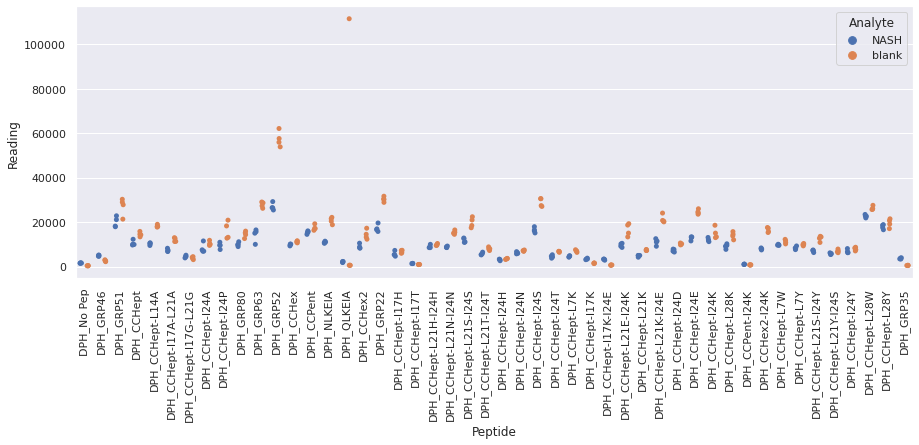

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyR2_repeat_6.xlsx
Drawing scatter plot of data spread for NASH_twentyR2_repeat_6 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

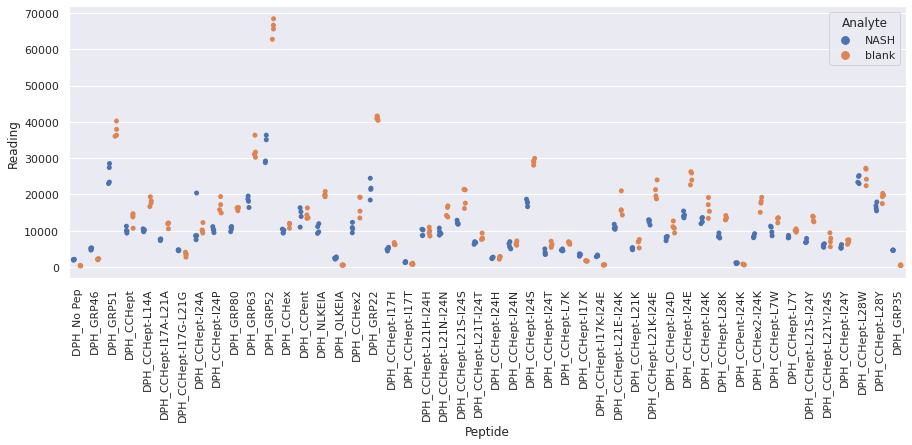

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyR3_repeat_6.xlsx
Drawing scatter plot of data spread for NASH_twentyR3_repeat_6 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

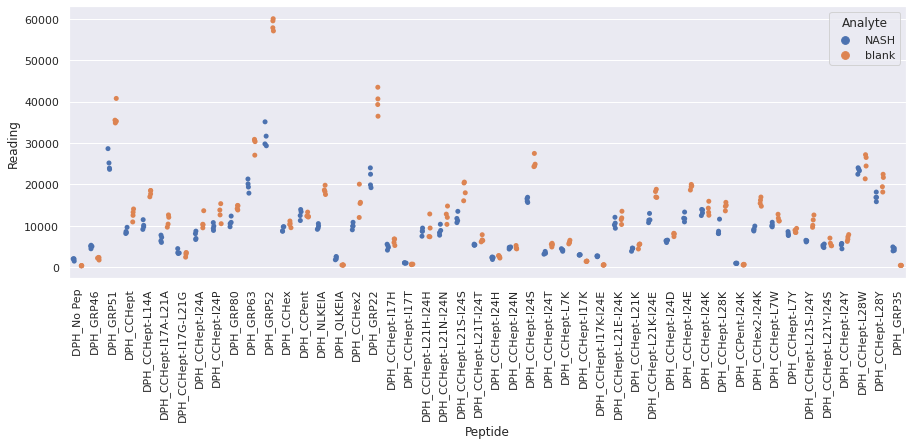

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyR4_repeat_6.xlsx
Drawing scatter plot of data spread for NASH_twentyR4_repeat_6 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

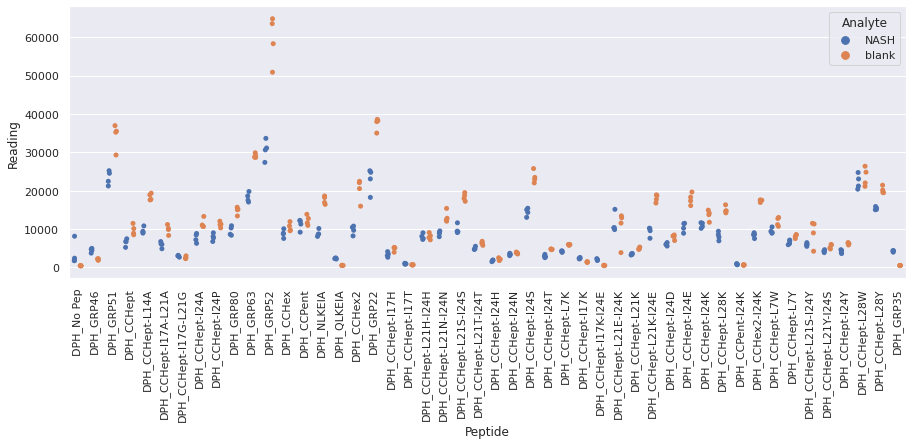

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sixR1_repeat_6.xlsx
Drawing scatter plot of data spread for Normal_sixR1_repeat_6 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

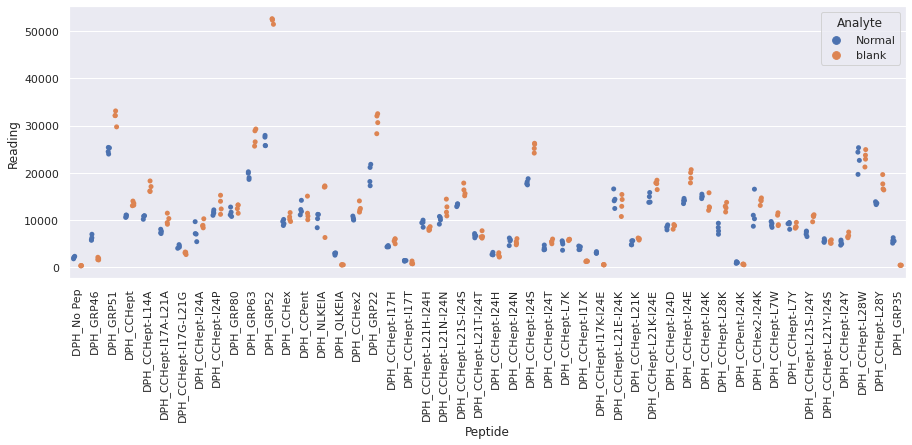

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sixR2_repeat_6.xlsx
Drawing scatter plot of data spread for Normal_sixR2_repeat_6 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

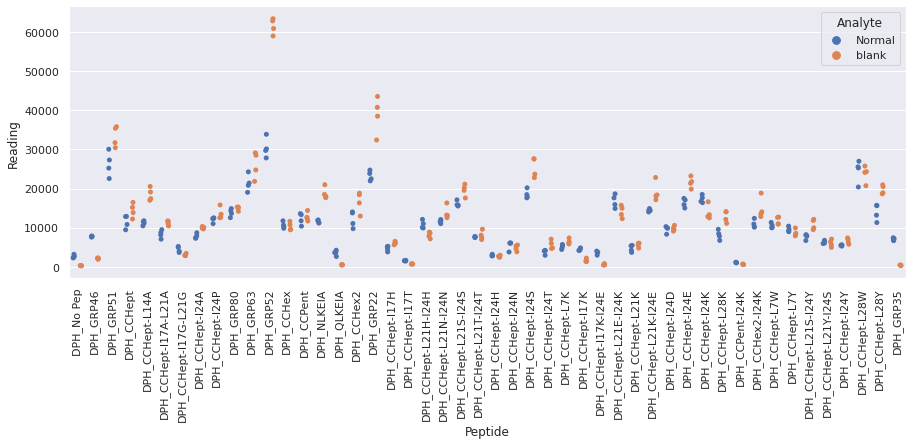

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sixR3_repeat_6.xlsx
Drawing scatter plot of data spread for Normal_sixR3_repeat_6 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

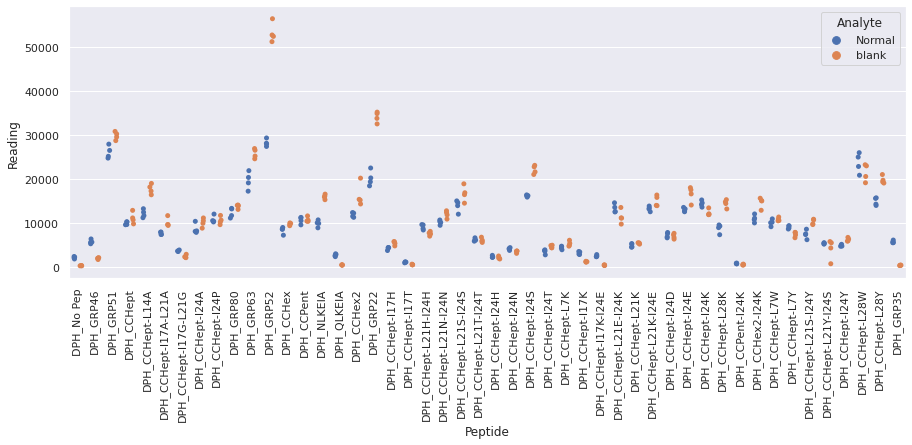

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sixR4_repeat_6.xlsx
Drawing scatter plot of data spread for Normal_sixR4_repeat_6 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

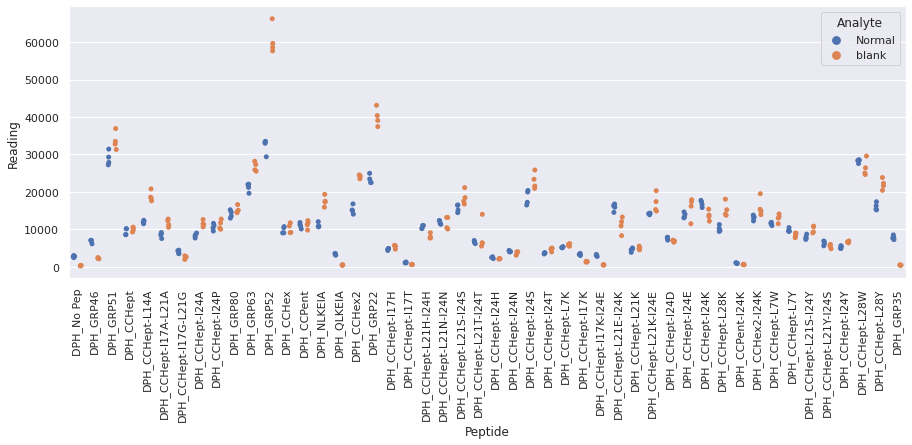

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyoneR1_repeat_7.xlsx
Drawing scatter plot of data spread for NASH_twentyoneR1_repeat_7 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

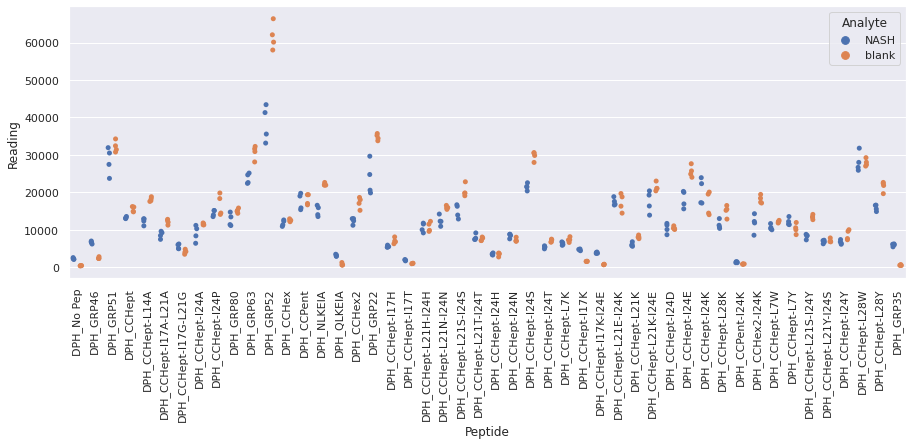

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyoneR2_repeat_7.xlsx
Drawing scatter plot of data spread for NASH_twentyoneR2_repeat_7 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

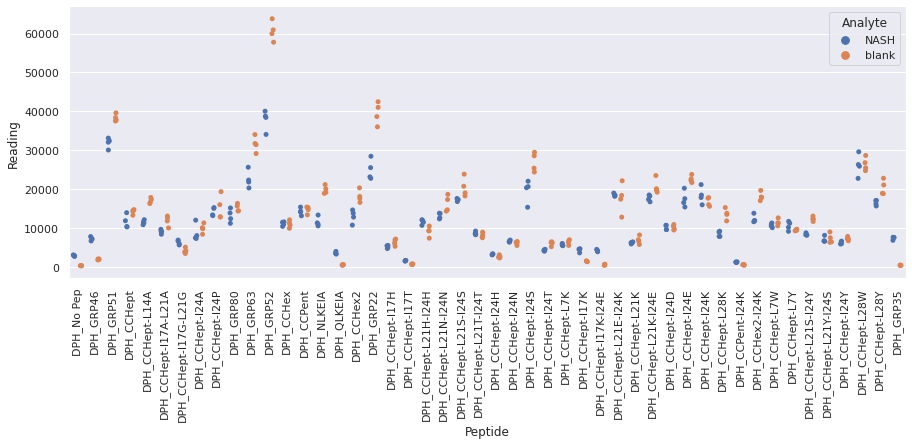

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyoneR3_repeat_7.xlsx
Drawing scatter plot of data spread for NASH_twentyoneR3_repeat_7 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

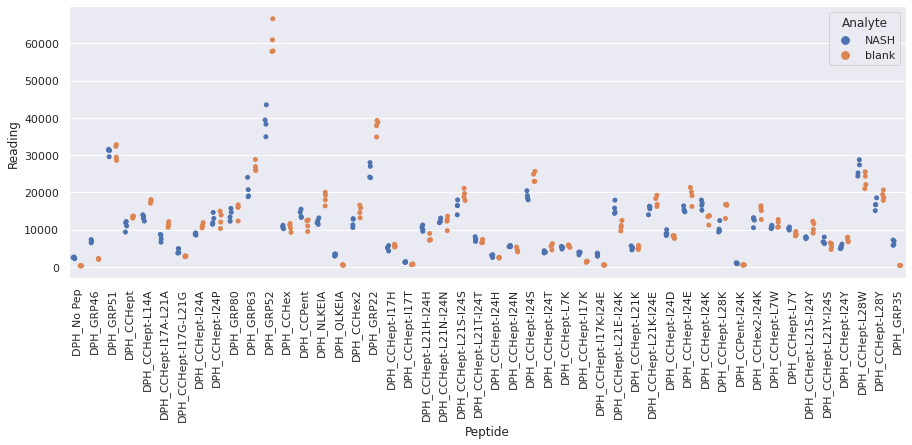

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyoneR4_repeat_7.xlsx
Drawing scatter plot of data spread for NASH_twentyoneR4_repeat_7 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

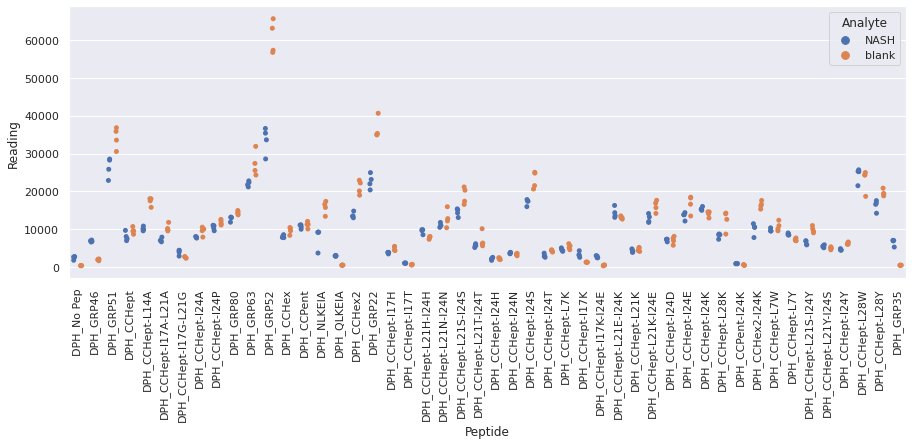

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sevenR1_repeat_7.xlsx
Drawing scatter plot of data spread for Normal_sevenR1_repeat_7 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

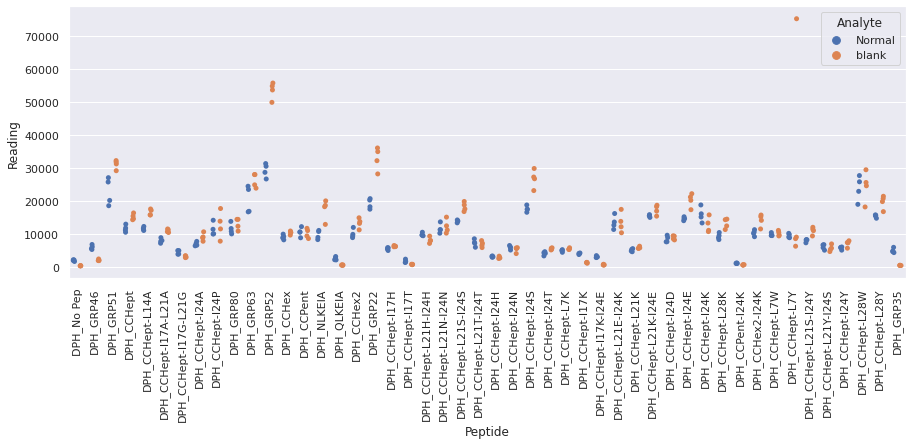

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sevenR2_repeat_7.xlsx
Drawing scatter plot of data spread for Normal_sevenR2_repeat_7 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

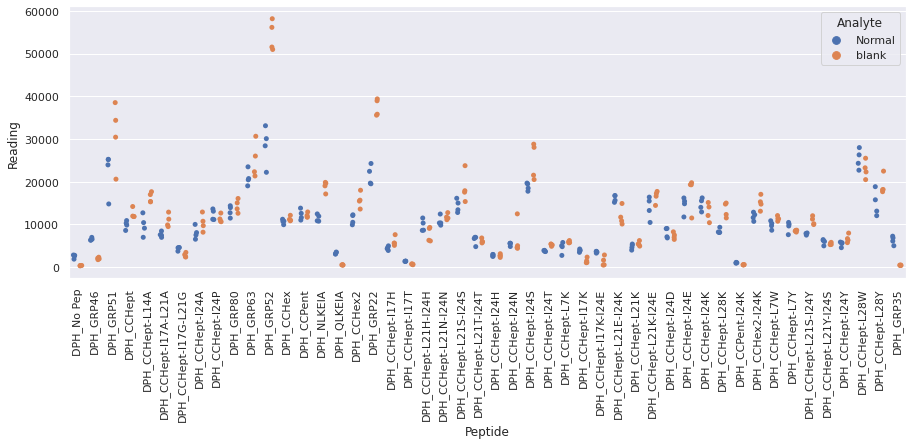

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sevenR3_repeat_7.xlsx
Drawing scatter plot of data spread for Normal_sevenR3_repeat_7 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

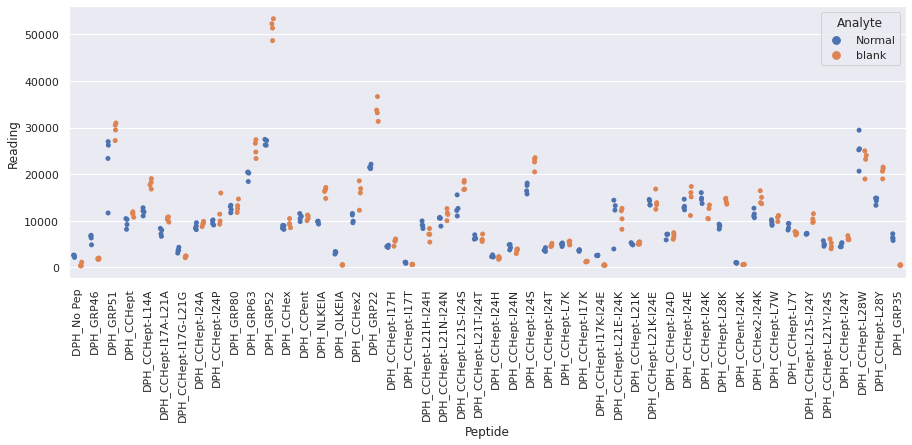

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sevenR4_repeat_7.xlsx
Drawing scatter plot of data spread for Normal_sevenR4_repeat_7 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

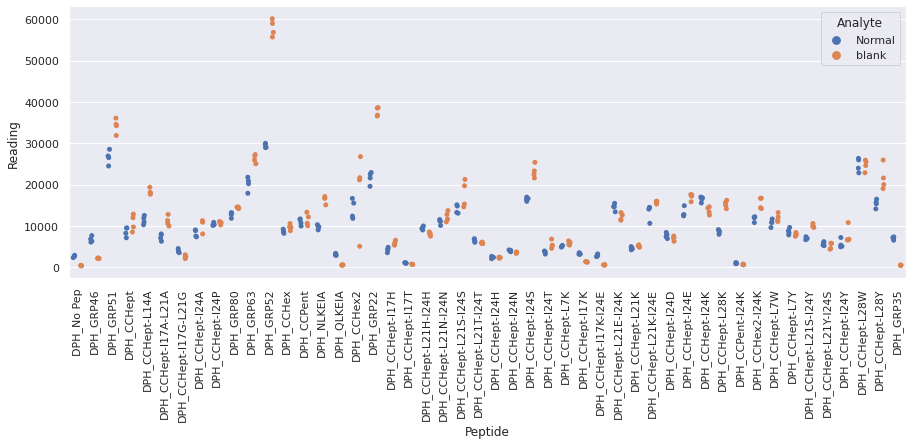

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentytwoR1_repeat_8.xlsx
Drawing scatter plot of data spread for NASH_twentytwoR1_repeat_8 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

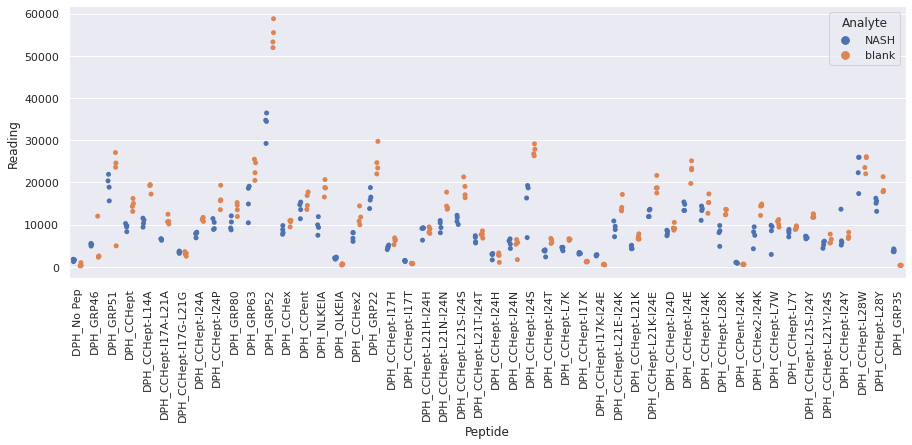

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentytwoR2_repeat_8.xlsx
Drawing scatter plot of data spread for NASH_twentytwoR2_repeat_8 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

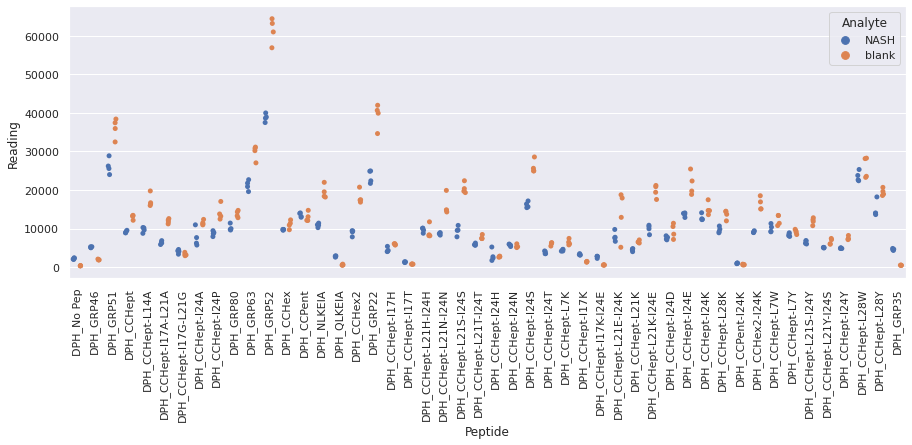

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentytwoR3_repeat_8.xlsx
Drawing scatter plot of data spread for NASH_twentytwoR3_repeat_8 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

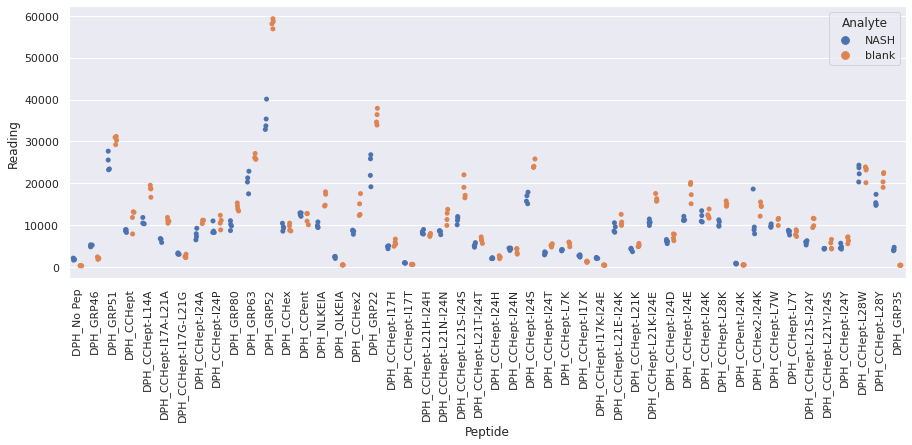

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentytwoR4_repeat_8.xlsx
Drawing scatter plot of data spread for NASH_twentytwoR4_repeat_8 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

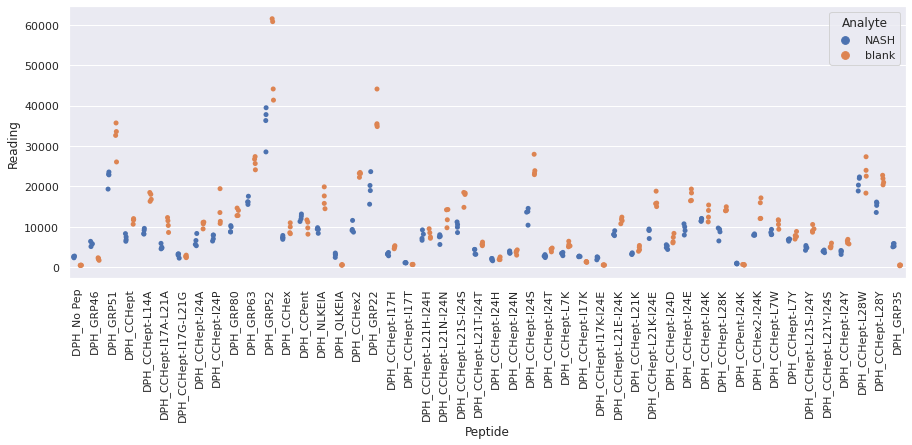

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_eightR1_repeat_8.xlsx
Drawing scatter plot of data spread for Normal_eightR1_repeat_8 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

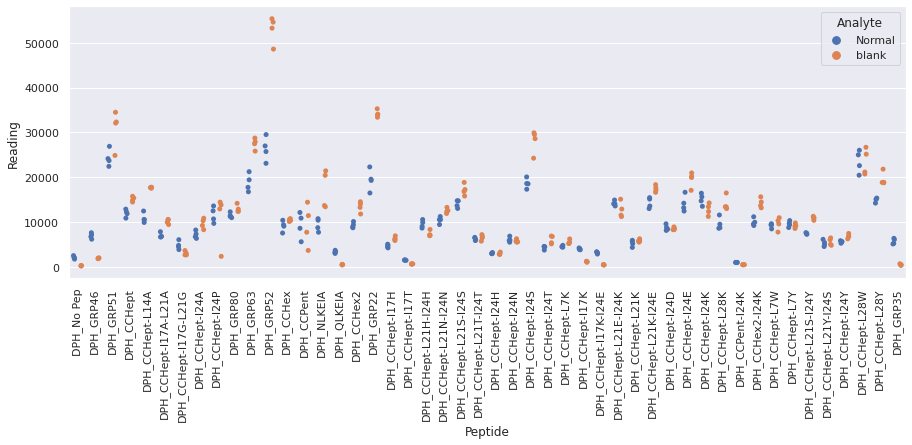

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_eightR2_repeat_8.xlsx
Drawing scatter plot of data spread for Normal_eightR2_repeat_8 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

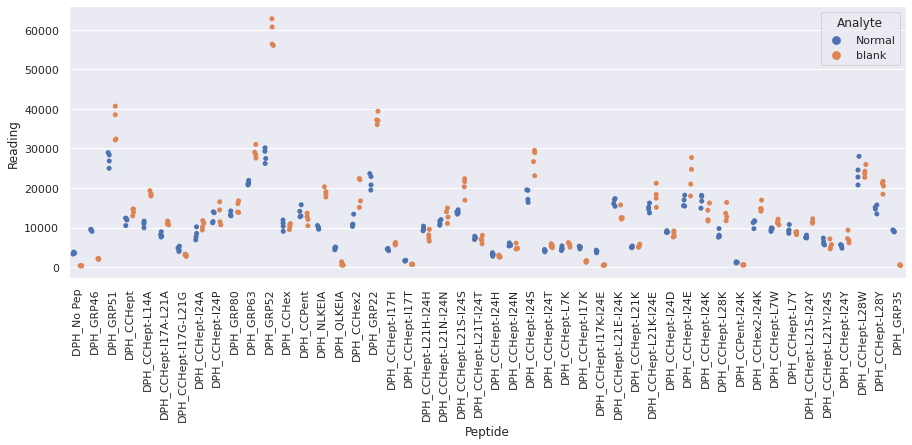

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_eightR3_repeat_8.xlsx
Drawing scatter plot of data spread for Normal_eightR3_repeat_8 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

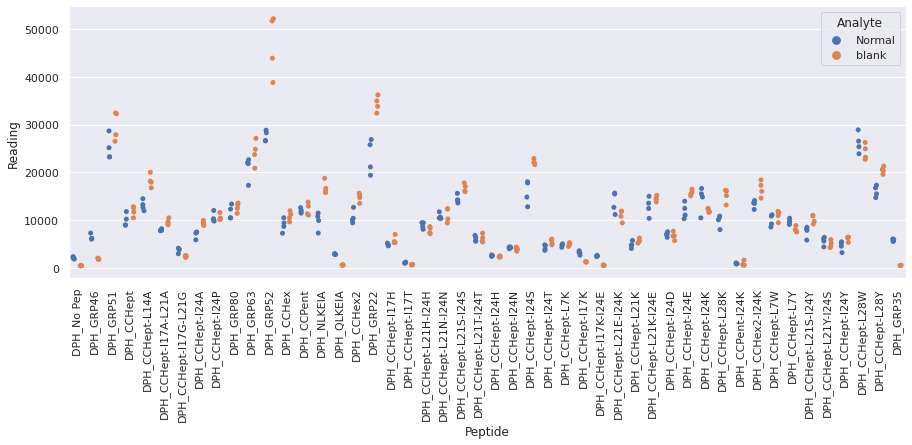

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_eightR4_repeat_8.xlsx
Drawing scatter plot of data spread for Normal_eightR4_repeat_8 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

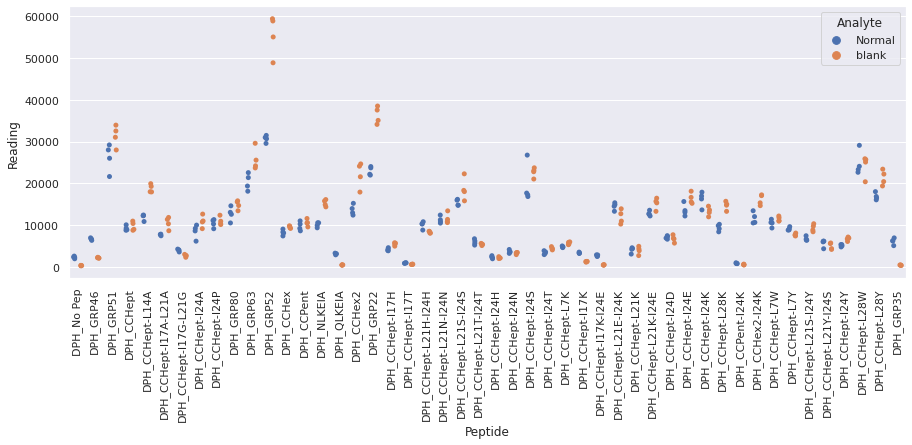

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentythreeR1_repeat_9.xlsx
Drawing scatter plot of data spread for NASH_twentythreeR1_repeat_9 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

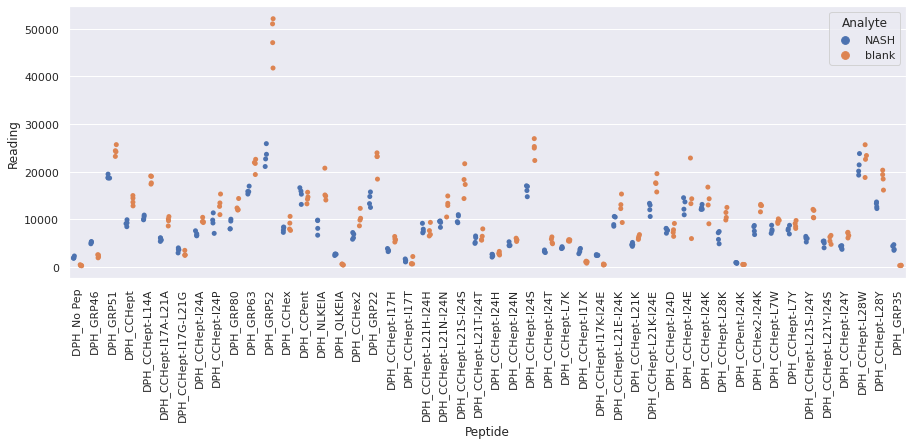

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentythreeR2_repeat_9.xlsx
Drawing scatter plot of data spread for NASH_twentythreeR2_repeat_9 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

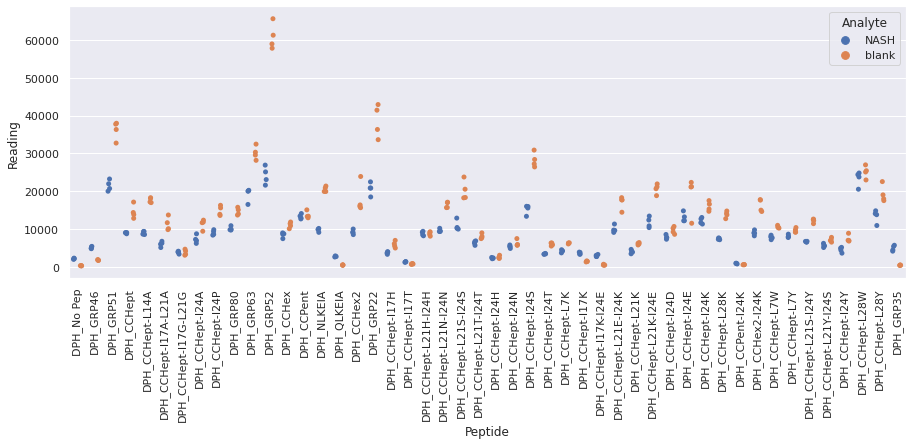

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentythreeR3_repeat_9.xlsx
Drawing scatter plot of data spread for NASH_twentythreeR3_repeat_9 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

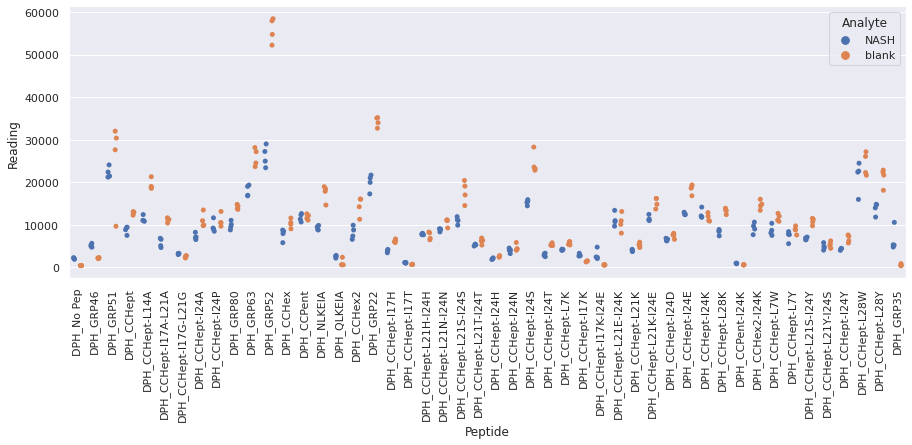

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentythreeR4_repeat_9.xlsx
Drawing scatter plot of data spread for NASH_twentythreeR4_repeat_9 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

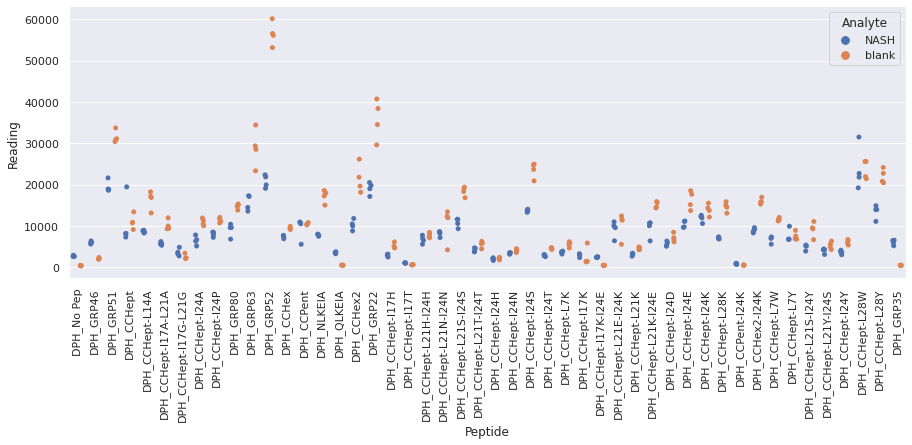

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR1_repeat_9.xlsx
Drawing scatter plot of data spread for Normal_nineR1_repeat_9 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

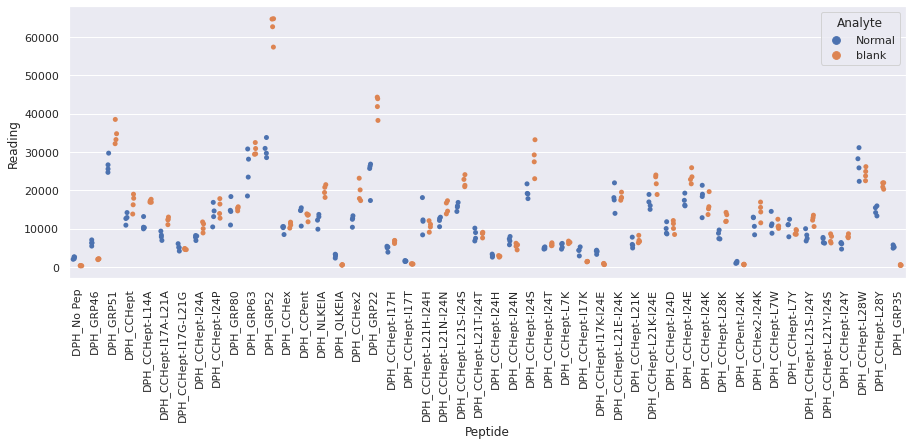

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR2_repeat_9.xlsx
Drawing scatter plot of data spread for Normal_nineR2_repeat_9 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

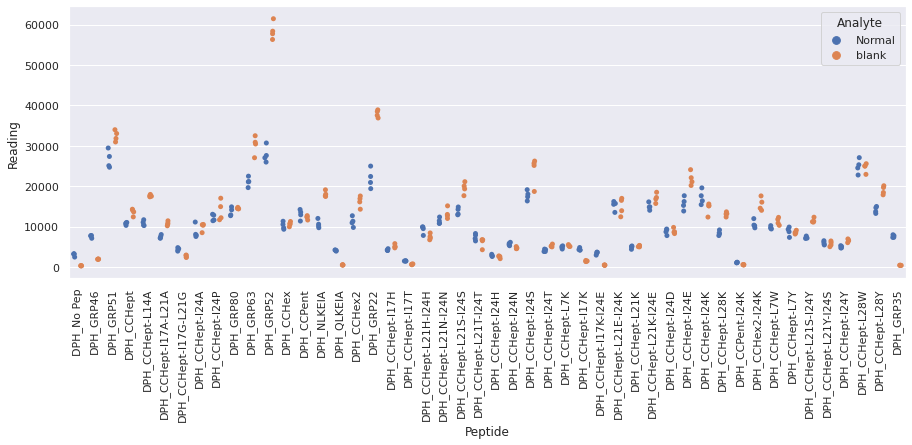

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR3_repeat_9.xlsx
Drawing scatter plot of data spread for Normal_nineR3_repeat_9 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

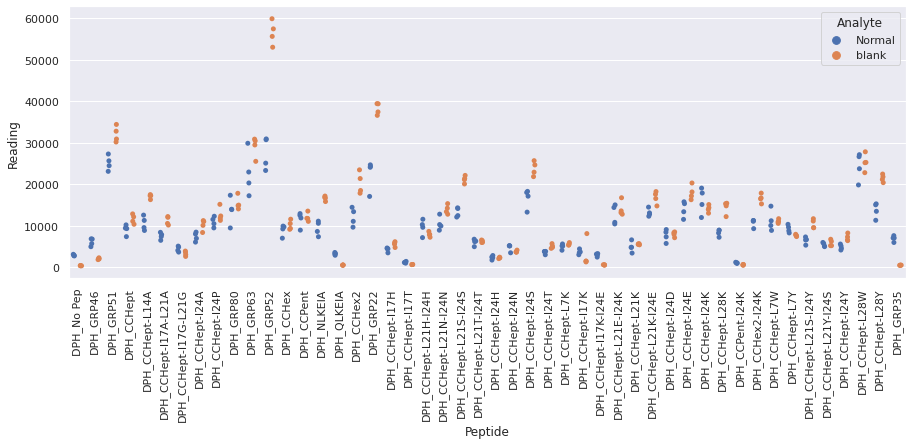

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR4_repeat_9.xlsx
Drawing scatter plot of data spread for Normal_nineR4_repeat_9 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

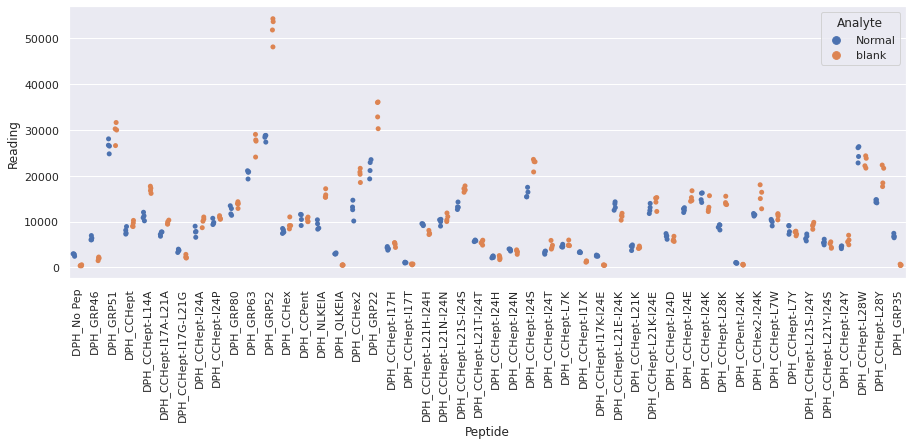

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfourR1_repeat_10.xlsx
Drawing scatter plot of data spread for NASH_twentyfourR1_repeat_10 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

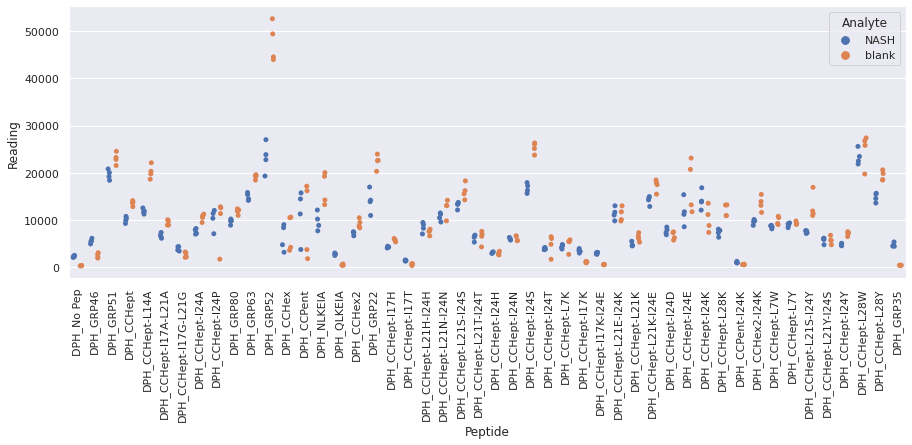

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfourR2_repeat_10.xlsx
Drawing scatter plot of data spread for NASH_twentyfourR2_repeat_10 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

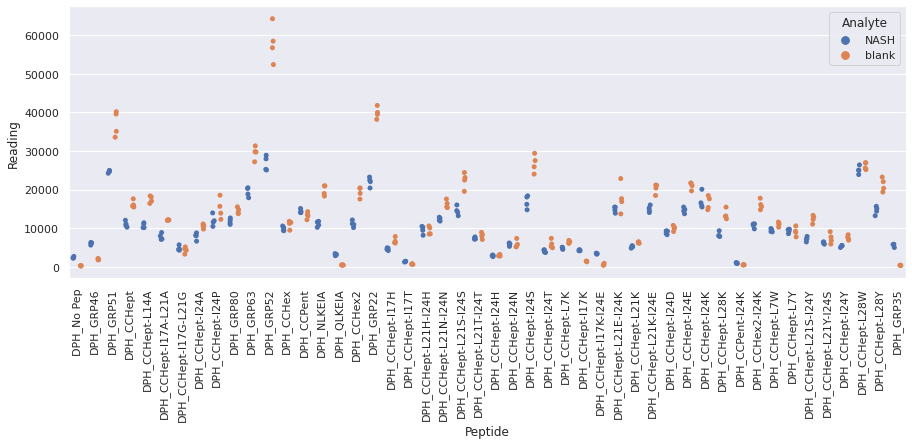

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfourR3_repeat_10.xlsx
Drawing scatter plot of data spread for NASH_twentyfourR3_repeat_10 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

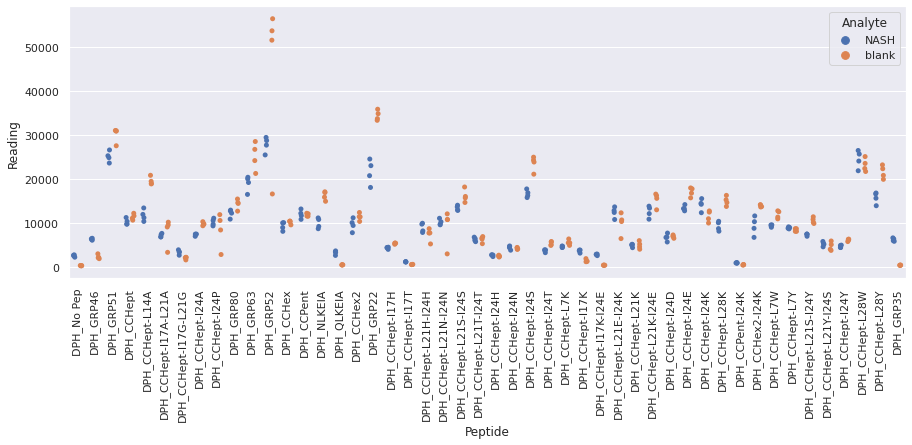

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfourR4_repeat_10.xlsx
Drawing scatter plot of data spread for NASH_twentyfourR4_repeat_10 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

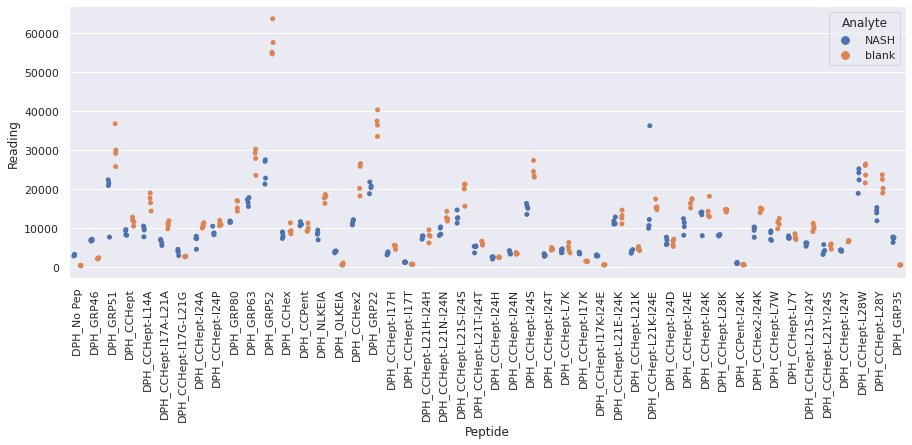

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_tenR1_repeat_10.xlsx
Drawing scatter plot of data spread for Normal_tenR1_repeat_10 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

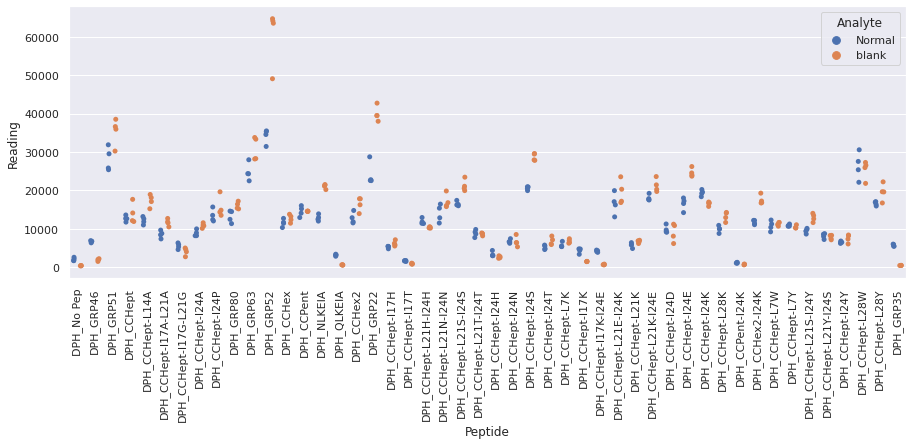

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_tenR2_repeat_10.xlsx
Drawing scatter plot of data spread for Normal_tenR2_repeat_10 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

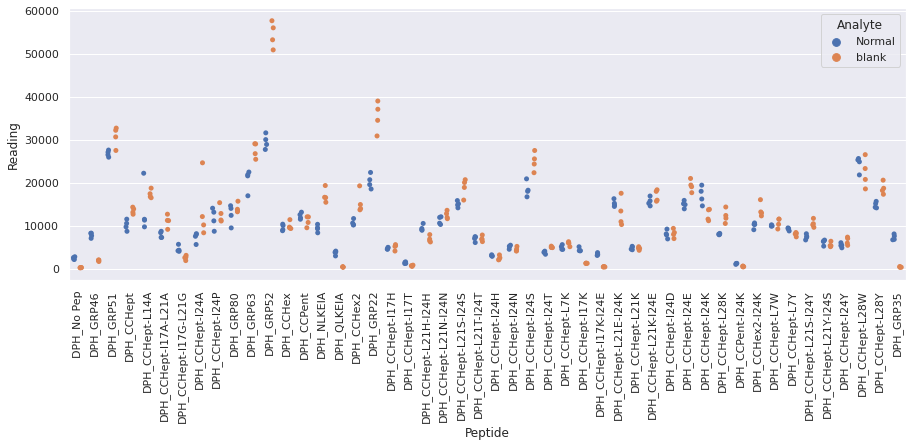

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_tenR3_repeat_10.xlsx
Drawing scatter plot of data spread for Normal_tenR3_repeat_10 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

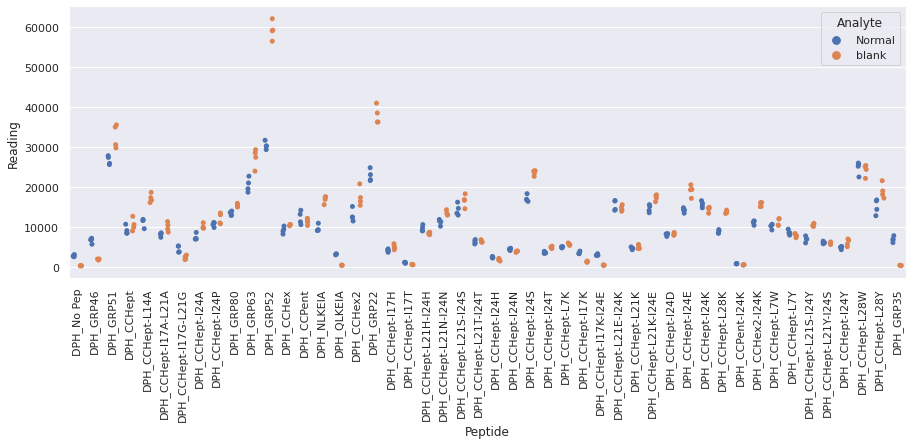

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_tenR4_repeat_10.xlsx
Drawing scatter plot of data spread for Normal_tenR4_repeat_10 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

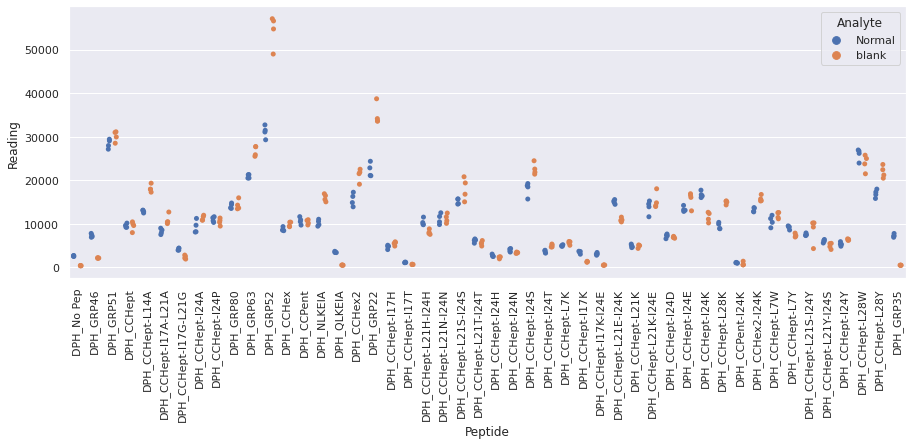

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfiveR1_repeat_11.xlsx
Drawing scatter plot of data spread for NASH_twentyfiveR1_repeat_11 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

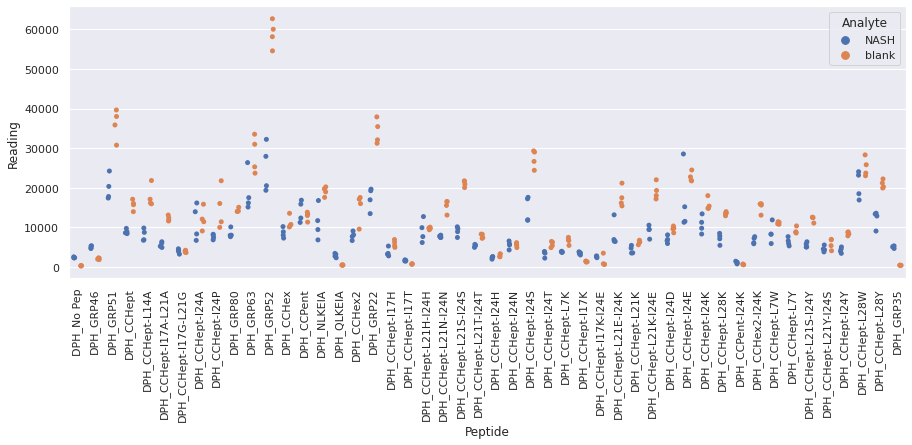

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfiveR2_repeat_11.xlsx
Drawing scatter plot of data spread for NASH_twentyfiveR2_repeat_11 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

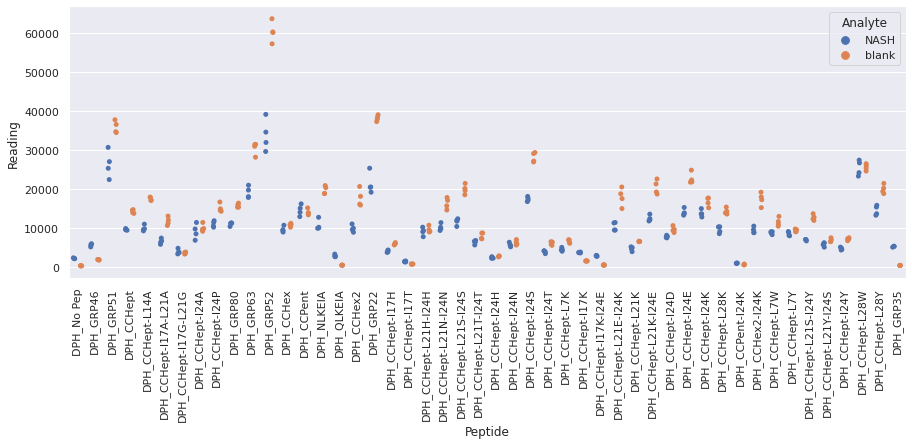

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfiveR3_repeat_11.xlsx
Drawing scatter plot of data spread for NASH_twentyfiveR3_repeat_11 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

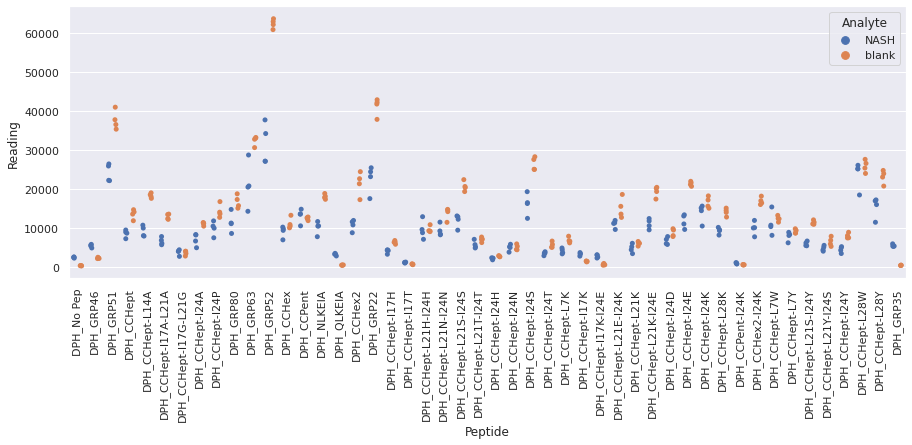

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfiveR4_repeat_11.xlsx
Drawing scatter plot of data spread for NASH_twentyfiveR4_repeat_11 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

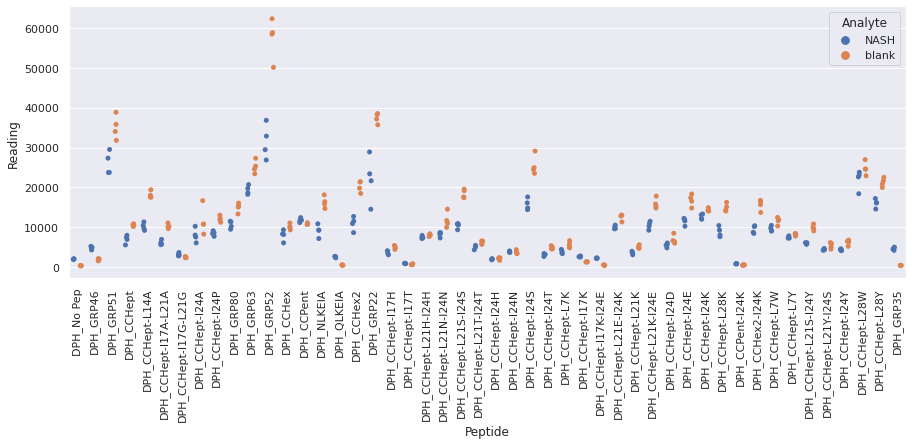

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_elevenR1_repeat_11.xlsx
Drawing scatter plot of data spread for Normal_elevenR1_repeat_11 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

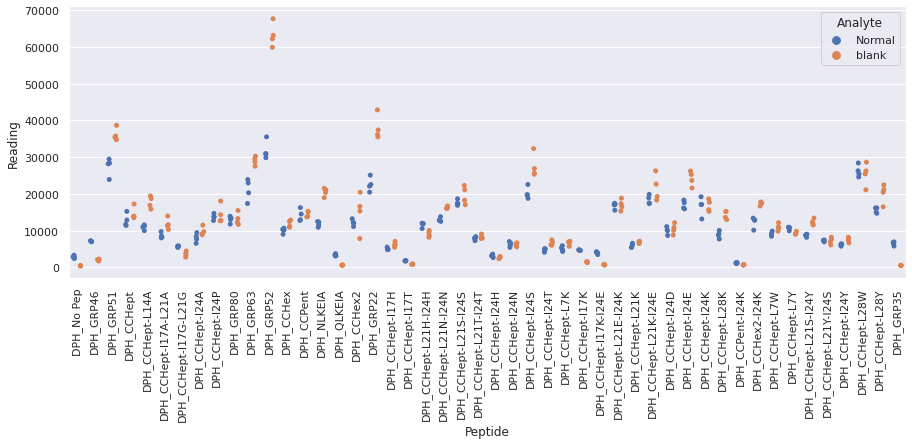

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_elevenR2_repeat_11.xlsx
Drawing scatter plot of data spread for Normal_elevenR2_repeat_11 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

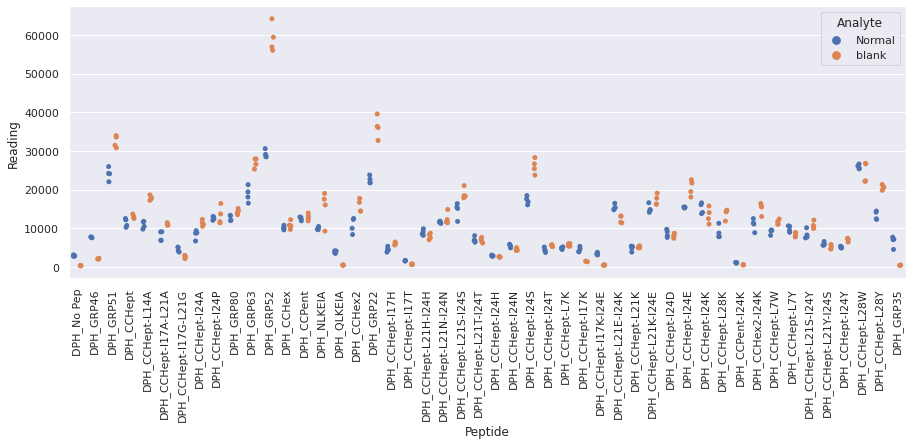

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_elevenR3_repeat_11.xlsx
Drawing scatter plot of data spread for Normal_elevenR3_repeat_11 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

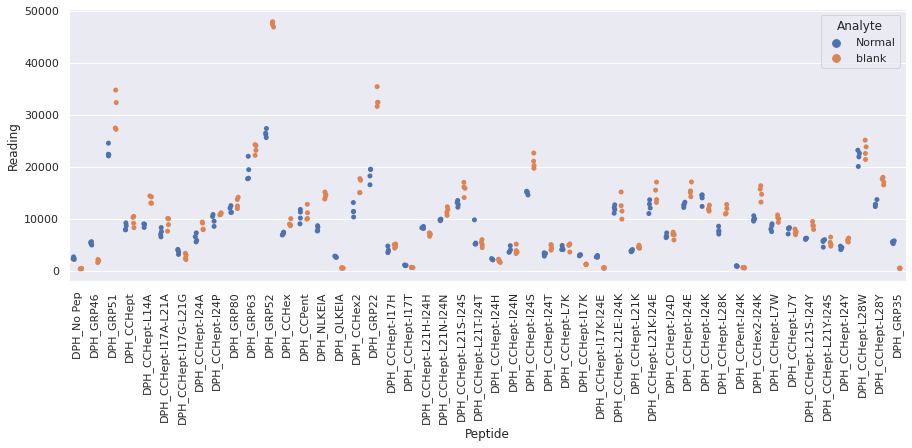

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_elevenR4_repeat_11.xlsx
Drawing scatter plot of data spread for Normal_elevenR4_repeat_11 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

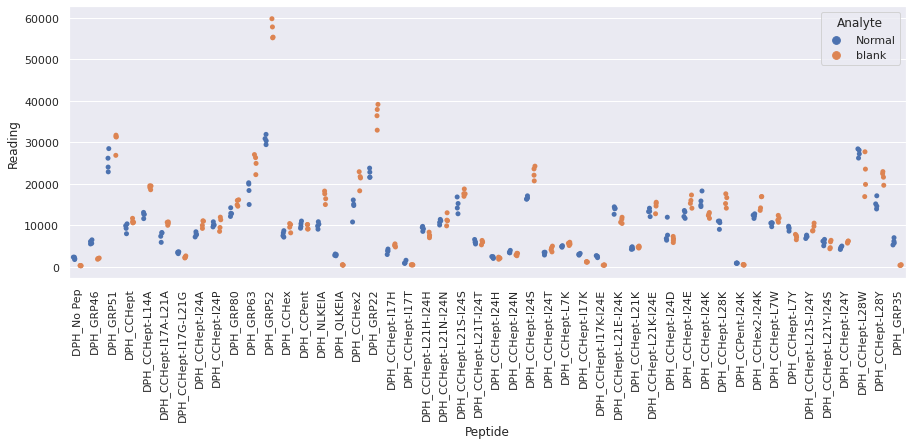

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysixR1_repeat_12.xlsx
Drawing scatter plot of data spread for NASH_twentysixR1_repeat_12 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

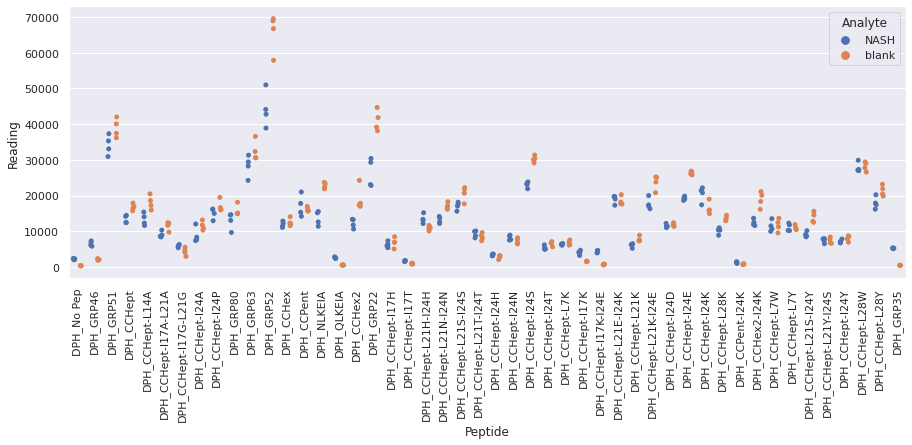

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysixR2_repeat_12.xlsx
Drawing scatter plot of data spread for NASH_twentysixR2_repeat_12 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

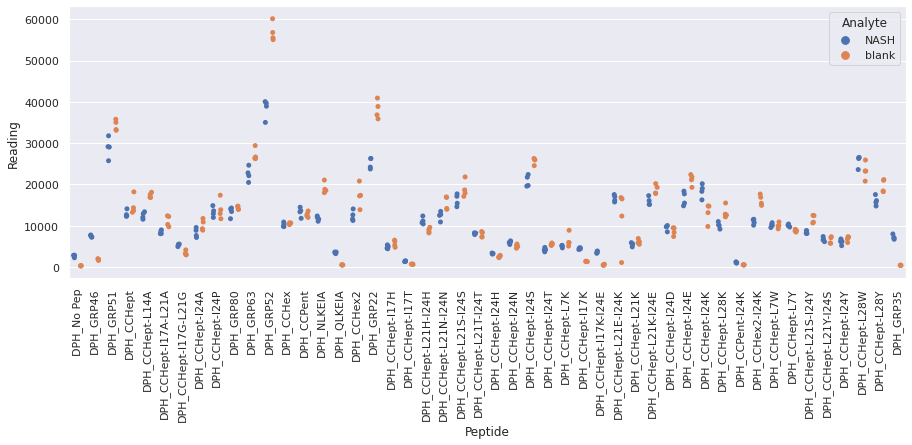

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysixR3_repeat_12.xlsx
Drawing scatter plot of data spread for NASH_twentysixR3_repeat_12 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

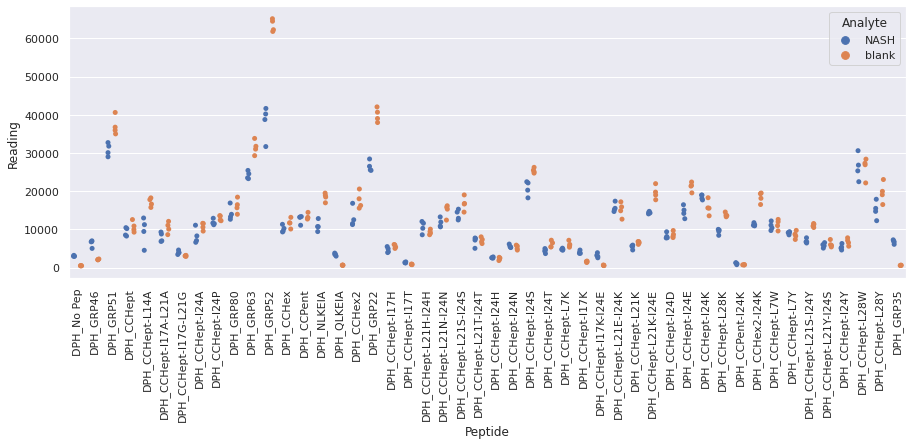

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysixR4_repeat_12.xlsx
Drawing scatter plot of data spread for NASH_twentysixR4_repeat_12 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

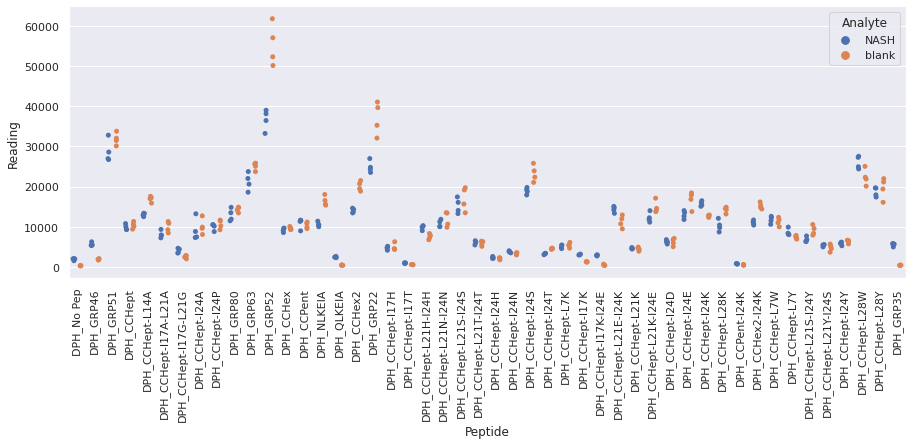

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twelveR1_repeat_12.xlsx
Drawing scatter plot of data spread for Normal_twelveR1_repeat_12 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

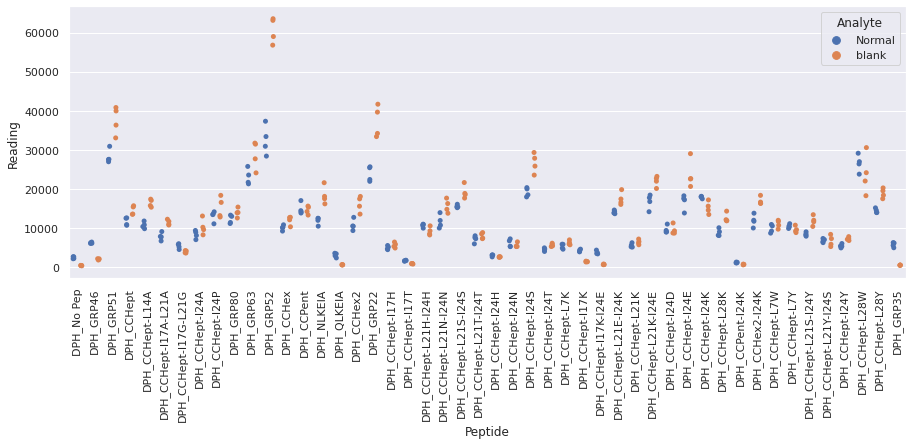

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twelveR2_repeat_12.xlsx
Drawing scatter plot of data spread for Normal_twelveR2_repeat_12 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

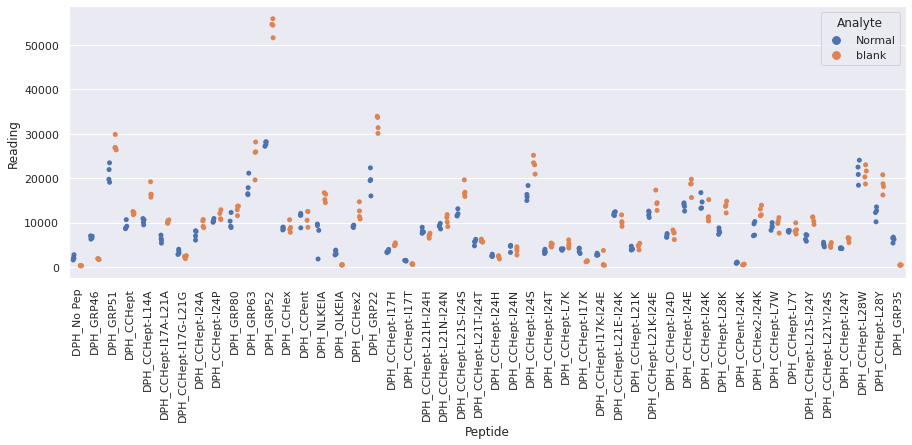

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twelveR3_repeat_12.xlsx
Drawing scatter plot of data spread for Normal_twelveR3_repeat_12 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

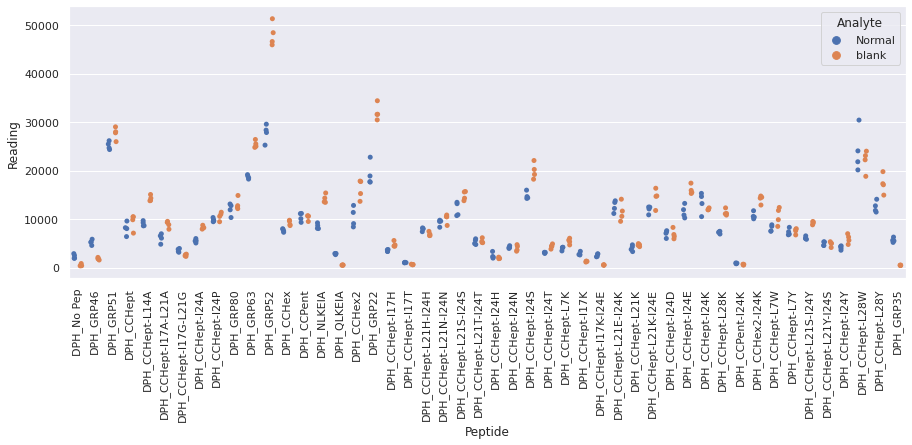

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twelveR4_repeat_12.xlsx
Drawing scatter plot of data spread for Normal_twelveR4_repeat_12 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

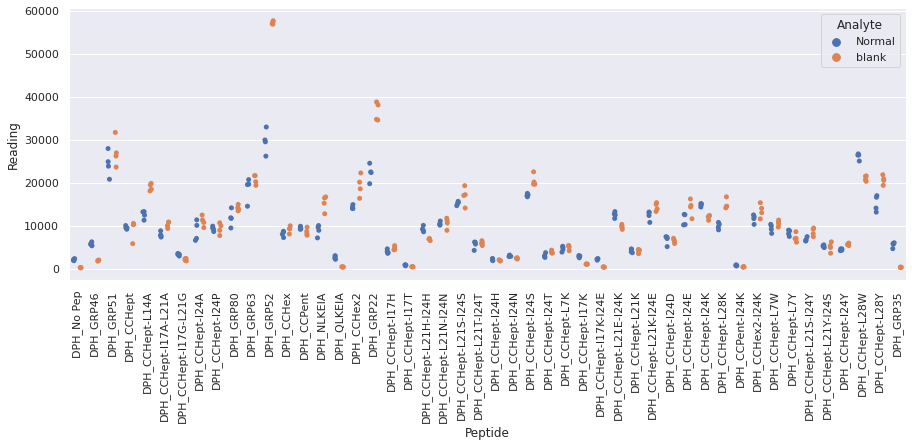

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysevenR1_repeat_13.xlsx
Drawing scatter plot of data spread for NASH_twentysevenR1_repeat_13 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

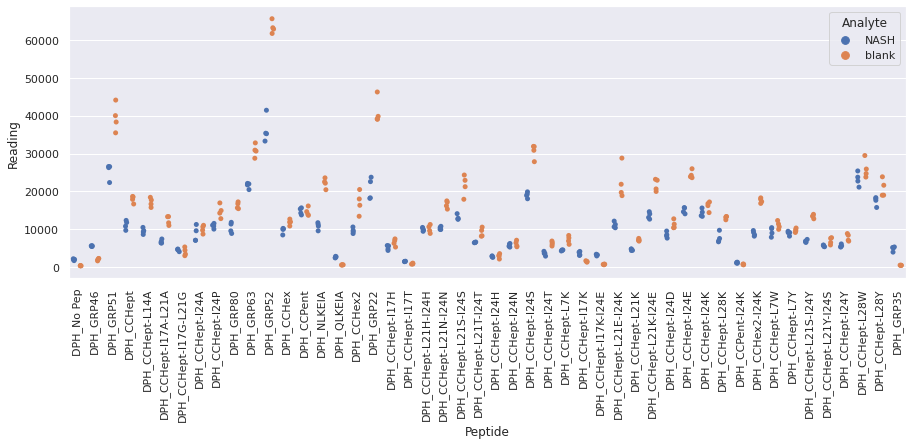

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysevenR2_repeat_13.xlsx
Drawing scatter plot of data spread for NASH_twentysevenR2_repeat_13 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

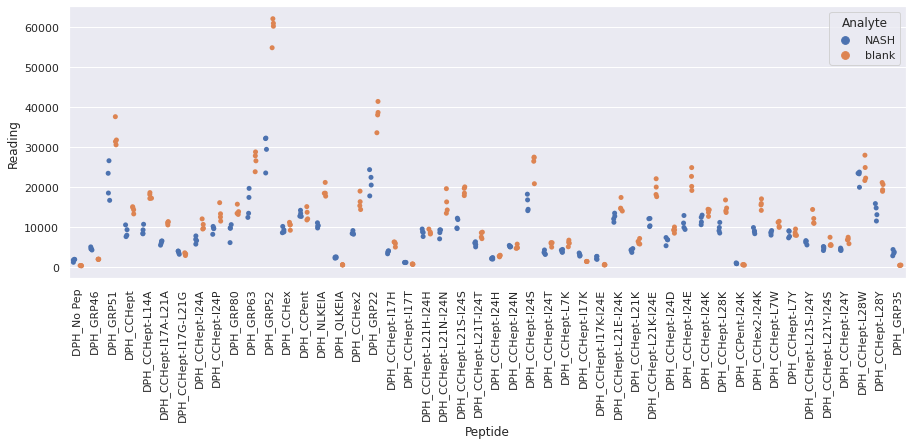

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysevenR3_repeat_13.xlsx
Drawing scatter plot of data spread for NASH_twentysevenR3_repeat_13 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

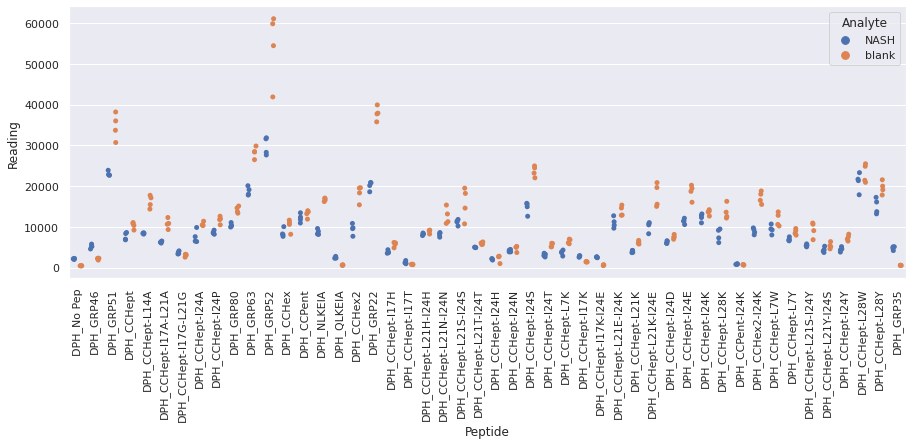

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysevenR4_repeat_13.xlsx
Drawing scatter plot of data spread for NASH_twentysevenR4_repeat_13 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

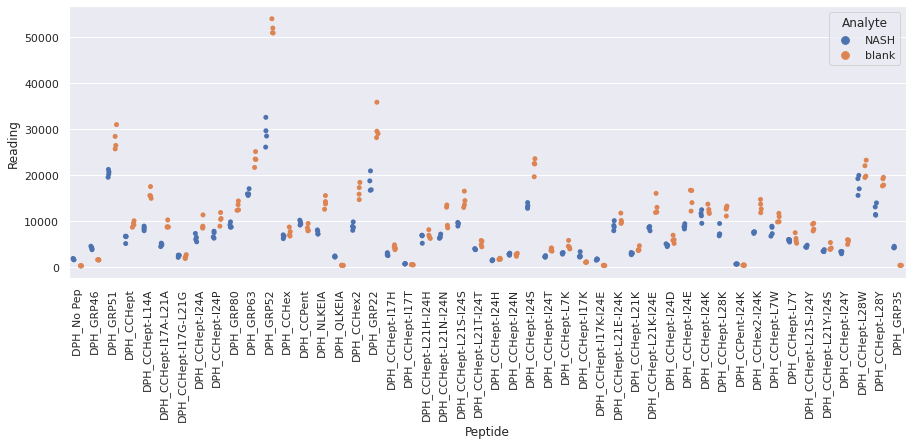

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirteenR1_repeat_13.xlsx
Drawing scatter plot of data spread for Normal_thirteenR1_repeat_13 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

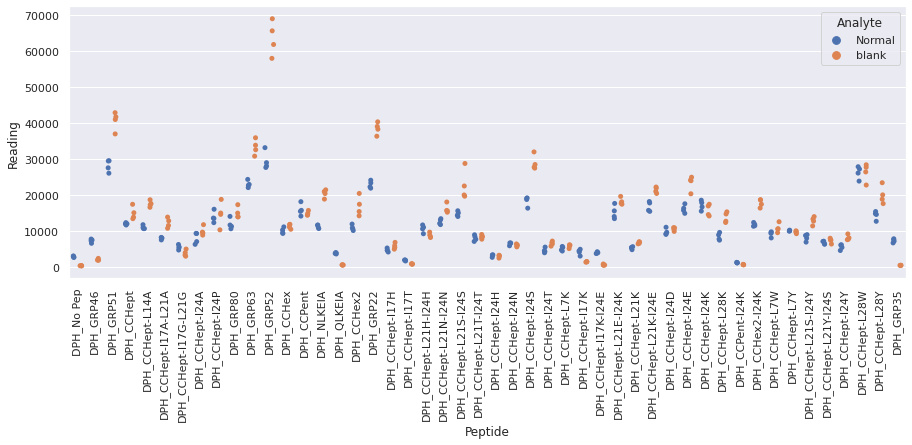

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirteenR2_repeat_13.xlsx
Drawing scatter plot of data spread for Normal_thirteenR2_repeat_13 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

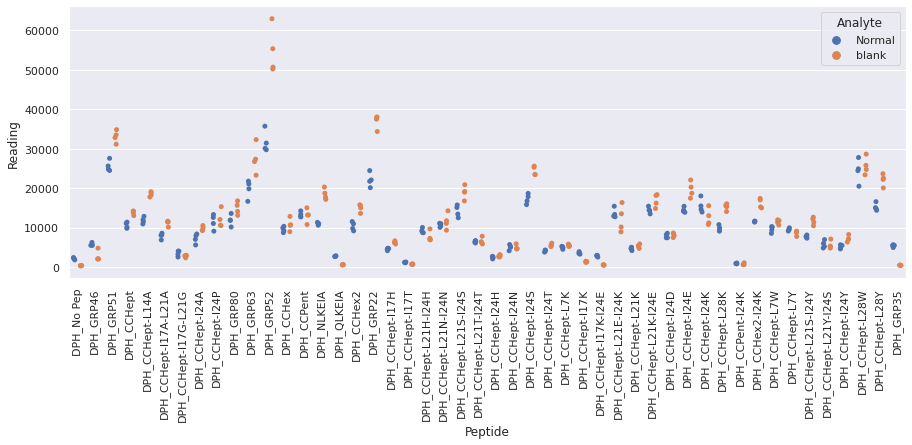

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirteenR3_repeat_13.xlsx
Drawing scatter plot of data spread for Normal_thirteenR3_repeat_13 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

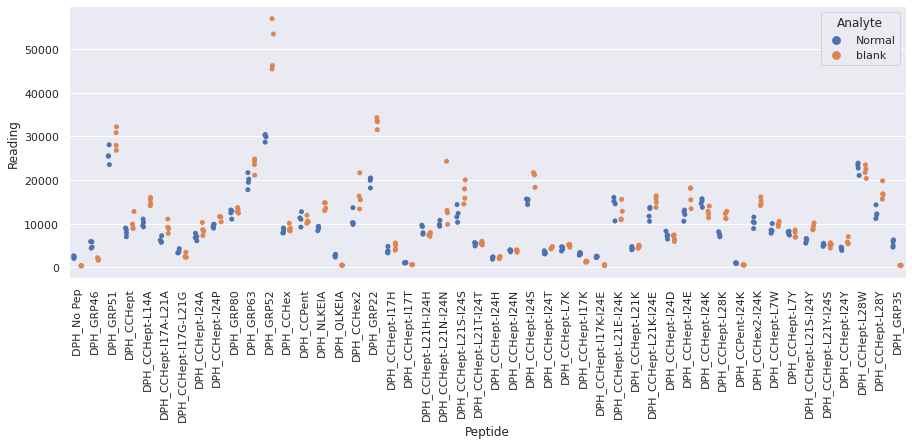

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirteenR4_repeat_13.xlsx
Drawing scatter plot of data spread for Normal_thirteenR4_repeat_13 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

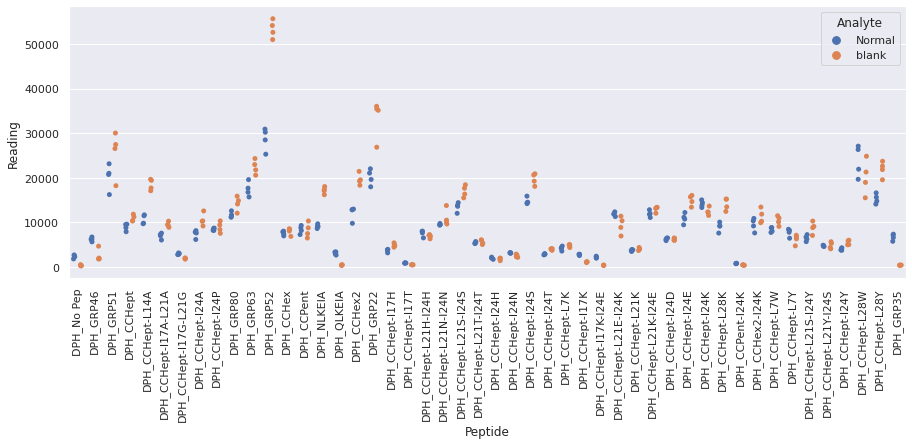

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyeightR1_repeat_14.xlsx
Drawing scatter plot of data spread for NASH_twentyeightR1_repeat_14 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

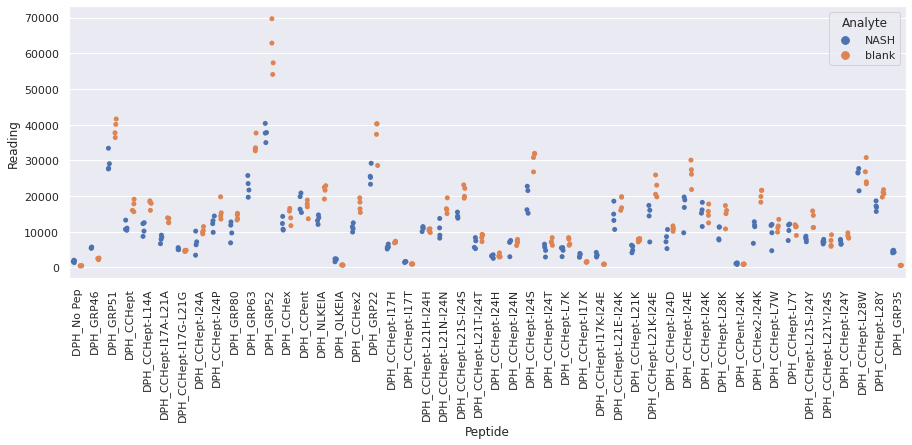

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyeightR2_repeat_14.xlsx
Drawing scatter plot of data spread for NASH_twentyeightR2_repeat_14 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

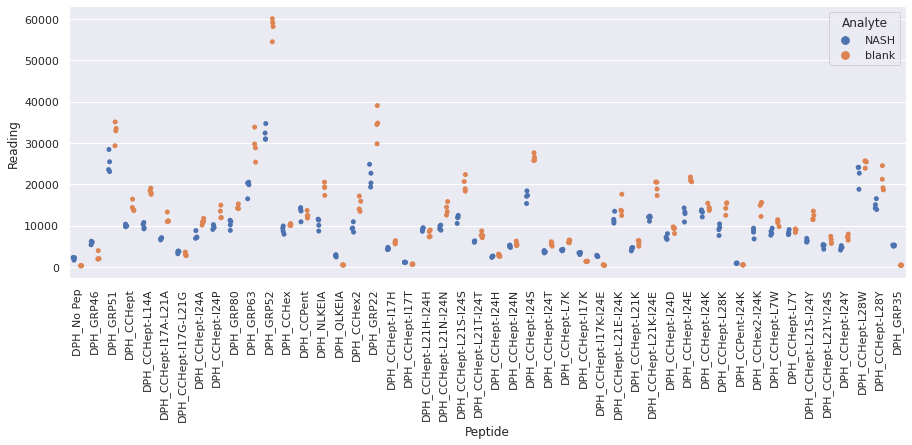

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyeightR3_repeat_14.xlsx
Drawing scatter plot of data spread for NASH_twentyeightR3_repeat_14 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

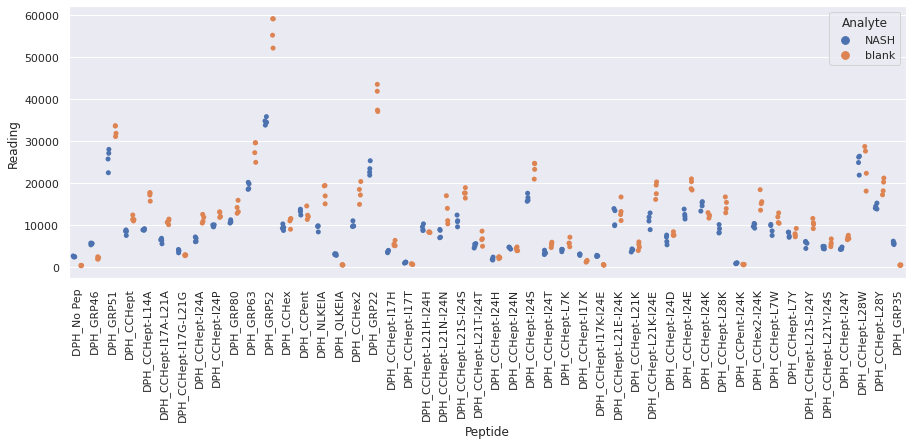

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyeightR4_repeat_14.xlsx
Drawing scatter plot of data spread for NASH_twentyeightR4_repeat_14 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

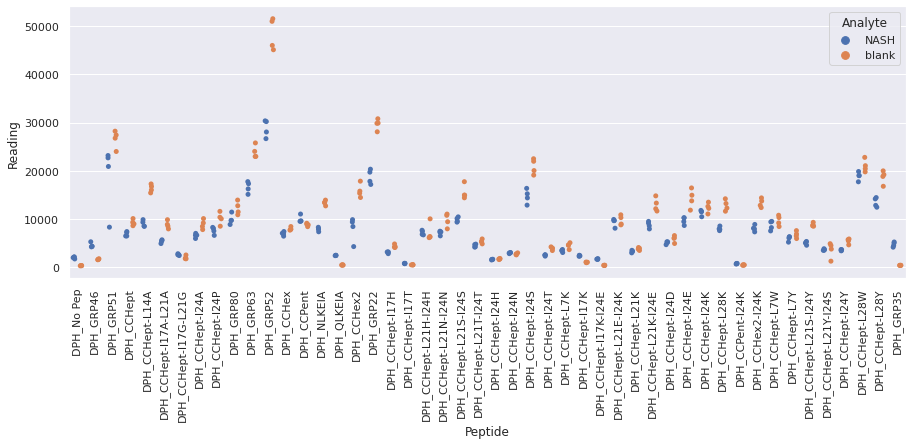

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourteenR1_repeat_14.xlsx
Drawing scatter plot of data spread for Normal_fourteenR1_repeat_14 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

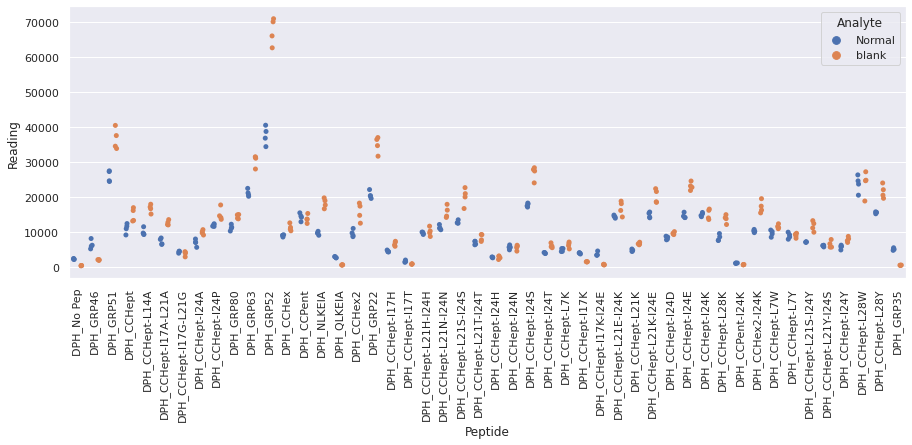

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourteenR2_repeat_14.xlsx
Drawing scatter plot of data spread for Normal_fourteenR2_repeat_14 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

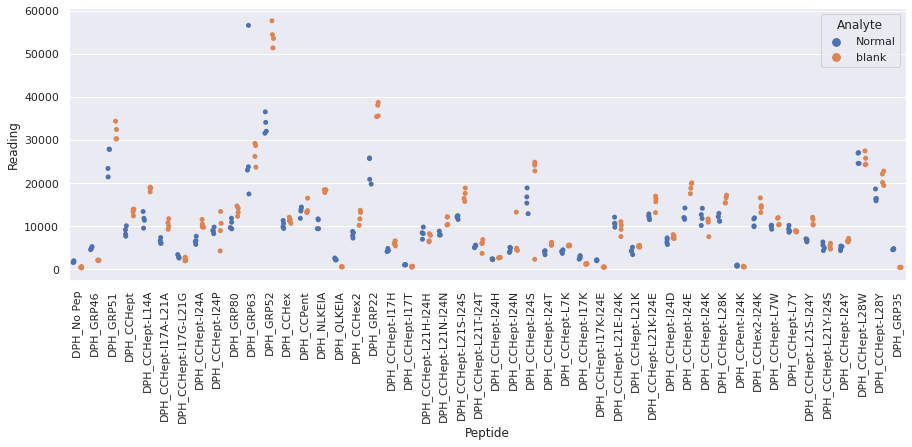

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourteenR3_repeat_14.xlsx
Drawing scatter plot of data spread for Normal_fourteenR3_repeat_14 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

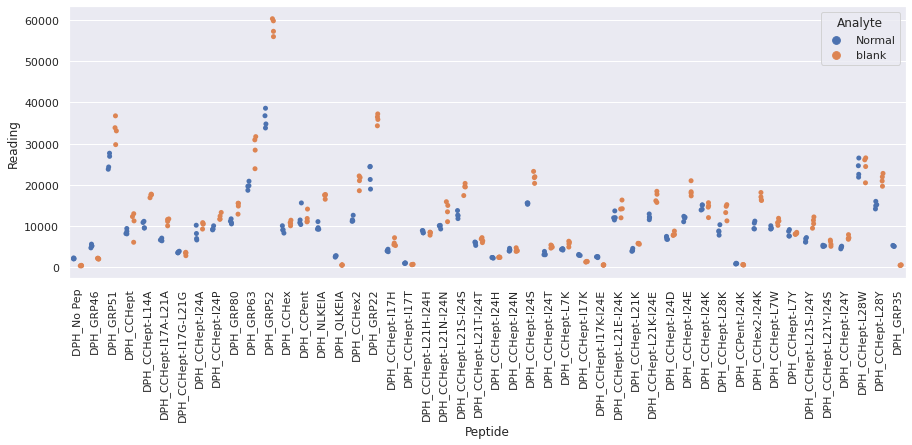

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourteenR4_repeat_14.xlsx
Drawing scatter plot of data spread for Normal_fourteenR4_repeat_14 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

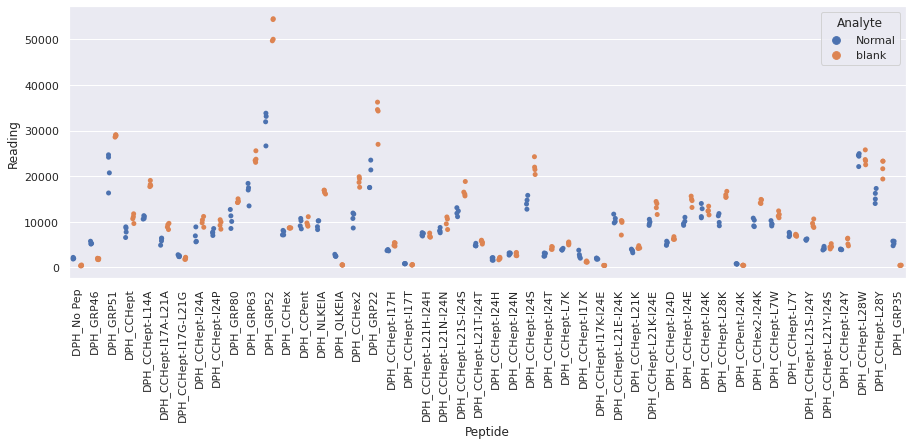

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twentynineR1_repeat_15.xlsx
Drawing scatter plot of data spread for Normal_twentynineR1_repeat_15 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

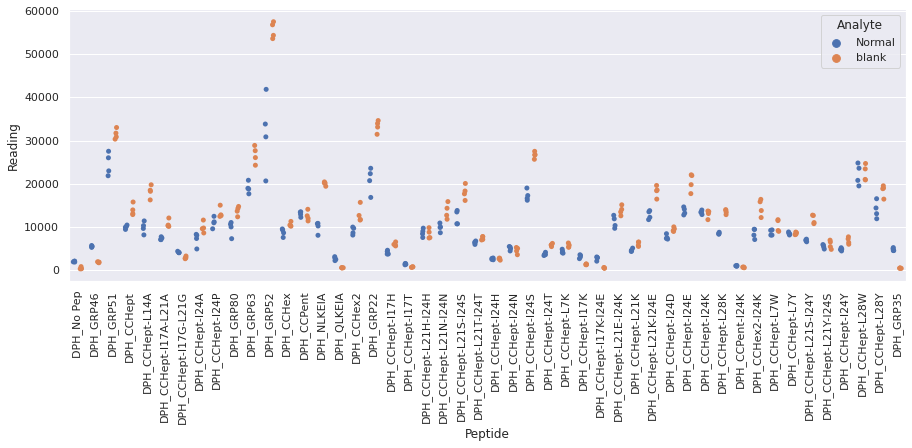

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twentynineR2_repeat_15.xlsx
Drawing scatter plot of data spread for Normal_twentynineR2_repeat_15 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

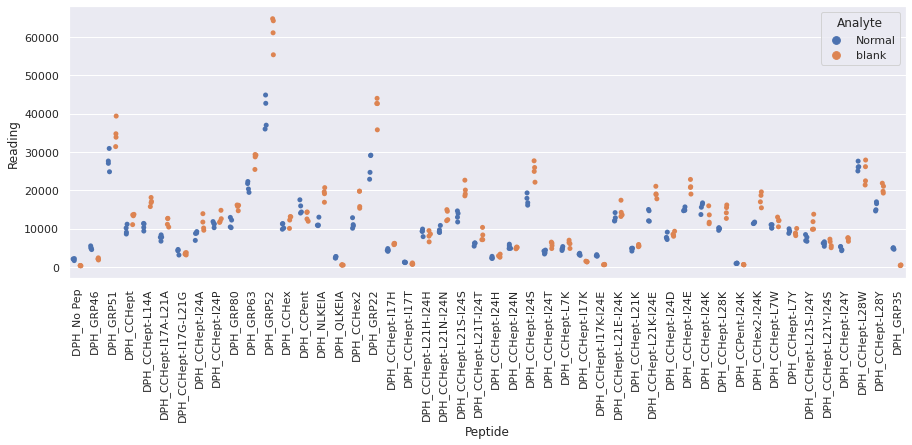

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twentynineR3_repeat_15.xlsx
Drawing scatter plot of data spread for Normal_twentynineR3_repeat_15 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

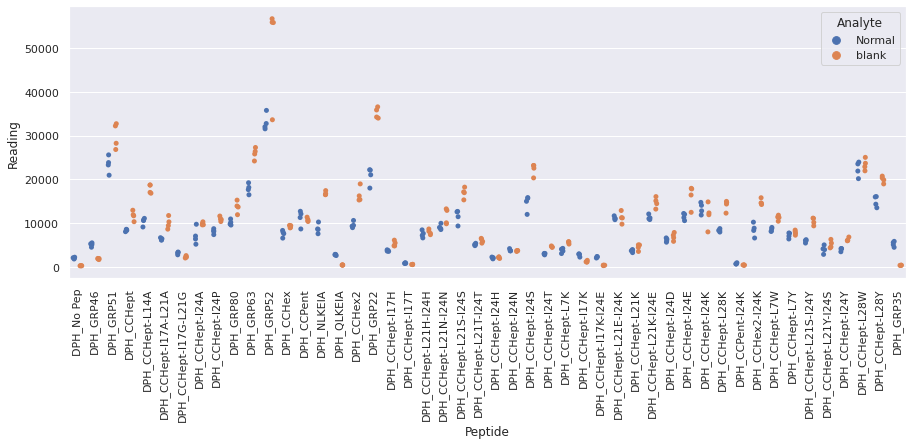

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twentynineR4_repeat_15.xlsx
Drawing scatter plot of data spread for Normal_twentynineR4_repeat_15 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

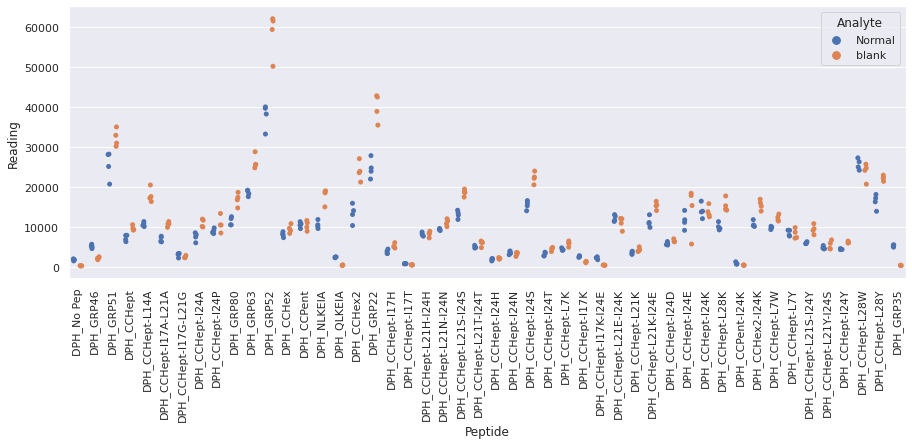

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR1_repeat_16.xlsx
Drawing scatter plot of data spread for Normal_thirtyR1_repeat_16 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

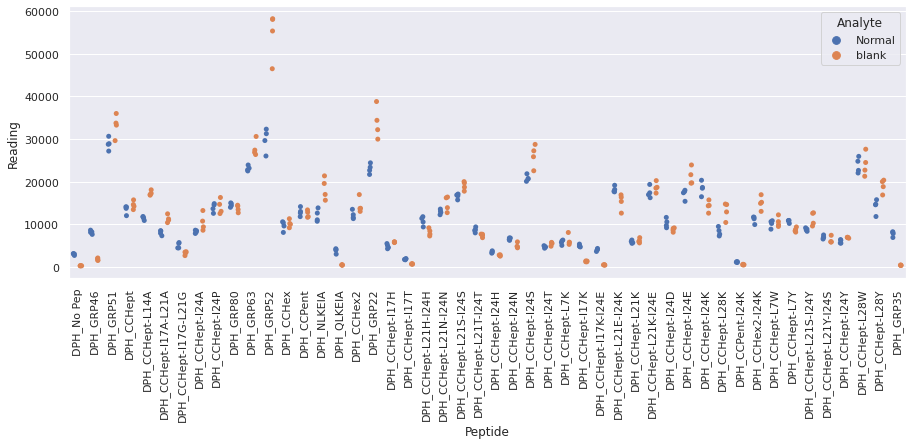

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR2_repeat_16.xlsx
Drawing scatter plot of data spread for Normal_thirtyR2_repeat_16 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

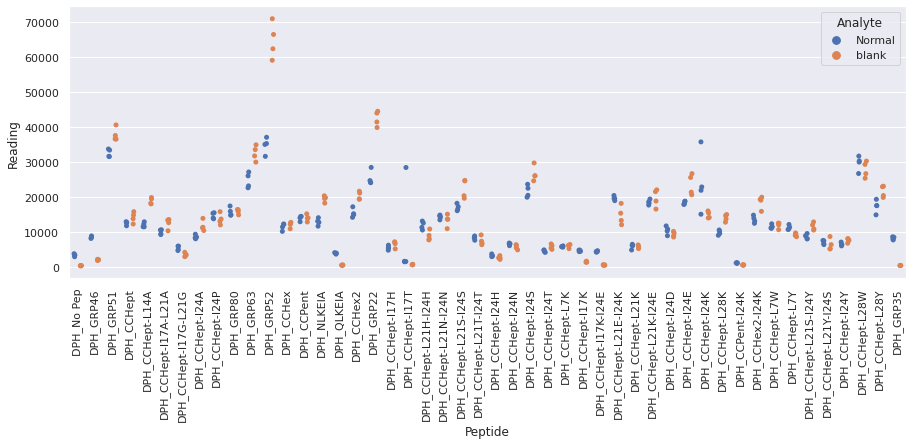

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR3_repeat_16.xlsx
Drawing scatter plot of data spread for Normal_thirtyR3_repeat_16 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

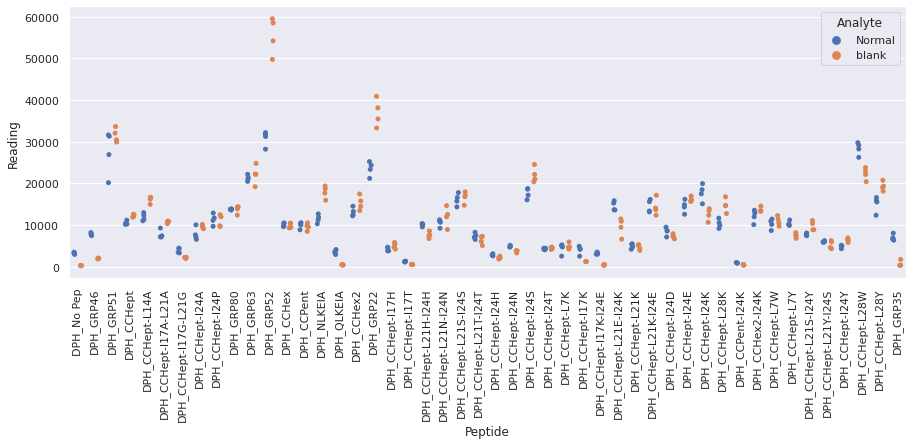

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR4_repeat_16.xlsx
Drawing scatter plot of data spread for Normal_thirtyR4_repeat_16 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

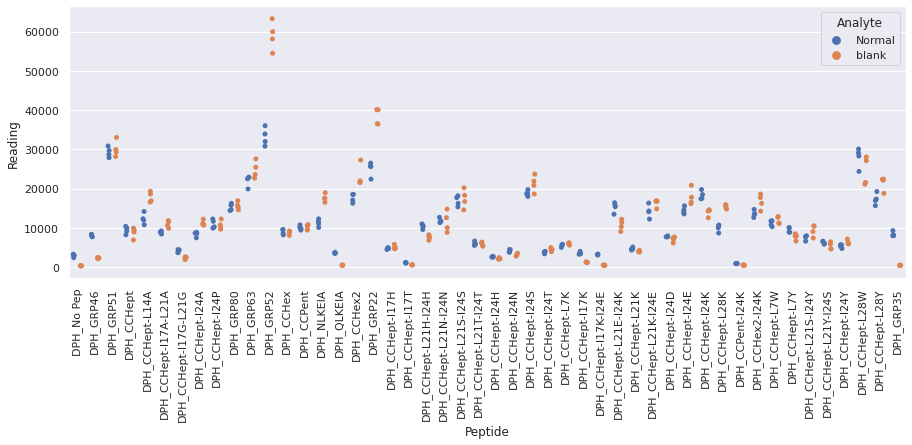

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyoneR1_repeat_17.xlsx
Drawing scatter plot of data spread for Normal_thirtyoneR1_repeat_17 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

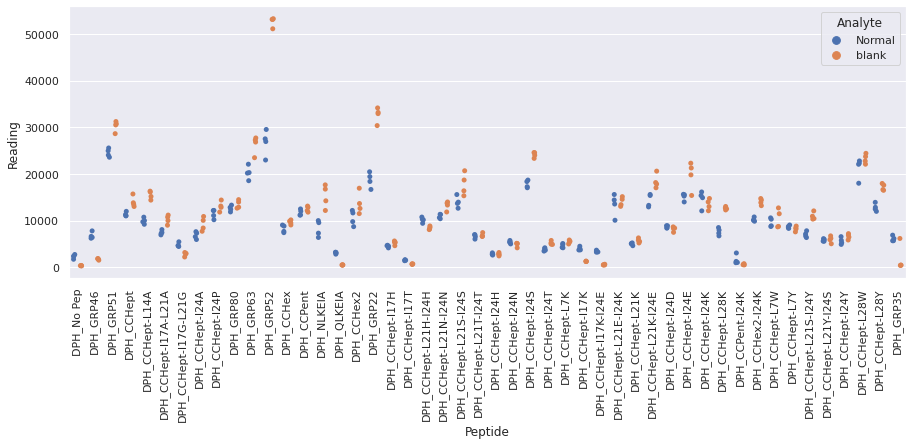

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyoneR2_repeat_17.xlsx
Drawing scatter plot of data spread for Normal_thirtyoneR2_repeat_17 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

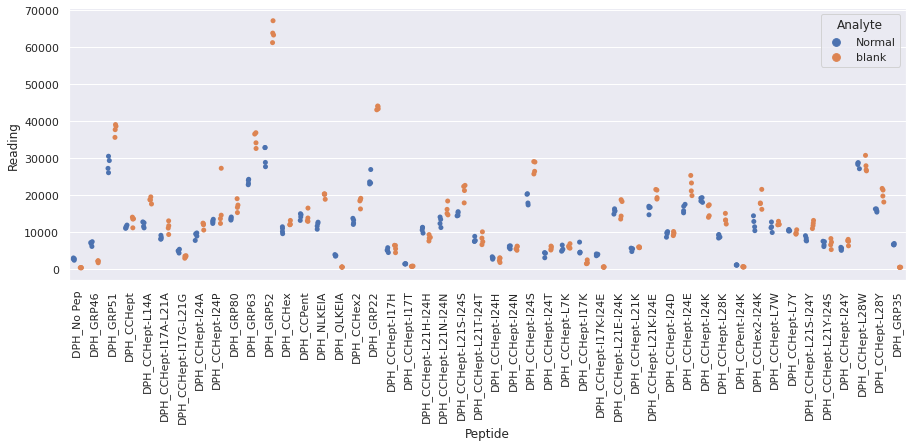

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyoneR3_repeat_17.xlsx
Drawing scatter plot of data spread for Normal_thirtyoneR3_repeat_17 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

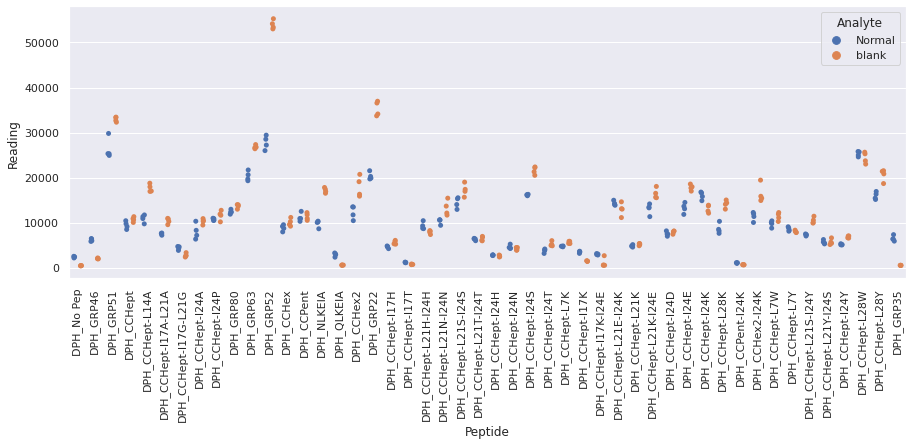

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyoneR4_repeat_17.xlsx
Drawing scatter plot of data spread for Normal_thirtyoneR4_repeat_17 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

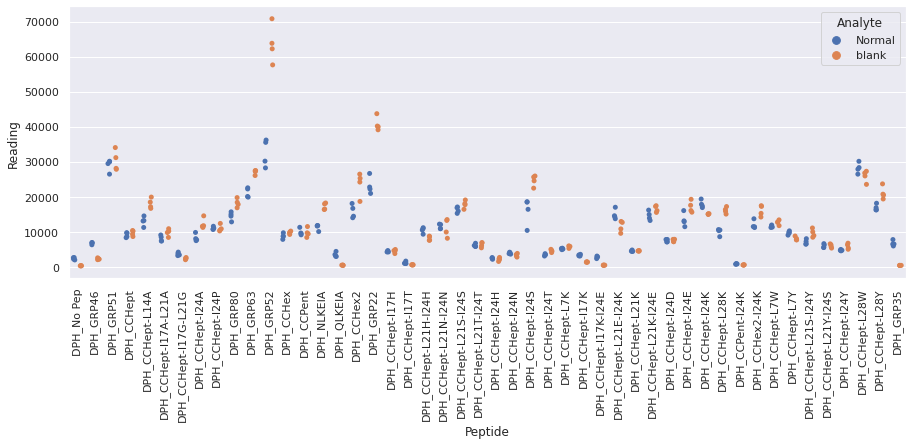

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR1_repeat_18.xlsx
Drawing scatter plot of data spread for Normal_thirtytwoR1_repeat_18 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

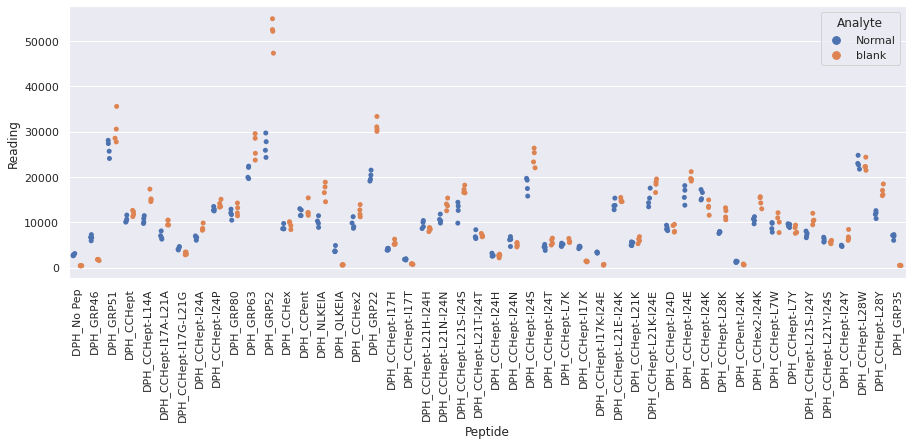

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR2_repeat_18.xlsx
Drawing scatter plot of data spread for Normal_thirtytwoR2_repeat_18 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

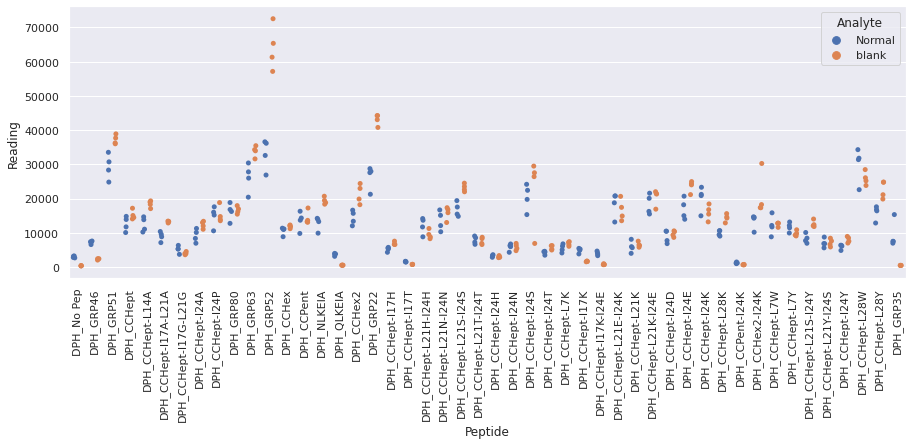

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR3_repeat_18.xlsx
Drawing scatter plot of data spread for Normal_thirtytwoR3_repeat_18 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

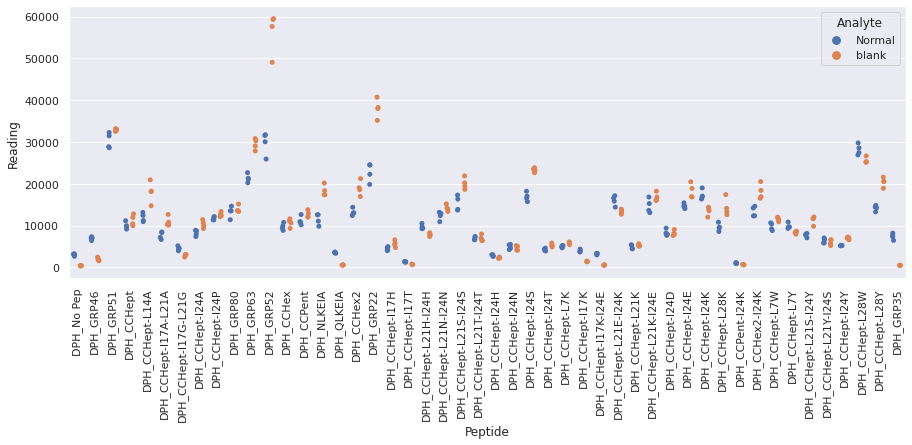

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR4_repeat_18.xlsx
Drawing scatter plot of data spread for Normal_thirtytwoR4_repeat_18 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

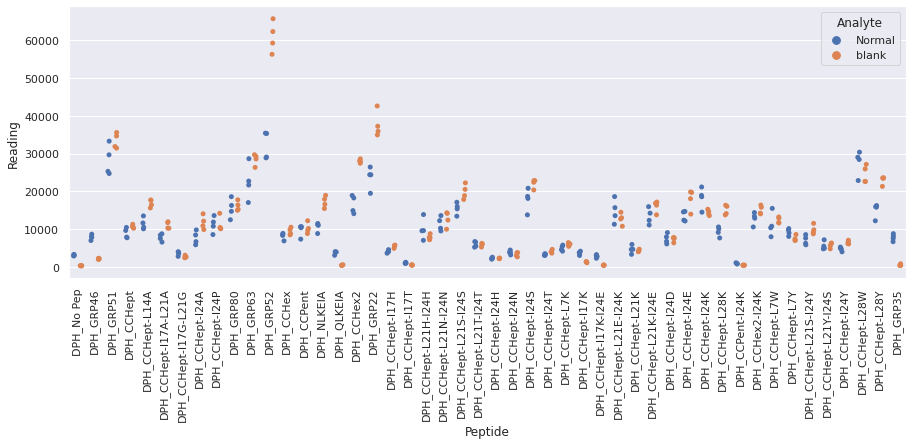

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR1_repeat_19.xlsx
Drawing scatter plot of data spread for Normal_thirtythreeR1_repeat_19 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

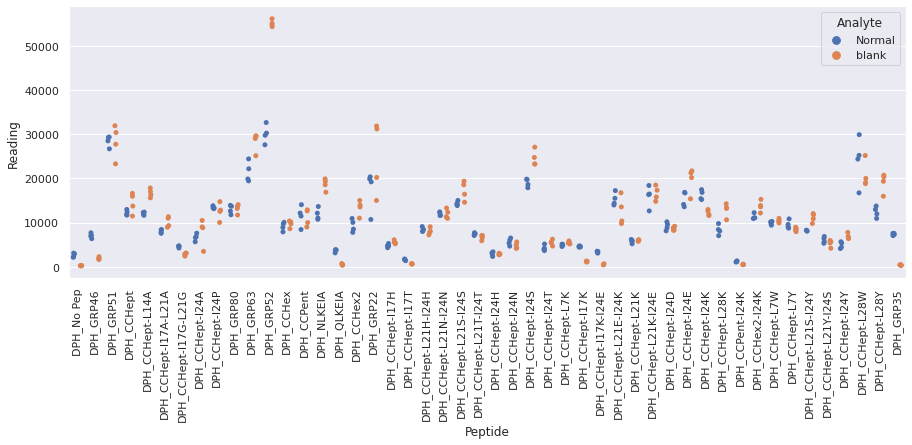

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR2_repeat_19.xlsx
Drawing scatter plot of data spread for Normal_thirtythreeR2_repeat_19 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

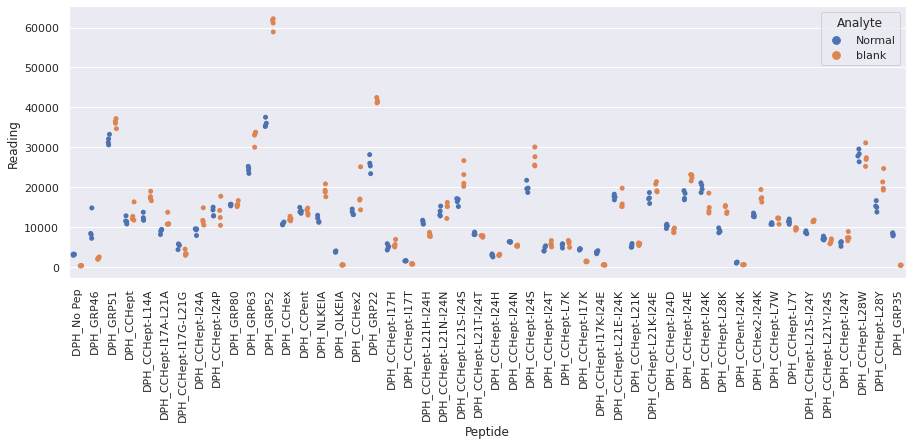

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR3_repeat_19.xlsx
Drawing scatter plot of data spread for Normal_thirtythreeR3_repeat_19 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

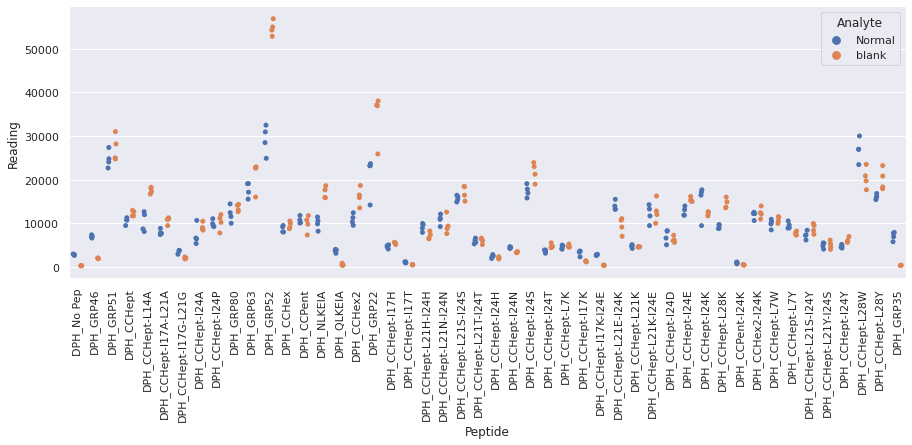

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR4_repeat_19.xlsx
Drawing scatter plot of data spread for Normal_thirtythreeR4_repeat_19 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

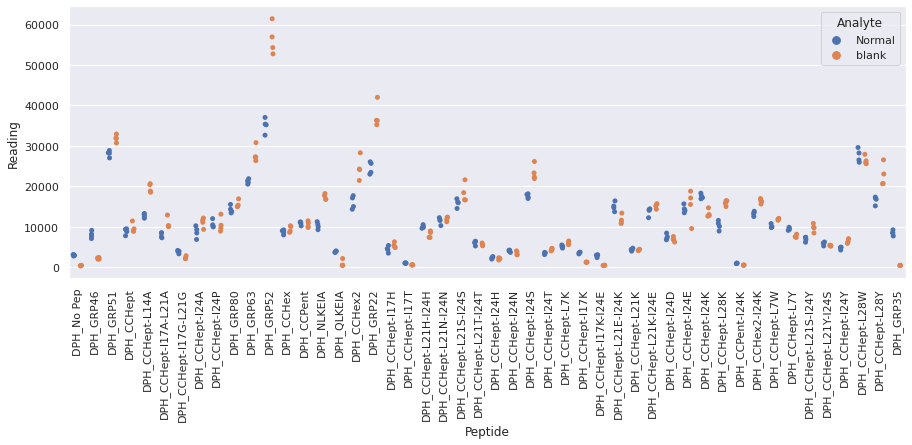

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfourR1_repeat_20.xlsx
Drawing scatter plot of data spread for Normal_thirtyfourR1_repeat_20 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

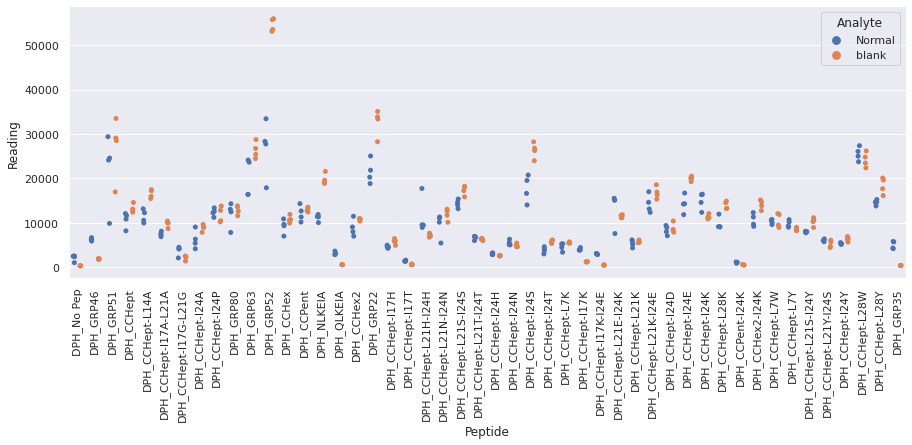

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfourR2_repeat_20.xlsx
Drawing scatter plot of data spread for Normal_thirtyfourR2_repeat_20 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

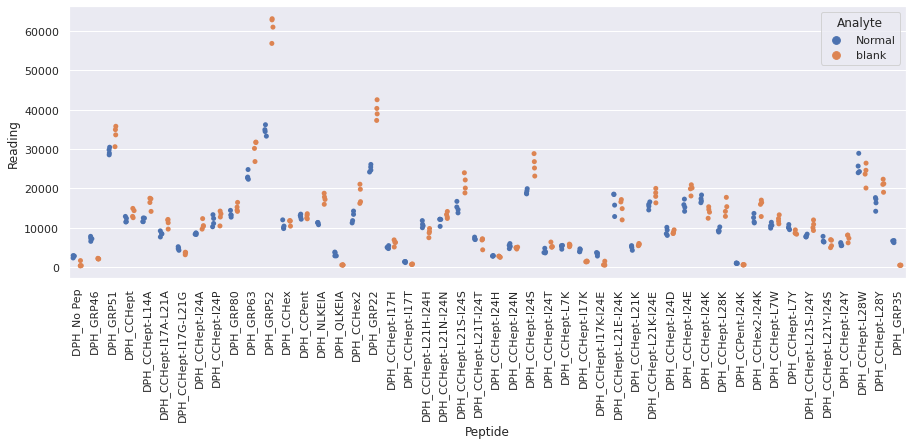

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfourR3_repeat_20.xlsx
Drawing scatter plot of data spread for Normal_thirtyfourR3_repeat_20 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

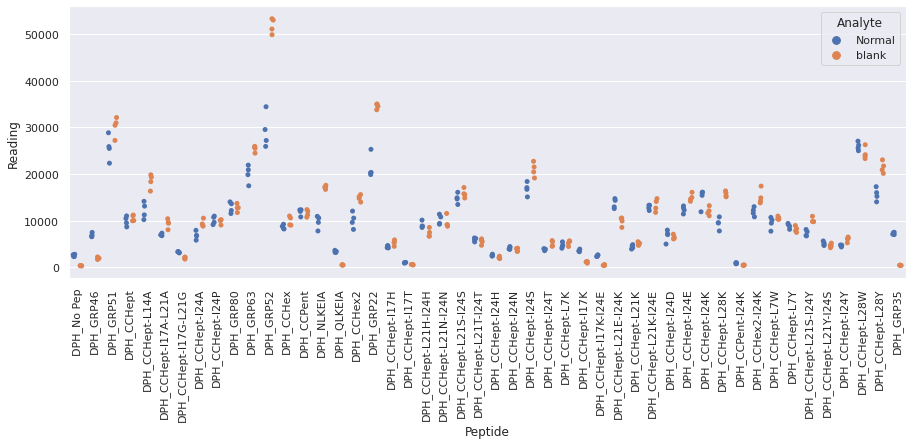

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfourR4_repeat_20.xlsx
Drawing scatter plot of data spread for Normal_thirtyfourR4_repeat_20 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

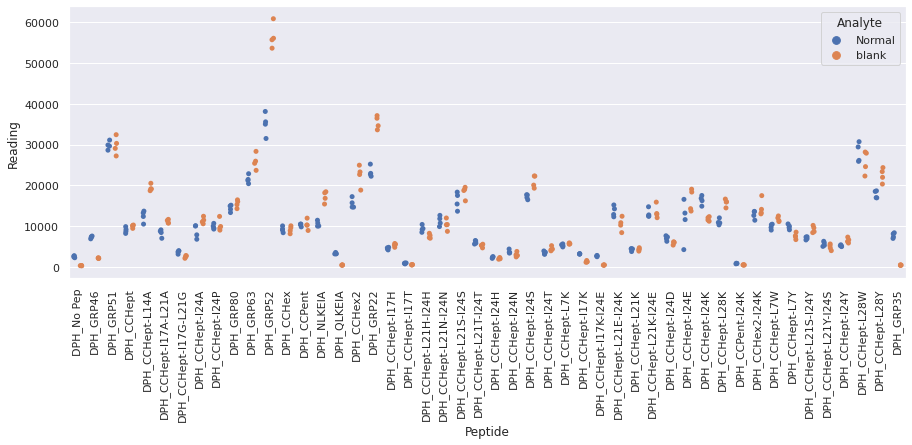

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfiveR1_repeat_21.xlsx
Drawing scatter plot of data spread for Normal_thirtyfiveR1_repeat_21 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

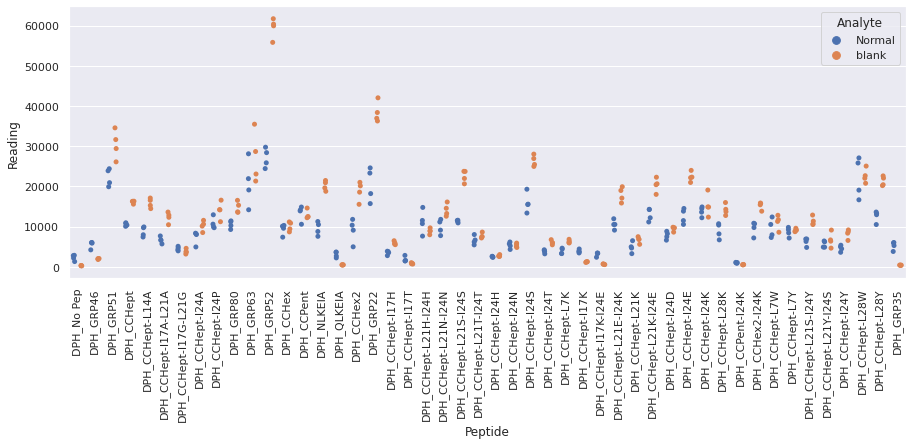

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfiveR2_repeat_21.xlsx
Drawing scatter plot of data spread for Normal_thirtyfiveR2_repeat_21 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

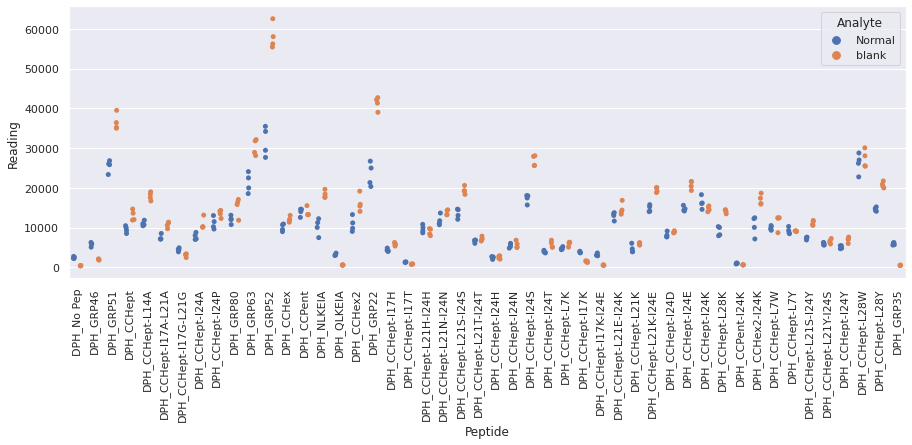

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfiveR3_repeat_21.xlsx
Drawing scatter plot of data spread for Normal_thirtyfiveR3_repeat_21 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

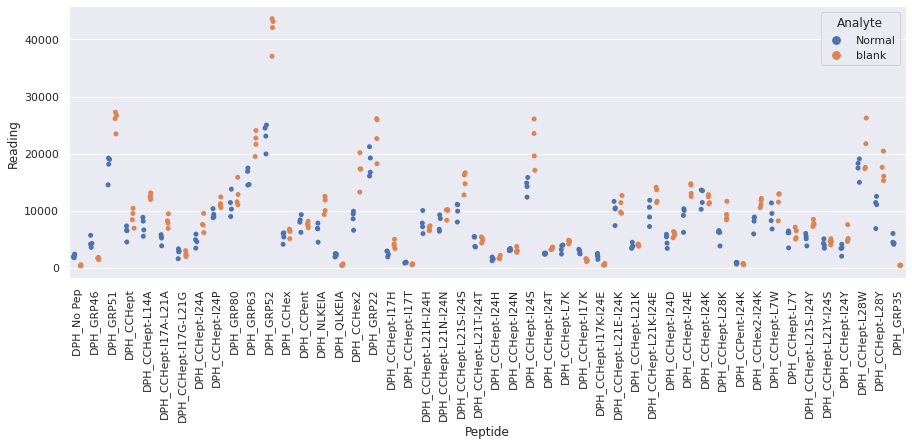

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfiveR4_repeat_21.xlsx
Drawing scatter plot of data spread for Normal_thirtyfiveR4_repeat_21 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

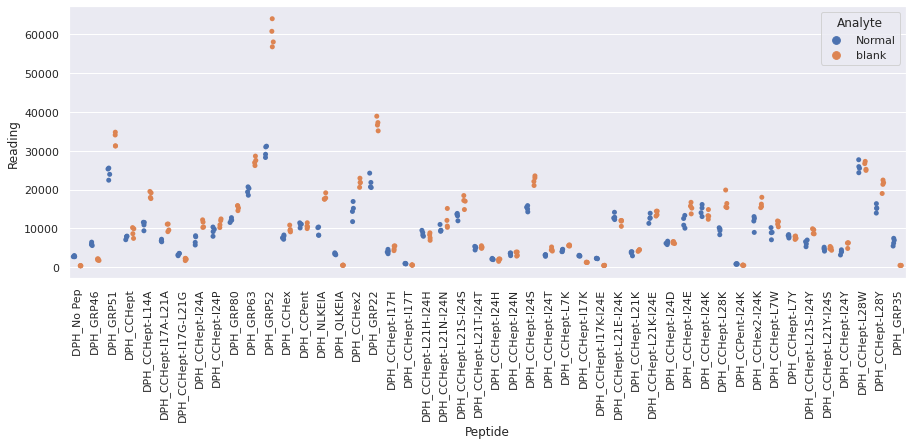

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysixR1_repeat_22.xlsx
Drawing scatter plot of data spread for Normal_thirtysixR1_repeat_22 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

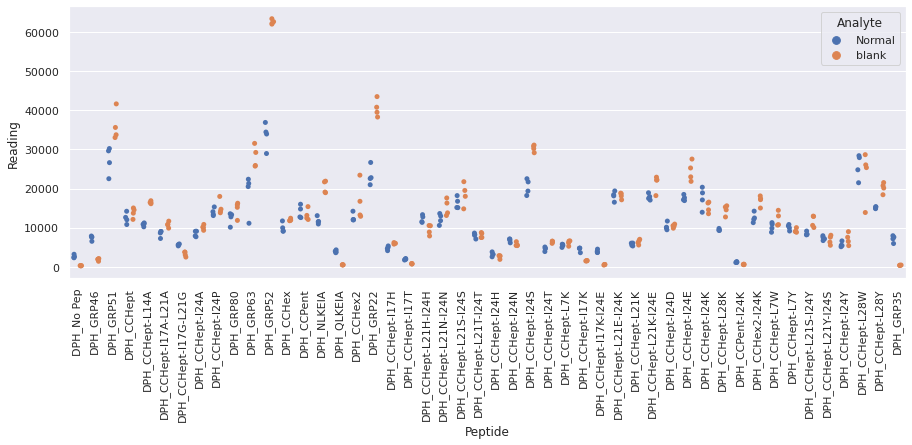

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysixR2_repeat_22.xlsx
Drawing scatter plot of data spread for Normal_thirtysixR2_repeat_22 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

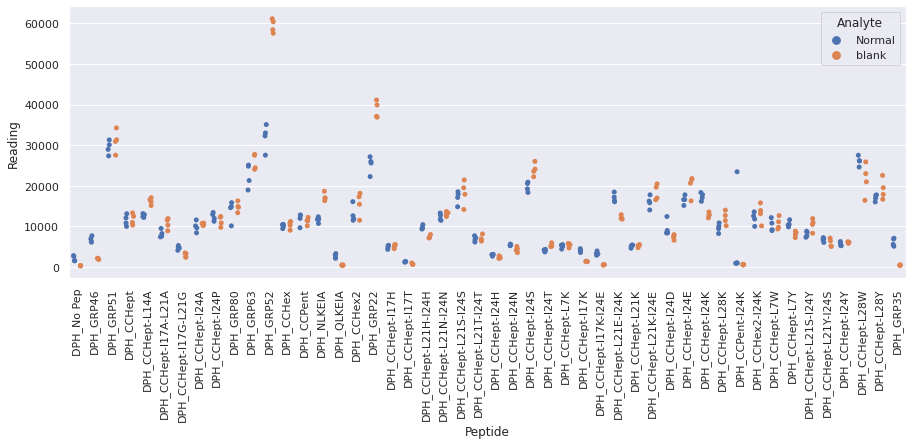

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysixR3_repeat_22.xlsx
Drawing scatter plot of data spread for Normal_thirtysixR3_repeat_22 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

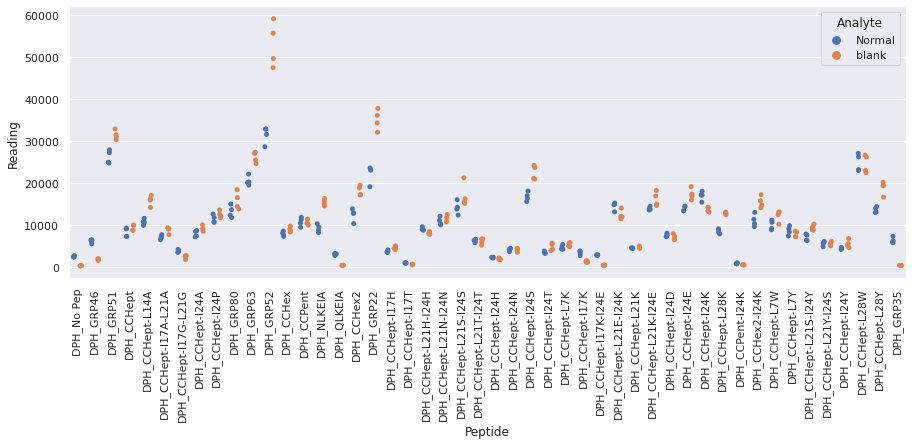

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysixR4_repeat_22.xlsx
Drawing scatter plot of data spread for Normal_thirtysixR4_repeat_22 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

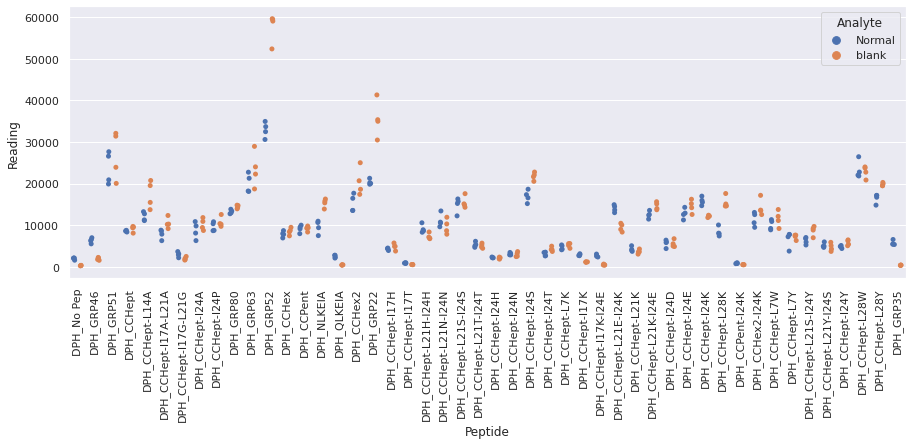

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR1_repeat_23.xlsx
Drawing scatter plot of data spread for Normal_thirtysevenR1_repeat_23 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

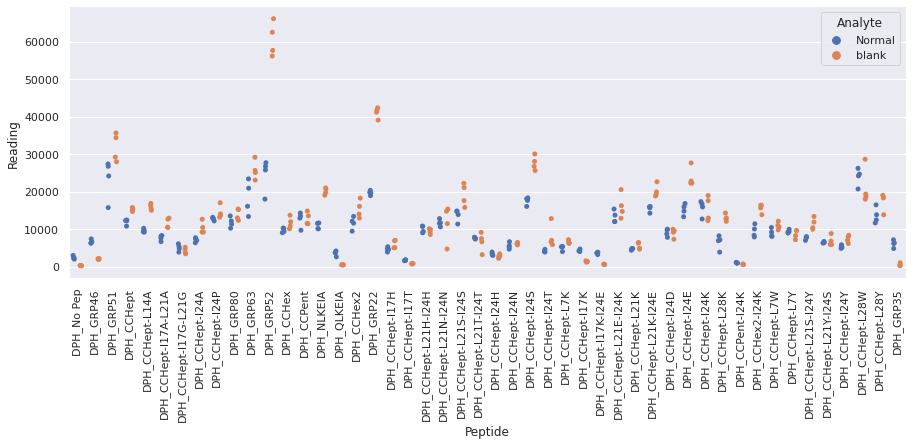

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR2_repeat_23.xlsx
Drawing scatter plot of data spread for Normal_thirtysevenR2_repeat_23 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

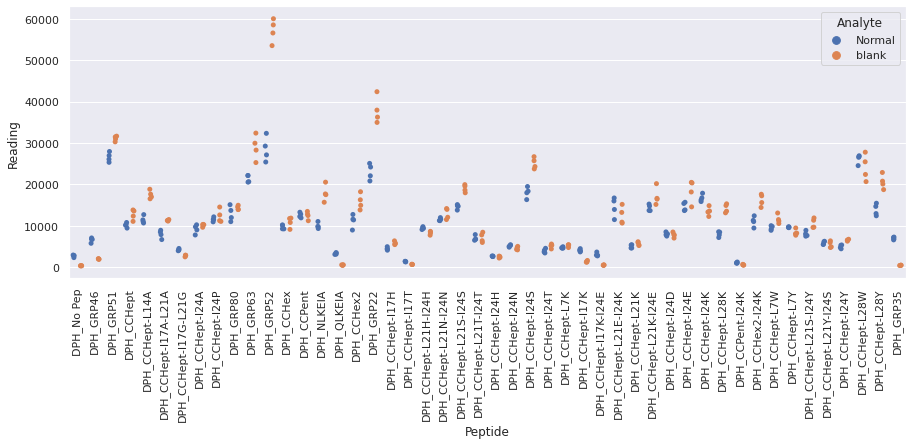

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR3_repeat_23.xlsx
Drawing scatter plot of data spread for Normal_thirtysevenR3_repeat_23 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

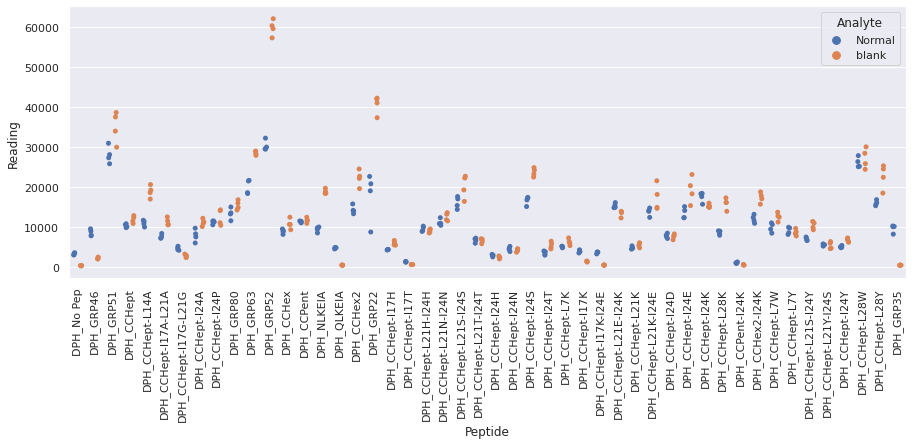

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR4_repeat_23.xlsx
Drawing scatter plot of data spread for Normal_thirtysevenR4_repeat_23 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

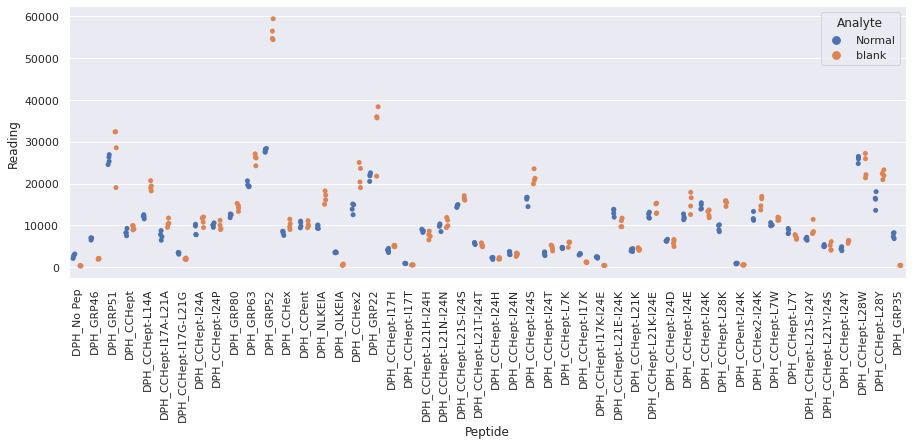

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR1_repeat_24.xlsx
Drawing scatter plot of data spread for Normal_thirtyeightR1_repeat_24 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

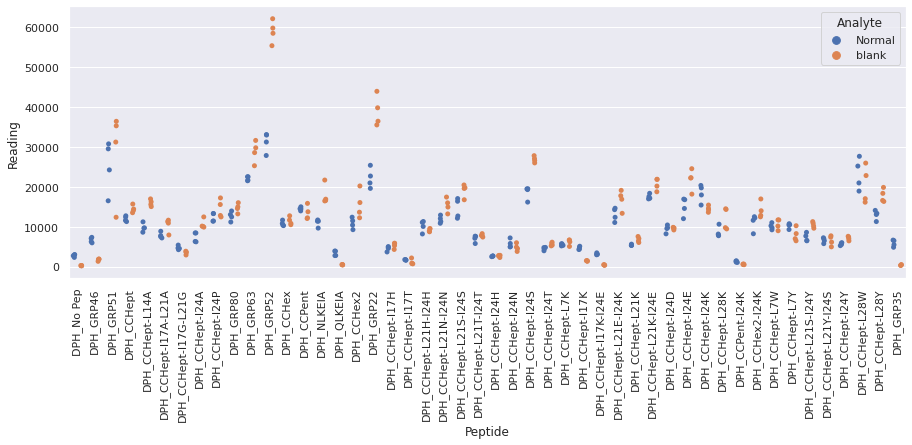

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR2_repeat_24.xlsx
Drawing scatter plot of data spread for Normal_thirtyeightR2_repeat_24 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

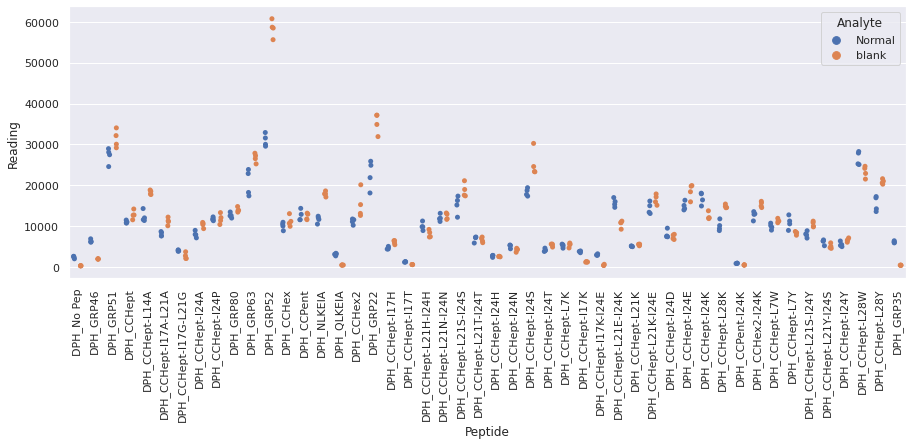

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR3_repeat_24.xlsx
Drawing scatter plot of data spread for Normal_thirtyeightR3_repeat_24 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

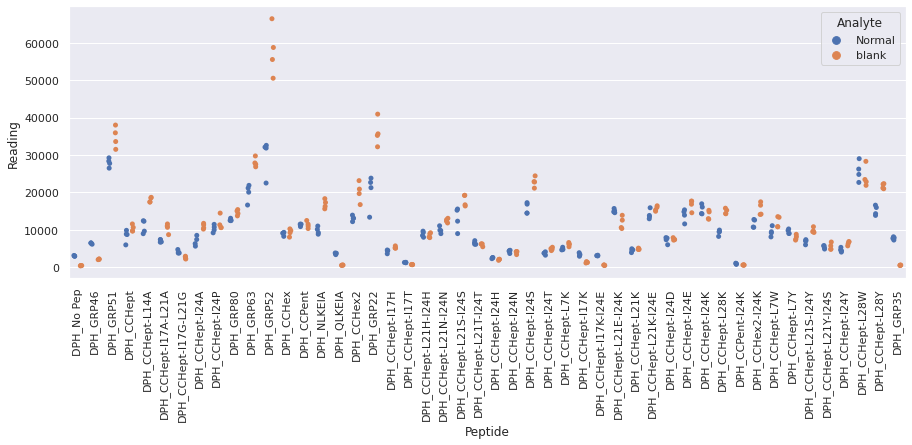

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR4_repeat_24.xlsx
Drawing scatter plot of data spread for Normal_thirtyeightR4_repeat_24 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

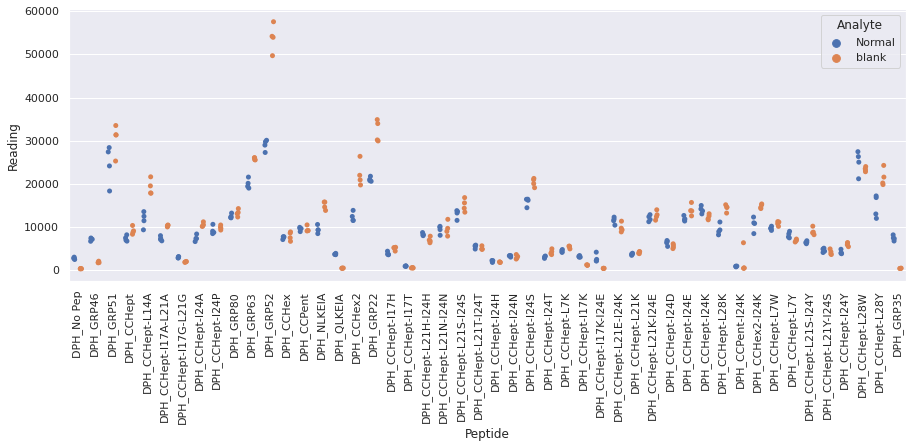

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR1_repeat_25.xlsx
Drawing scatter plot of data spread for Normal_thirtynineR1_repeat_25 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

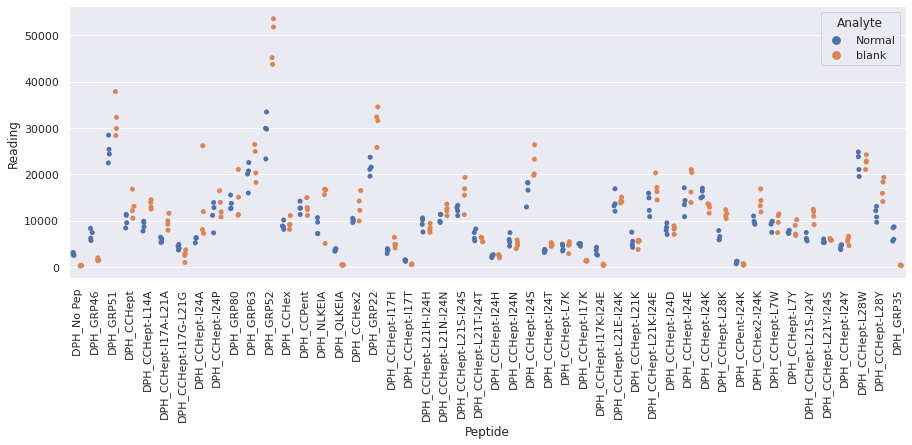

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR2_repeat_25.xlsx
Drawing scatter plot of data spread for Normal_thirtynineR2_repeat_25 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

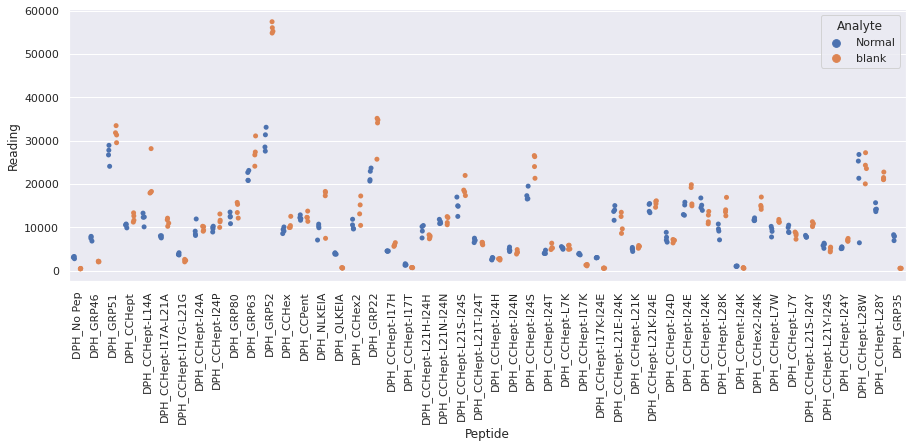

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR3_repeat_25.xlsx
Drawing scatter plot of data spread for Normal_thirtynineR3_repeat_25 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

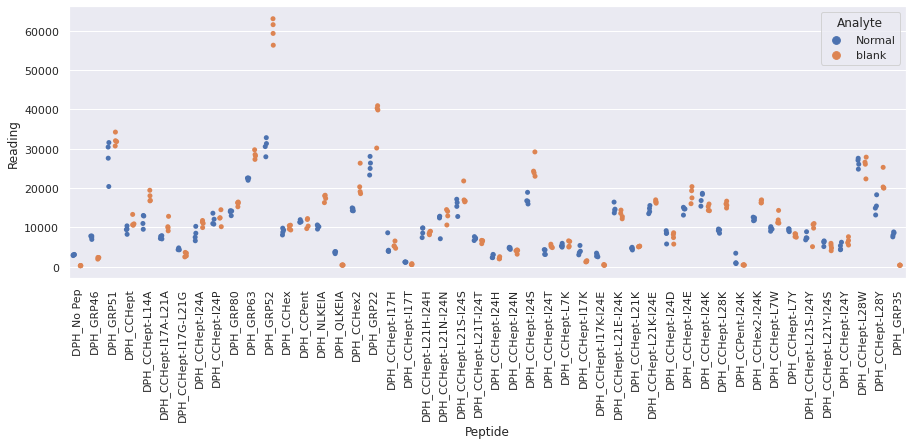

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR4_repeat_25.xlsx
Drawing scatter plot of data spread for Normal_thirtynineR4_repeat_25 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

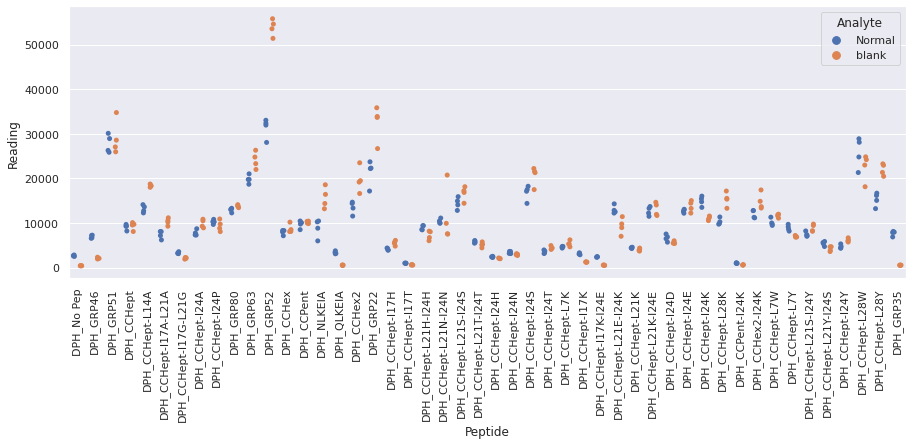

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR1_repeat_26.xlsx
Drawing scatter plot of data spread for Normal_fortyR1_repeat_26 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

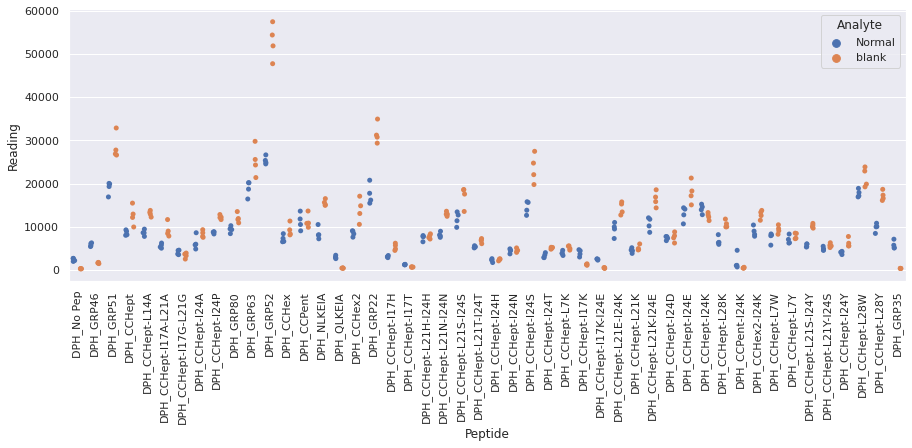

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR2_repeat_26.xlsx
Drawing scatter plot of data spread for Normal_fortyR2_repeat_26 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

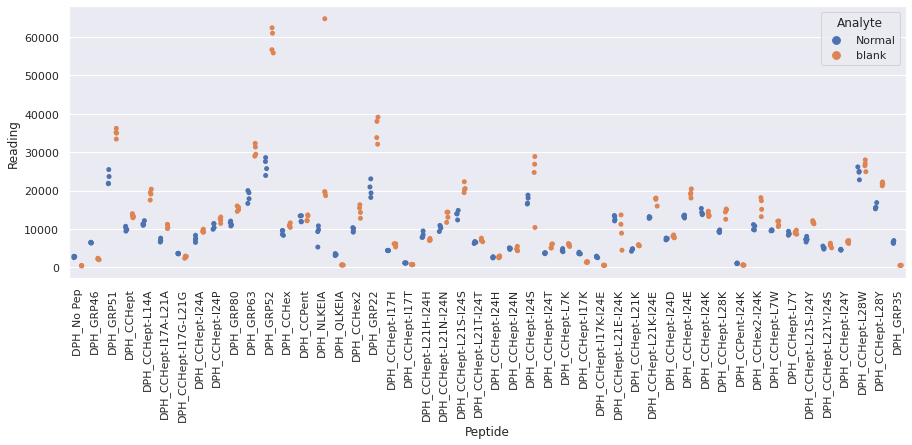

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR3_repeat_26.xlsx
Drawing scatter plot of data spread for Normal_fortyR3_repeat_26 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

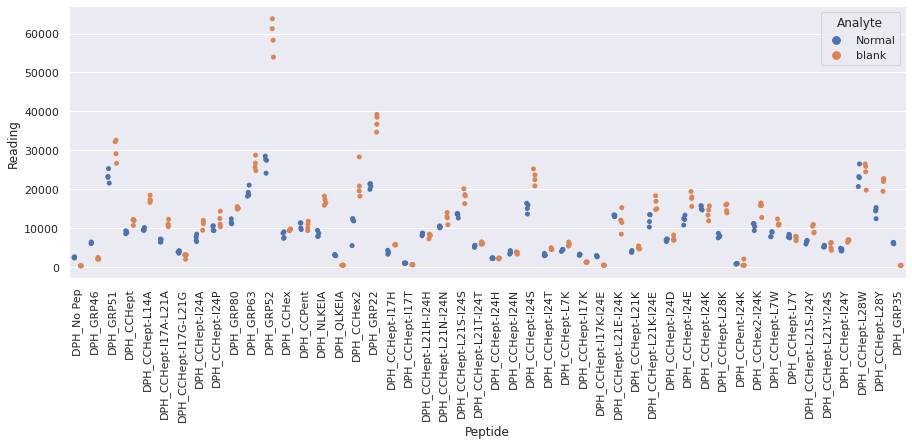

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR4_repeat_26.xlsx
Drawing scatter plot of data spread for Normal_fortyR4_repeat_26 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

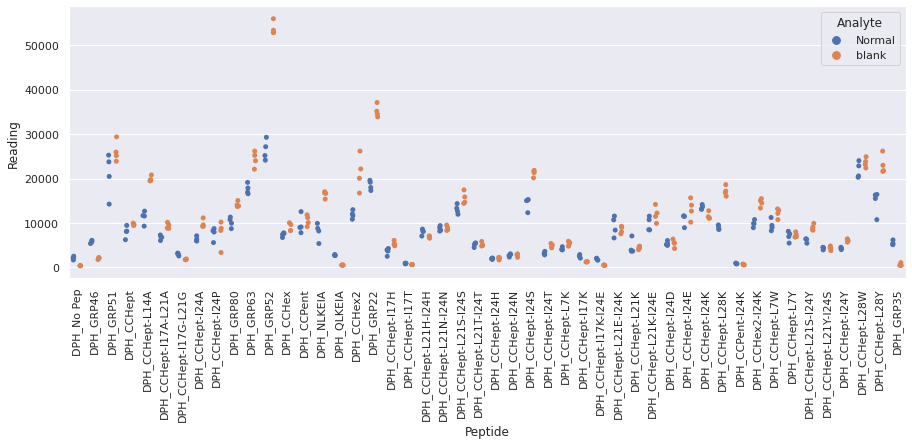

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR1_repeat_27.xlsx
Drawing scatter plot of data spread for Normal_fortyoneR1_repeat_27 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

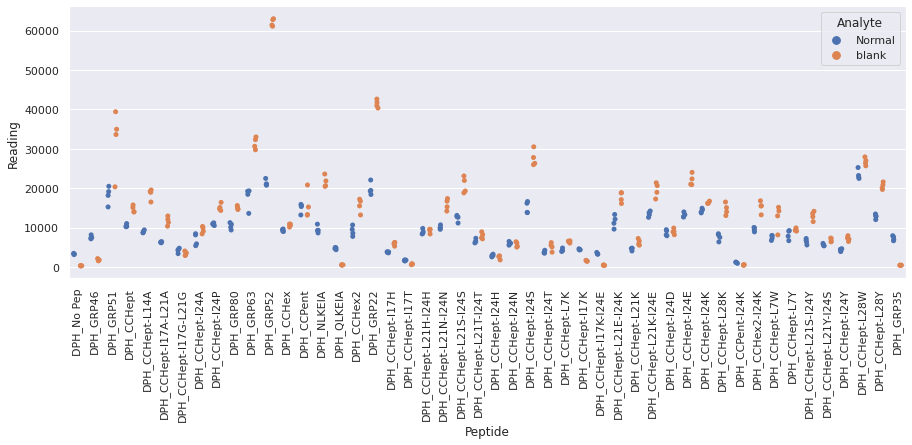

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR2_repeat_27.xlsx
Drawing scatter plot of data spread for Normal_fortyoneR2_repeat_27 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

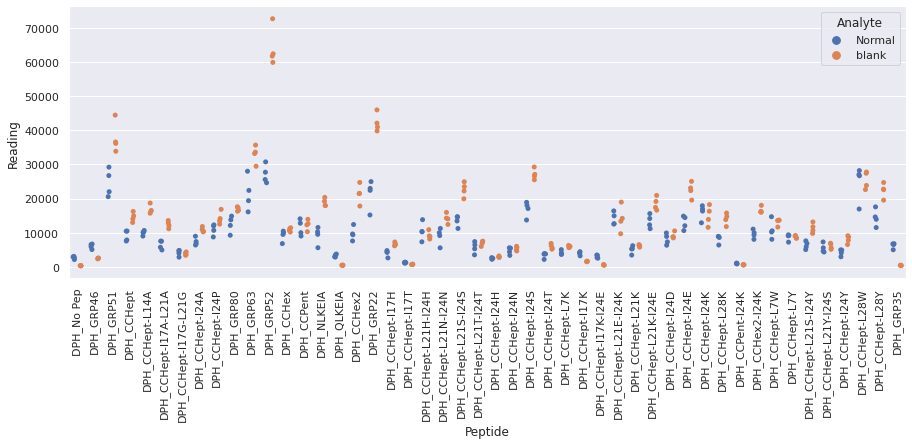

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR3_repeat_27.xlsx
Drawing scatter plot of data spread for Normal_fortyoneR3_repeat_27 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

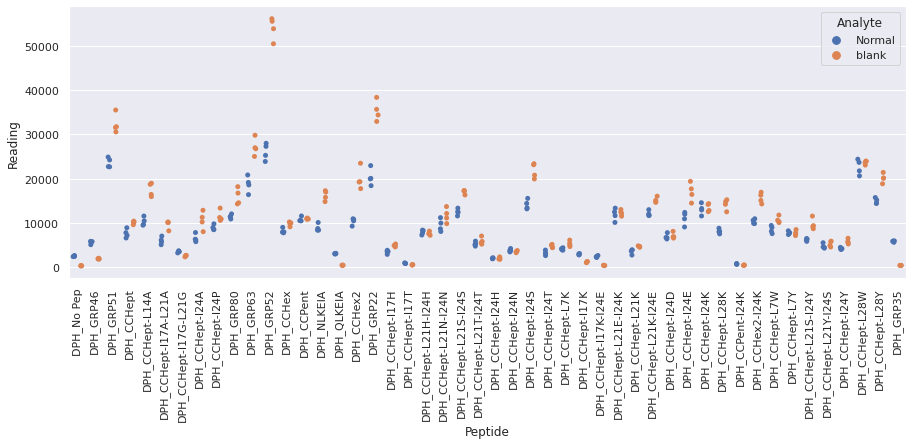

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR4_repeat_27.xlsx
Drawing scatter plot of data spread for Normal_fortyoneR4_repeat_27 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

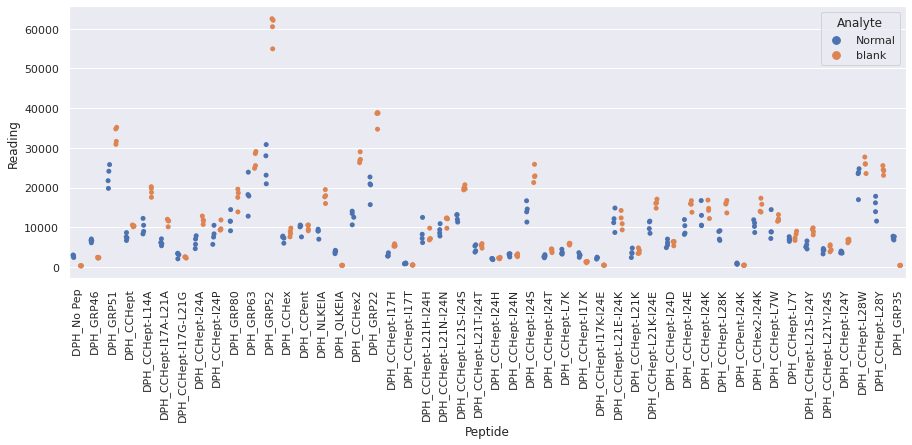

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR1_repeat_28.xlsx
Drawing scatter plot of data spread for Normal_fortytwoR1_repeat_28 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

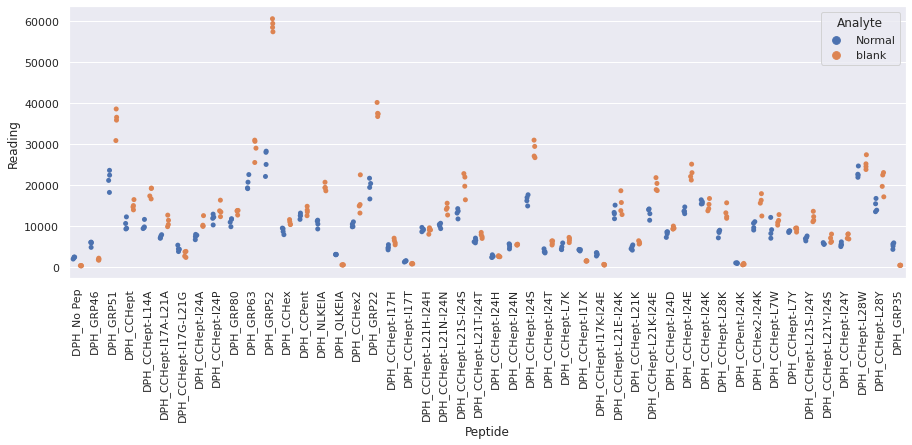

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR2_repeat_28.xlsx
Drawing scatter plot of data spread for Normal_fortytwoR2_repeat_28 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

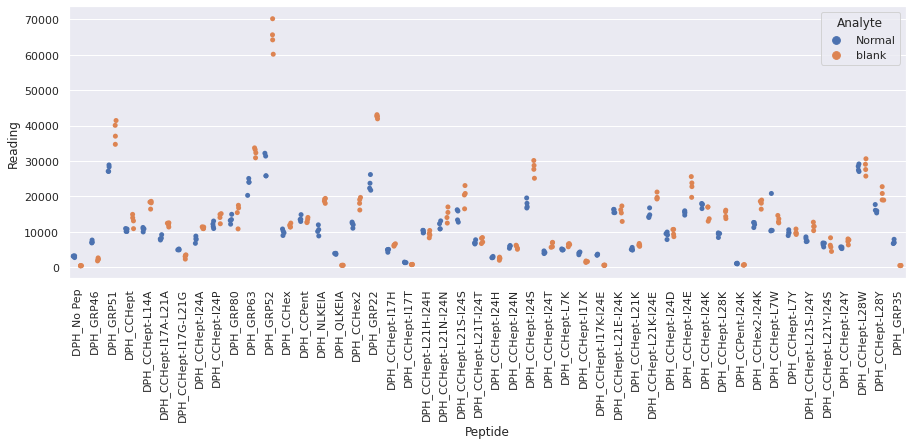

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR3_repeat_28.xlsx
Drawing scatter plot of data spread for Normal_fortytwoR3_repeat_28 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

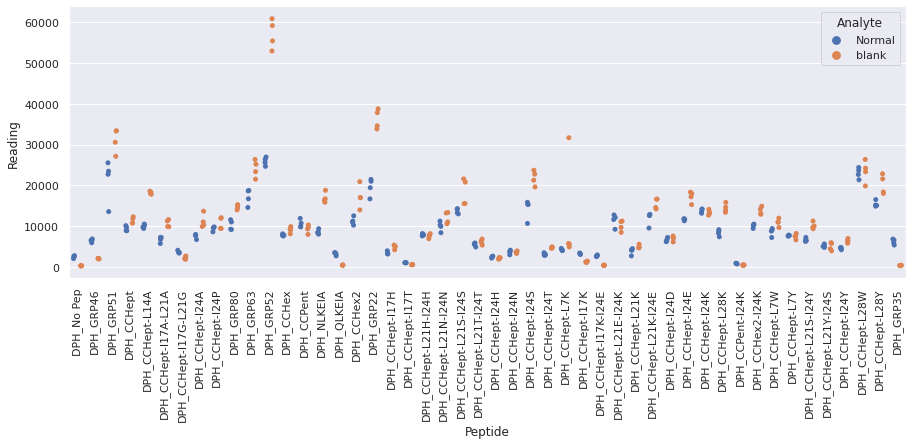

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR4_repeat_28.xlsx
Drawing scatter plot of data spread for Normal_fortytwoR4_repeat_28 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

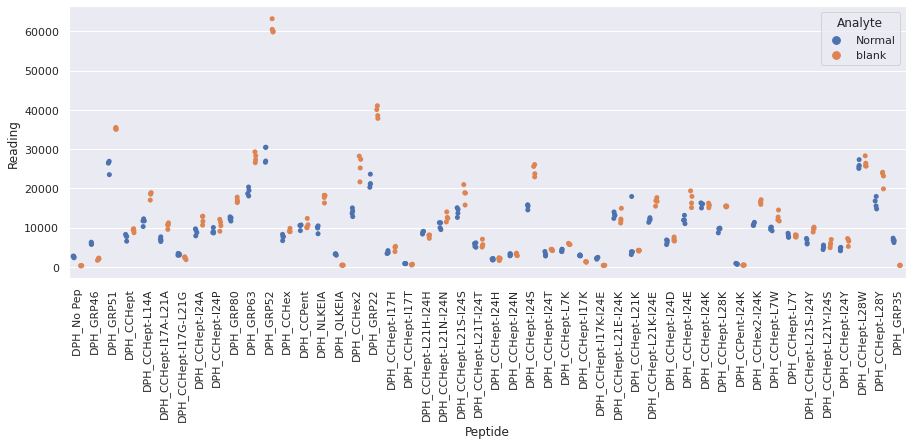

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR1_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR1_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_fifteenR1_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

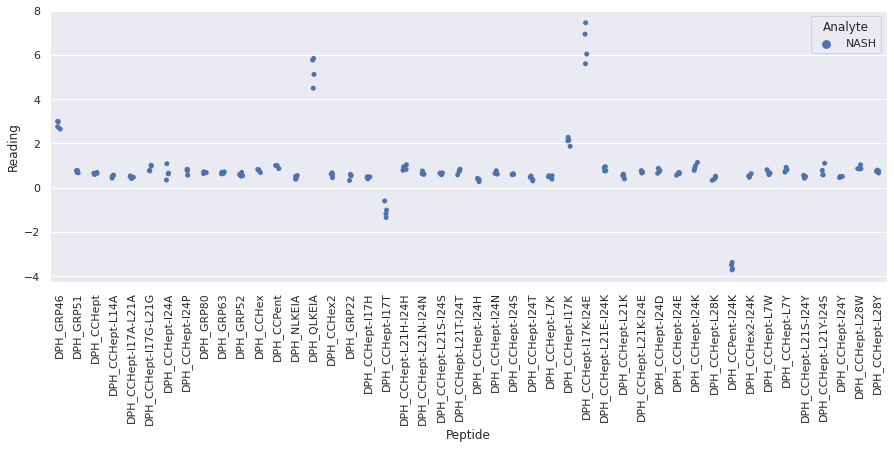

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR2_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR2_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_fifteenR2_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

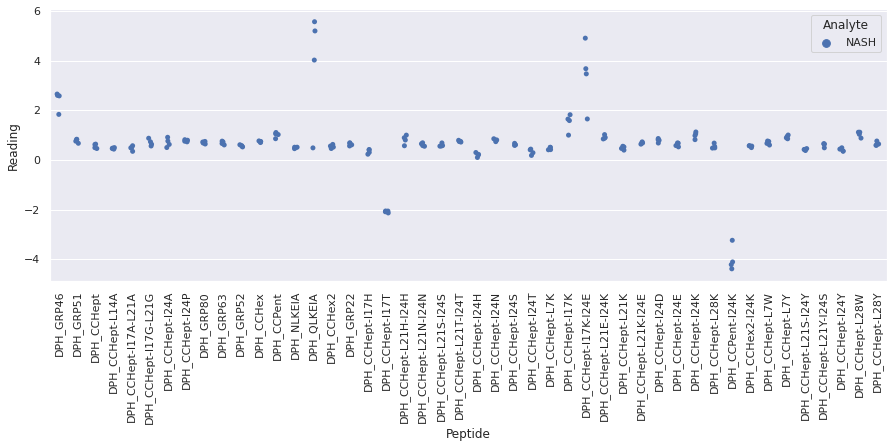

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR3_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR3_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_fifteenR3_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

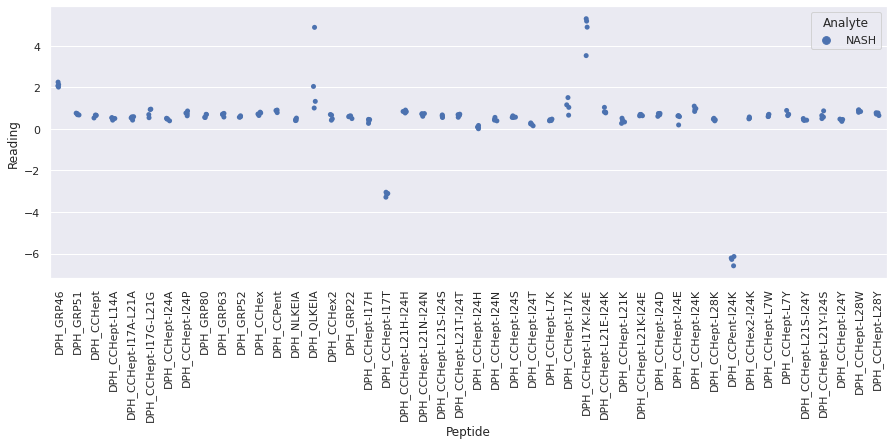

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR4_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR4_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_fifteenR4_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

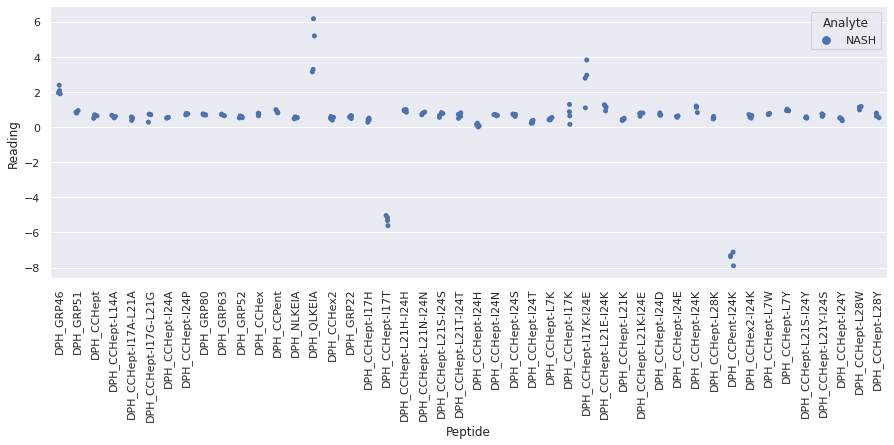

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_oneR1_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_oneR1_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_oneR1_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

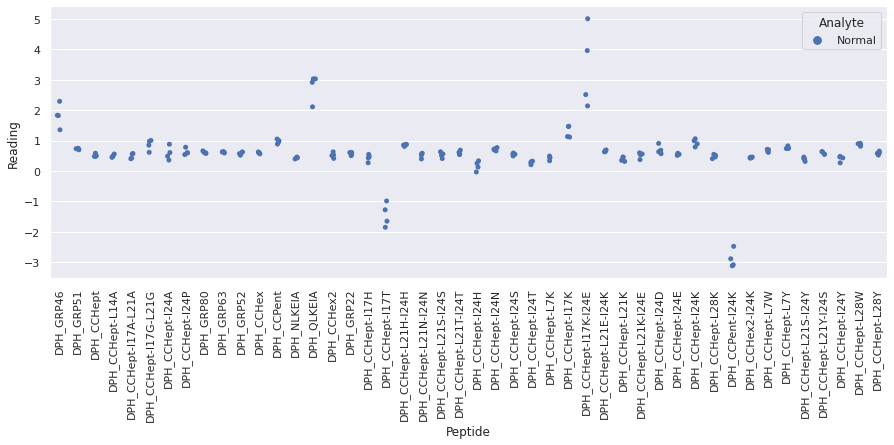

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_oneR2_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_oneR2_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_oneR2_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

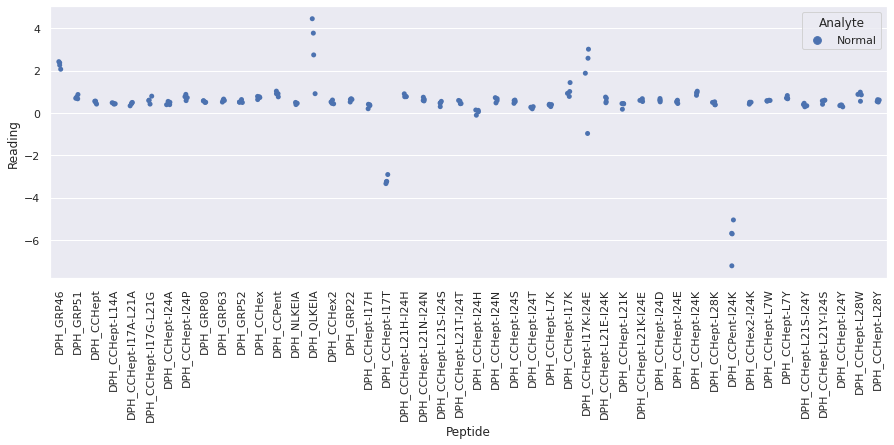

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_oneR3_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_oneR3_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-I24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_oneR3_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CC

<Figure size 720x720 with 0 Axes>

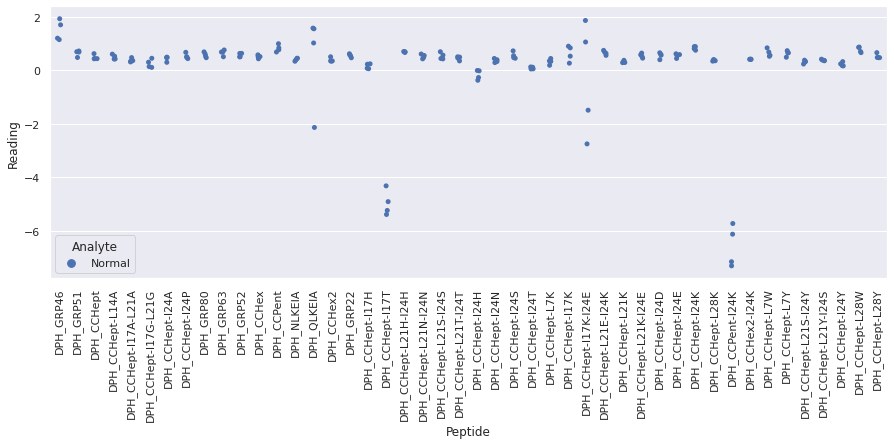

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_oneR4_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_oneR4_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-I24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_oneR4_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CC

<Figure size 720x720 with 0 Axes>

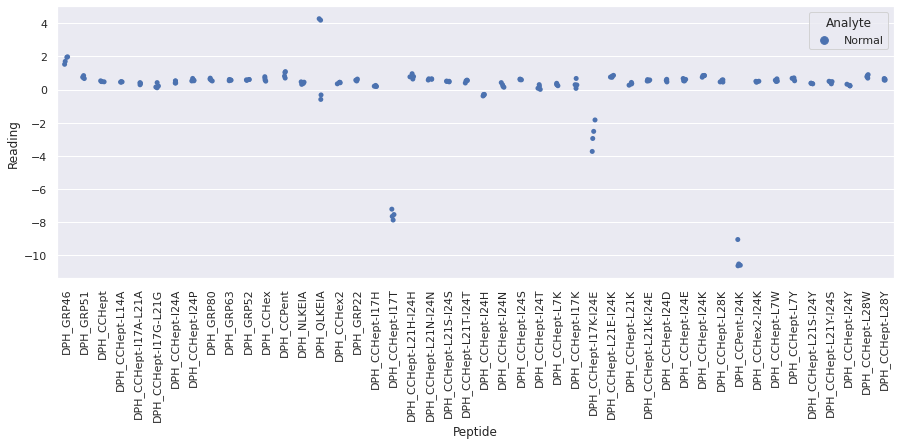

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_sixteenR1_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_sixteenR1_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_sixteenR1_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

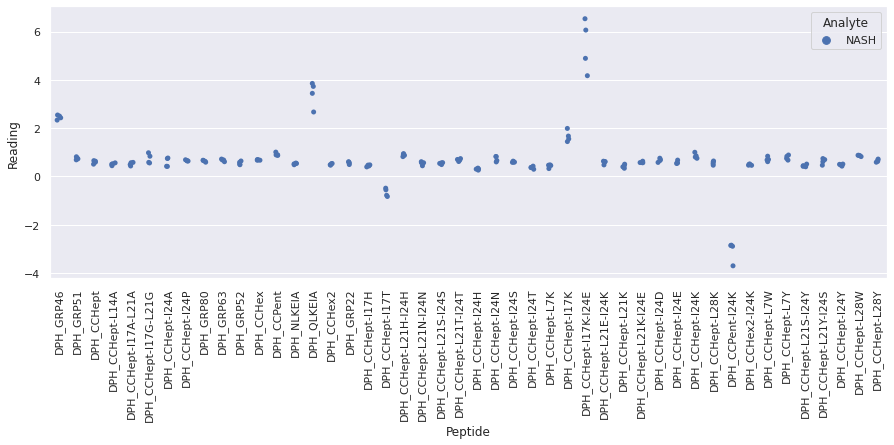

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_sixteenR2_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_sixteenR2_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_sixteenR2_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

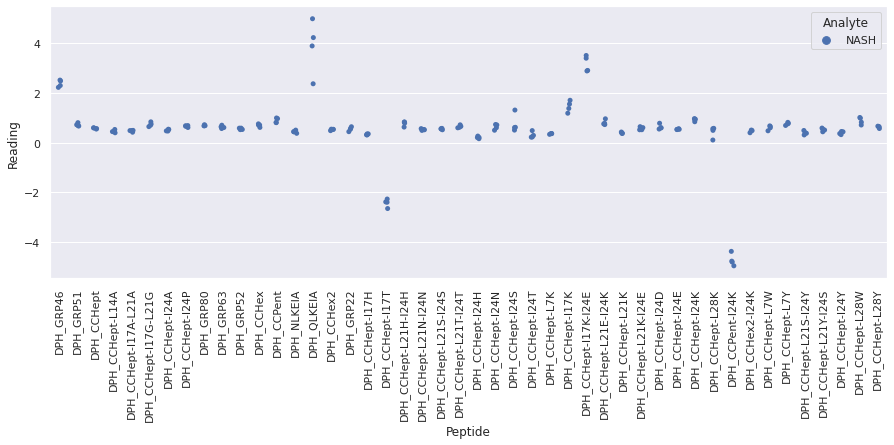

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_sixteenR3_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_sixteenR3_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_sixteenR3_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

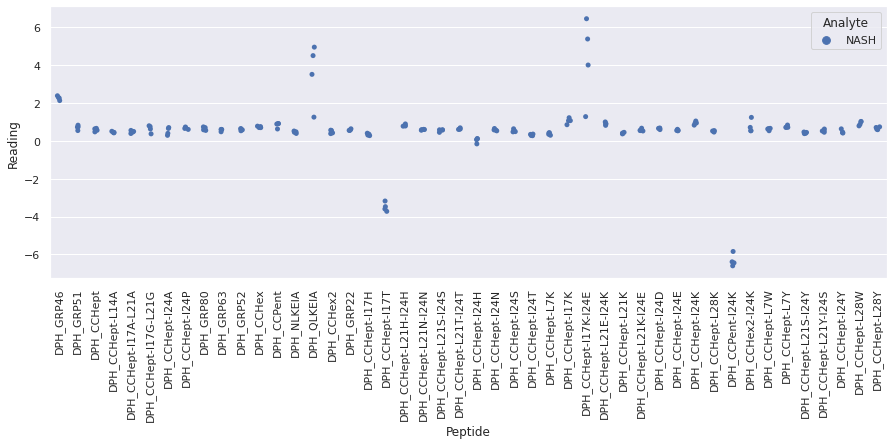

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_sixteenR4_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_sixteenR4_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_sixteenR4_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

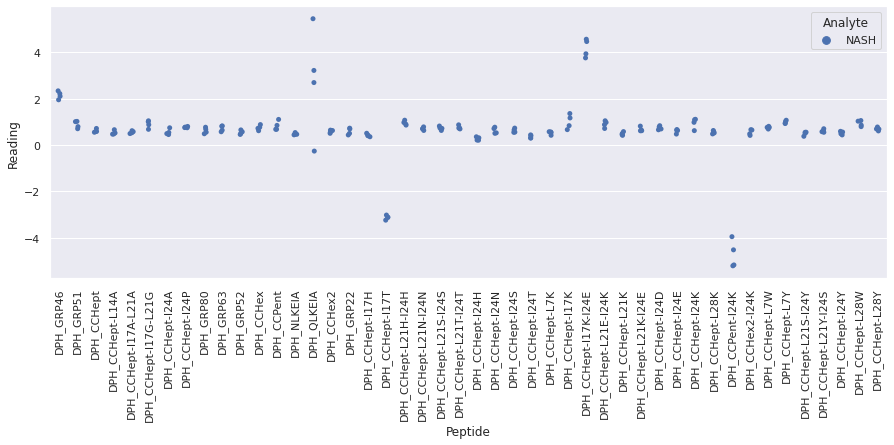

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twoR1_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twoR1_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twoR1_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

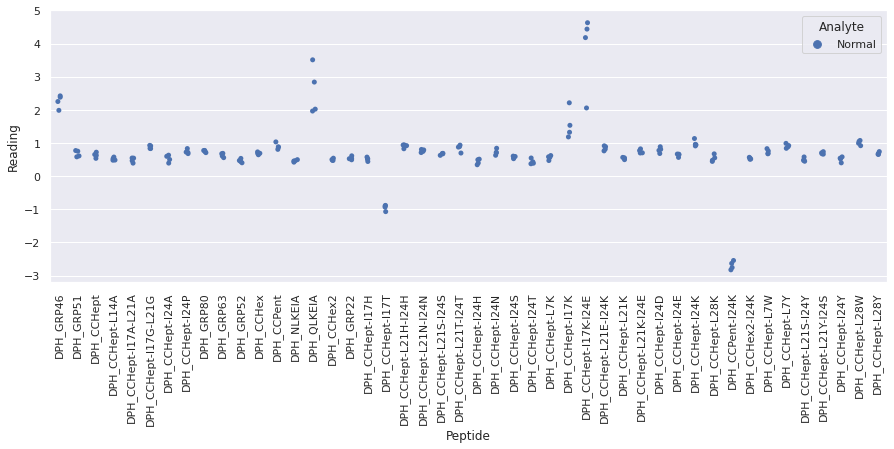

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twoR2_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twoR2_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twoR2_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

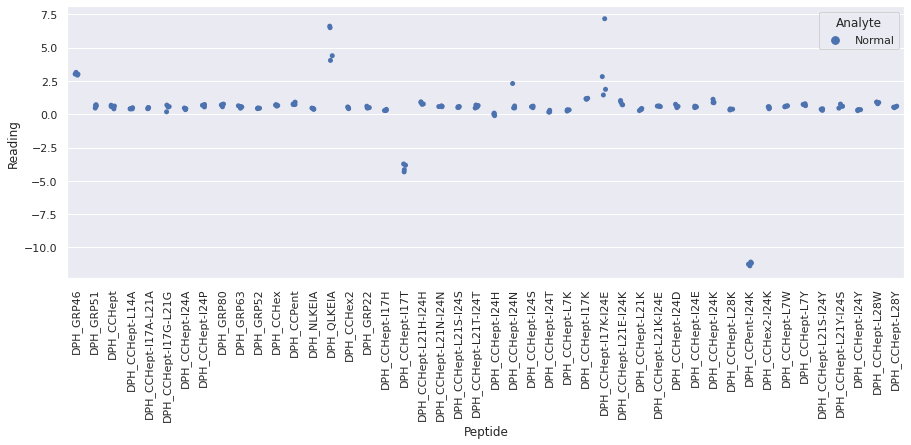

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twoR3_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twoR3_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-I24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twoR3_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CC

<Figure size 720x720 with 0 Axes>

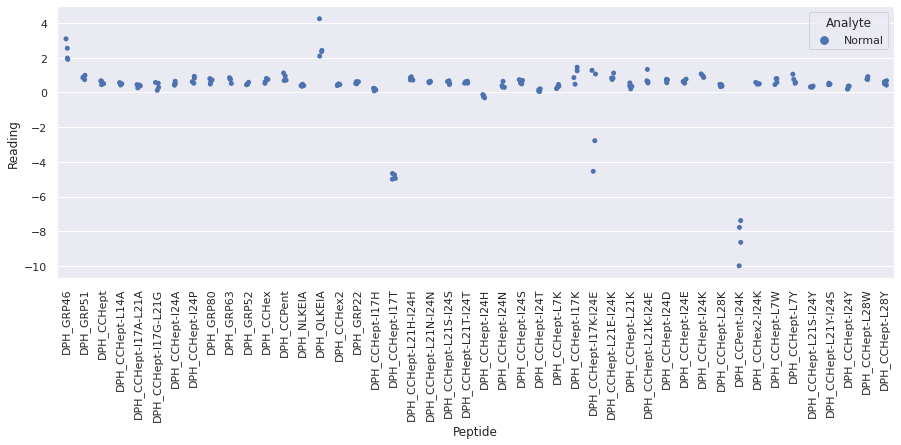

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twoR4_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twoR4_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twoR4_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twoR4_re

<Figure size 720x720 with 0 Axes>

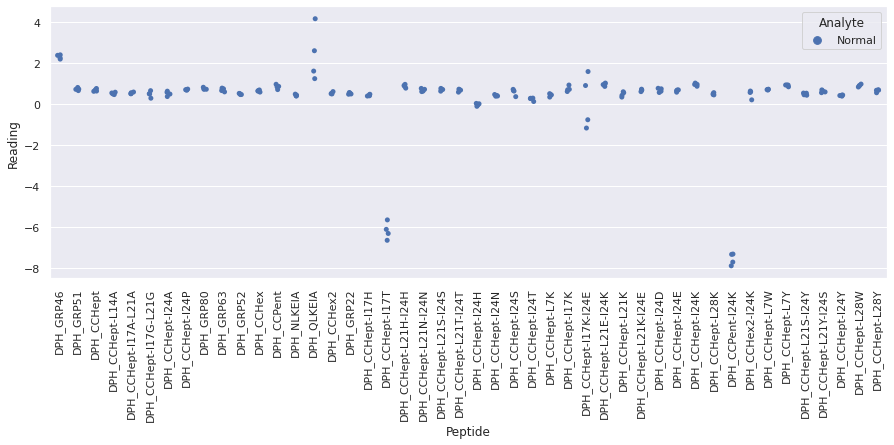

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_seventeenR1_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_seventeenR1_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_seventeenR1_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

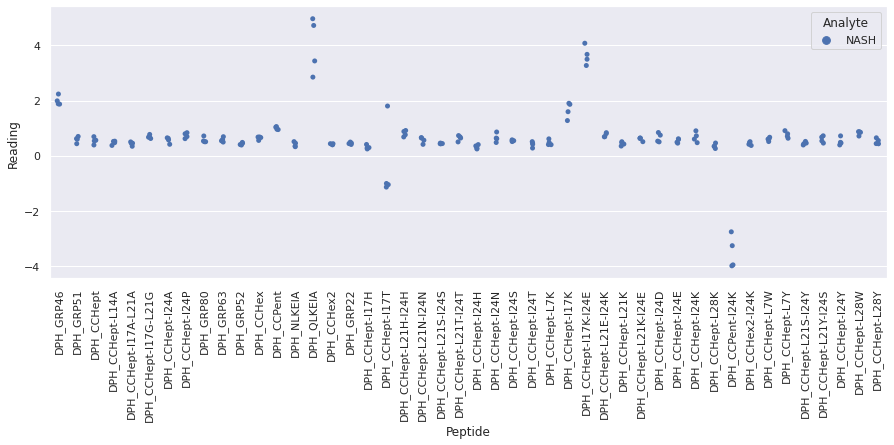

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_seventeenR2_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_seventeenR2_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_seventeenR2_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

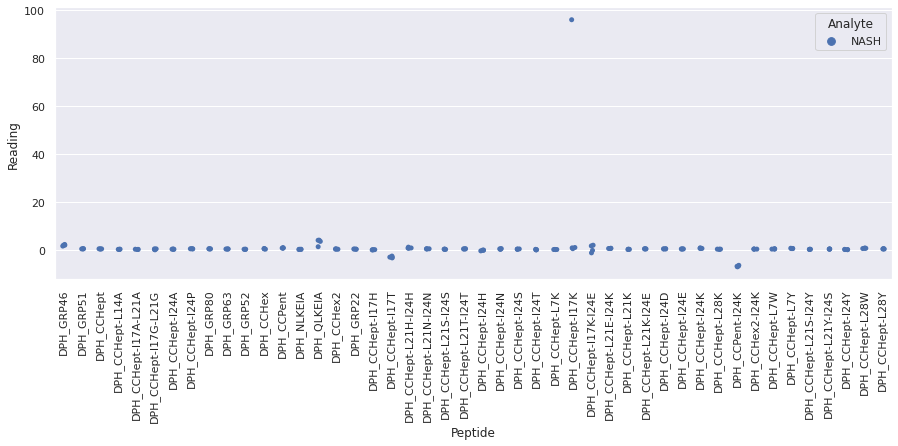

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_seventeenR3_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_seventeenR3_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_seventeenR3_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

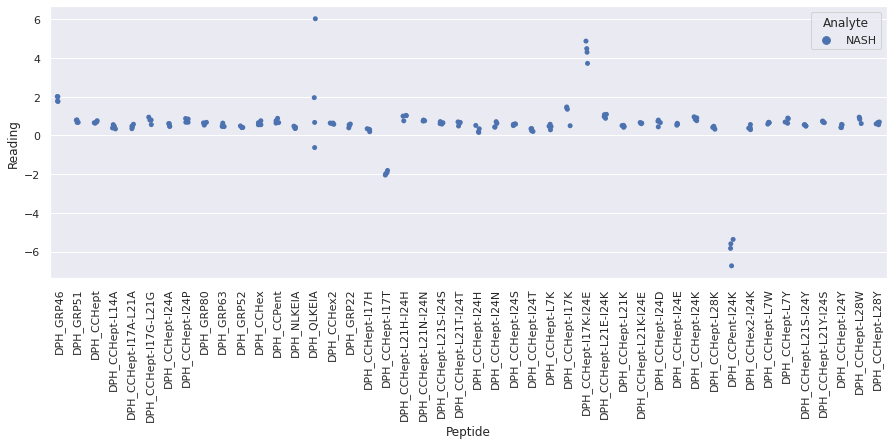

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17G-L21G + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_seventeenR4_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I17H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_seventeenR4_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_seventeenR4_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHe

<Figure size 720x720 with 0 Axes>

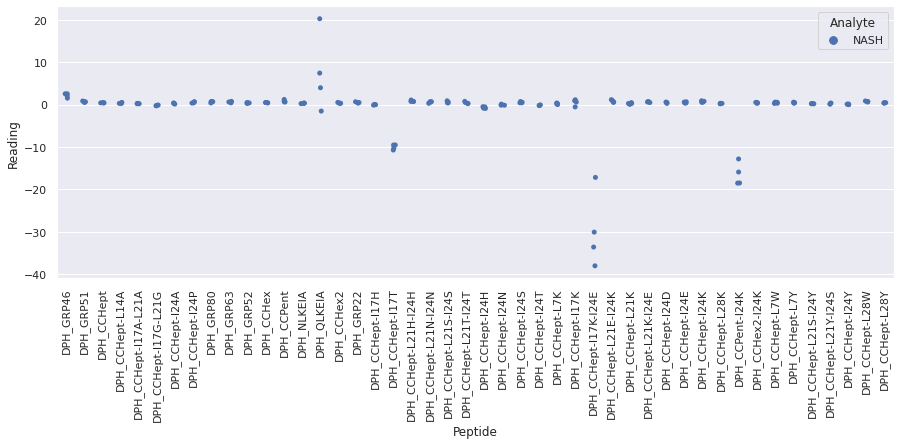

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_threeR1_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_threeR1_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_threeR1_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

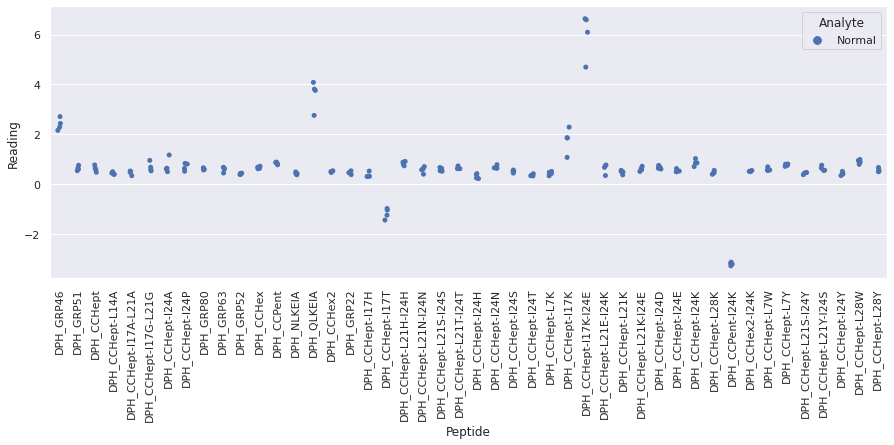

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_threeR2_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_threeR2_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_threeR2_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

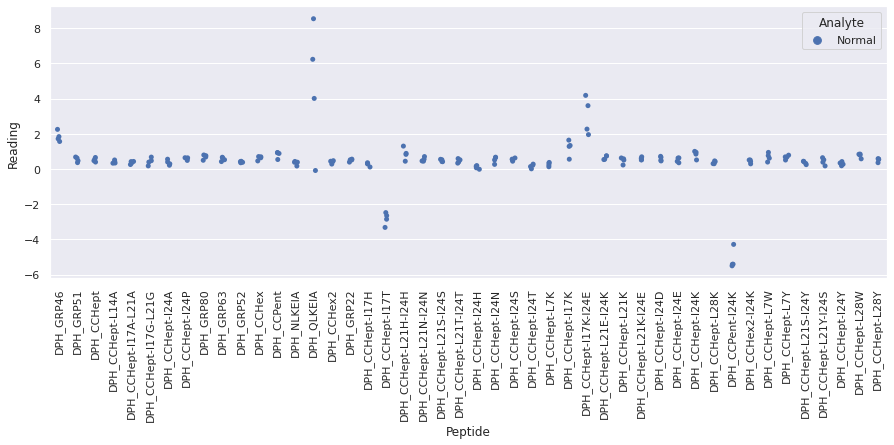

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_threeR3_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_threeR3_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_threeR3_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_th

<Figure size 720x720 with 0 Axes>

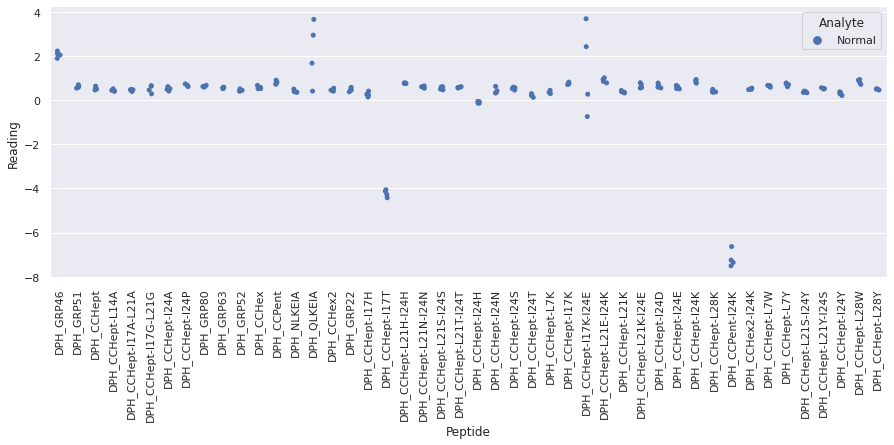

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_threeR4_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_threeR4_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_threeR4_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

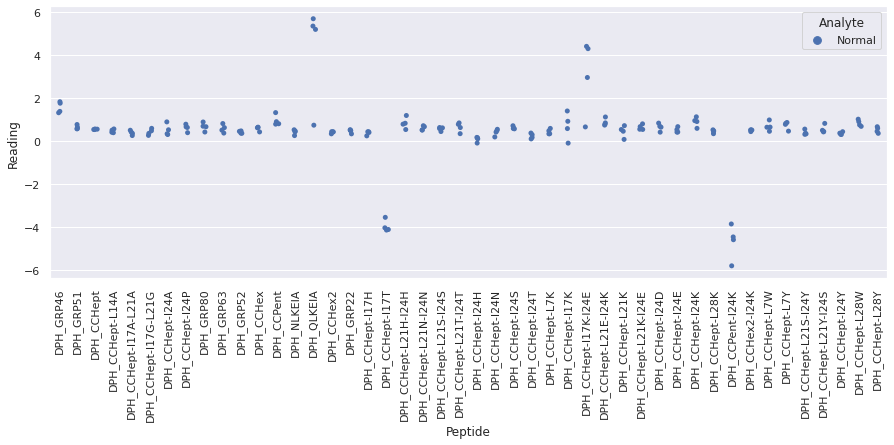

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_eighteenR1_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_eighteenR1_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_eighteenR1_repeat_4 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

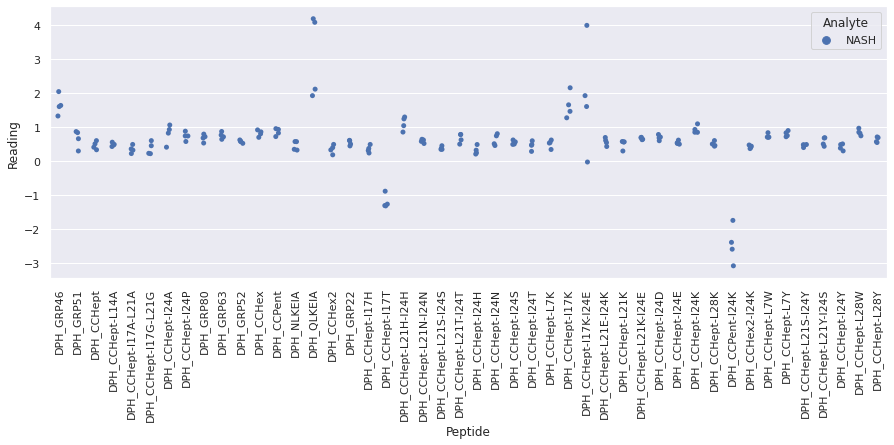

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_eighteenR2_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_eighteenR2_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_eighteenR2_repeat_4 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

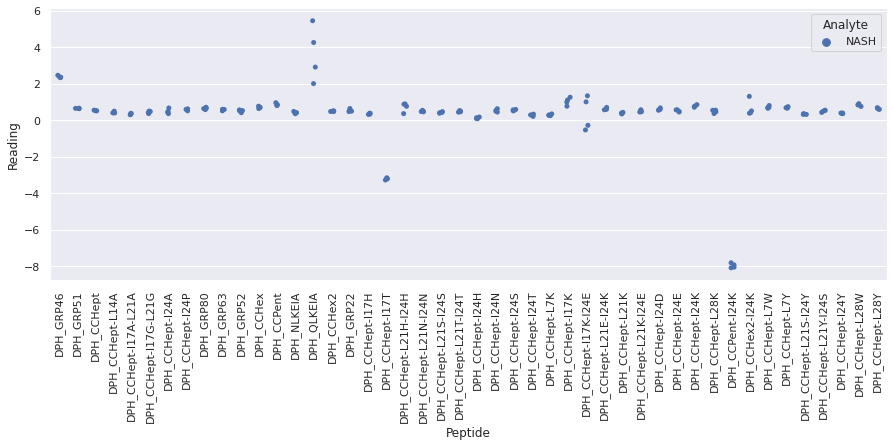

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_eighteenR3_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_eighteenR3_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_eighteenR3_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_eighteenR3_re

<Figure size 720x720 with 0 Axes>

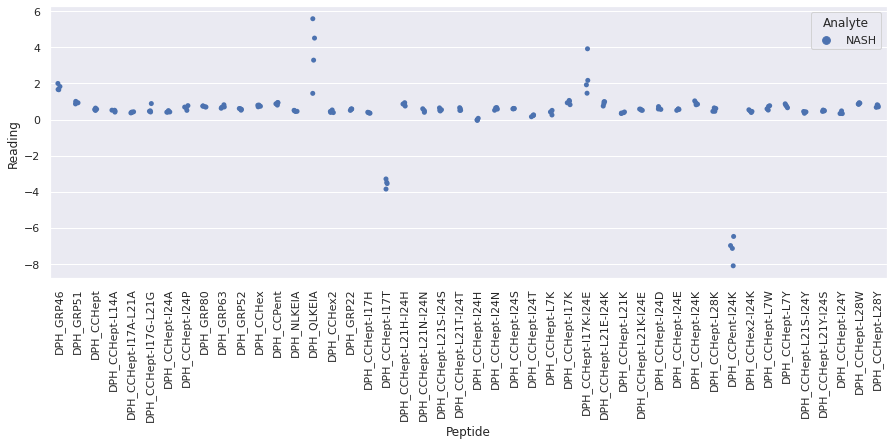

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_eighteenR4_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_eighteenR4_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_eighteenR4_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_eighteenR4_re

<Figure size 720x720 with 0 Axes>

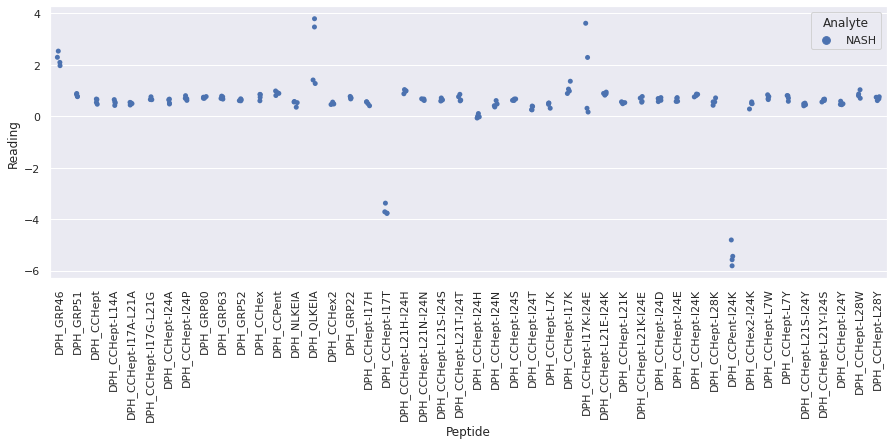

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourR1_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourR1_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fourR1_repeat_4 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

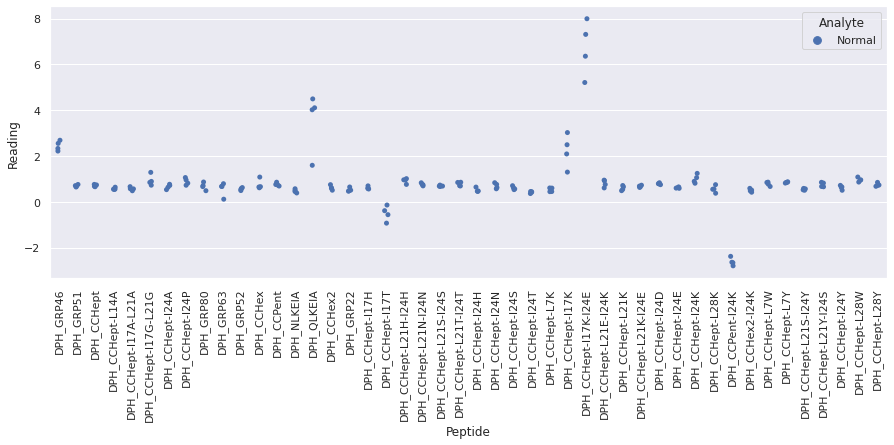

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourR2_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourR2_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourR2_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fourR

<Figure size 720x720 with 0 Axes>

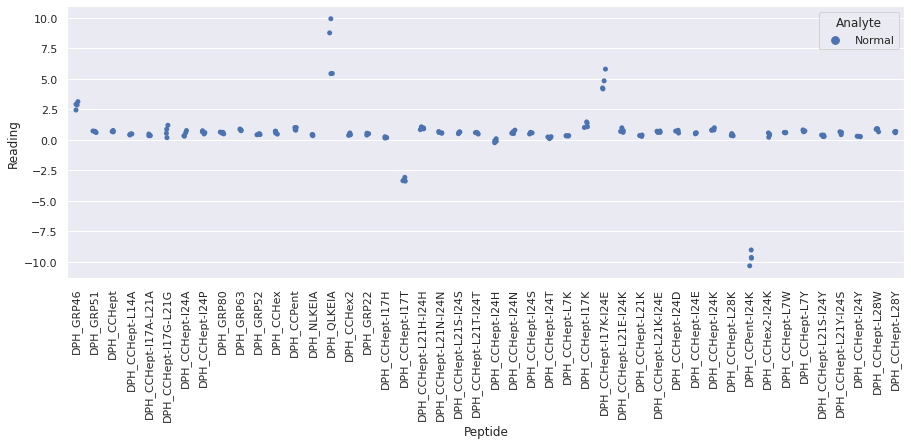

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourR3_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourR3_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fourR3_repeat_4 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

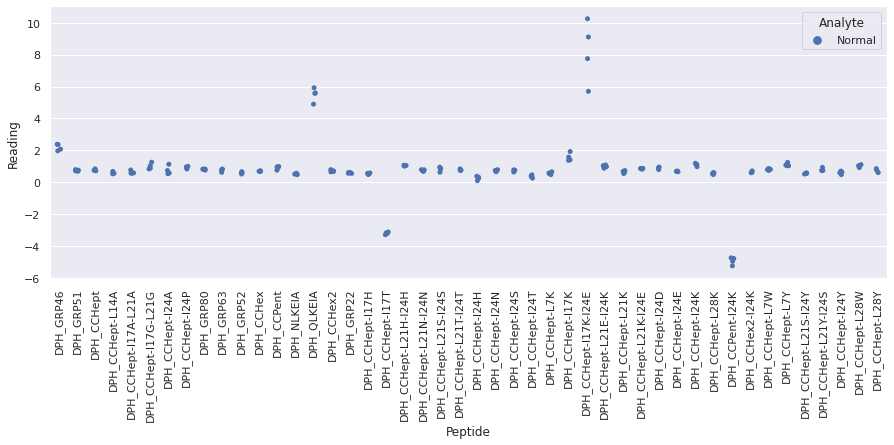

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourR4_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourR4_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourR4_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fourR

<Figure size 720x720 with 0 Axes>

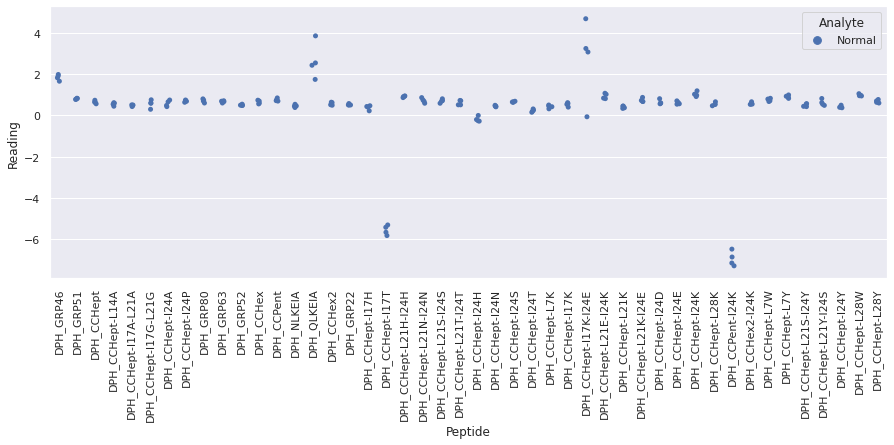

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_nineteenR1_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_nineteenR1_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_nineteenR1_repeat_5 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

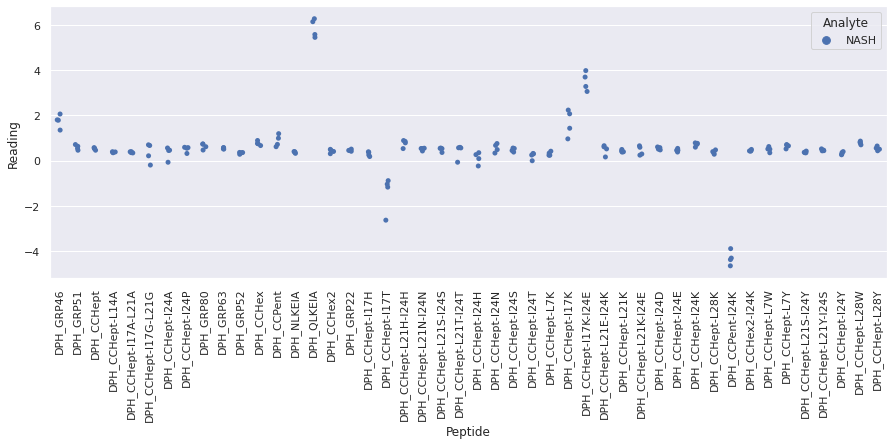

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_nineteenR2_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_nineteenR2_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_nineteenR2_repeat_5 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

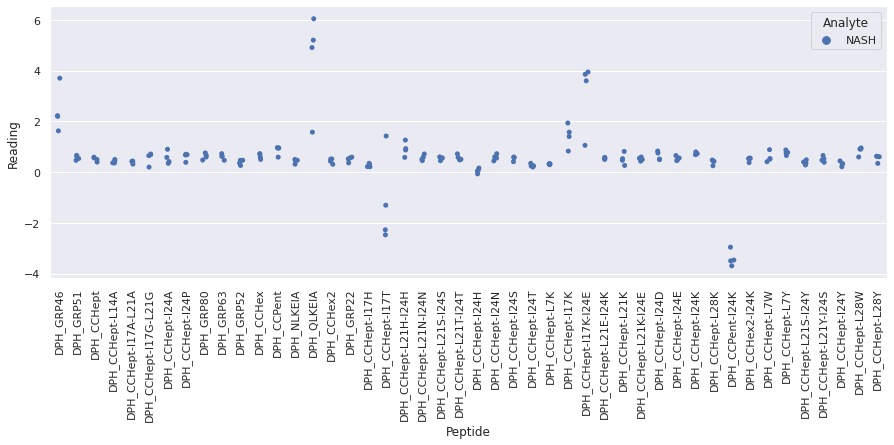

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_nineteenR3_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_nineteenR3_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_nineteenR3_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_nineteenR3_re

<Figure size 720x720 with 0 Axes>

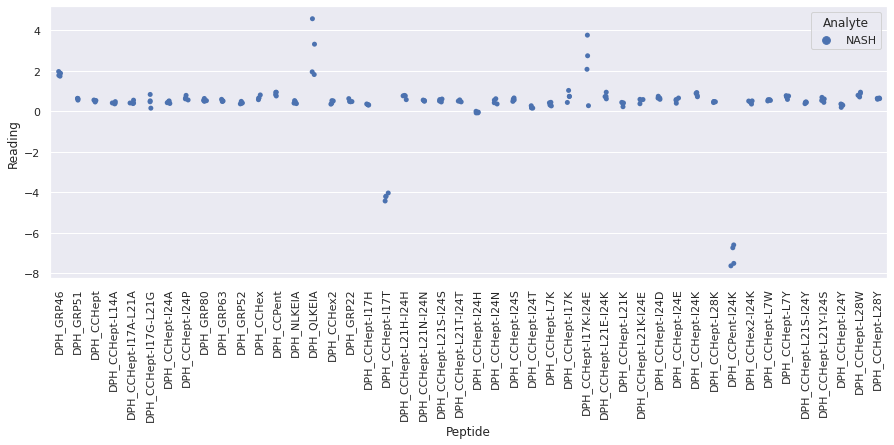

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_nineteenR4_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_nineteenR4_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_nineteenR4_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_nineteenR4_re

<Figure size 720x720 with 0 Axes>

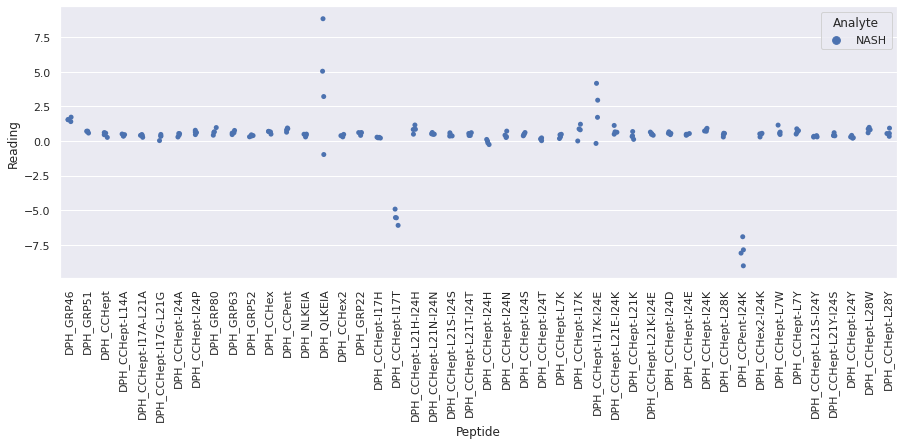

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fiveR1_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fiveR1_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fiveR1_repeat_5 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

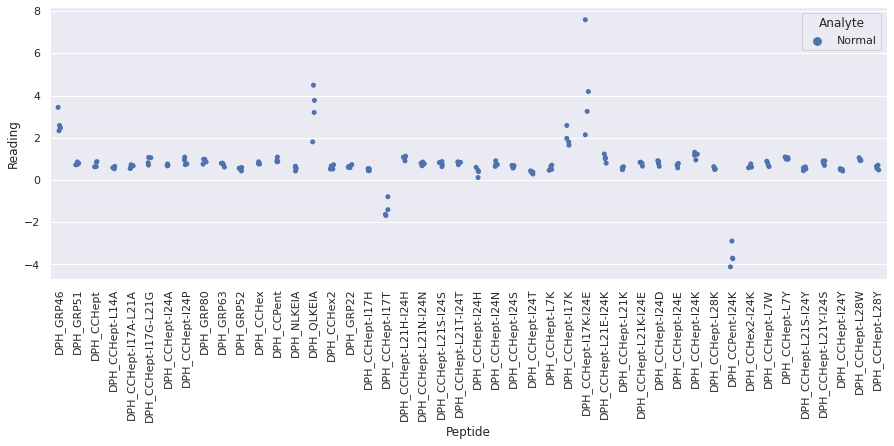

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fiveR2_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fiveR2_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fiveR2_repeat_5 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

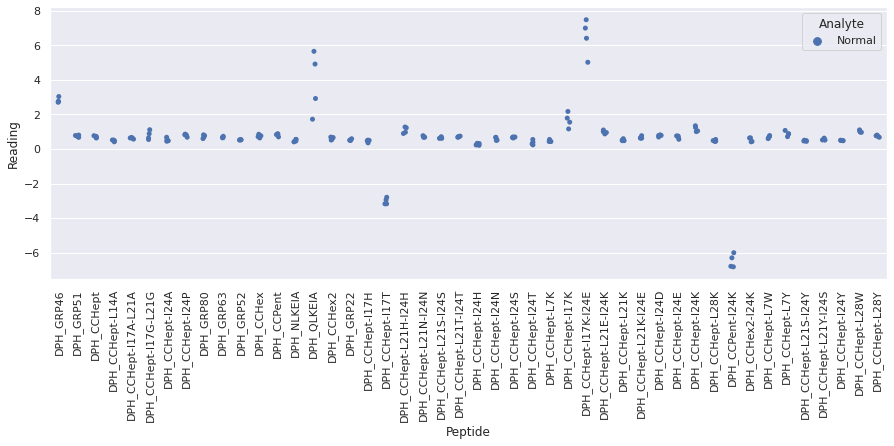

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fiveR3_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fiveR3_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fiveR3_repeat_5 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

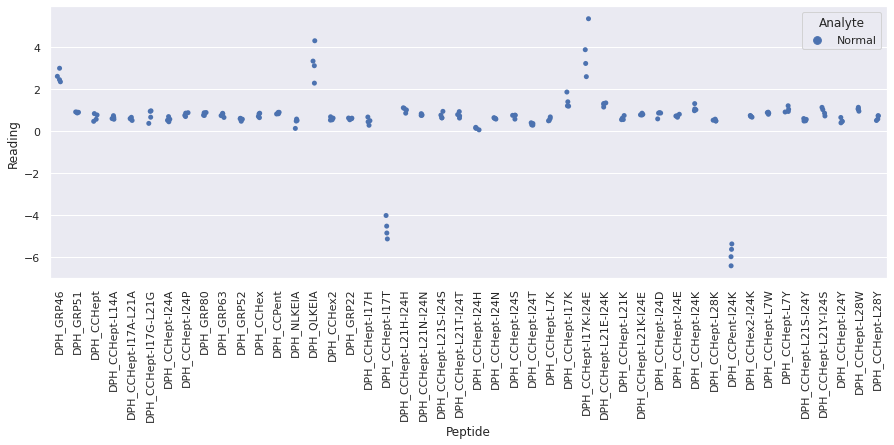

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fiveR4_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fiveR4_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fiveR4_repeat_5.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fiveR

<Figure size 720x720 with 0 Axes>

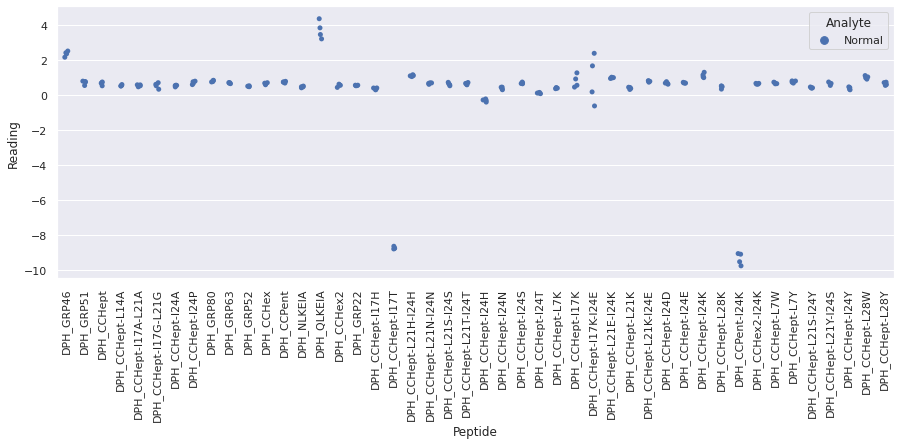

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyR1_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyR1_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyR1_repeat_6 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

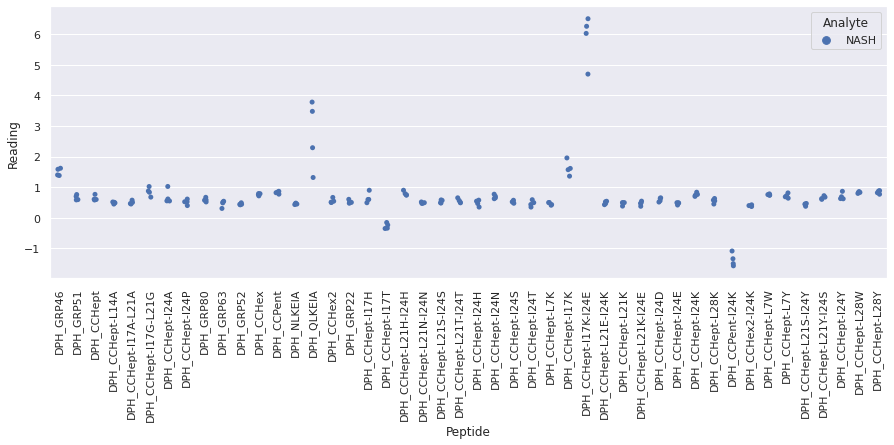

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyR2_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyR2_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyR2_repeat_6 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

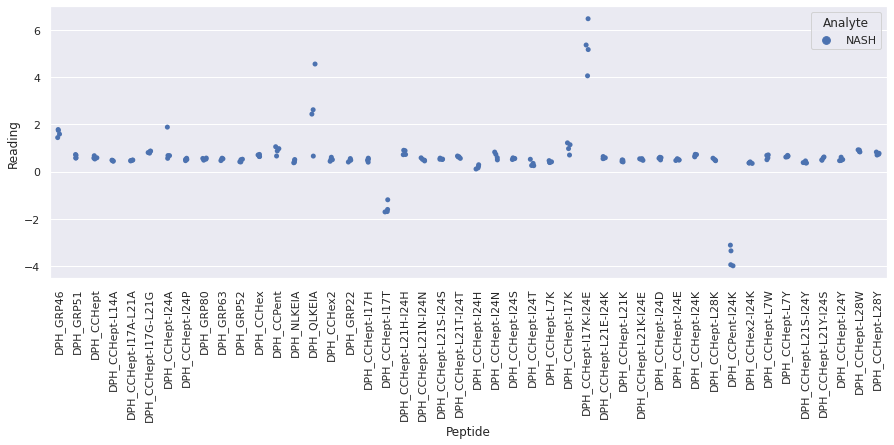

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyR3_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyR3_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyR3_repeat_6 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

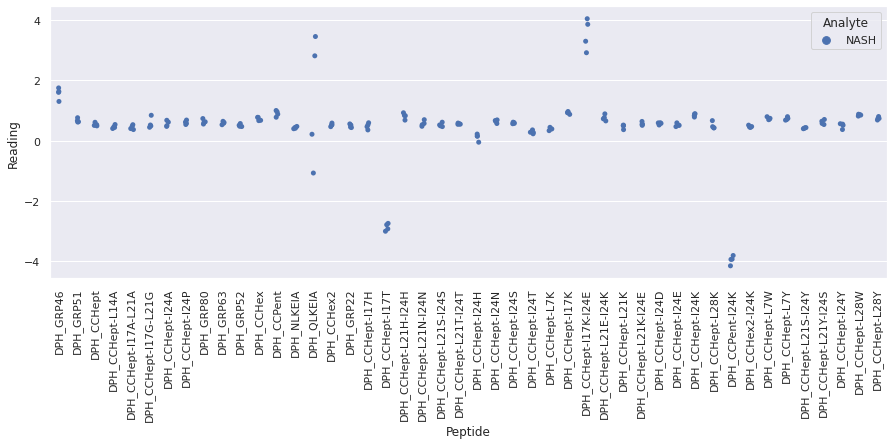

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyR4_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyR4_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I17K-I24E + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyR4_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K +

<Figure size 720x720 with 0 Axes>

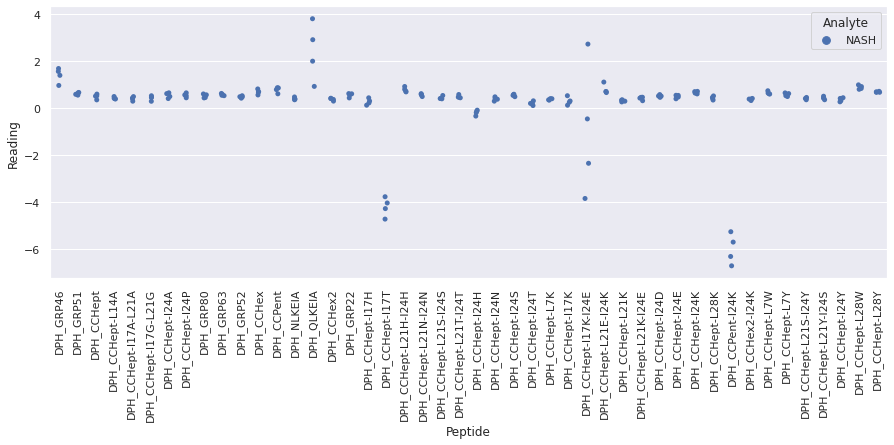

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sixR1_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sixR1_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_sixR1_repeat_6 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

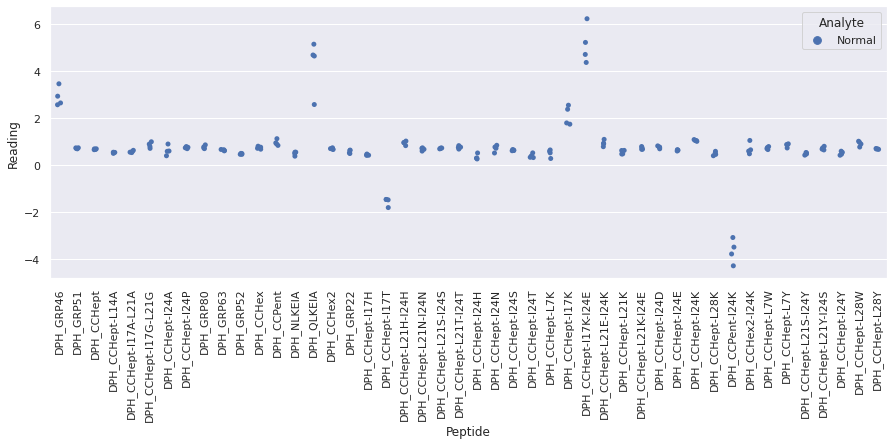

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sixR2_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sixR2_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_sixR2_repeat_6 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

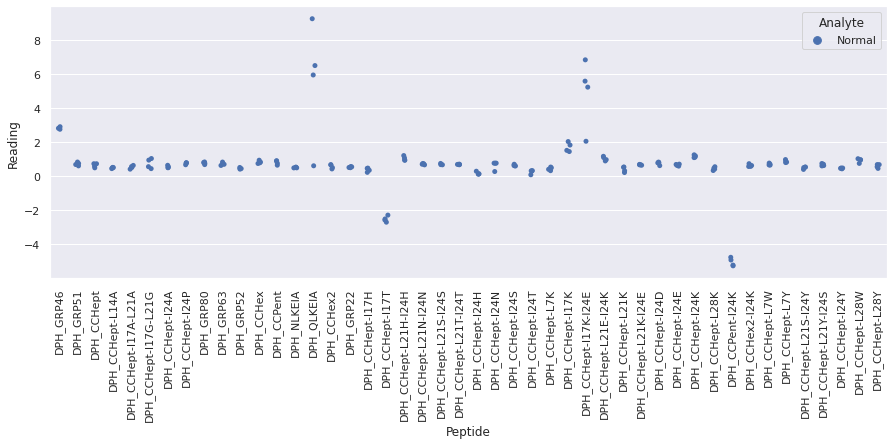

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sixR3_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sixR3_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_sixR3_repeat_6 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

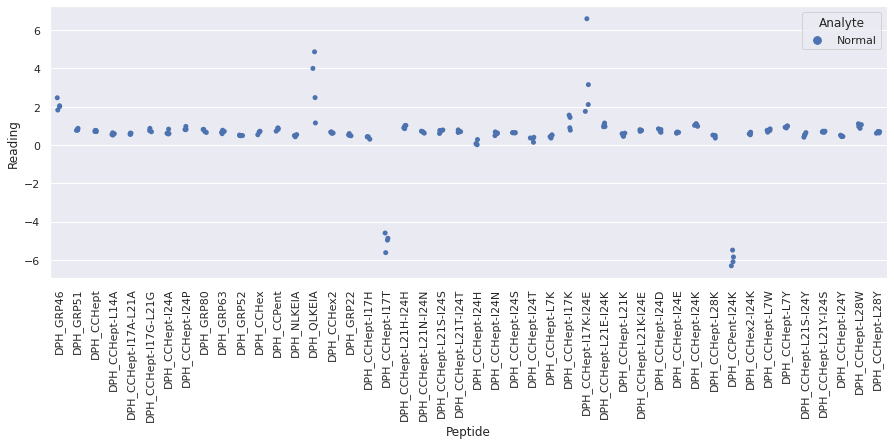

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sixR4_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sixR4_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sixR4_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_sixR4_re

<Figure size 720x720 with 0 Axes>

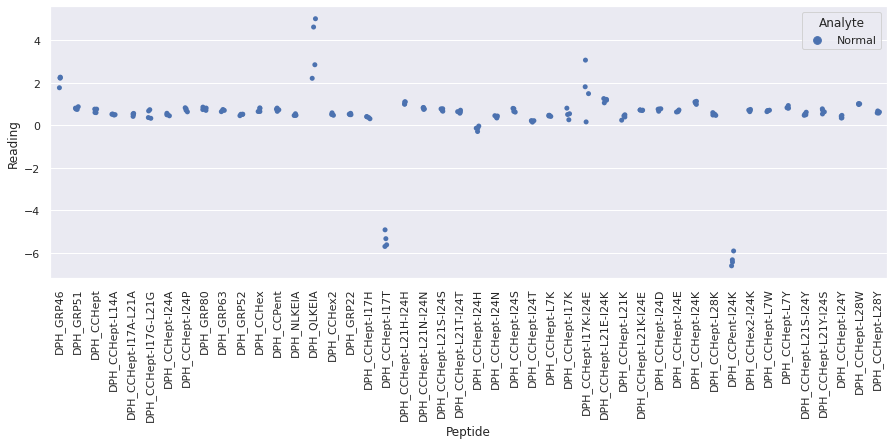

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyoneR1_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyoneR1_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyoneR1_repeat_7 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

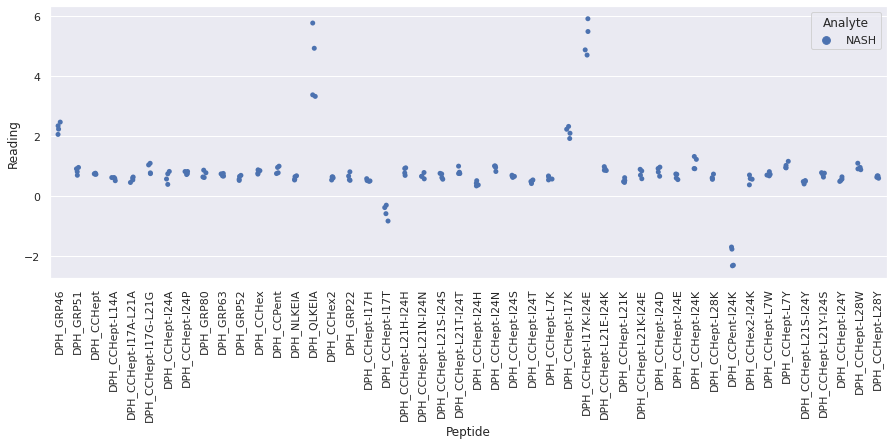

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyoneR2_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyoneR2_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyoneR2_repeat_7 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

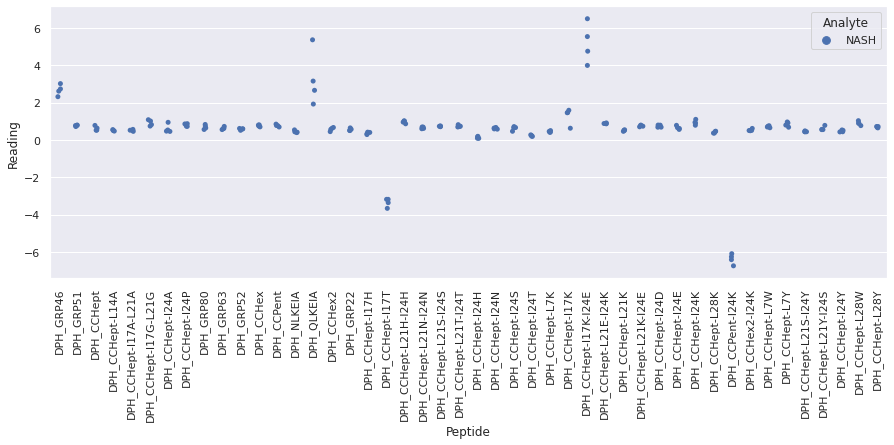

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyoneR3_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyoneR3_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyoneR3_repeat_7 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

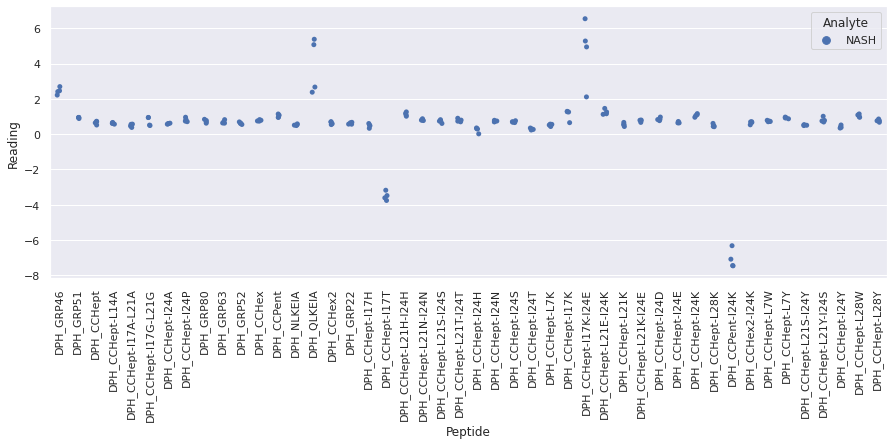

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyoneR4_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyoneR4_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyoneR4_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyoneR

<Figure size 720x720 with 0 Axes>

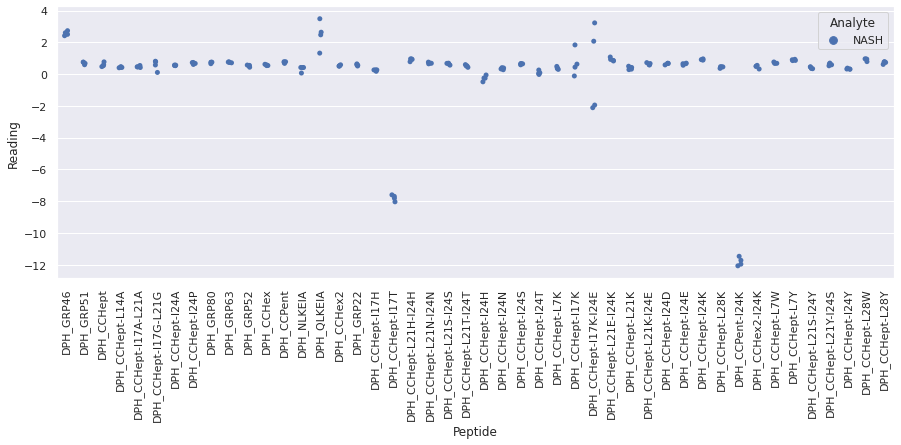

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sevenR1_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sevenR1_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_sevenR1_repeat_7 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

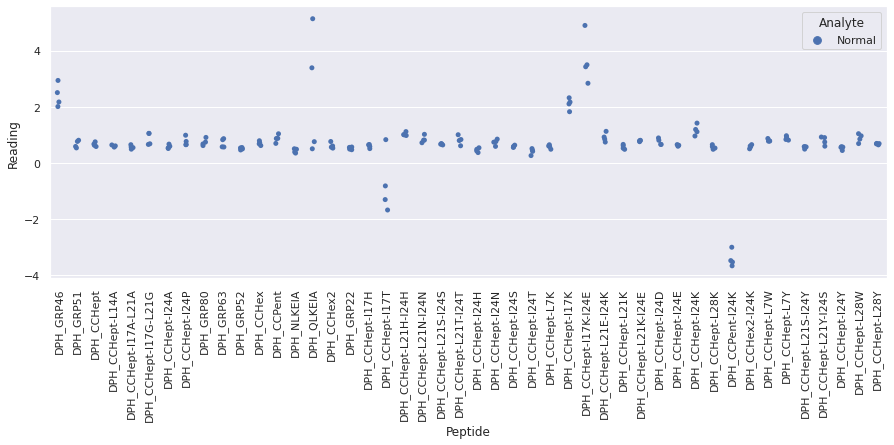

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sevenR2_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sevenR2_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_sevenR2_repeat_7 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

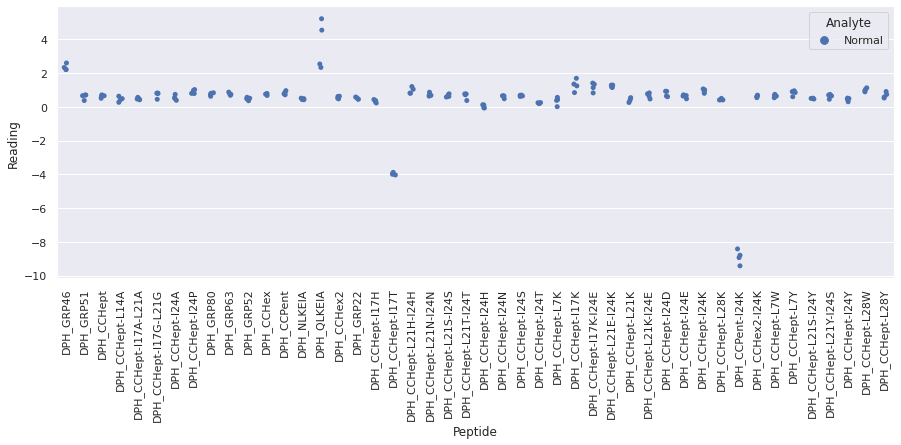

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sevenR3_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sevenR3_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sevenR3_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_se

<Figure size 720x720 with 0 Axes>

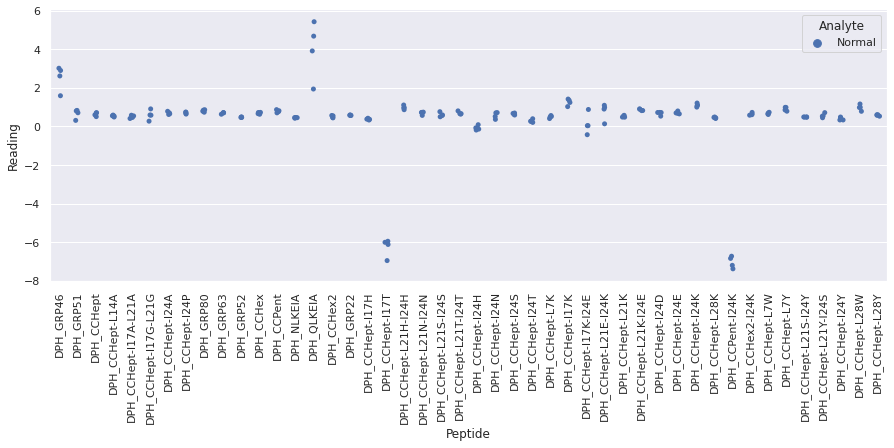

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sevenR4_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sevenR4_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_sevenR4_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_se

<Figure size 720x720 with 0 Axes>

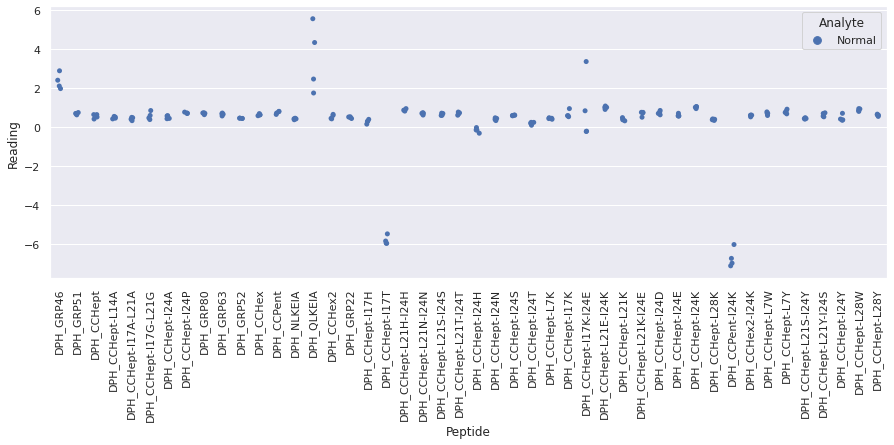

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentytwoR1_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentytwoR1_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentytwoR1_repeat_8 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

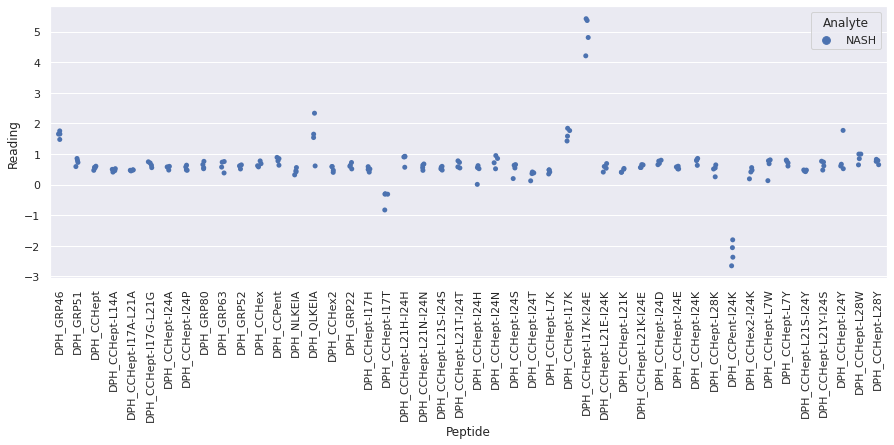

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentytwoR2_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentytwoR2_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentytwoR2_repeat_8 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

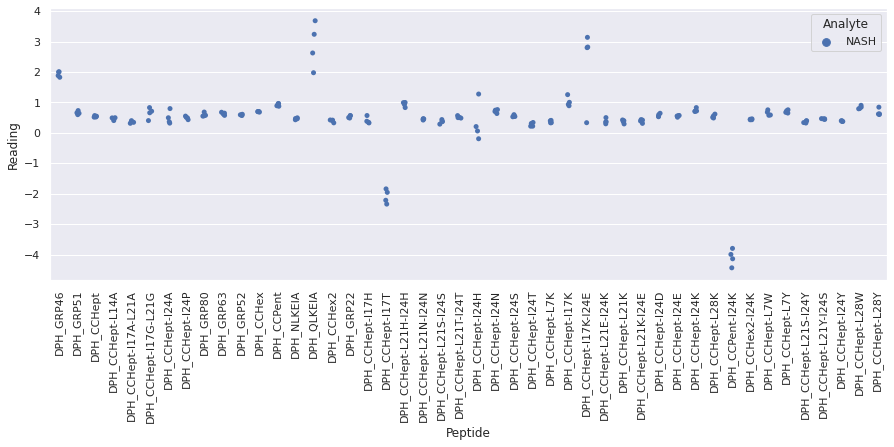

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentytwoR3_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentytwoR3_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentytwoR3_repeat_8 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

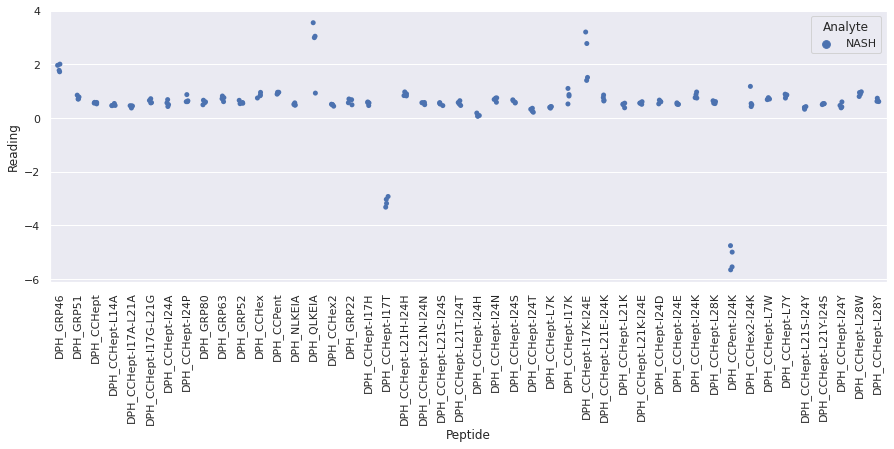

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentytwoR4_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentytwoR4_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I17K-I24E + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentytwoR4_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPe

<Figure size 720x720 with 0 Axes>

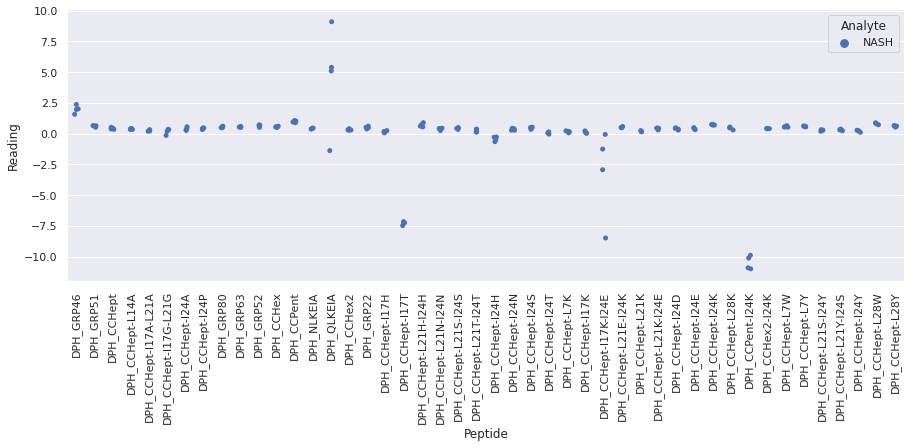

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_eightR1_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_eightR1_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_eightR1_repeat_8 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

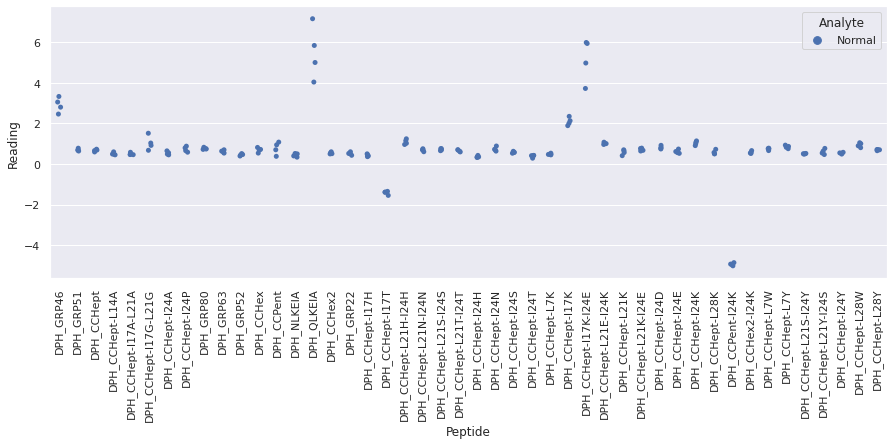

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_eightR2_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_eightR2_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_eightR2_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_ei

<Figure size 720x720 with 0 Axes>

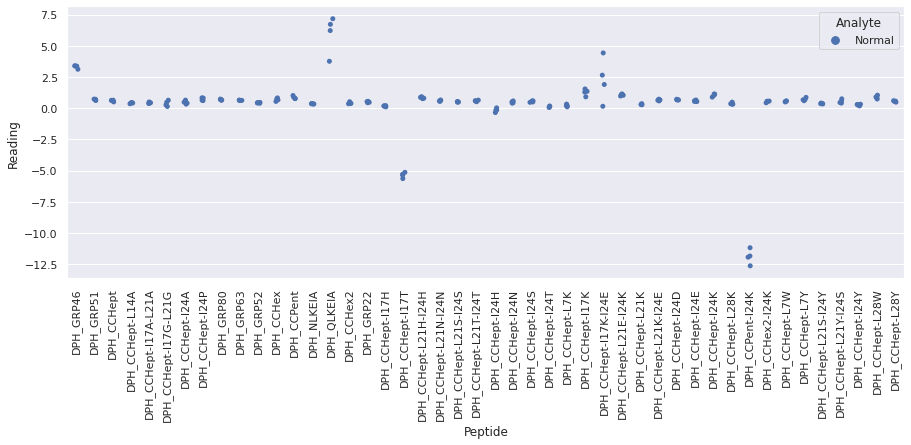

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_eightR3_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_eightR3_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_eightR3_repeat_8 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

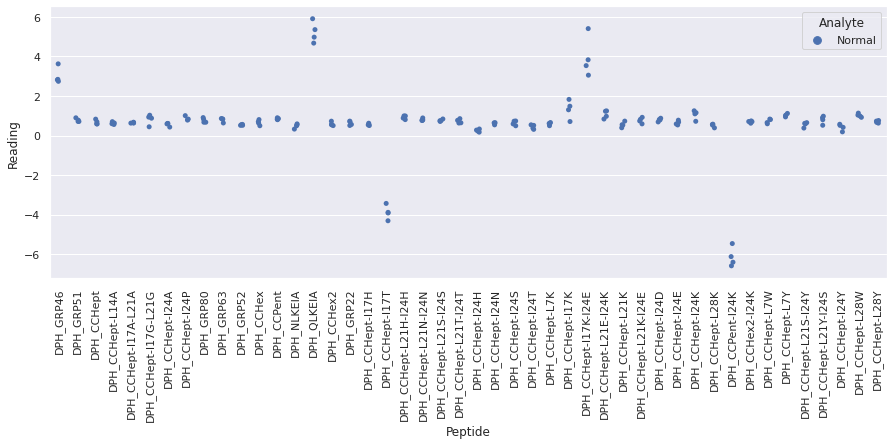

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_eightR4_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_eightR4_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_eightR4_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_ei

<Figure size 720x720 with 0 Axes>

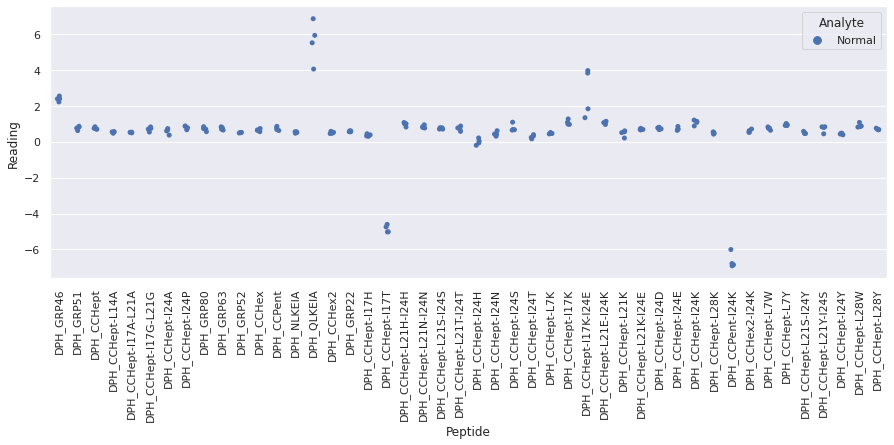

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentythreeR1_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentythreeR1_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentythreeR1_repeat_9 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

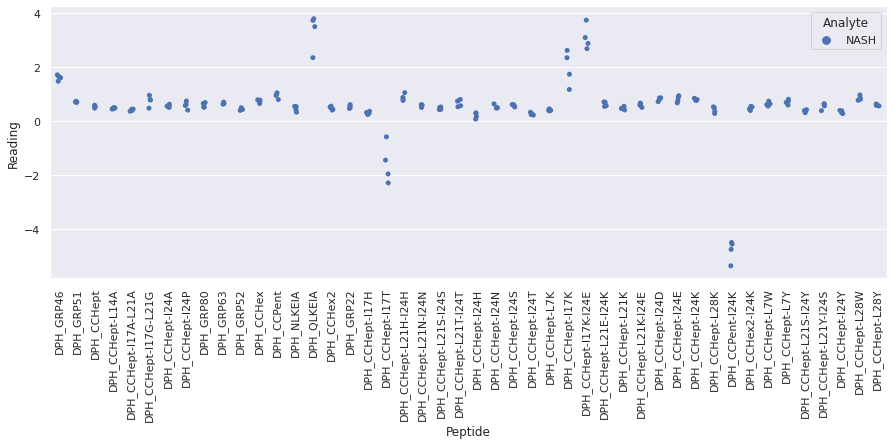

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentythreeR2_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentythreeR2_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentythreeR2_repeat_9 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

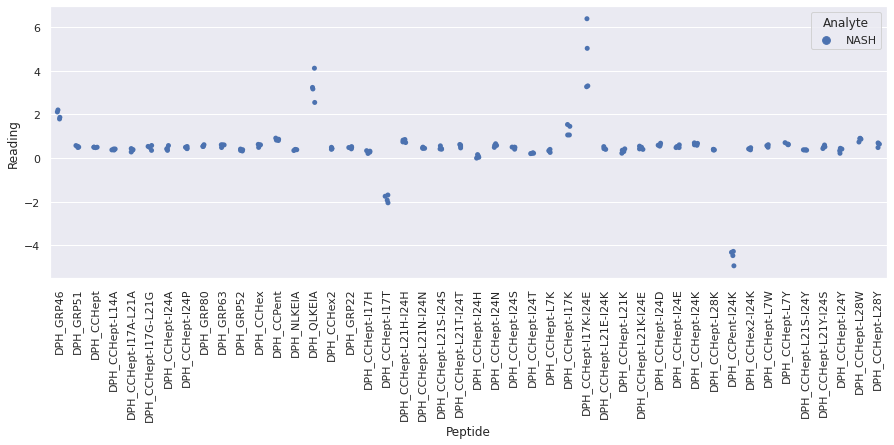

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentythreeR3_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentythreeR3_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentythreeR3_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twen

<Figure size 720x720 with 0 Axes>

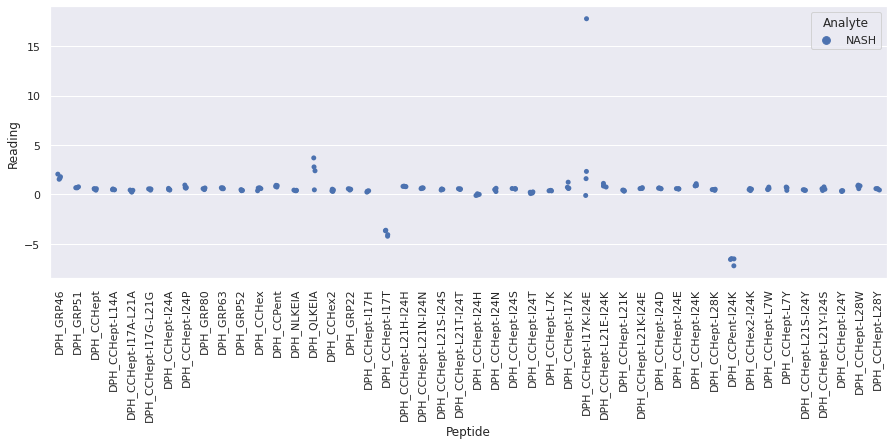

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentythreeR4_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentythreeR4_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I17K-I24E + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentythreeR4_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DP

<Figure size 720x720 with 0 Axes>

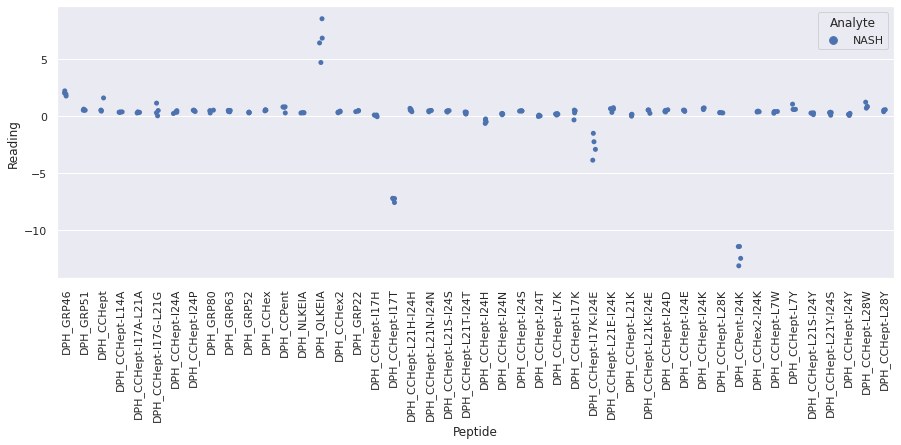

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR1_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR1_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_nineR1_repeat_9 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

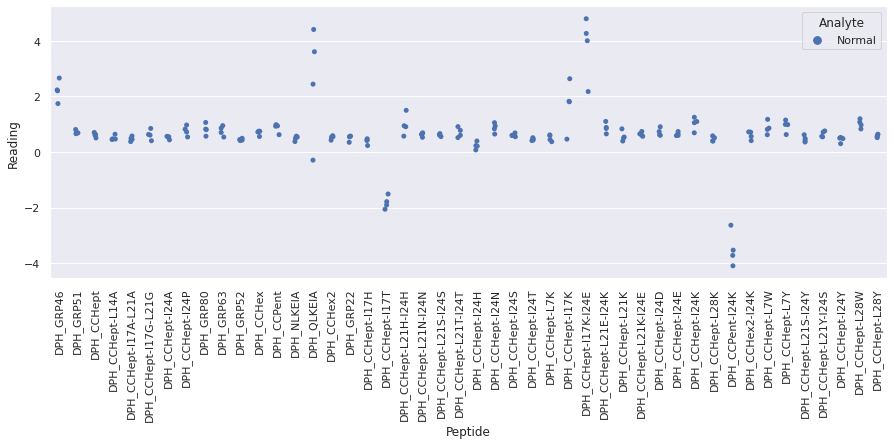

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR2_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR2_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR2_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_nineR

<Figure size 720x720 with 0 Axes>

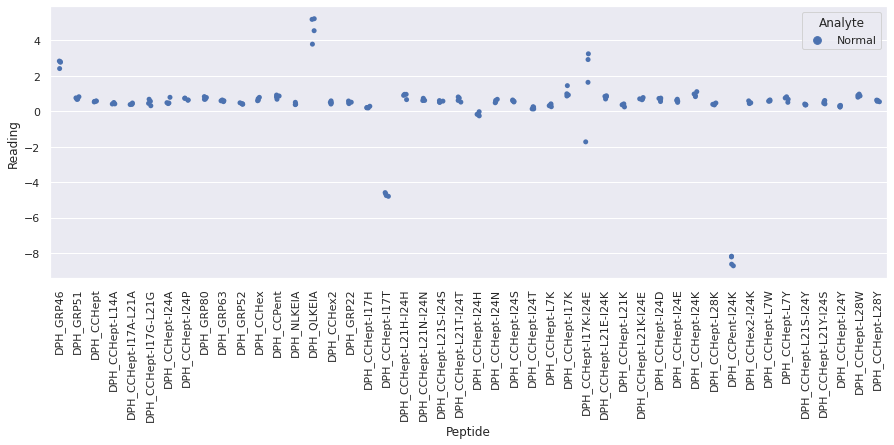

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR3_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR3_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR3_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_nineR

<Figure size 720x720 with 0 Axes>

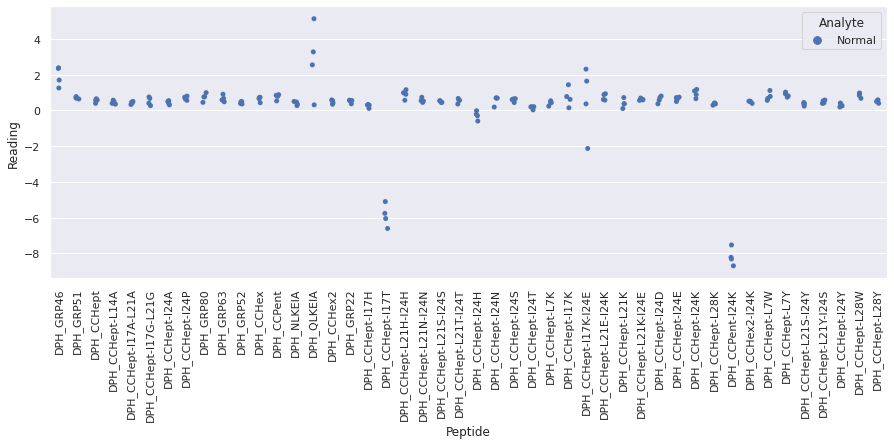

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR4_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR4_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-I24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_nineR4_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH

<Figure size 720x720 with 0 Axes>

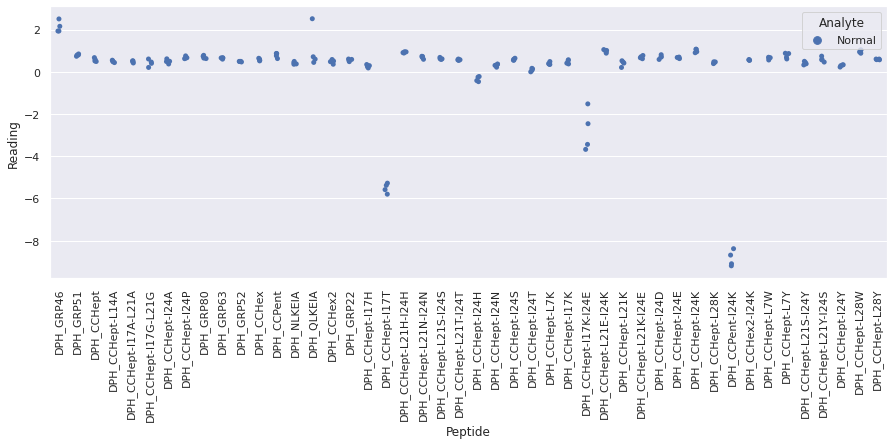

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfourR1_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfourR1_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyfourR1_repeat_10 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

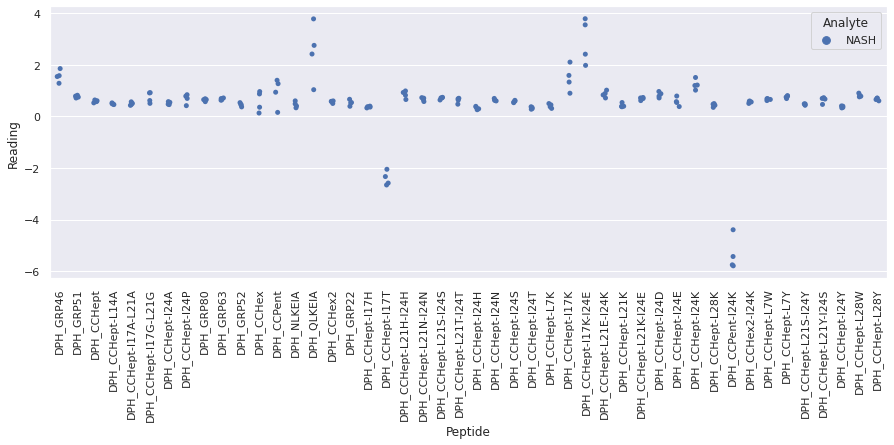

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfourR2_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfourR2_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyfourR2_repeat_10 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

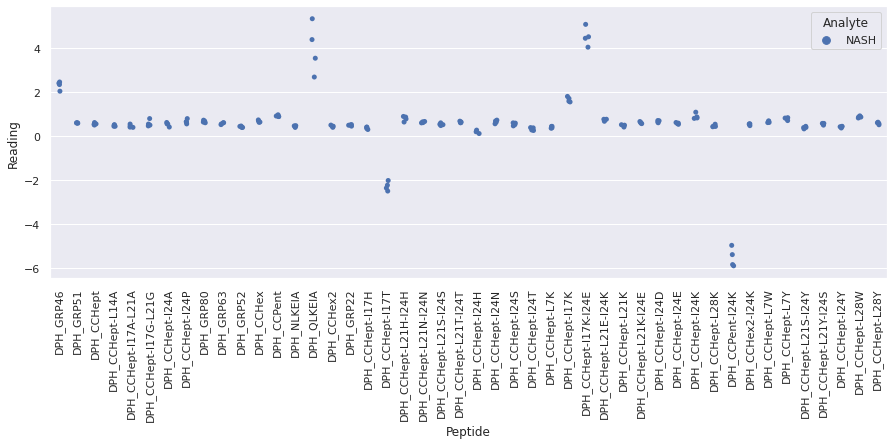

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfourR3_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfourR3_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyfourR3_repeat_10 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

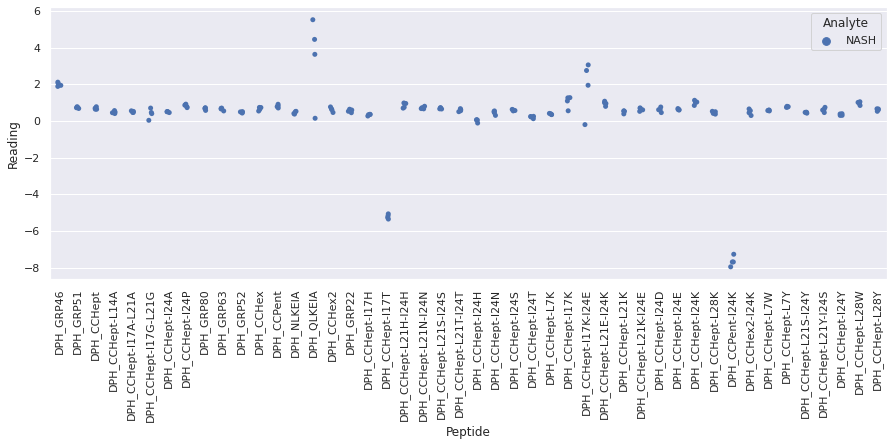

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfourR4_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfourR4_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I24T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfourR4_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCH

<Figure size 720x720 with 0 Axes>

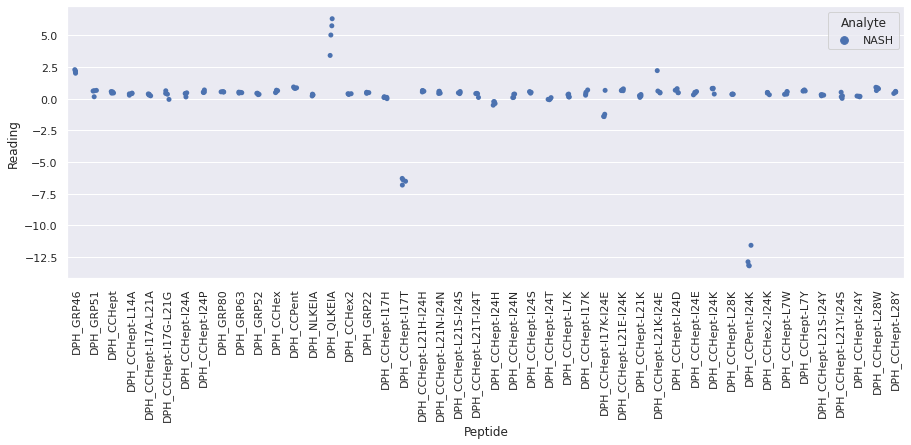

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_tenR1_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_tenR1_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_tenR1_repeat_10 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

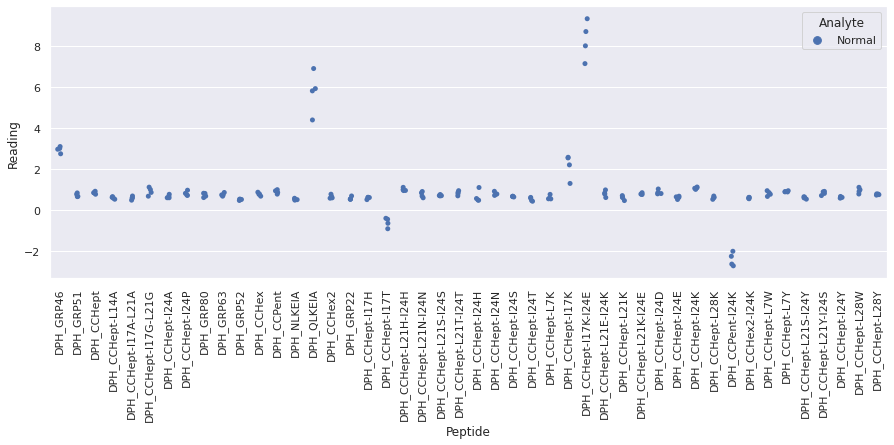

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_tenR2_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_tenR2_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_tenR2_repeat_10 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

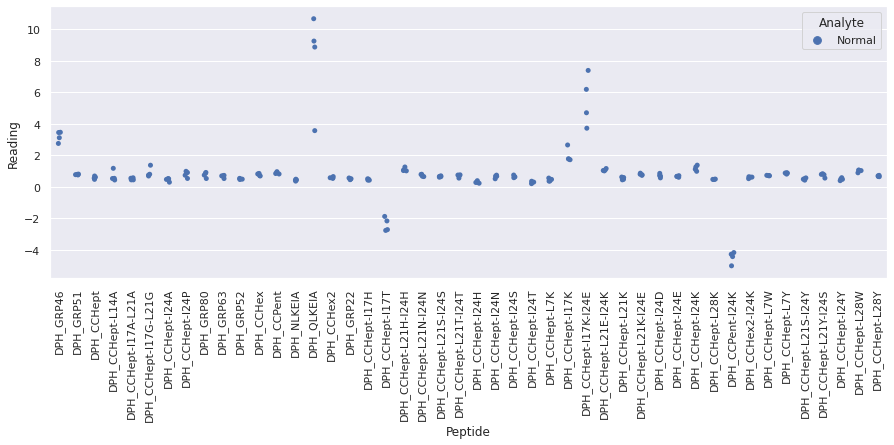

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_tenR3_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_tenR3_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_tenR3_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_tenR3

<Figure size 720x720 with 0 Axes>

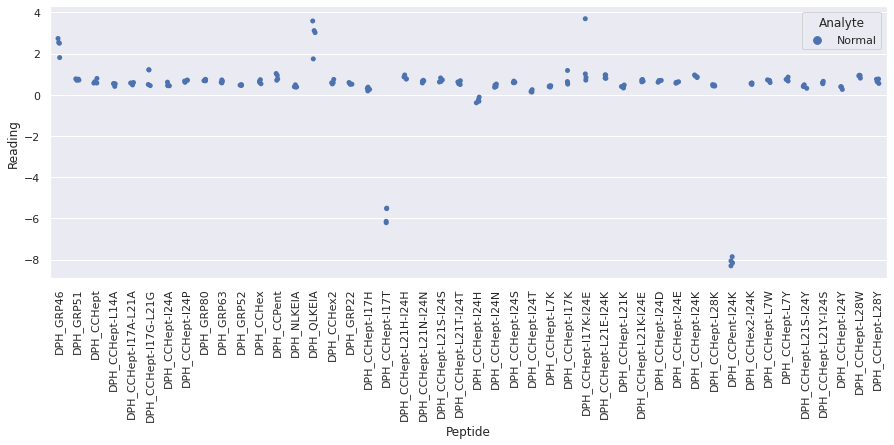

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_tenR4_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_tenR4_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_tenR4_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_tenR4

<Figure size 720x720 with 0 Axes>

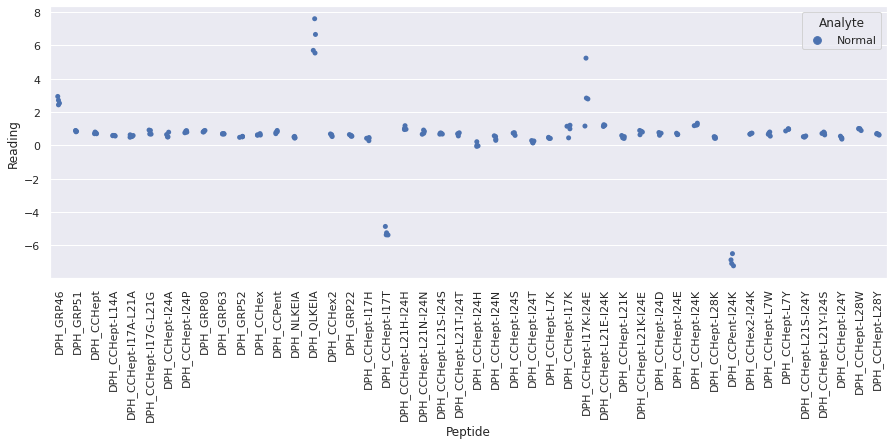

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfiveR1_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfiveR1_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyfiveR1_repeat_11 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

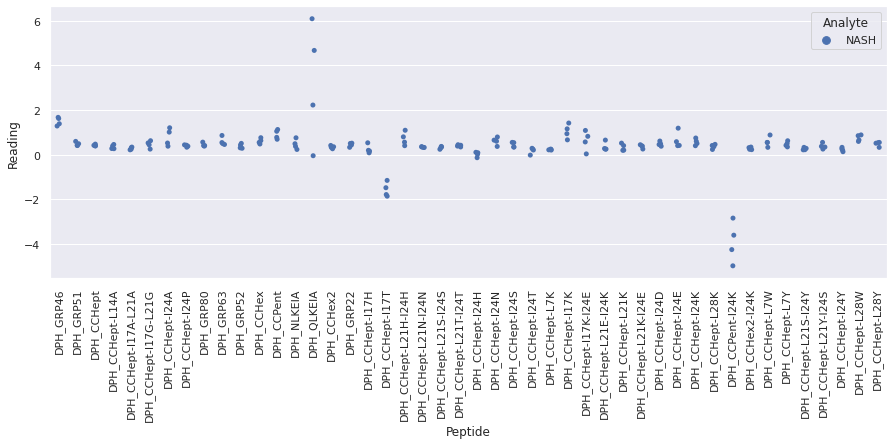

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfiveR2_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfiveR2_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyfiveR2_repeat_11 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

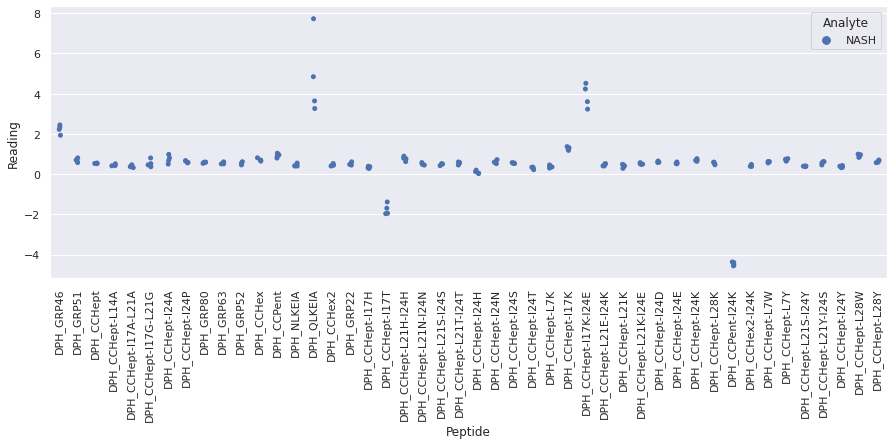

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfiveR3_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfiveR3_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfiveR3_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twen

<Figure size 720x720 with 0 Axes>

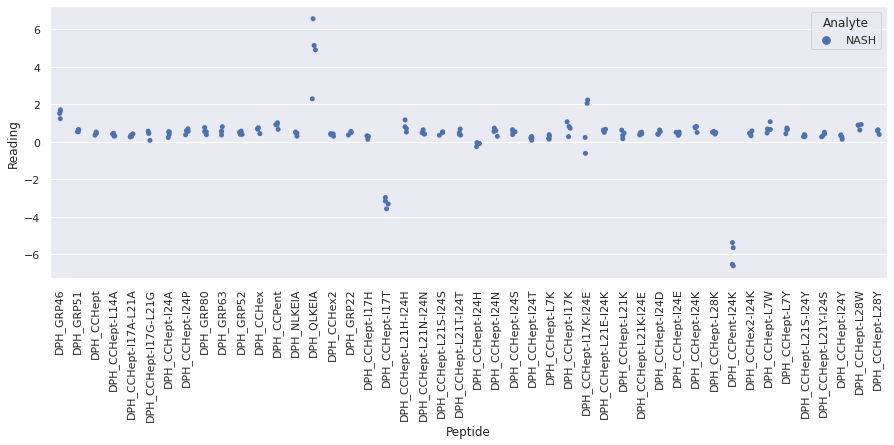

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfiveR4_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfiveR4_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyfiveR4_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twen

<Figure size 720x720 with 0 Axes>

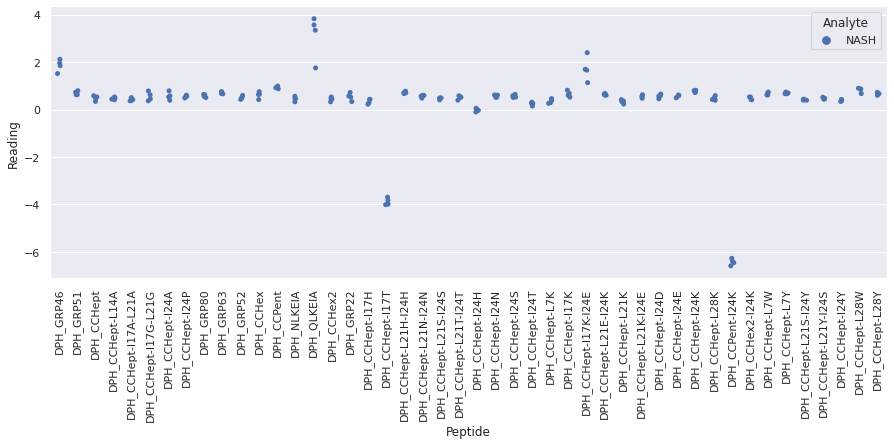

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_elevenR1_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_elevenR1_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_elevenR1_repeat_11 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

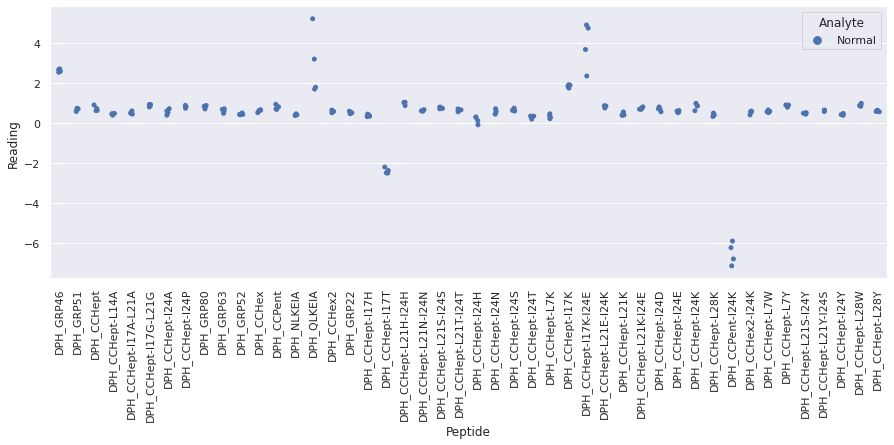

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_elevenR2_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_elevenR2_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_elevenR2_repeat_11 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

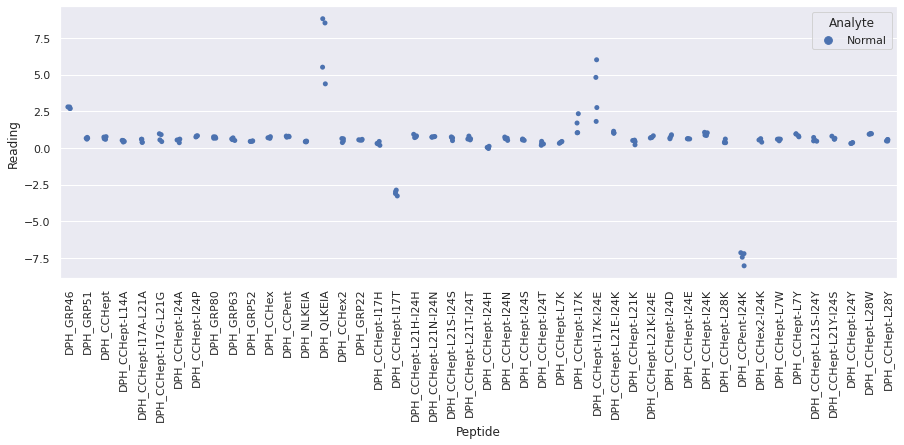

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_elevenR3_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_elevenR3_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_elevenR3_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Nor

<Figure size 720x720 with 0 Axes>

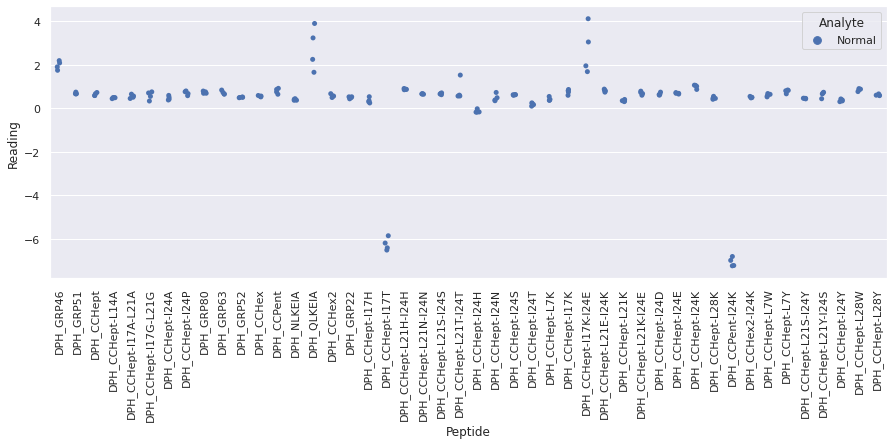

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_elevenR4_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_elevenR4_repeat_11.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_elevenR4_repeat_11 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

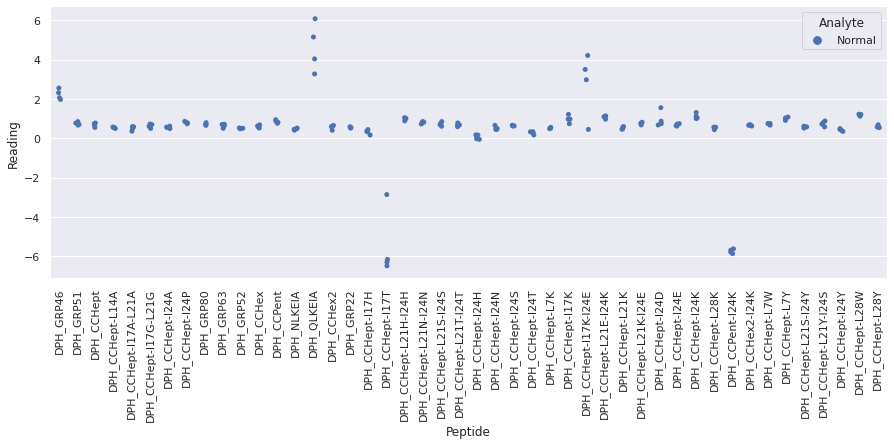

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysixR1_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysixR1_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentysixR1_repeat_12 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

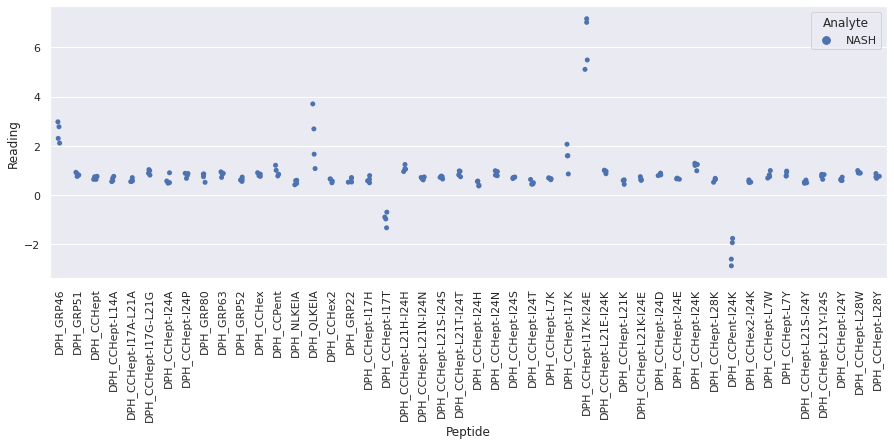

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysixR2_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysixR2_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentysixR2_repeat_12 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

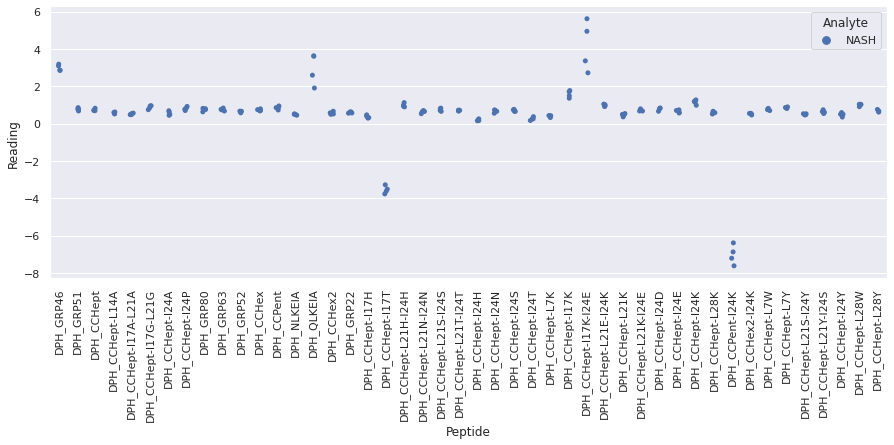

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysixR3_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysixR3_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysixR3_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentys

<Figure size 720x720 with 0 Axes>

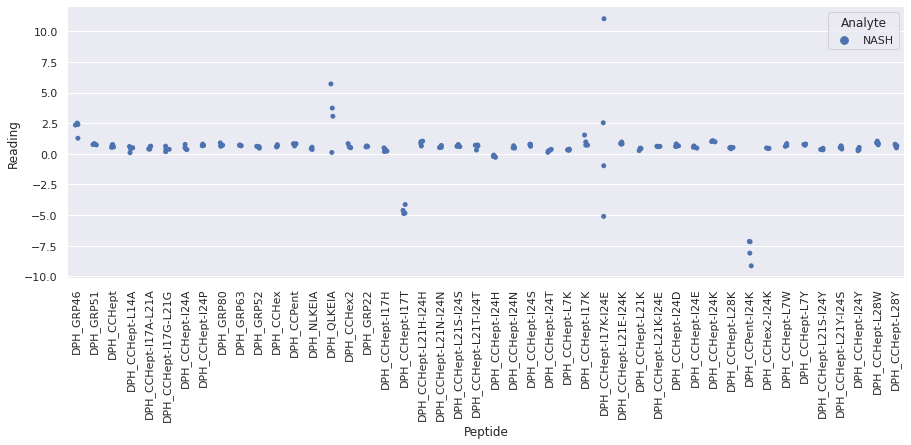

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysixR4_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysixR4_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentysixR4_repeat_12 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

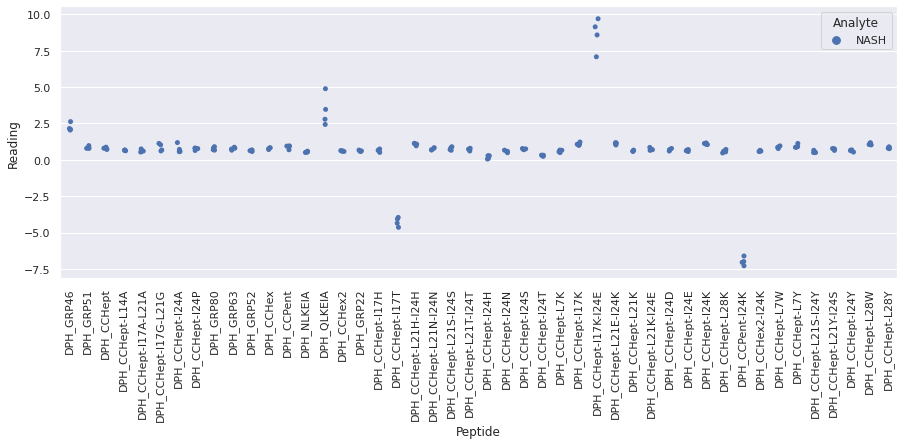

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twelveR1_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twelveR1_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twelveR1_repeat_12 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

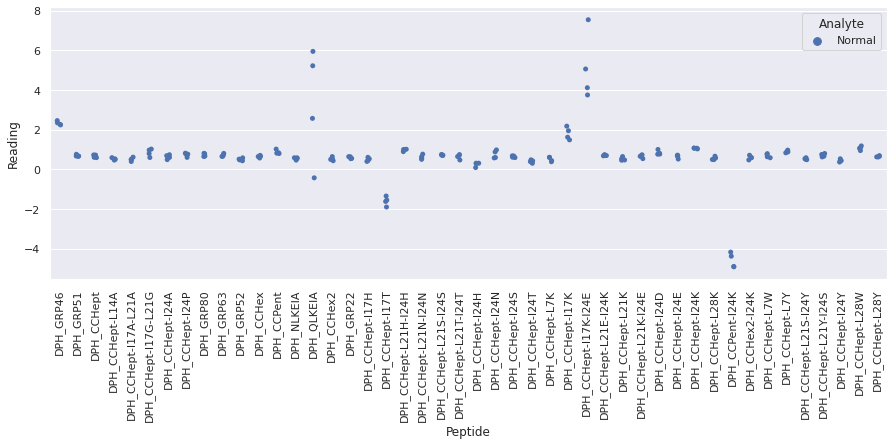

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twelveR2_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twelveR2_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twelveR2_repeat_12 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

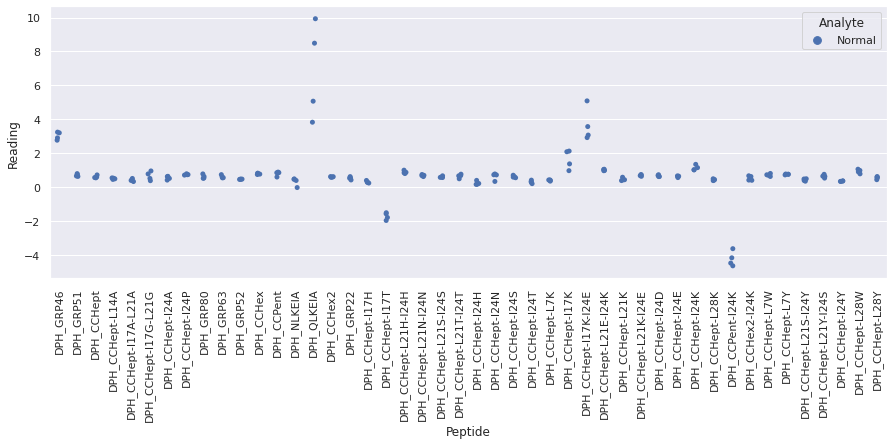

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twelveR3_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twelveR3_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twelveR3_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Nor

<Figure size 720x720 with 0 Axes>

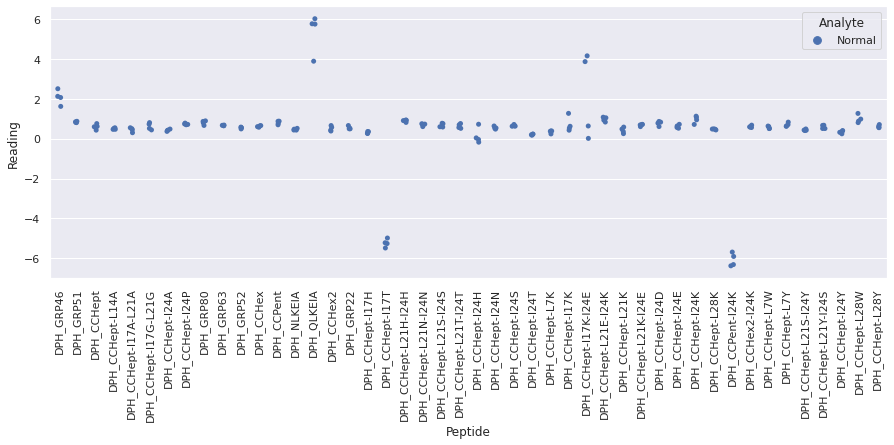

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twelveR4_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twelveR4_repeat_12.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twelveR4_repeat_12 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

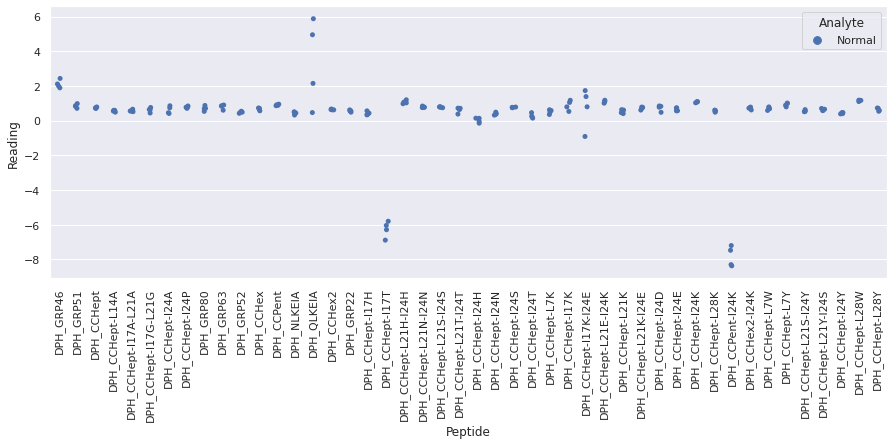

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysevenR1_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysevenR1_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentysevenR1_repeat_13 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

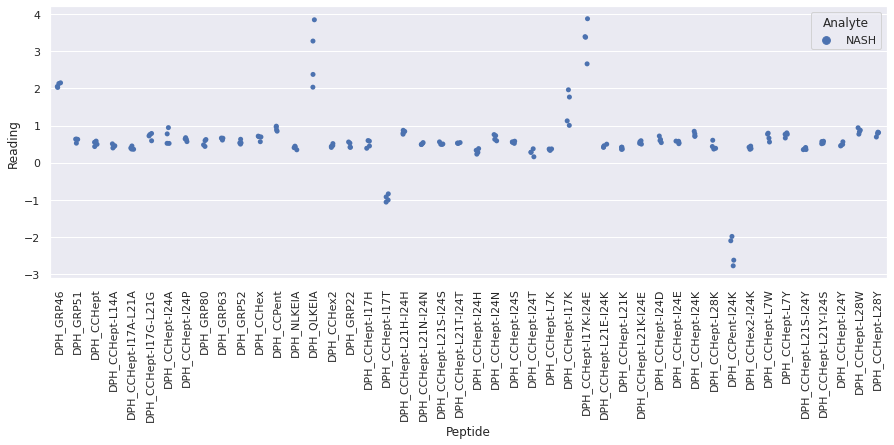

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysevenR2_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysevenR2_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentysevenR2_repeat_13 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

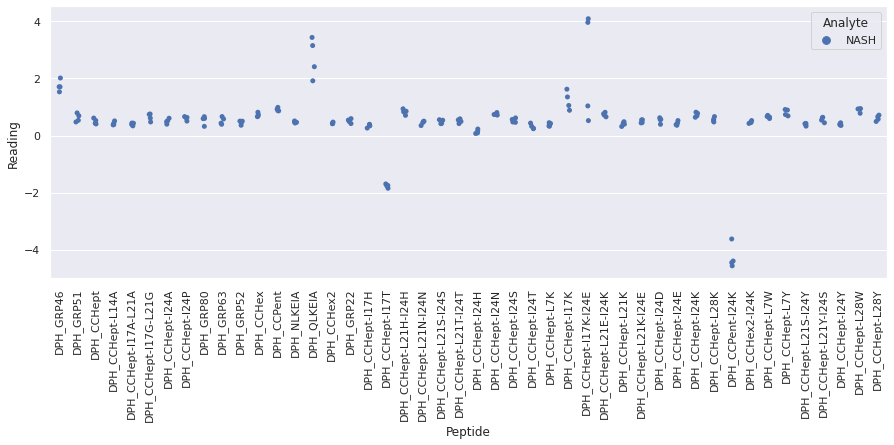

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysevenR3_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysevenR3_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysevenR3_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_t

<Figure size 720x720 with 0 Axes>

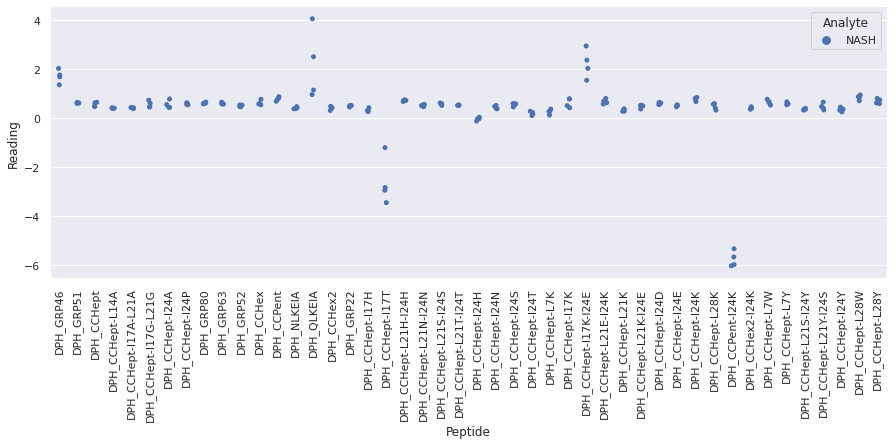

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysevenR4_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysevenR4_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentysevenR4_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_t

<Figure size 720x720 with 0 Axes>

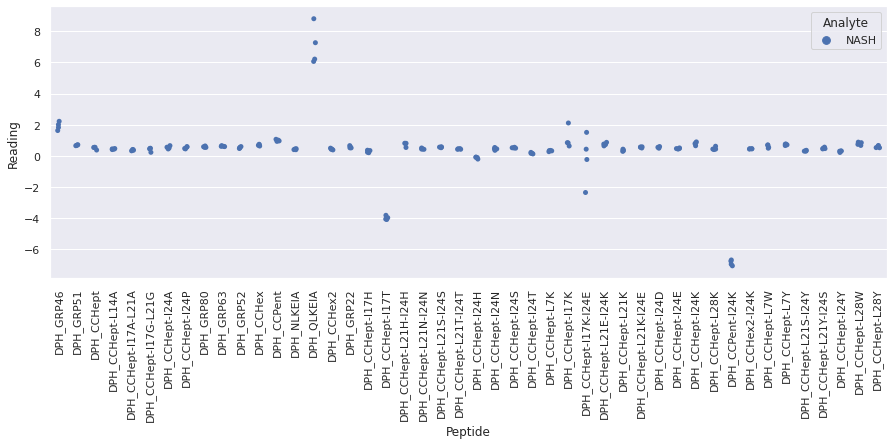

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirteenR1_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirteenR1_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirteenR1_repeat_13 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

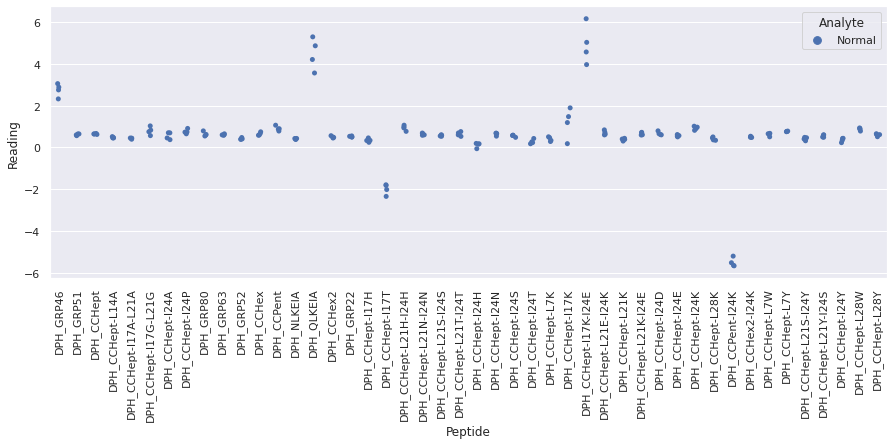

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirteenR2_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirteenR2_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirteenR2_repeat_13 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

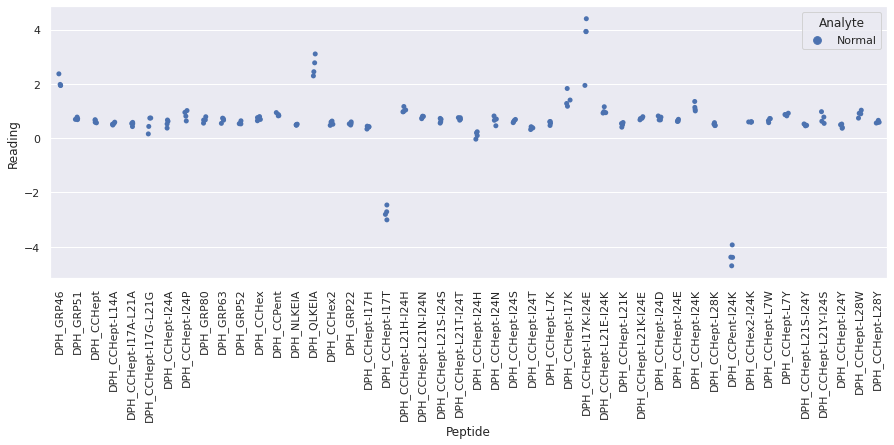

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirteenR3_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirteenR3_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirteenR3_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread f

<Figure size 720x720 with 0 Axes>

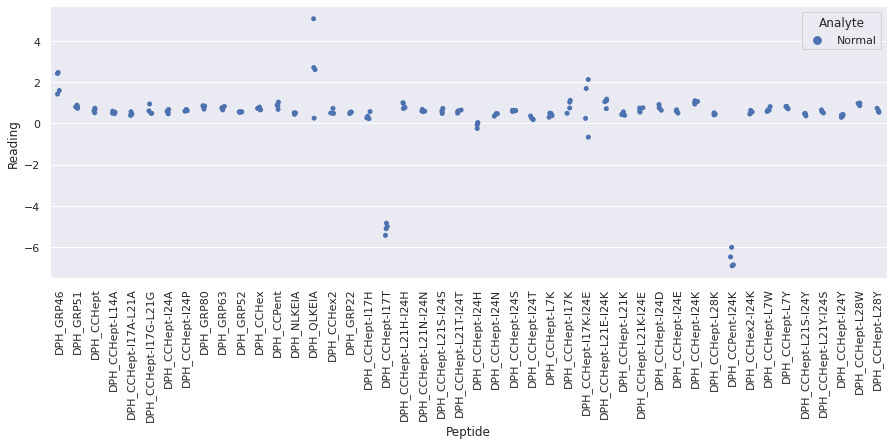

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirteenR4_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirteenR4_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-I24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirteenR4_repeat_13.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence o

<Figure size 720x720 with 0 Axes>

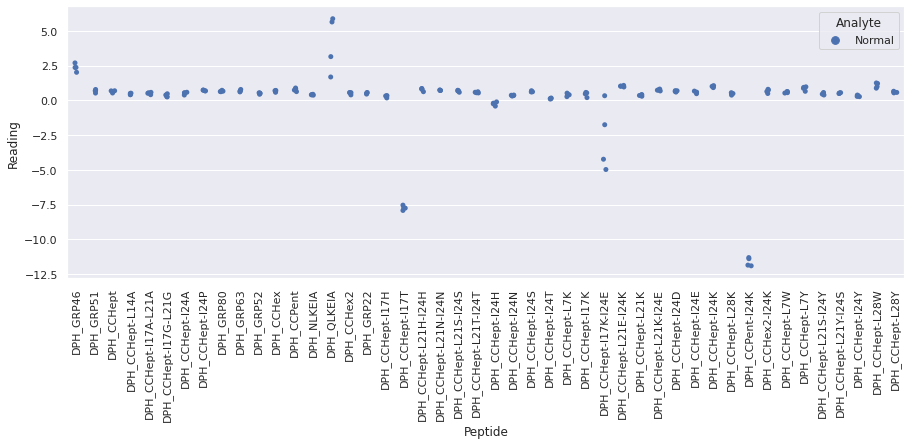

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyeightR1_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyeightR1_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyeightR1_repeat_14 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

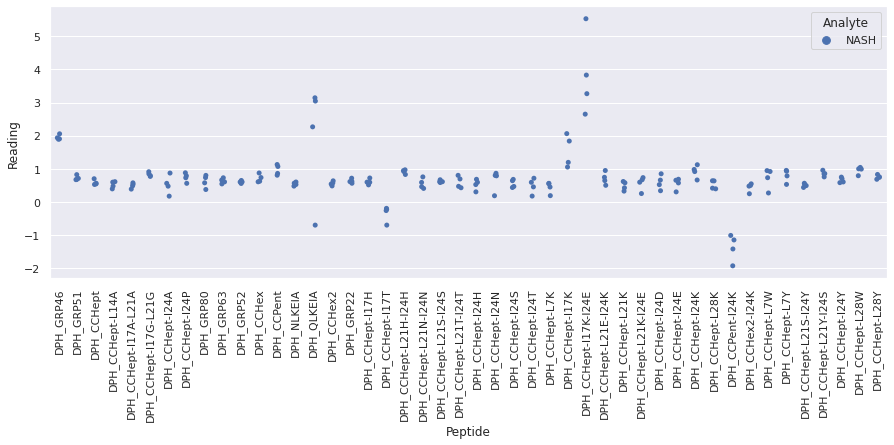

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyeightR2_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyeightR2_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyeightR2_repeat_14 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

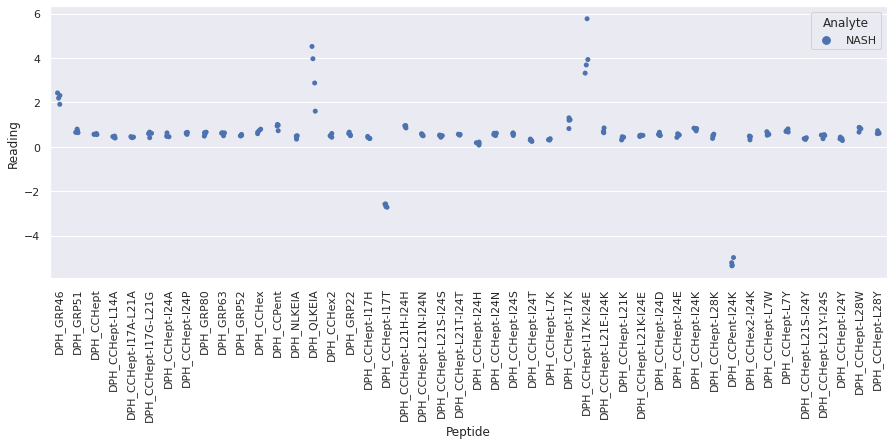

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyeightR3_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyeightR3_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyeightR3_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_t

<Figure size 720x720 with 0 Axes>

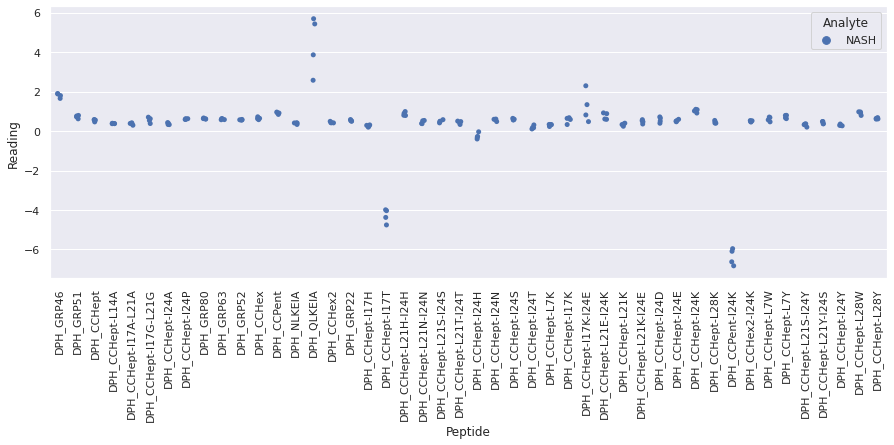

 WARNING - median fluorescence of (NASH + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyeightR4_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyeightR4_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH + DPH_CCHept-I17K-I24E + fluorophore) is less than fluorescence of (NASH + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_twentyeightR4_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH +

<Figure size 720x720 with 0 Axes>

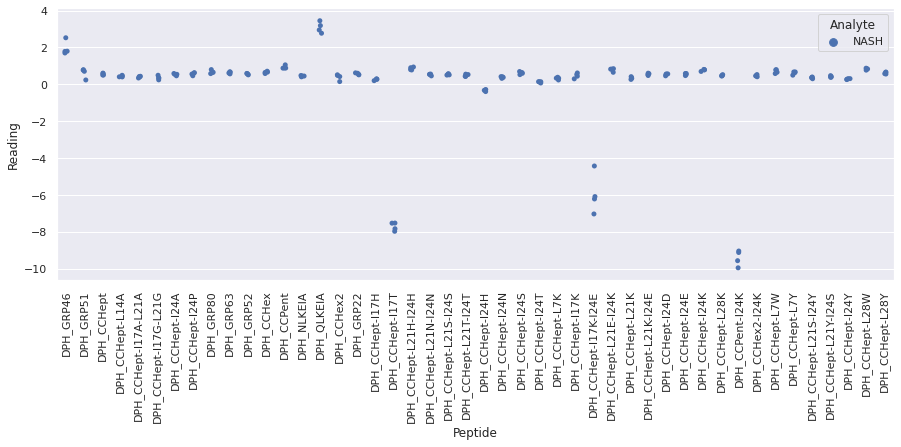

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourteenR1_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourteenR1_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fourteenR1_repeat_14 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

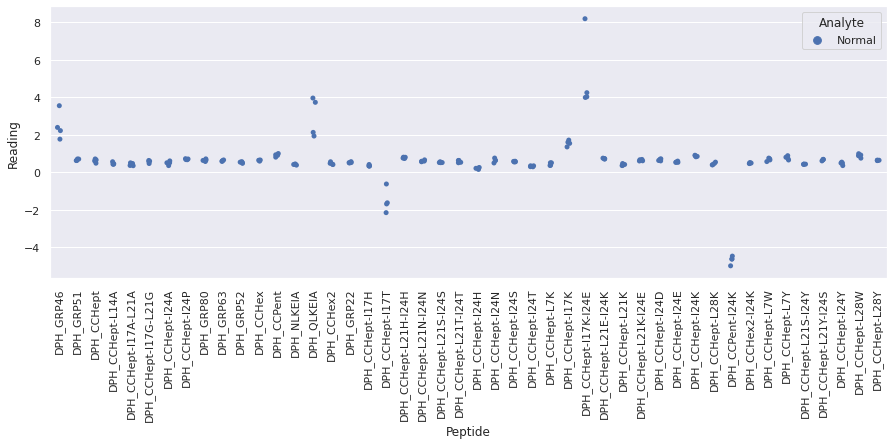

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourteenR2_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourteenR2_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fourteenR2_repeat_14 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

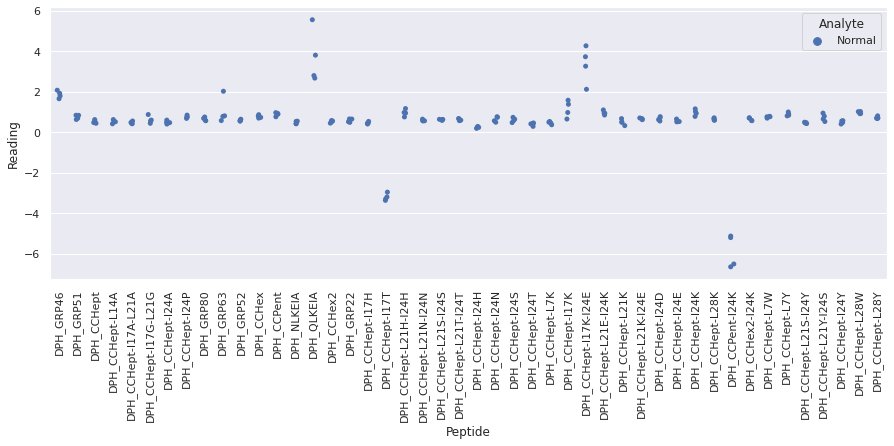

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourteenR3_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourteenR3_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fourteenR3_repeat_14 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

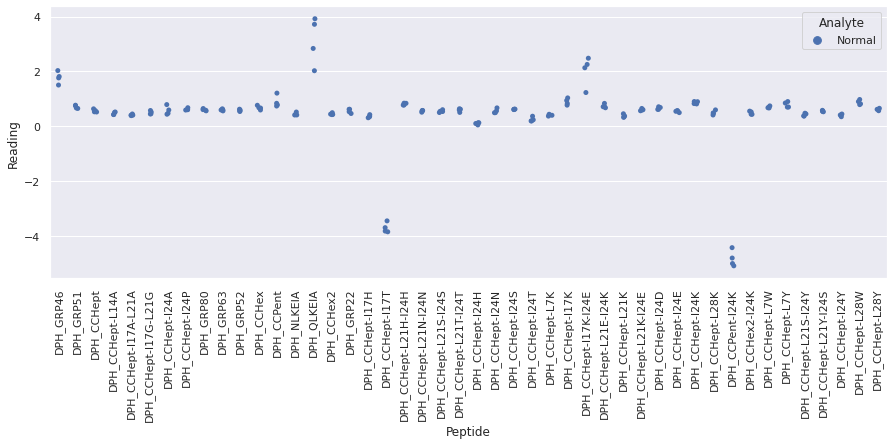

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourteenR4_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourteenR4_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-I24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fourteenR4_repeat_14.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence o

<Figure size 720x720 with 0 Axes>

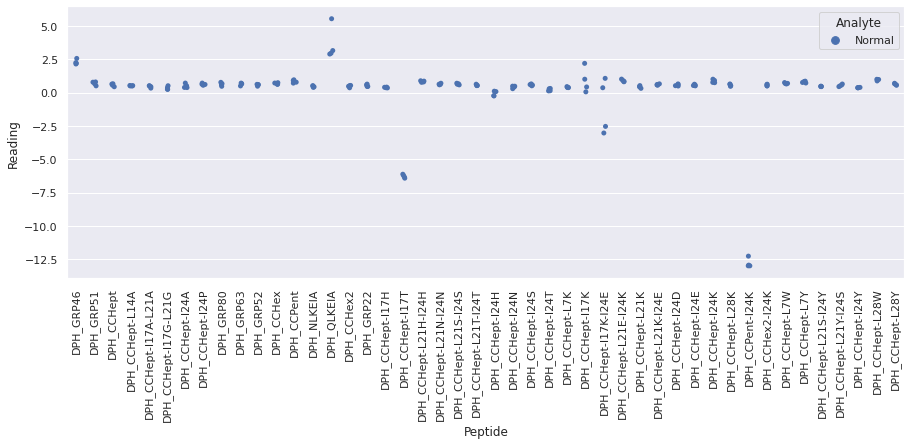

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twentynineR1_repeat_15.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twentynineR1_repeat_15.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twentynineR1_repeat_15 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

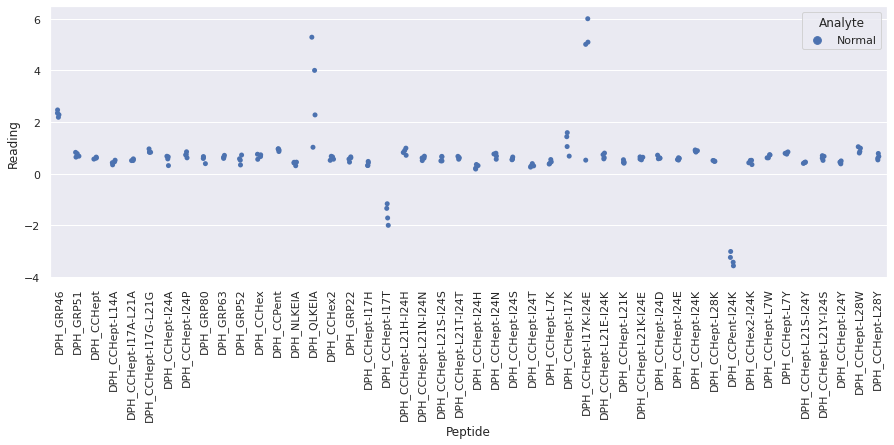

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twentynineR2_repeat_15.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twentynineR2_repeat_15.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twentynineR2_repeat_15 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

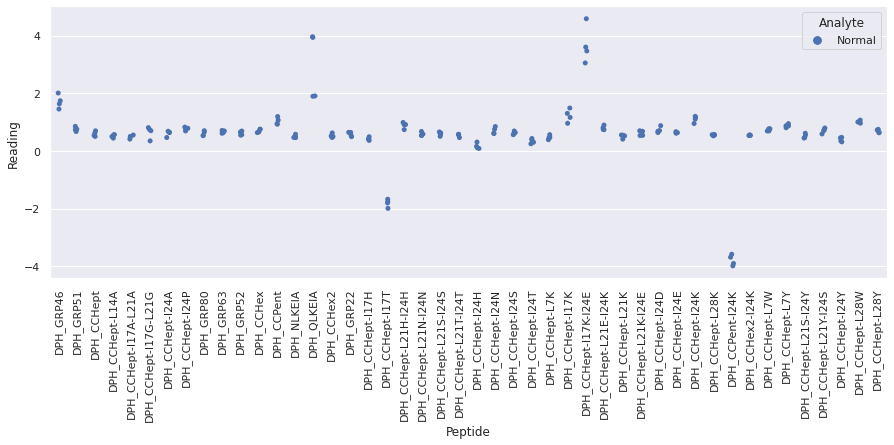

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twentynineR3_repeat_15.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twentynineR3_repeat_15.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twentynineR3_repeat_15 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

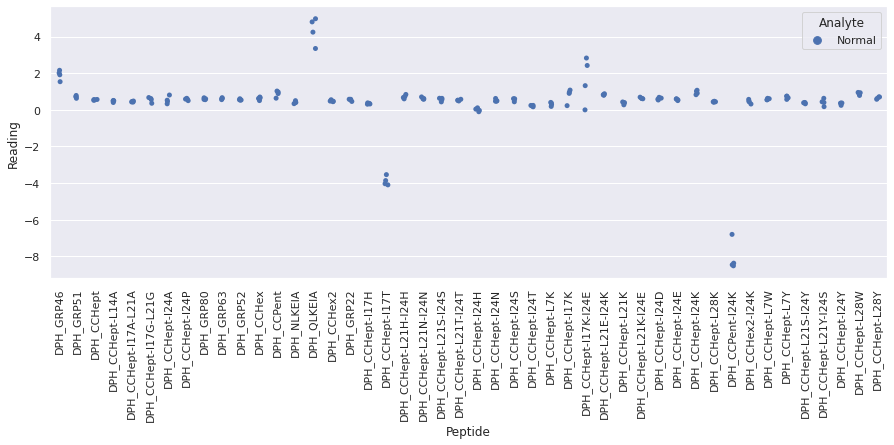

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twentynineR4_repeat_15.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_twentynineR4_repeat_15.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twentynineR4_repeat_15 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

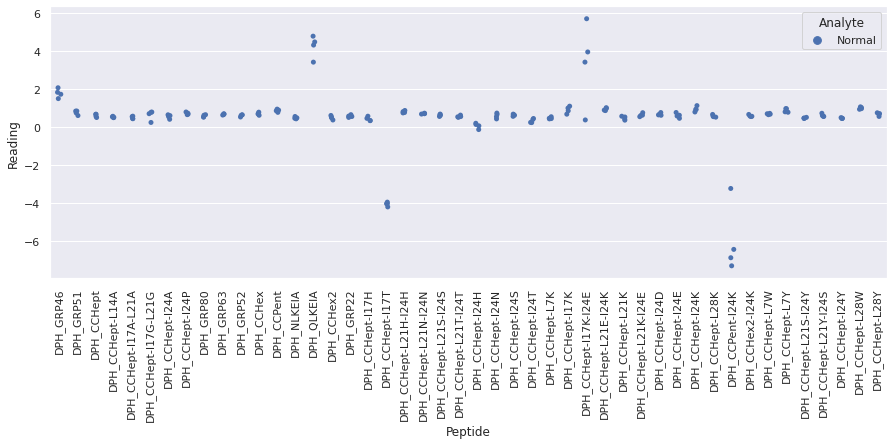

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR1_repeat_16.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR1_repeat_16.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyR1_repeat_16 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

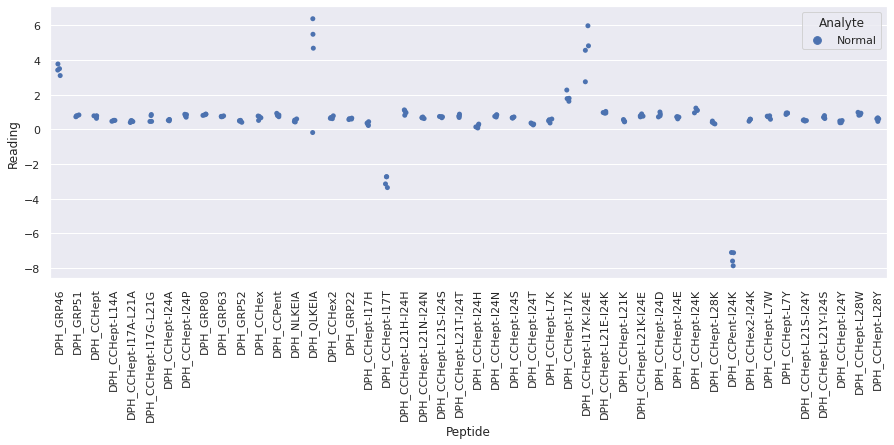

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR2_repeat_16.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR2_repeat_16.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR2_repeat_16.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Nor

<Figure size 720x720 with 0 Axes>

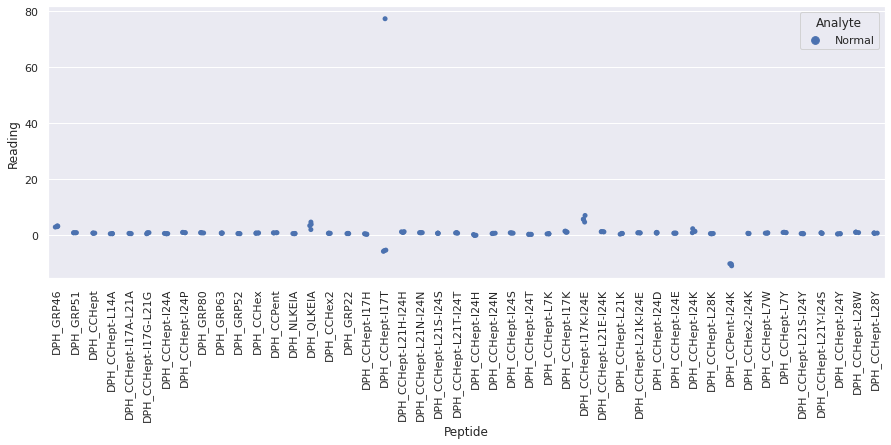

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR3_repeat_16.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR3_repeat_16.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-I24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR3_repeat_16.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Nor

<Figure size 720x720 with 0 Axes>

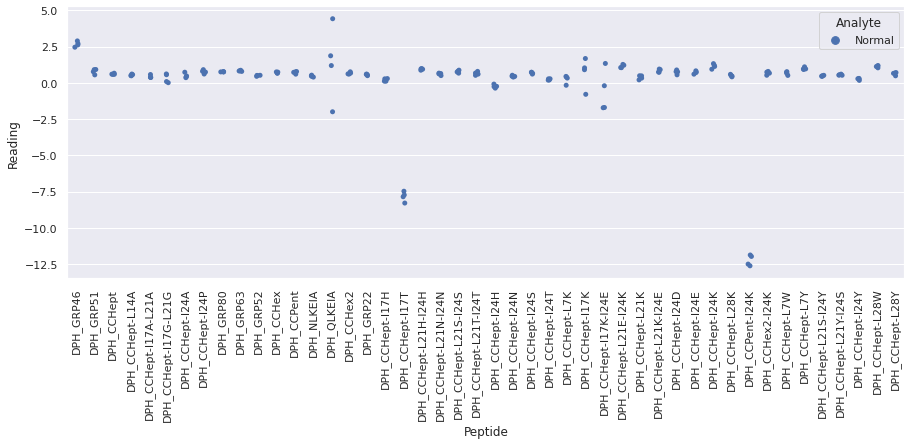

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR4_repeat_16.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR4_repeat_16.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyR4_repeat_16.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Nor

<Figure size 720x720 with 0 Axes>

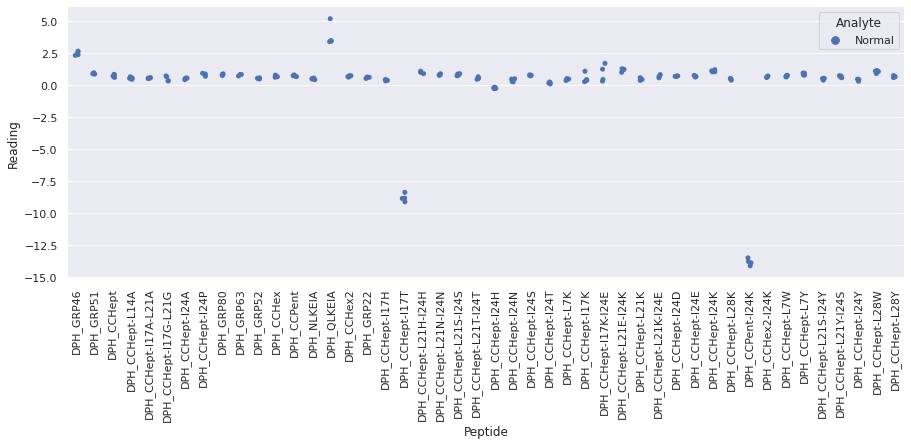

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyoneR1_repeat_17.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyoneR1_repeat_17.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyoneR1_repeat_17 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

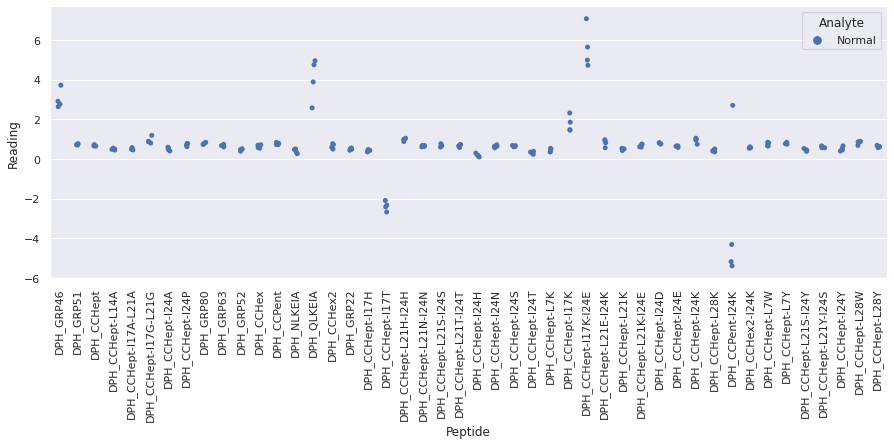

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyoneR2_repeat_17.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyoneR2_repeat_17.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyoneR2_repeat_17 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

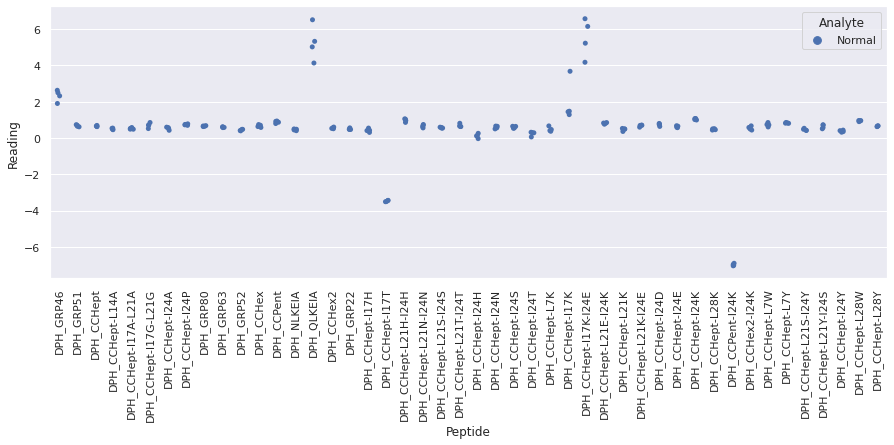

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyoneR3_repeat_17.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyoneR3_repeat_17.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyoneR3_repeat_17 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

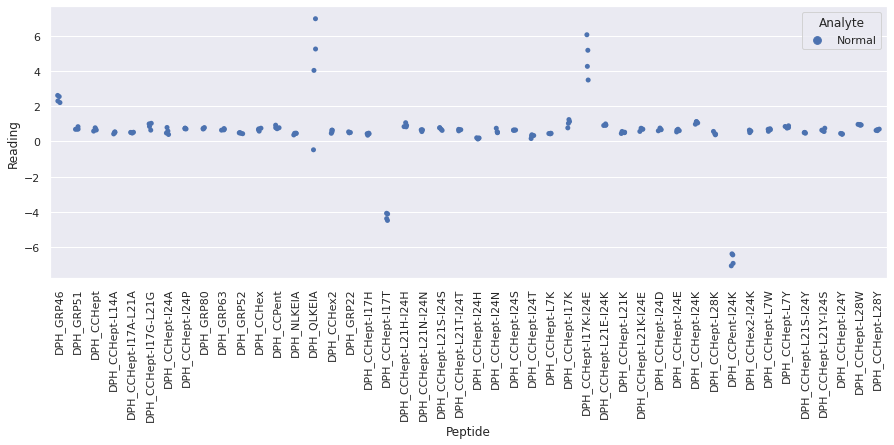

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyoneR4_repeat_17.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyoneR4_repeat_17.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyoneR4_repeat_17 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

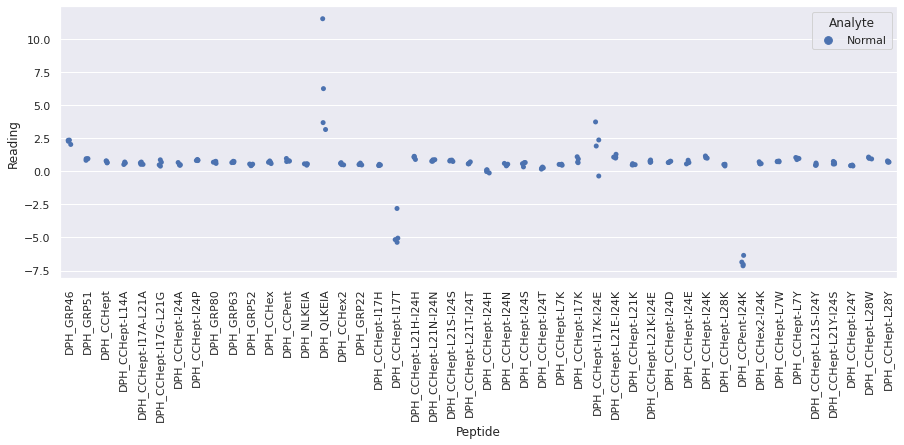

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR1_repeat_18.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR1_repeat_18.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR1_repeat_18.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data sprea

<Figure size 720x720 with 0 Axes>

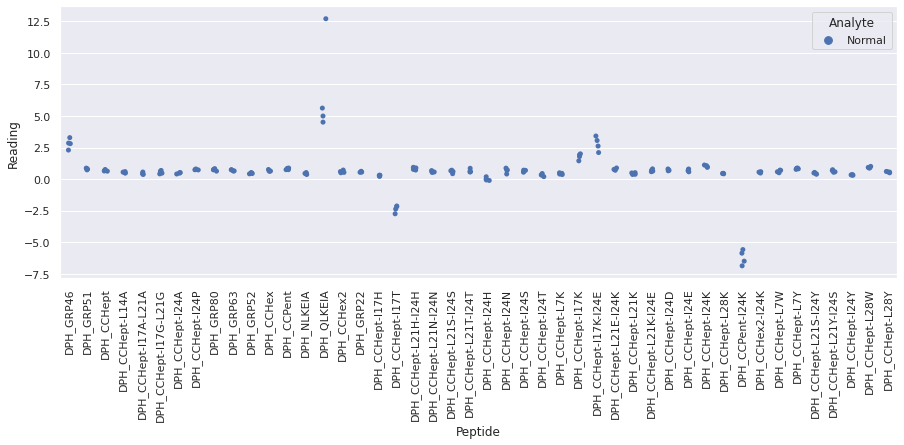

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR2_repeat_18.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR2_repeat_18.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtytwoR2_repeat_18 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

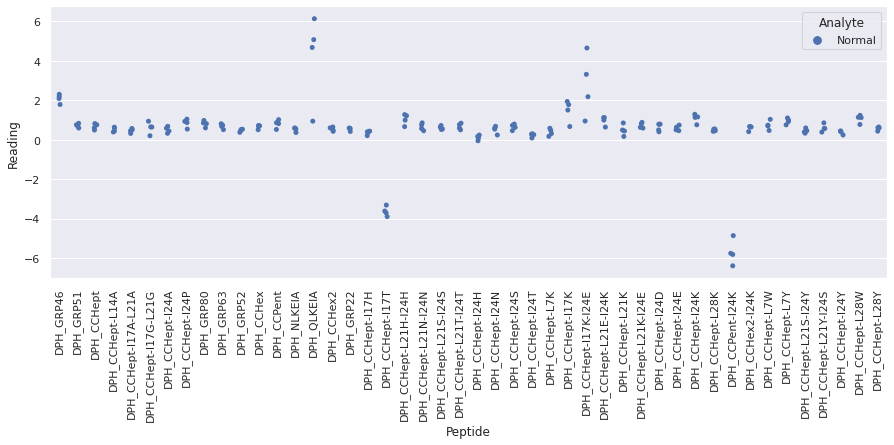

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR3_repeat_18.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR3_repeat_18.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR3_repeat_18.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data sprea

<Figure size 720x720 with 0 Axes>

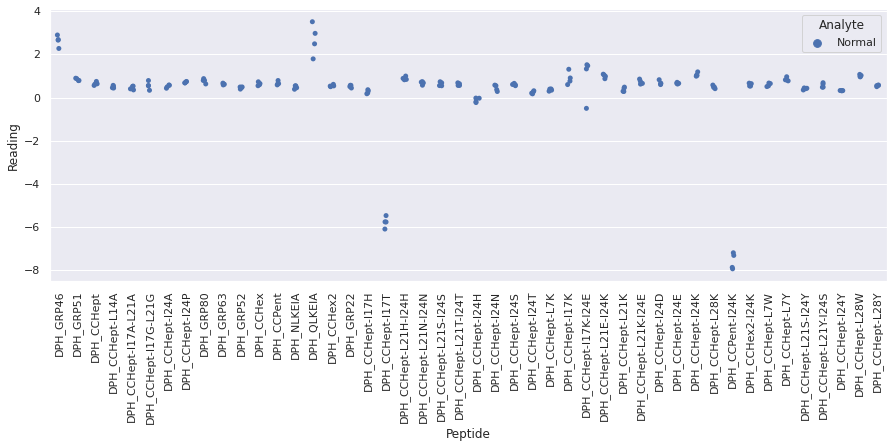

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR4_repeat_18.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR4_repeat_18.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-I24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtytwoR4_repeat_18.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescenc

<Figure size 720x720 with 0 Axes>

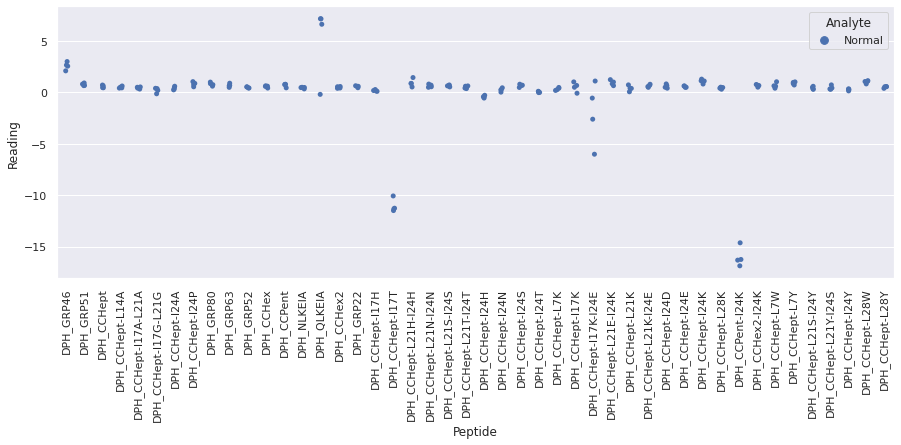

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR1_repeat_19.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR1_repeat_19.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtythreeR1_repeat_19 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

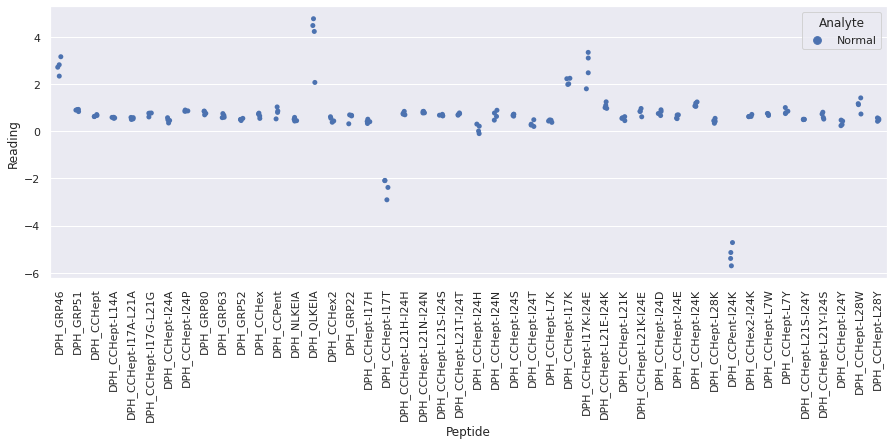

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR2_repeat_19.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR2_repeat_19.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR2_repeat_19.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data

<Figure size 720x720 with 0 Axes>

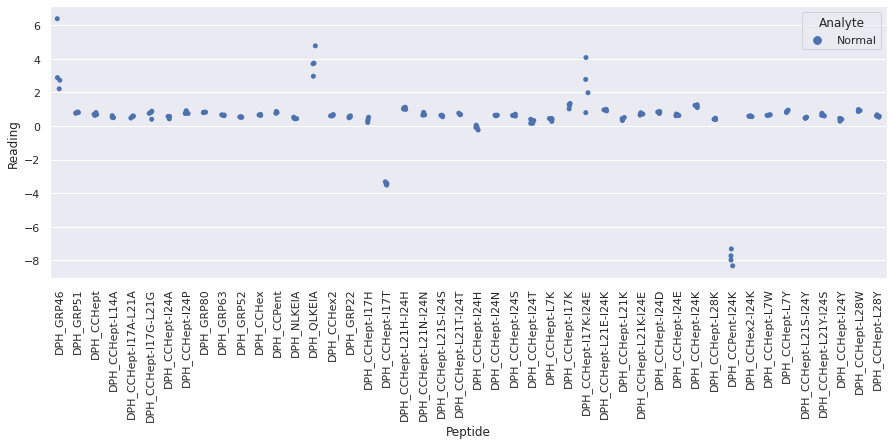

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR3_repeat_19.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR3_repeat_19.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-I24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR3_repeat_19.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluor

<Figure size 720x720 with 0 Axes>

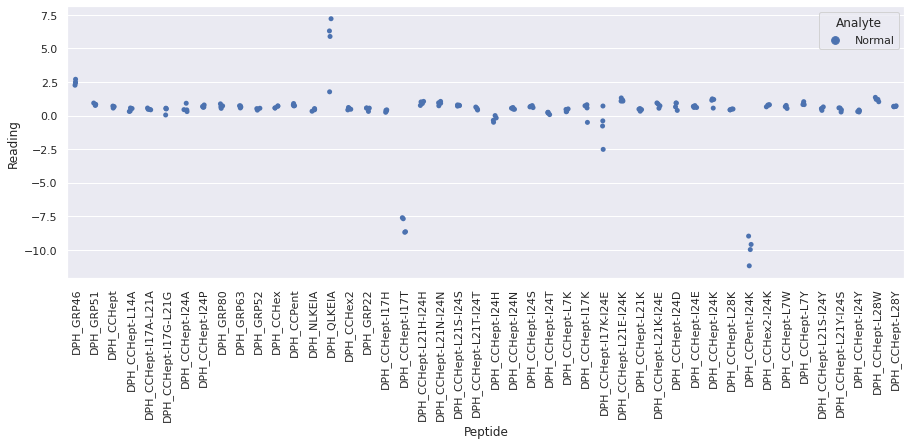

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR4_repeat_19.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR4_repeat_19.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-I24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtythreeR4_repeat_19.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluor

<Figure size 720x720 with 0 Axes>

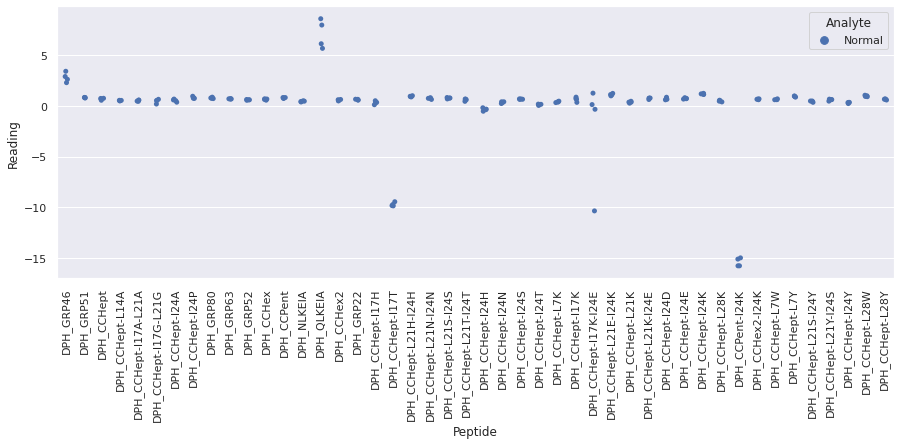

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfourR1_repeat_20.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfourR1_repeat_20.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyfourR1_repeat_20 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

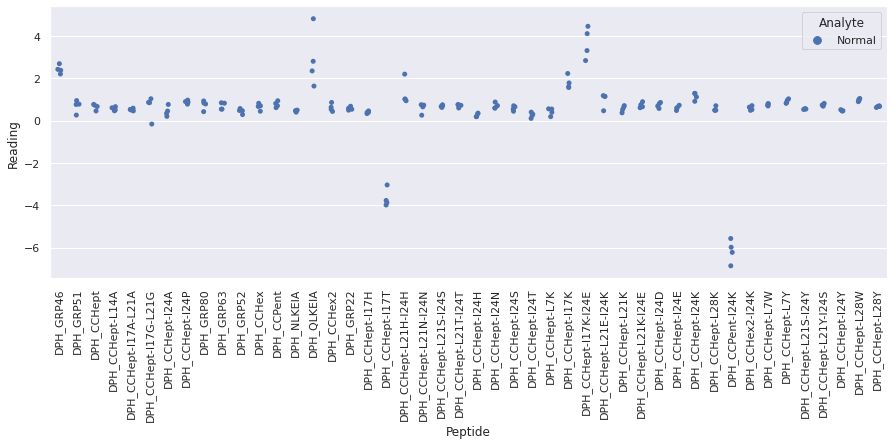

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfourR2_repeat_20.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfourR2_repeat_20.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyfourR2_repeat_20 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

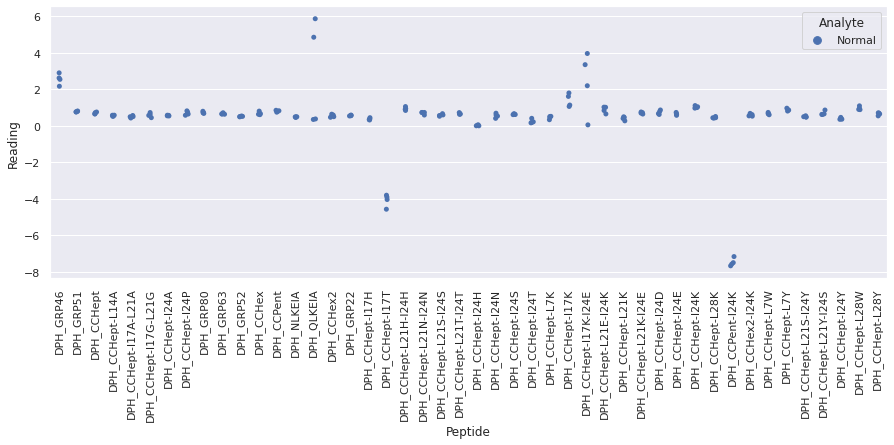

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfourR3_repeat_20.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-I24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfourR3_repeat_20.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfourR3_repeat_20.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of da

<Figure size 720x720 with 0 Axes>

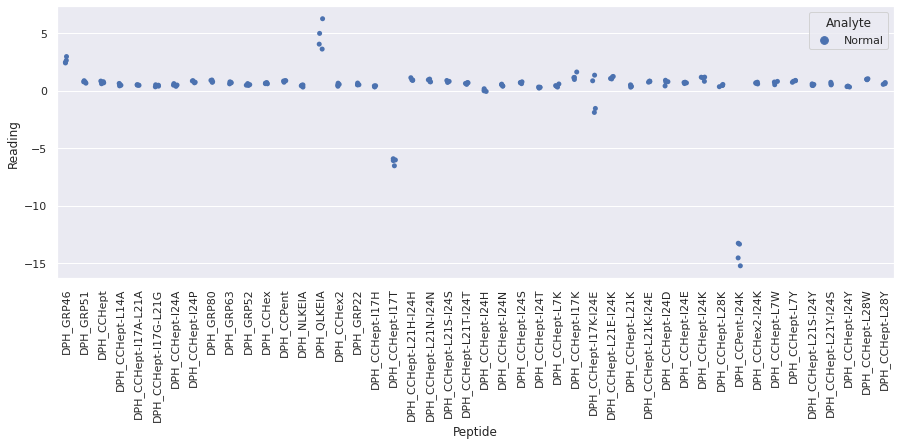

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfourR4_repeat_20.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfourR4_repeat_20.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfourR4_repeat_20.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data sp

<Figure size 720x720 with 0 Axes>

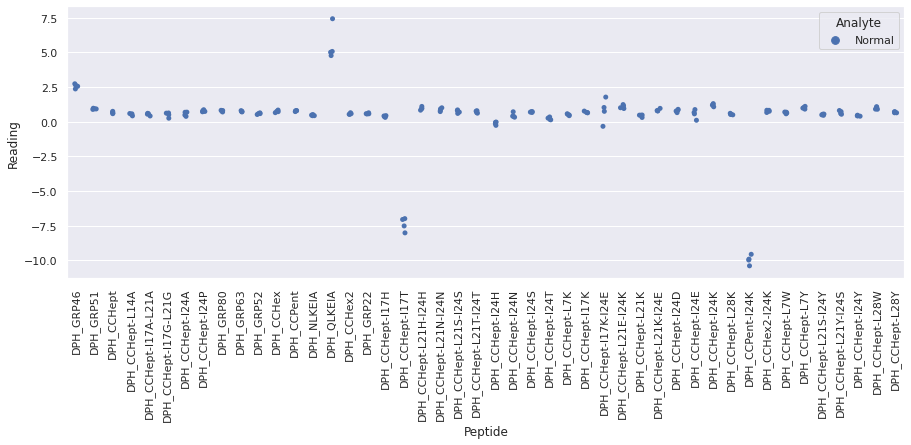

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfiveR1_repeat_21.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfiveR1_repeat_21.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyfiveR1_repeat_21 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

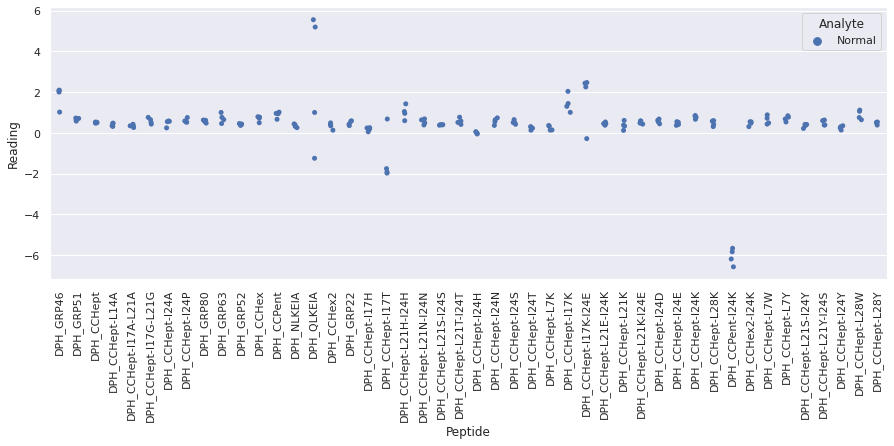

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfiveR2_repeat_21.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfiveR2_repeat_21.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyfiveR2_repeat_21 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

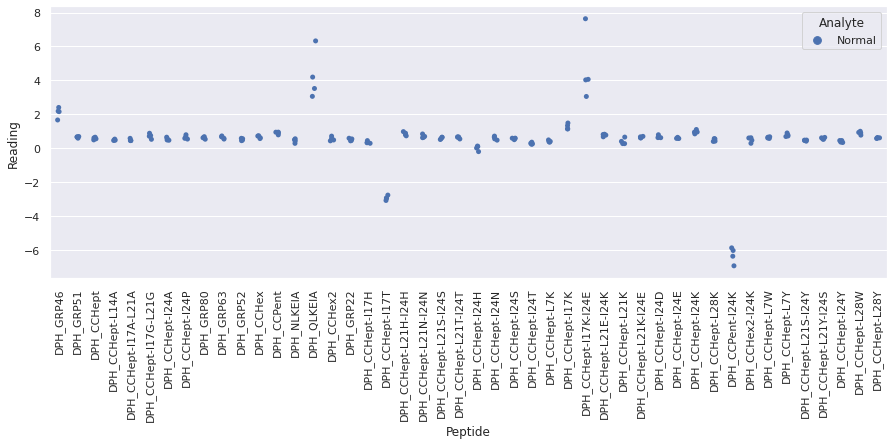

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfiveR3_repeat_21.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfiveR3_repeat_21.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-I24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfiveR3_repeat_21.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluoresc

<Figure size 720x720 with 0 Axes>

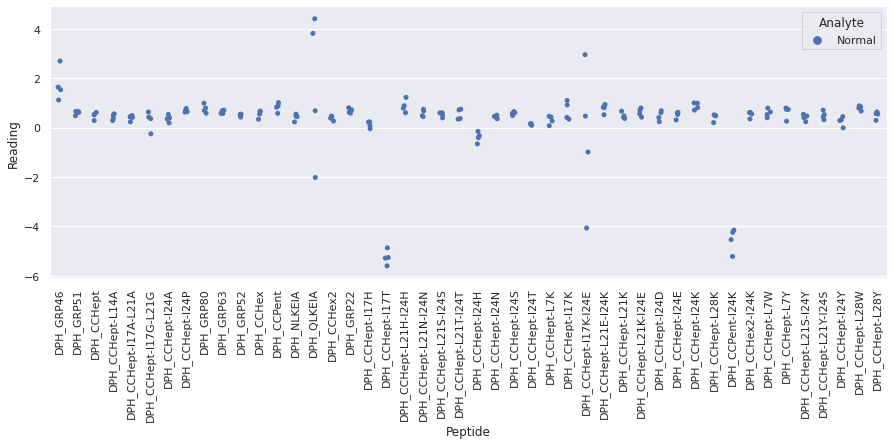

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfiveR4_repeat_21.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfiveR4_repeat_21.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-I24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyfiveR4_repeat_21.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluoresc

<Figure size 720x720 with 0 Axes>

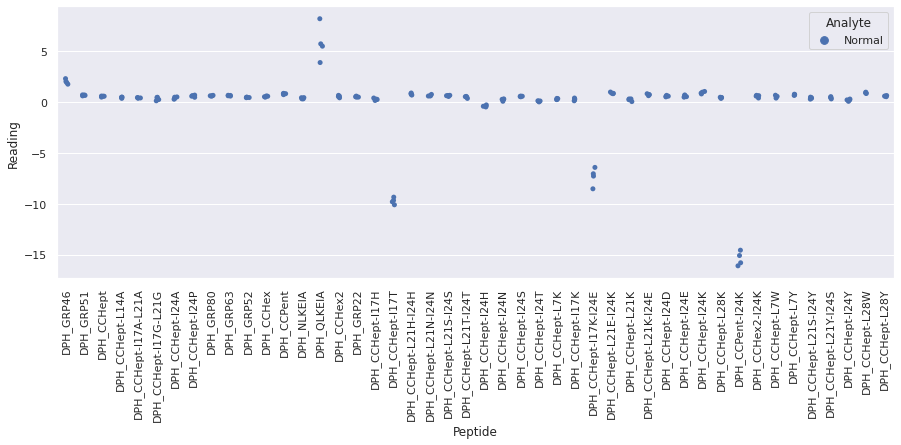

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysixR1_repeat_22.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysixR1_repeat_22.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtysixR1_repeat_22 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

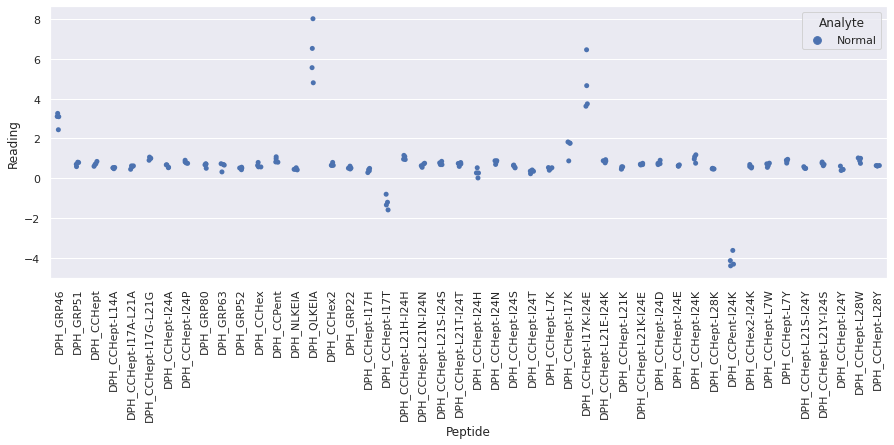

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysixR2_repeat_22.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysixR2_repeat_22.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtysixR2_repeat_22 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

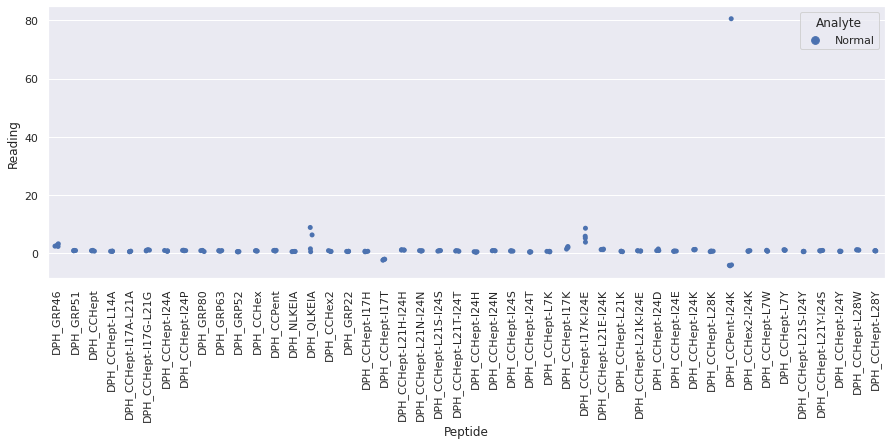

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysixR3_repeat_22.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysixR3_repeat_22.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysixR3_repeat_22.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data sprea

<Figure size 720x720 with 0 Axes>

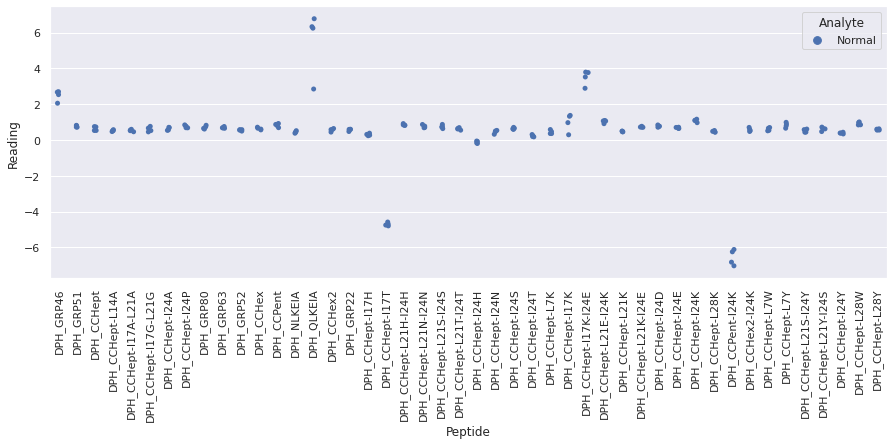

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysixR4_repeat_22.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysixR4_repeat_22.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtysixR4_repeat_22 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

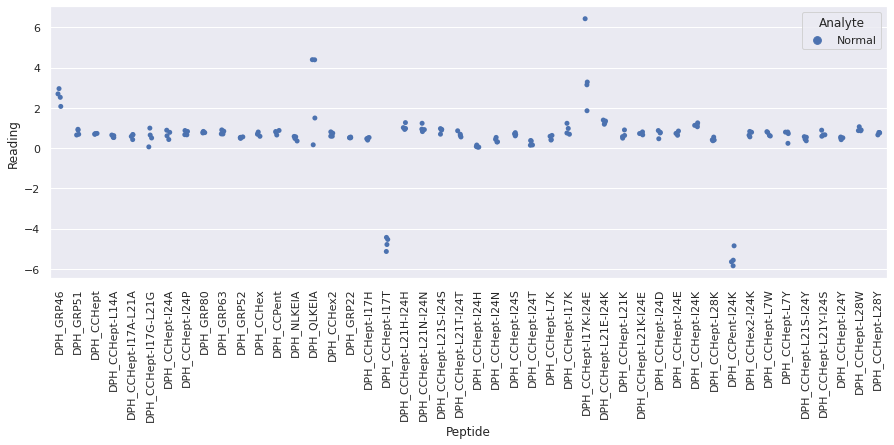

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR1_repeat_23.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR1_repeat_23.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtysevenR1_repeat_23 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

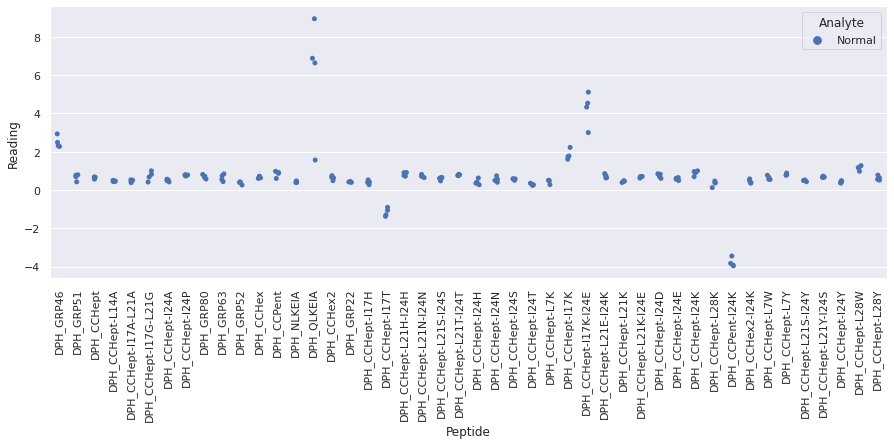

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR2_repeat_23.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR2_repeat_23.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR2_repeat_23.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data

<Figure size 720x720 with 0 Axes>

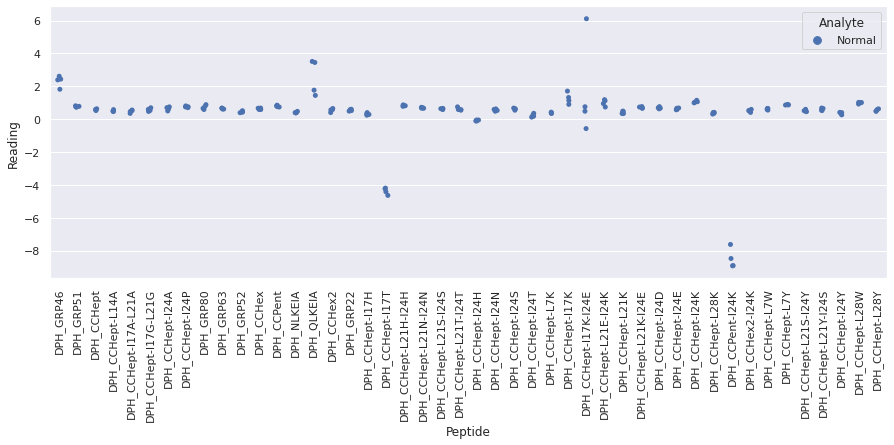

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR3_repeat_23.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR3_repeat_23.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR3_repeat_23.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data

<Figure size 720x720 with 0 Axes>

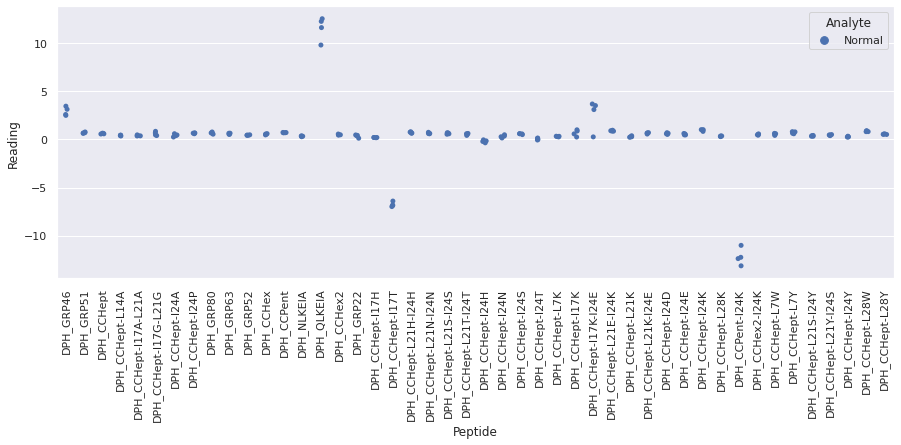

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR4_repeat_23.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR4_repeat_23.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-I24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtysevenR4_repeat_23.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluor

<Figure size 720x720 with 0 Axes>

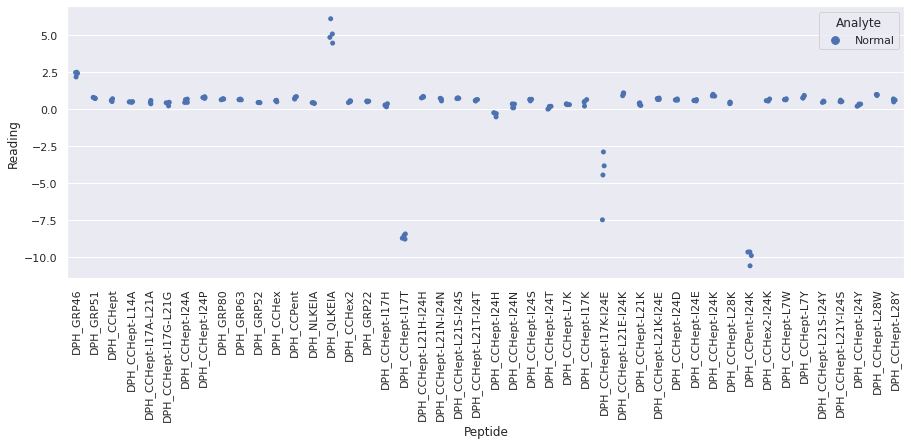

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR1_repeat_24.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR1_repeat_24.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR1_repeat_24.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data

<Figure size 720x720 with 0 Axes>

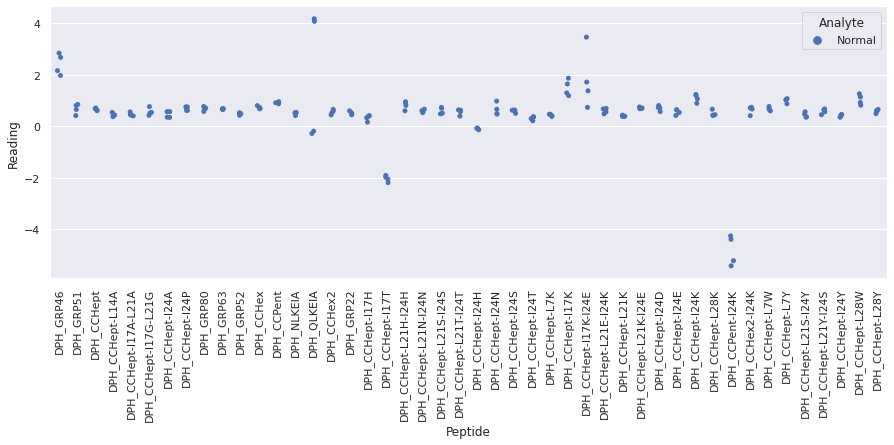

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR2_repeat_24.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR2_repeat_24.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyeightR2_repeat_24 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

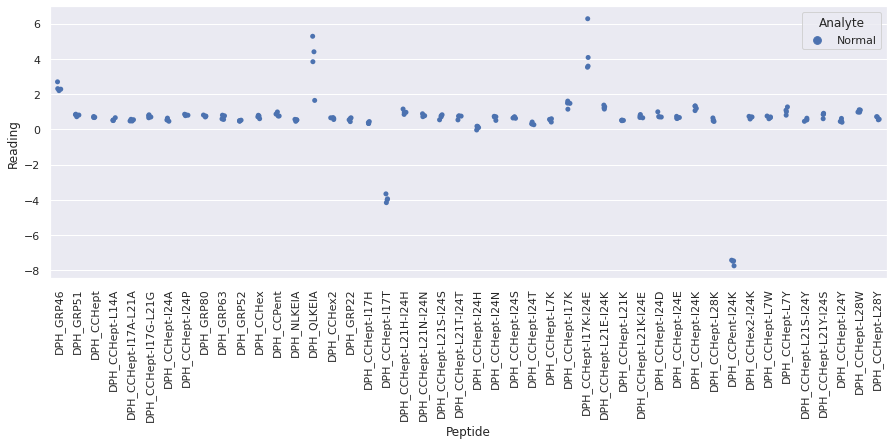

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR3_repeat_24.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR3_repeat_24.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR3_repeat_24.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data

<Figure size 720x720 with 0 Axes>

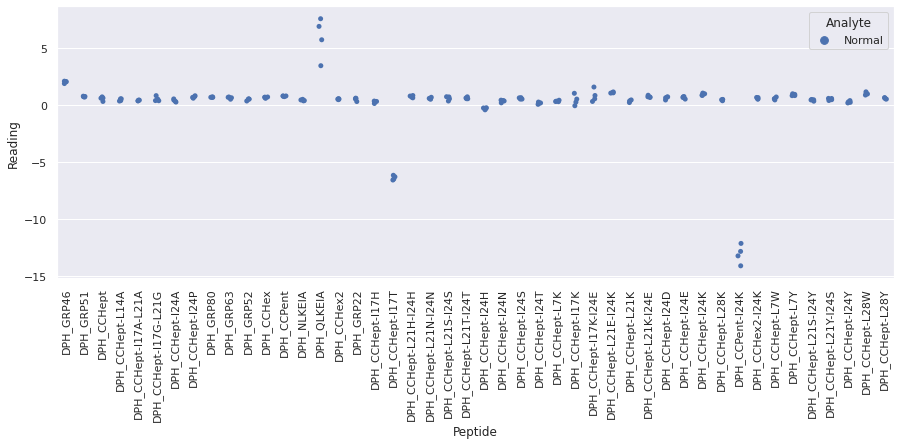

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR4_repeat_24.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR4_repeat_24.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-I24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtyeightR4_repeat_24.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluor

<Figure size 720x720 with 0 Axes>

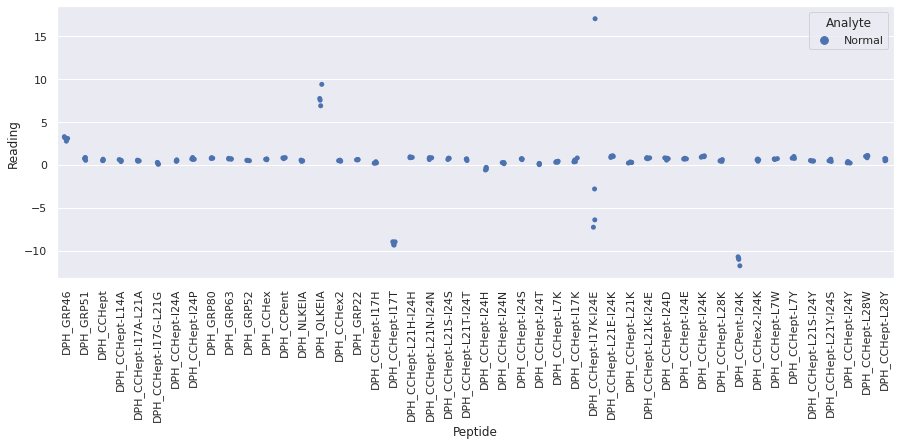

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR1_repeat_25.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR1_repeat_25.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR1_repeat_25.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data sp

<Figure size 720x720 with 0 Axes>

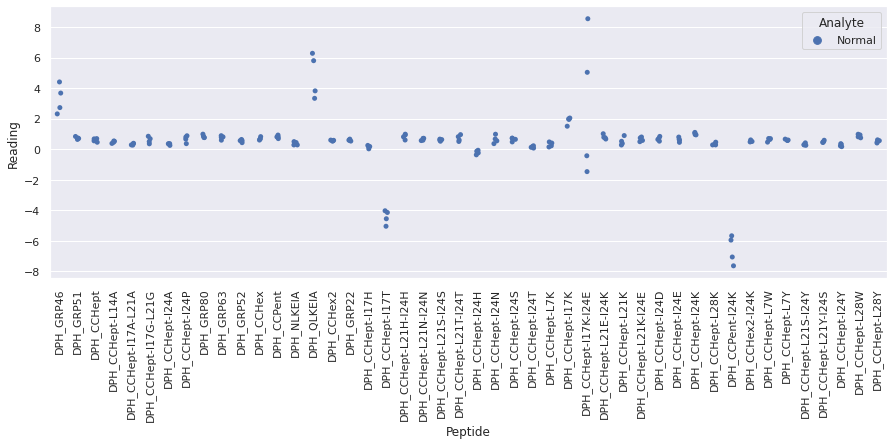

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR2_repeat_25.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR2_repeat_25.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-I24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR2_repeat_25.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluoresc

<Figure size 720x720 with 0 Axes>

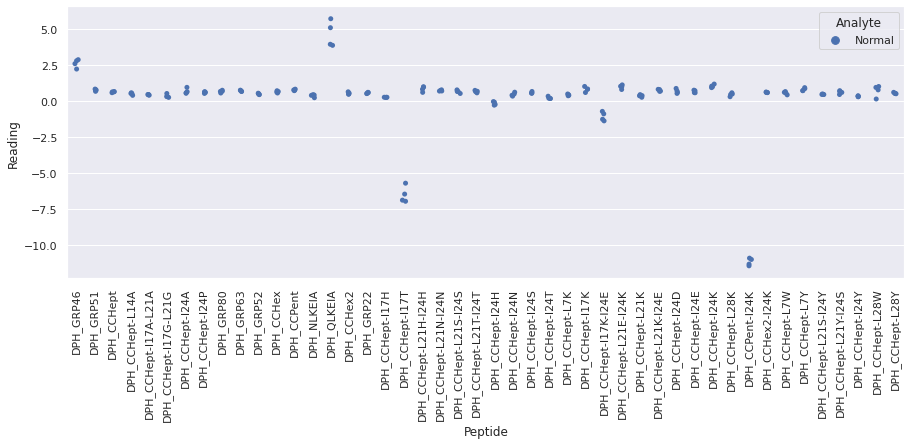

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR3_repeat_25.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR3_repeat_25.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-I24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR3_repeat_25.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluoresc

<Figure size 720x720 with 0 Axes>

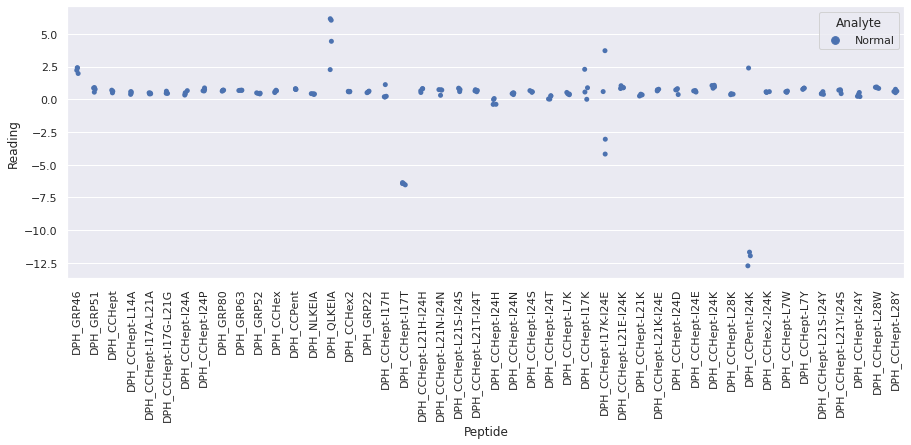

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR4_repeat_25.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR4_repeat_25.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-I24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_thirtynineR4_repeat_25.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluoresc

<Figure size 720x720 with 0 Axes>

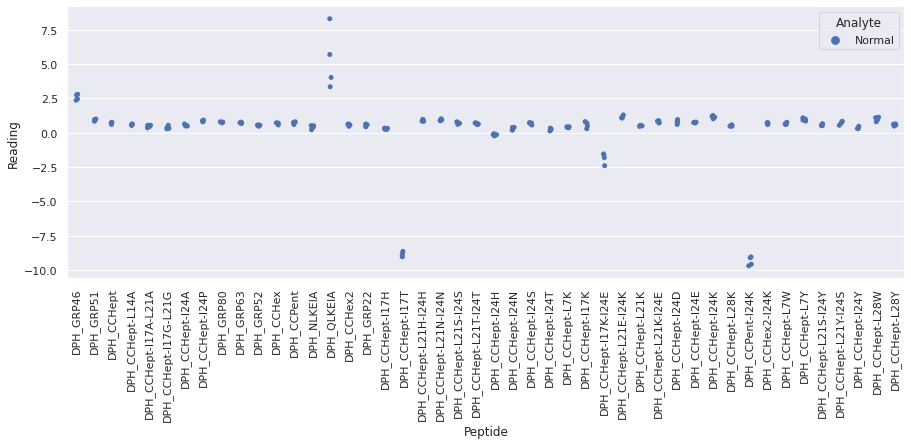

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR1_repeat_26.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR1_repeat_26.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR1_repeat_26.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal

<Figure size 720x720 with 0 Axes>

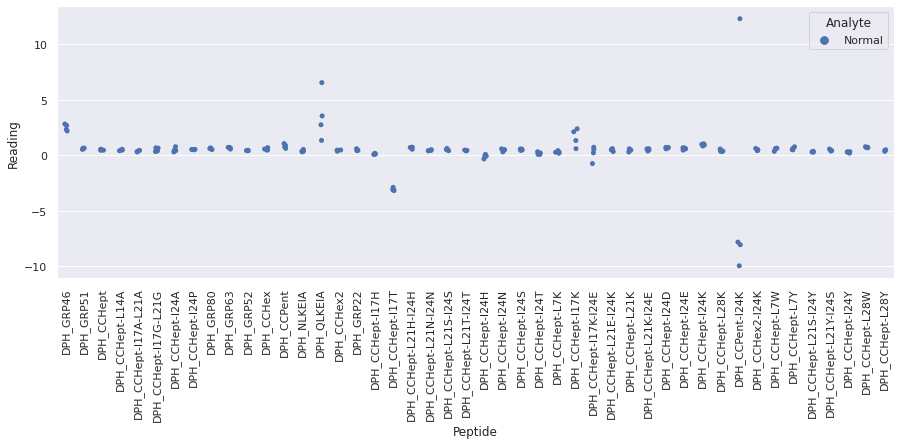

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR2_repeat_26.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR2_repeat_26.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-I24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR2_repeat_26.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal

<Figure size 720x720 with 0 Axes>

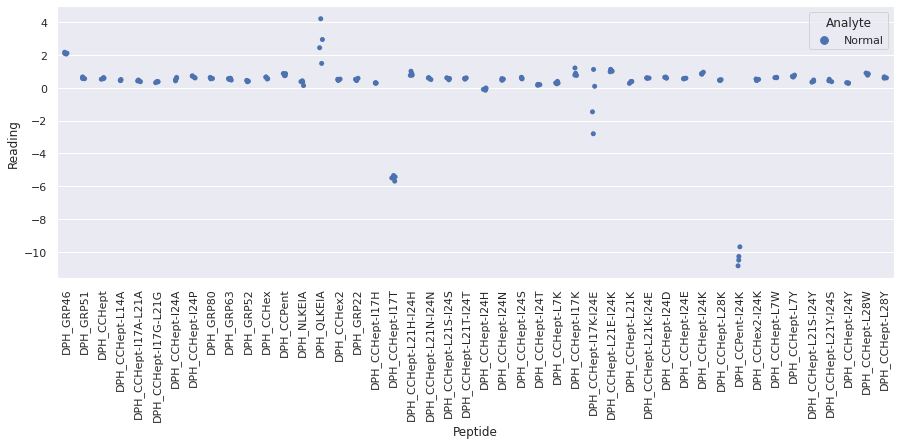

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR3_repeat_26.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR3_repeat_26.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR3_repeat_26.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal

<Figure size 720x720 with 0 Axes>

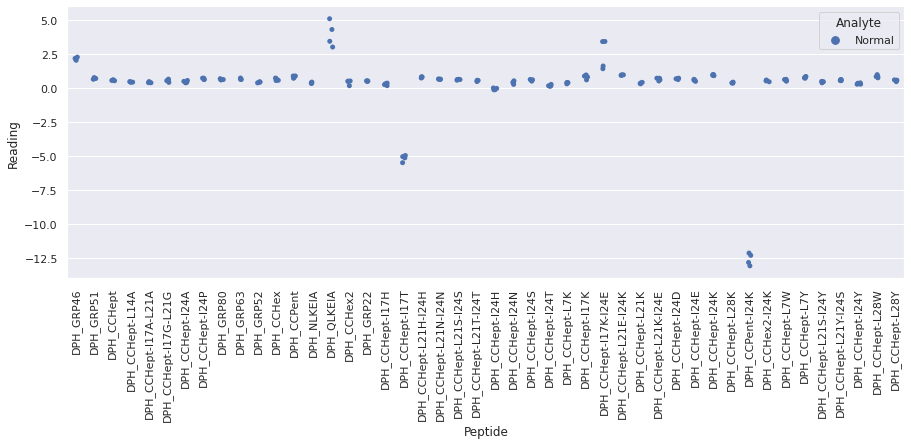

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR4_repeat_26.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR4_repeat_26.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-I24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyR4_repeat_26.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal

<Figure size 720x720 with 0 Axes>

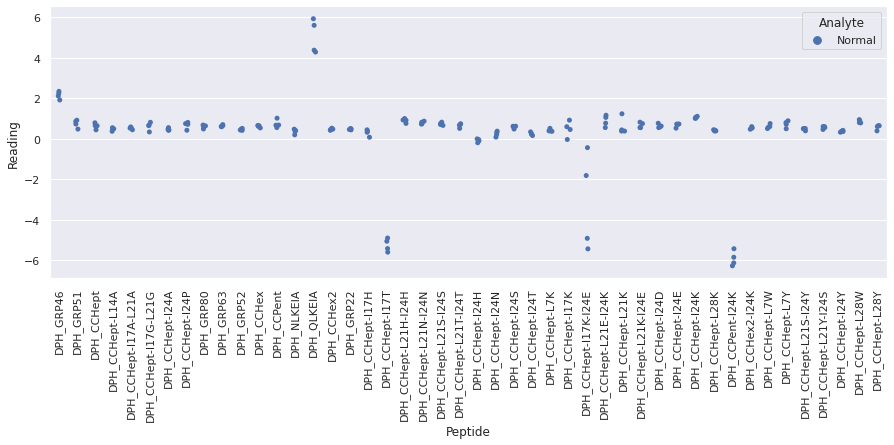

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR1_repeat_27.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR1_repeat_27.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR1_repeat_27.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread f

<Figure size 720x720 with 0 Axes>

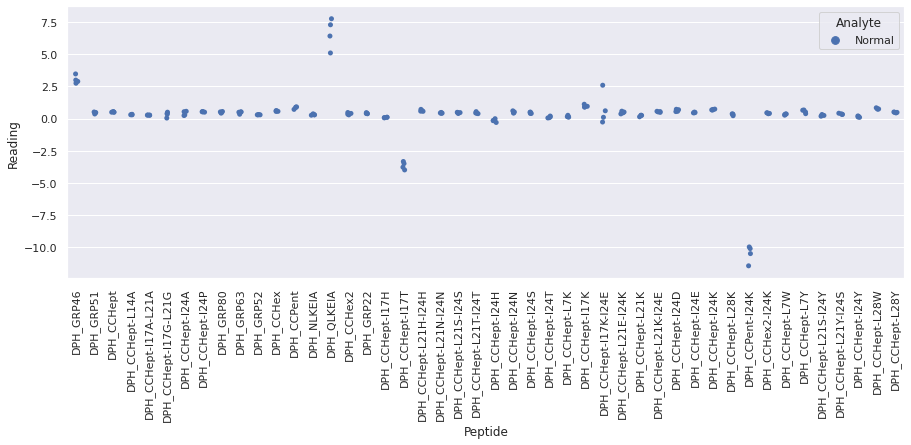

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR2_repeat_27.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR2_repeat_27.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR2_repeat_27.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread f

<Figure size 720x720 with 0 Axes>

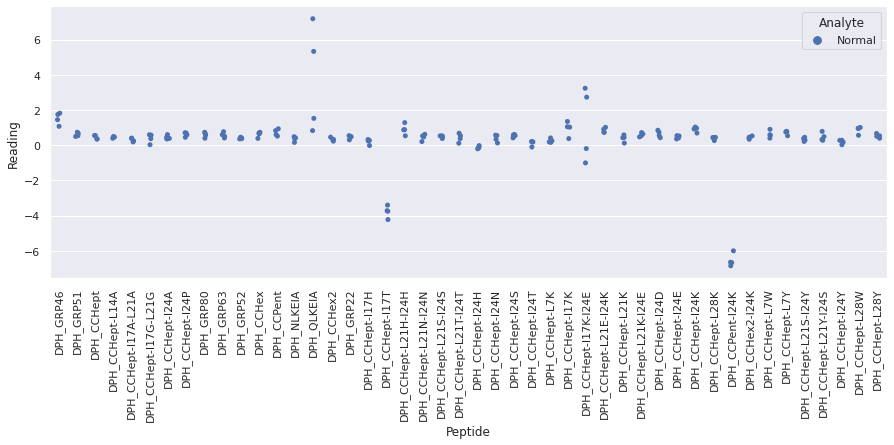

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR3_repeat_27.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR3_repeat_27.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-I24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR3_repeat_27.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence o

<Figure size 720x720 with 0 Axes>

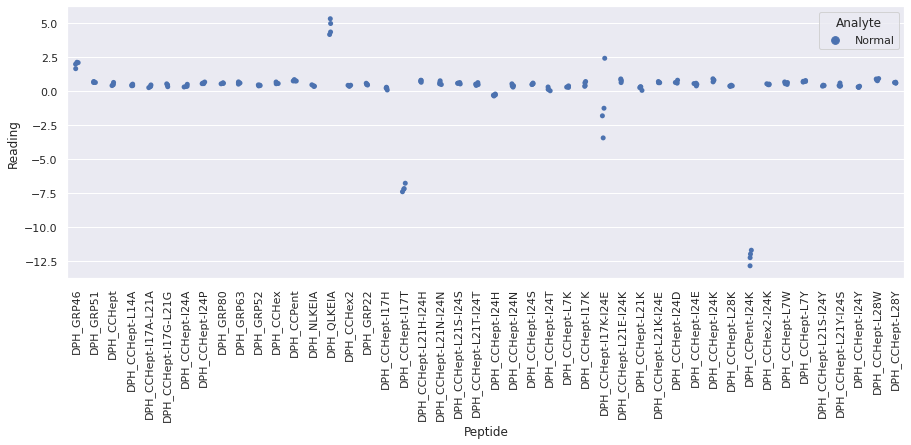

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR4_repeat_27.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR4_repeat_27.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortyoneR4_repeat_27.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (No

<Figure size 720x720 with 0 Axes>

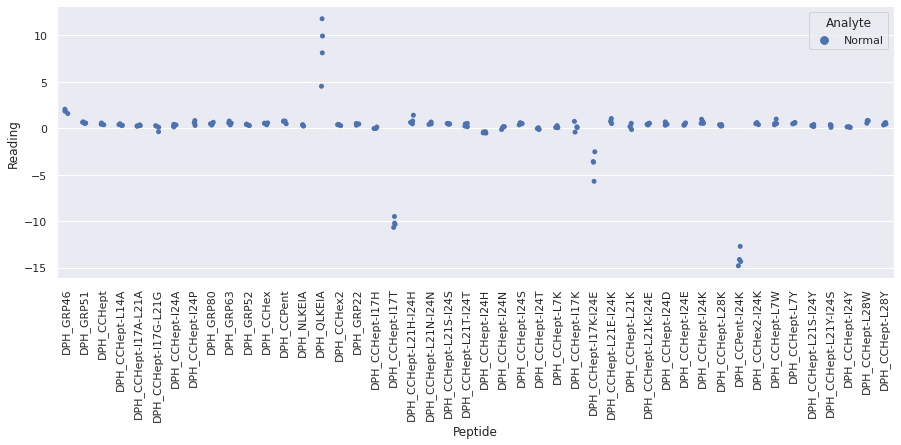

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR1_repeat_28.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR1_repeat_28.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fortytwoR1_repeat_28 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

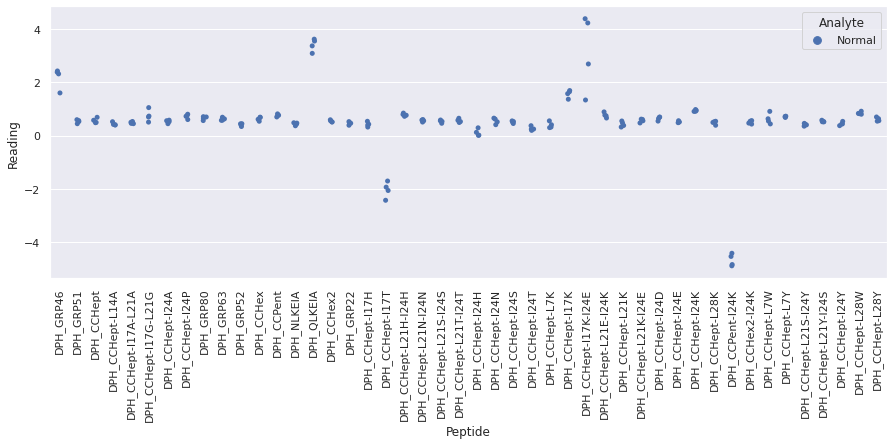

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR2_repeat_28.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR2_repeat_28.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR2_repeat_28.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread f

<Figure size 720x720 with 0 Axes>

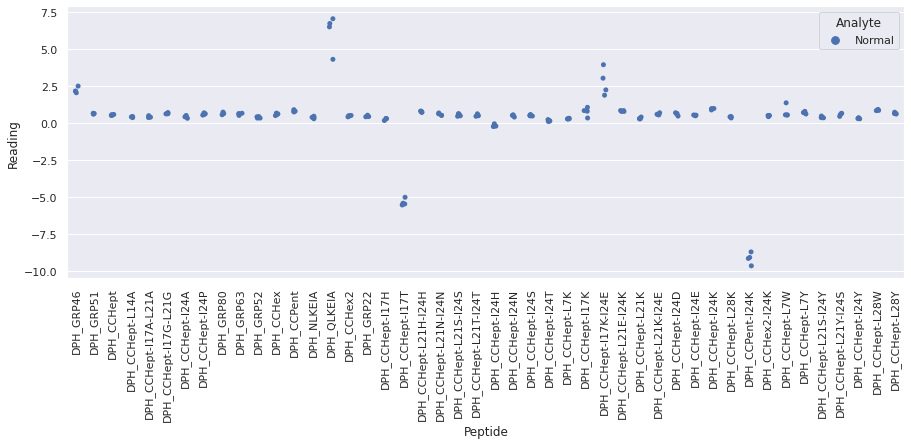

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR3_repeat_28.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR3_repeat_28.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR3_repeat_28.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread f

<Figure size 720x720 with 0 Axes>

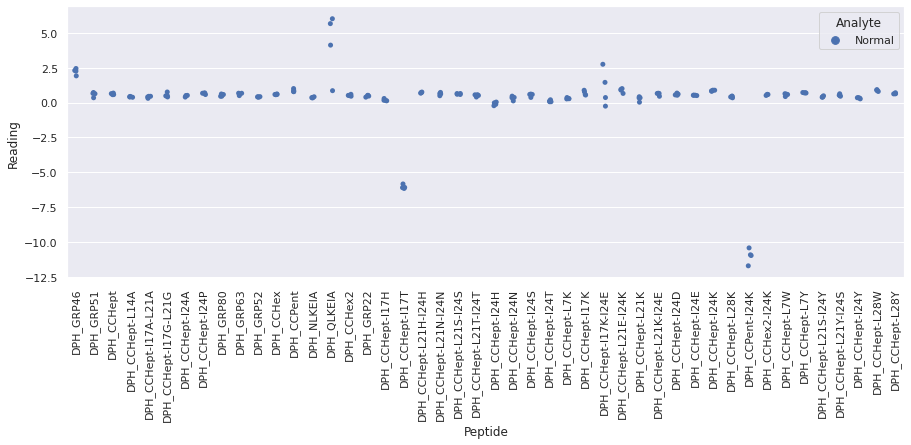

 WARNING - median fluorescence of (Normal + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR4_repeat_28.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR4_repeat_28.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal + DPH_CCHept-I17K-I24E + fluorophore) is less than fluorescence of (Normal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/Normal_fortytwoR4_repeat_28.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence o

<Figure size 720x720 with 0 Axes>

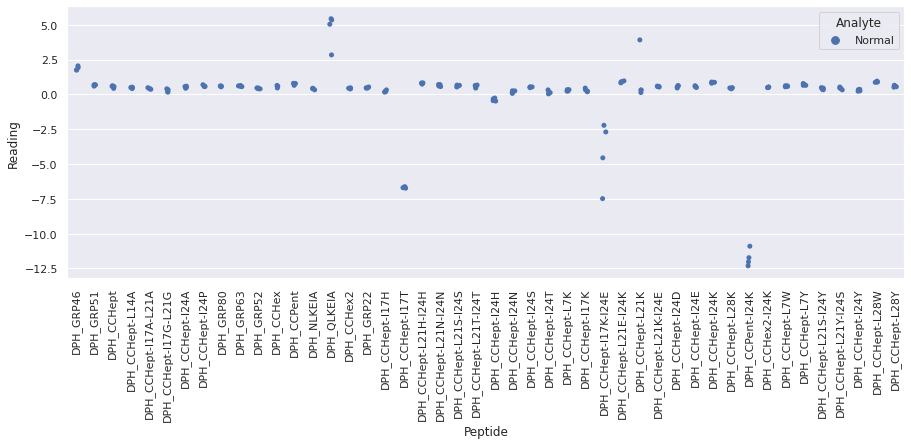



Outliers on the same plate:

/home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR1_repeat_1.xlsx: blank, DPH_CCHept-I24S, 28113.0
/home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR1_repeat_1.xlsx: blank, DPH_CCHept-I24D, 12646.0
/home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR1_repeat_1.xlsx: NASH, DPH_CCHept-L21N-I24N, 14523.0
/home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR1_repeat_1.xlsx: NASH, DPH_CCHept-I24S, 20834.0
/home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR1_repeat_1.xlsx: NASH, DPH_CCHept-L28W, 31364.0
/home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_illness/NASH_fifteenR2_repeat_1.xlsx: blank, DPH_CCHept-L21H-I24H, 15288.0
/home/ks17361/ML_environment/BAD

In [6]:
nash_fluor_data.xlsx_to_scaled_df(
    no_pep={'DPH': 'No Pep'}, scale_method='analyte_fluorophore', draw_plot=True, plot_dir_name='NASH'
)

At a glance:
- The serum samples are causing changes in fluorescence (e.g. compare to the sugar samples, where addition of analyte has little effect upon the fluorescence signal) - clearly there are components in the samples that are substantially affecting the interaction of DPH with the peptides.
- By eye there aren't any entire plates that are anomalous and hence should be discarded. There are individual outliers on several plates, however they will be discarded when the repeat readings are averaged by calculating the median.
- The serum samples themselves fluoresce at the same wavelength as DPH (excite at 350nm, measure at 450nm), hence the samples show pretty high background signal (compare the blue and orange dots for "DPH_No Pep" on the scatter plots for each plate). 
- There are several peptides that have little effect upon the fluorescence of DPH. Consequently, given the high background fluorescence of the analyte, the fluorescence of the sample with DPH and the peptide exceeds that of DPH and the peptide alone in these cases. The fact that the fluorescence increases in the presence of analyte is not on its own problematic, provided that the increase is consistent - however, the low fluorescence of the peptide and DPH alone means that these readings are more likely to contain larger amounts of noise (since the readings are scaled relative to the fluorescence of the peptide + DPH in order to enable fair comparison of readings measured on different plates). This is reflected in the above scatter plots - the ranges of readings obtained for peptides QLKEIA and CCHept-I17K-I24E in particular are unusually large even when only comparing samples on the same plate => think it is unlikely that the readings from these peptides will provide much signal about the sample class and instead will be predominantly noise. In contrast, although peptides CCHept-I17T and CCPent-I24K yield negative (scaled) readings as a result of the fact that in both cases the fluorescence of analyte + peptide + DPH is smaller than that of analyte + DPH alone, the (scaled) readings are fairly consistent. Hence they are likely to provide useful signal (and accordingly I am not concerned by the warnings that these samples cause the program to raise).

Combines readings of the same analyte solution across different plates, then calculates the median reading of non-independent repeats of the same analyte. Runs generalised ESD test, discards samples with two or more outlier readings (p=0.02 threshold).

(Using the default thresholds of p=0.05 and drop_thresh=2, I found a large number of samples were identified as "anomalous" (when in fact looking at the scatter plots above by eye they did not appear obviously unusual). Consequently I have reduced the p-value threshold to 0.02 for the NASH data. The original values of p=0.05 and drop_thresh=2 were determined on the small molecules data - that they appear to be too stringent for biological data likely reflects the greater variation present in biological samples.)

In [7]:
nash_fluor_data.combine_plate_readings(outlier_excl_thresh=0.02, drop_thresh=2)



Outliers across plates:

repeat_1_NASH: NASH, DPH_GRP22, 0.3197242435848334
repeat_1_NASH: NASH, DPH_CCHept-I24E, 0.1896060690072334
repeat_1_NASH: NASH, DPH_CCHept-L21Y-I24S, 1.0978998384491114
repeat_1_Normal: Normal, DPH_GRP51, 0.4820791779993956
repeat_1_Normal: Normal, DPH_CCHept-I24A, 0.8812353766963033
repeat_1_Normal: Normal, DPH_CCHept-I24D, 0.9066447007138935
repeat_2_NASH: NASH, DPH_CCHept-I24H, -0.15590797408979226
repeat_2_NASH: NASH, DPH_CCHept-I24S, 1.3188690717470613
repeat_2_NASH: NASH, DPH_CCHept-L21K-I24E, 0.8178418991851565
repeat_2_NASH: NASH, DPH_CCHept-L28K, 0.11148910993602781
repeat_2_NASH: NASH, DPH_CCHex2-I24K, 1.2451471990648169
repeat_2_Normal: Normal, DPH_CCHept-I24N, 2.306624667782262
repeat_2_Normal: Normal, DPH_CCHept-L21K-I24E, 1.3230985915492959
repeat_2_Normal: Normal, DPH_CCHex2-I24K, 0.21552611481887307
repeat_3_NASH: NASH, DPH_QLKEIA, 20.261111111111113
repeat_3_NASH: NASH, DPH_CCHept-I17K, 96.05651237890204
repeat_3_NASH: NASH, DPH_CCHept-L21K,

Display range of data points across repeats for the different analytes




Original_data:


NASH


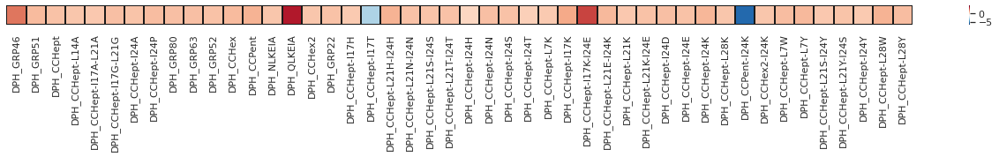


Normal


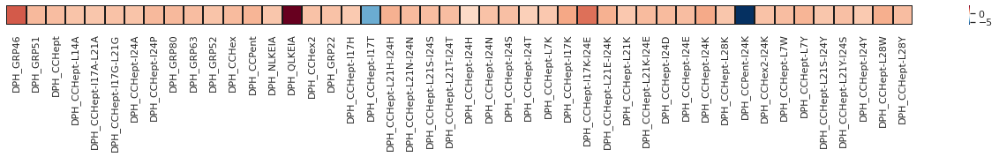




Scaled_data:


NASH


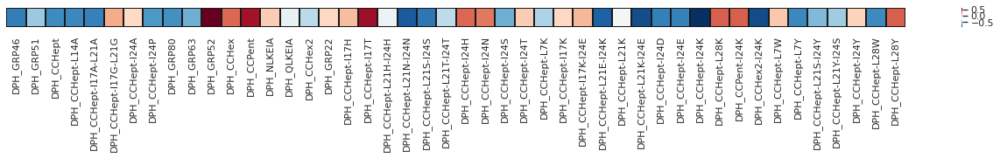


Normal


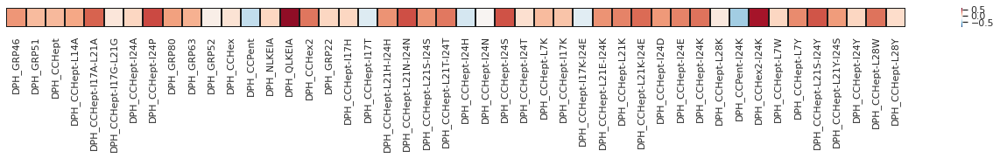




Original_data:



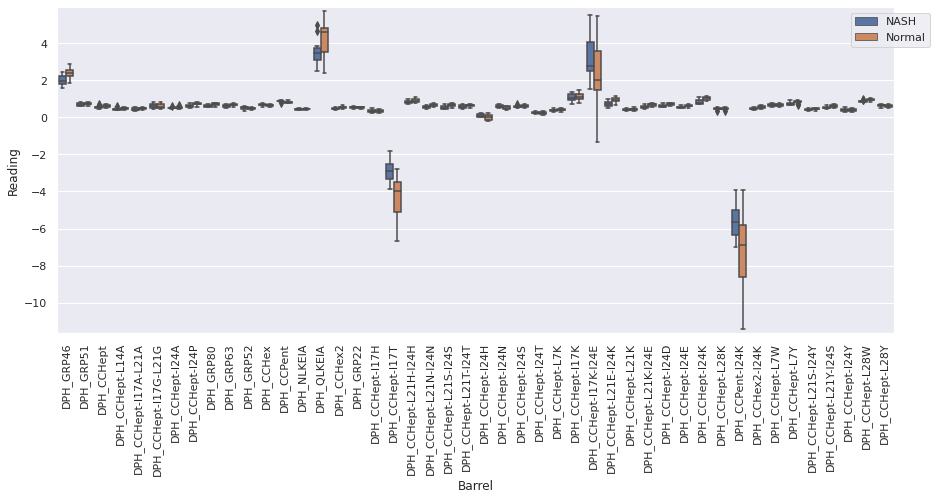

NASH


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 14.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 71.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 64.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 57.1% of the points cannot be placed; you may want 

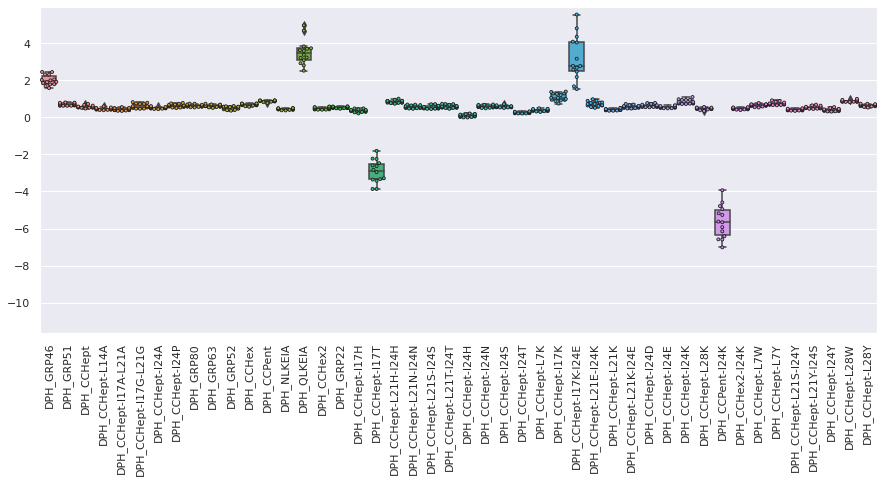

Normal


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 37.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 85.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 81.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 88.9% of the points cannot be placed; you may want 

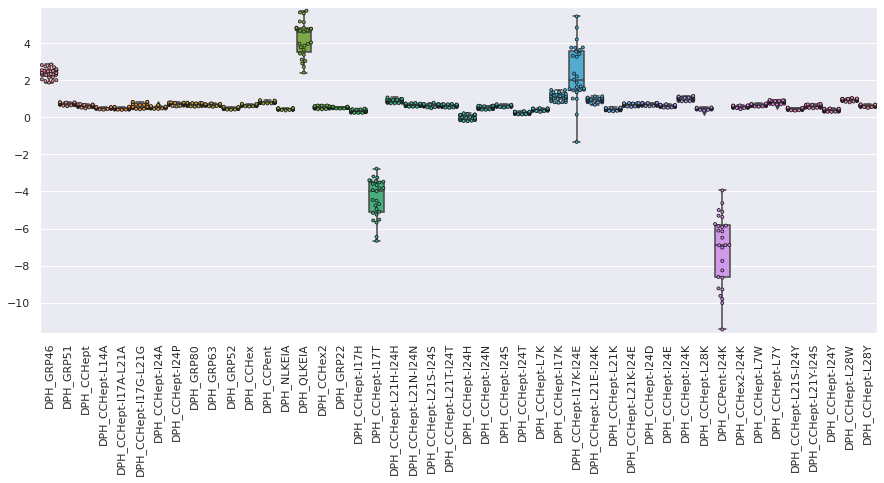




Scaled_data:



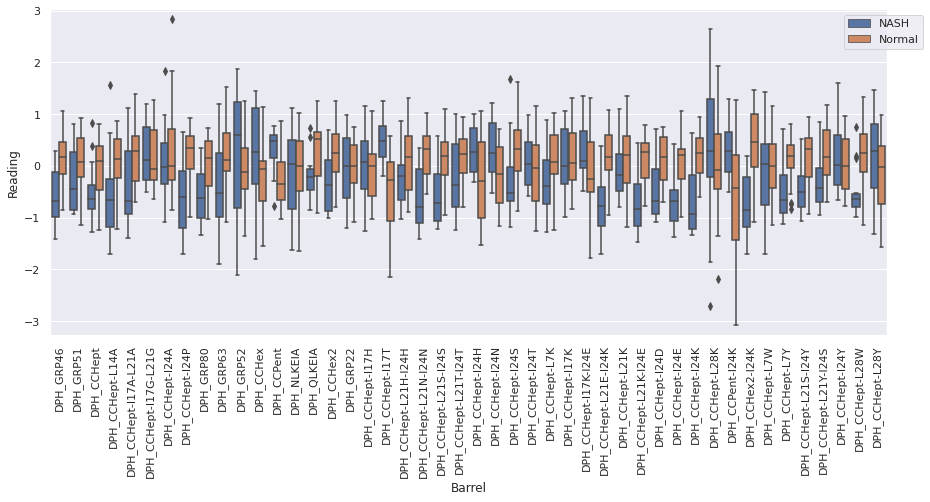

NASH


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 7.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


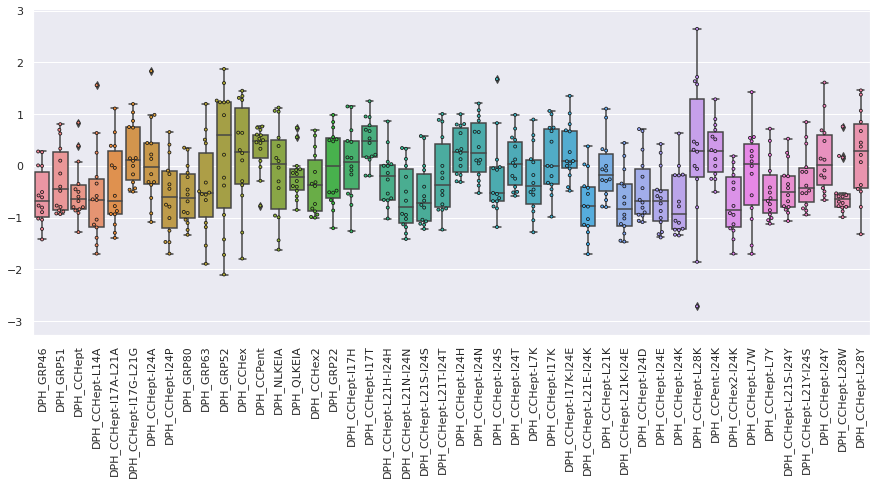

Normal


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 7.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 14.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


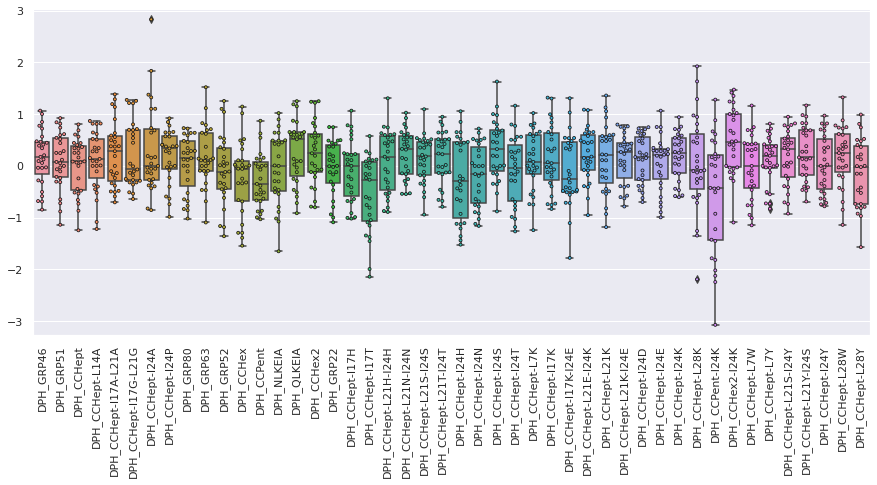

In [8]:
nash_fluor_data.display_data_distribution()

By eye, when looking at the scaled data box plots, there is not a noticeable difference between the degree of class overlap of the peptides that affect DPH fluorescence very little and hence give very high/low raw readings, as compared to the other peptides. Consequently, I will not be discarding any of the peptides prior to ML analysis. 

In [9]:
nash_fluor_data.ml_fluor_data

,DPH_GRP46,DPH_GRP51,DPH_CCHept,DPH_CCHept-L14A,DPH_CCHept-I17A-L21A,DPH_CCHept-I17G-L21G,DPH_CCHept-I24A,DPH_CCHept-I24P,DPH_GRP80,DPH_GRP63,...,DPH_CCPent-I24K,DPH_CCHex2-I24K,DPH_CCHept-L7W,DPH_CCHept-L7Y,DPH_CCHept-L21S-I24Y,DPH_CCHept-L21Y-I24S,DPH_CCHept-I24Y,DPH_CCHept-L28W,DPH_CCHept-L28Y,Analyte
0,2.314449,0.760177,0.639227,0.513311,0.497269,0.730011,0.532956,0.755124,0.685768,0.689077,...,-5.266176,0.548631,0.688652,0.888918,0.470898,0.636071,0.452029,0.947298,0.713608,NASH
1,2.319097,0.735667,0.588613,0.474973,0.497668,0.755371,0.515319,0.687043,0.675175,0.628442,...,-4.786618,0.507853,0.673276,0.803179,0.431204,0.564560,0.457549,0.874487,0.661201,NASH
2,2.002384,0.641768,0.549804,0.398499,0.350054,0.571053,0.445285,0.653174,0.588646,0.513700,...,-6.418259,0.457376,0.587875,0.690981,0.397401,0.510429,0.374312,0.828162,0.533316,NASH
3,2.021183,0.809764,0.531350,0.483218,0.388345,0.478990,0.489645,0.663489,0.702361,0.683861,...,-6.151534,0.460034,0.702990,0.741344,0.416450,0.529512,0.396454,0.848308,0.683924,NASH
4,1.781390,0.627215,0.528502,0.388065,0.400938,0.473491,0.454838,0.611955,0.616748,0.571542,...,-5.625567,0.497819,0.536381,0.708201,0.372167,0.466195,0.312608,0.839526,0.599377,NASH
5,1.585418,0.634571,0.576498,0.455405,0.466261,0.727885,0.612822,0.530511,0.564487,0.539384,...,-3.931559,0.396985,0.709339,0.668686,0.409703,0.576318,0.508278,0.846883,0.737105,NASH
6,2.457072,0.790687,0.674912,0.537694,0.519310,0.790123,0.564198,0.737019,0.741654,0.703336,...,-6.582707,0.539367,0.708078,0.923430,0.464491,0.690613,0.435386,0.944134,0.697345,NASH
7,1.855660,0.682924,0.535942,0.459617,0.387805,0.603266,0.498335,0.503557,0.572372,0.614266,...,-4.592120,0.432889,0.680746,0.717448,0.386736,0.471803,0.398813,0.849604,0.638520,NASH
8,1.792081,0.644437,0.523068,0.430261,0.371423,0.536168,0.486531,0.530008,0.536040,0.603667,...,-5.927344,0.436396,0.548655,0.652723,0.378105,0.510326,0.321574,0.858253,0.573156,NASH
9,2.054854,0.674442,0.570716,0.454658,0.462288,0.503780,0.489558,0.695182,0.644948,0.612116,...,-6.591890,0.519613,0.604190,0.755787,0.430225,0.564309,0.359416,0.868678,0.605141,NASH


#### ML analysis

 *2 classes (Normal and NASH)*

In [10]:
plt.rcParams['figure.figsize'] = (10, 10)  # Sets default figure size
ml_2_classes = RunML(
    results_dir='/home/ks17361/ML_environment/BADASS/NASH_serum_analysis/NASH_2_classes_split_illness/'
                'NASH_ML_plots',
    fluor_data=nash_fluor_data.ml_fluor_data.drop(['Analyte'], axis=1),
    classes=nash_fluor_data.ml_fluor_data['Analyte'].tolist(), subclasses=None, shuffle=False
)

- Calculate feature correlations

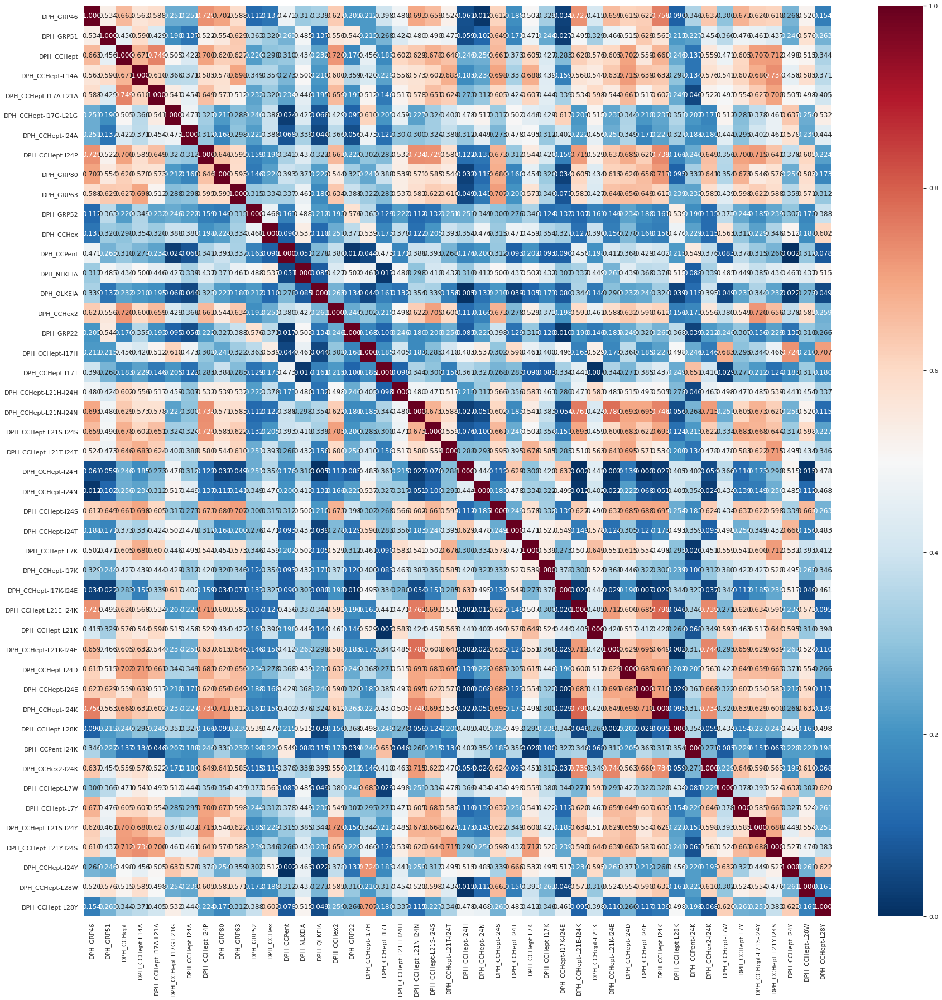

In [11]:
plt.rcParams['figure.figsize'] = (30, 30)
kendall_tau_correlation_matrix = ml_2_classes.calc_feature_correlations(
    fluor_data=ml_2_classes.fluor_data, correlation_coeff='kendall', plt_name='', abs_vals=True
)
plt.rcParams['figure.figsize'] = (10, 10)  # Resets default figure size

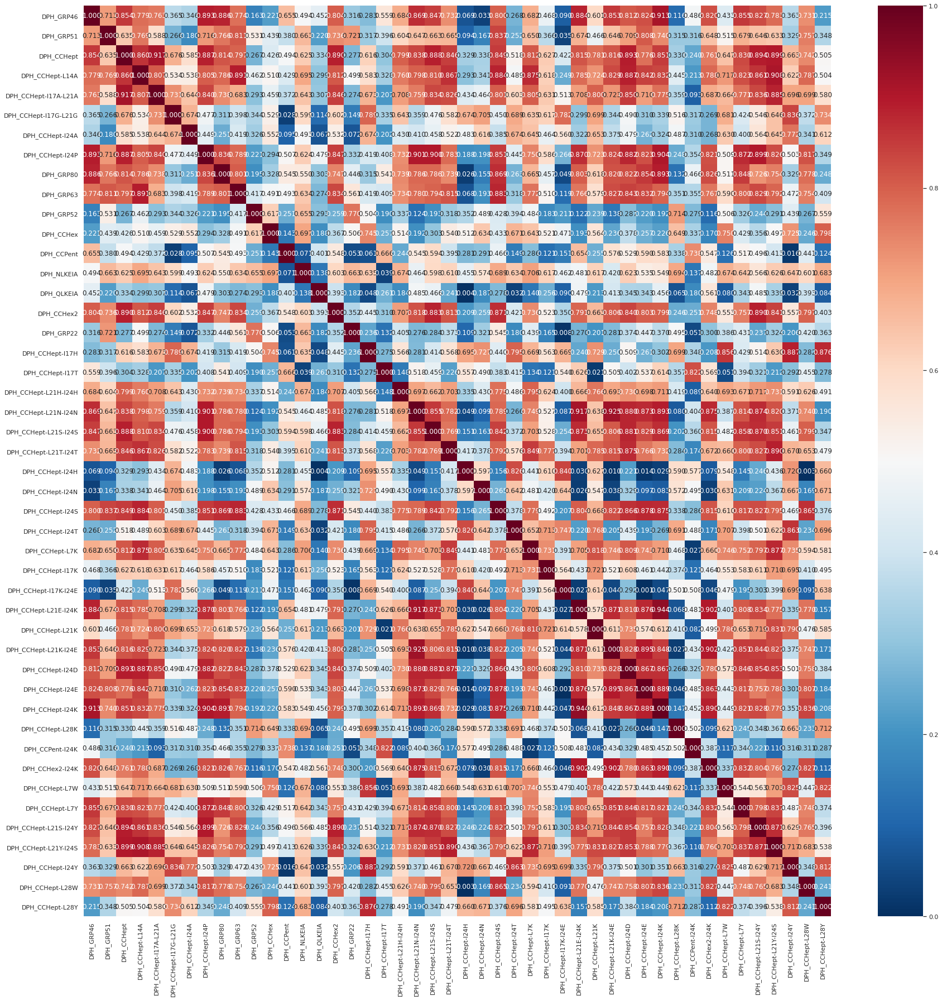

In [12]:
plt.rcParams['figure.figsize'] = (30, 30)
spearman_correlation_matrix = ml_2_classes.calc_feature_correlations(
    fluor_data=ml_2_classes.fluor_data, correlation_coeff='spearman', plt_name='', abs_vals=True
)
plt.rcParams['figure.figsize'] = (10, 10)  # Resets default figure size

So, there is quite a wide range of correlation coefficients across the readings of the different barrels. That some of the barrel pairs show high correlation coefficients is encouraging, as it indicates that at least some of the barrels are likely picking up signal in the data as opposed to just noise. However, the barrels with low correlation coefficients are not necessarily picking up noise - they may instead be picking up different information from one another. The following analysis will help to identify which barrels fall into which of these categories!

- Measure the relative importances of the peptides with KBest using one-way ANOVA

<Figure size 720x720 with 0 Axes>

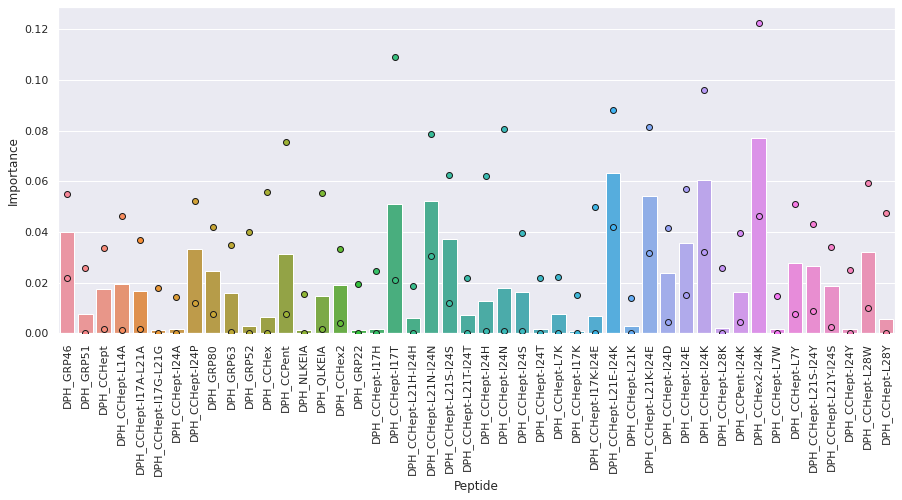

<Figure size 720x720 with 0 Axes>

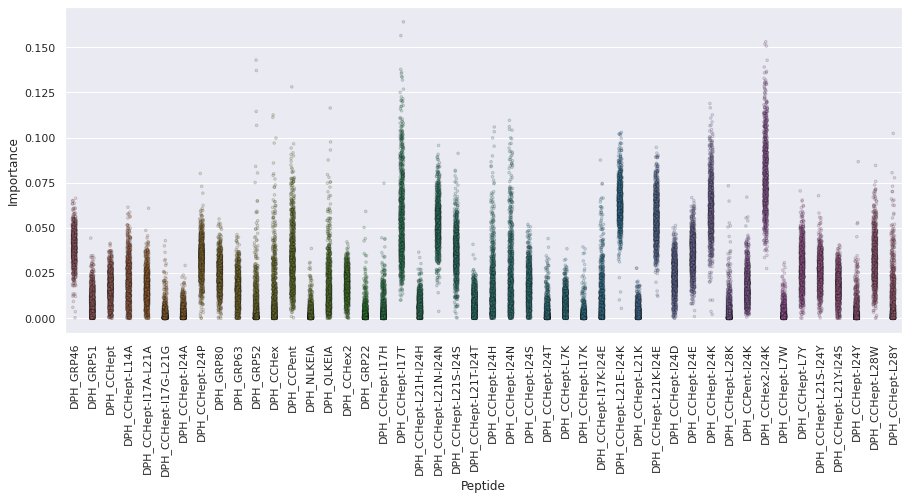

In [13]:
kbest_feat_importances_df, kbest_feat_importances_dict = ml_2_classes.calc_feature_importances_kbest(
    x=ml_2_classes.x, y=ml_2_classes.y, features=None, method_classif='f_classif', num_repeats=1000,
    scale=True, plt_name=''
)

In [14]:
print('Peptides ordered by F-score:')
kbest_feat_importances_df

Peptides ordered by F-score:


,Feature,Score,Lower conf limit,Upper conf limit
0,DPH_CCHex2-I24K,0.077209,0.046131,0.122654
1,DPH_CCHept-L21E-I24K,0.063196,0.042071,0.088290
2,DPH_CCHept-I24K,0.060309,0.032113,0.095874
3,DPH_CCHept-L21K-I24E,0.054291,0.031779,0.081442
4,DPH_CCHept-L21N-I24N,0.052063,0.030471,0.078800
5,DPH_CCHept-I17T,0.051016,0.021150,0.108898
6,DPH_GRP46,0.039875,0.021715,0.055054
7,DPH_CCHept-L21S-I24S,0.037016,0.012049,0.062422
8,DPH_CCHept-I24E,0.035681,0.015029,0.056786
9,DPH_CCHept-I24P,0.033303,0.011949,0.052123


In [15]:
with open('{}/KBest_feat_importances.pkl'.format(ml_2_classes.results_dir), 'wb') as f:
    pickle.dump((kbest_feat_importances_dict), f)

KBest analysis is a univariate feature selection method, and hence assumes that the features are independent of one another (the importance scores calculated here are the F-scores from running one-way ANOVA). Consequently, the output importance scores do not reflect correlations between features - the scores represent the information provided by a feature about the output class, rather than the unique information provided by that feature alone. Therefore the most important features highlighted by this method could be providing the same information as one another.

Unsurprisingly, there is an approximate (negative) correlation between the degree of overlap of the readings for the two classes in the box plots above and the importance scores in this analysis (the peptides with the largest importance scores via KBest analysis being CCHex2-I24K, CCHept-L21E-I24K and CCHept-I24K), and vice versa.

- Measure the relative importances of the peptides with decision tree analysis

<Figure size 720x720 with 0 Axes>

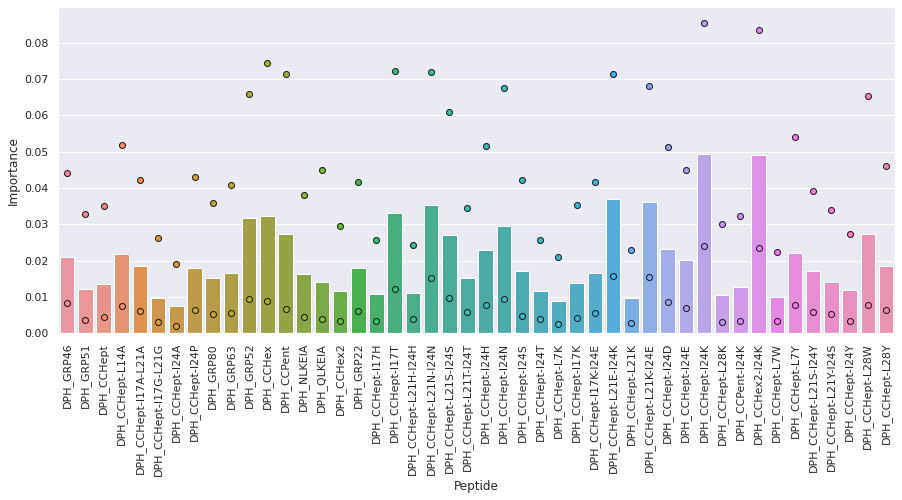

<Figure size 720x720 with 0 Axes>

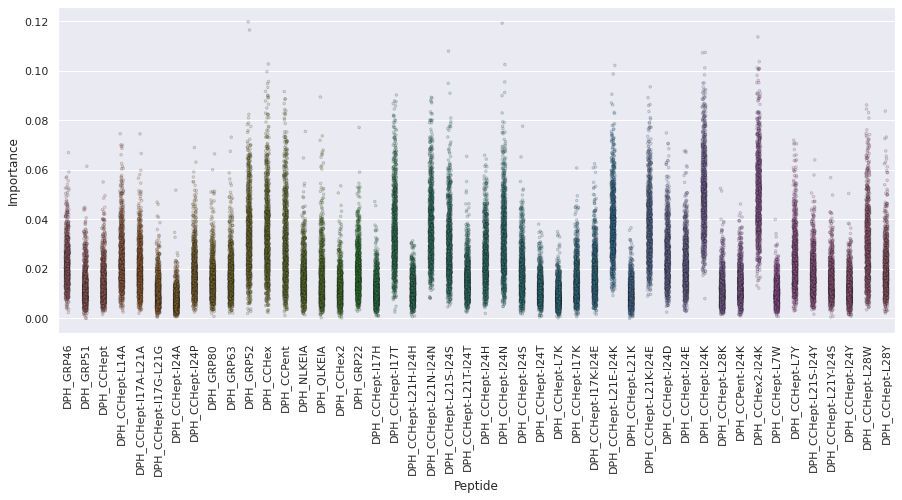

In [16]:
tree_feat_importances_df, tree_feat_importances_dict = ml_2_classes.calc_feature_importances_tree(
    x=ml_2_classes.x, y=ml_2_classes.y, features=None, num_repeats=1000, scale=True, plt_name=''
)

In [17]:
print('Peptides ordered by importance:')
tree_feat_importances_df

Peptides ordered by importance:


,Feature,Score,Lower conf limit,Upper conf limit
0,DPH_CCHept-I24K,0.049474,0.023902,0.085548
1,DPH_CCHex2-I24K,0.049159,0.023491,0.083365
2,DPH_CCHept-L21E-I24K,0.037015,0.015713,0.071418
3,DPH_CCHept-L21K-I24E,0.036014,0.015398,0.068157
4,DPH_CCHept-L21N-I24N,0.035173,0.015278,0.071886
5,DPH_CCHept-I17T,0.032987,0.012052,0.072311
6,DPH_CCHex,0.032171,0.008759,0.074455
7,DPH_GRP52,0.031645,0.009431,0.065945
8,DPH_CCHept-I24N,0.029393,0.009279,0.067409
9,DPH_CCPent,0.027301,0.006743,0.071302


In [18]:
with open('{}/Tree_feat_importances.pkl'.format(ml_2_classes.results_dir), 'wb') as f:
    pickle.dump((tree_feat_importances_dict), f)

In this method, an ExtraTrees classifier is used to calculate importance scores. The ExtraTrees classifier trains multiple decision trees on the data. Each tree is trained with a random subset of features on a random subset of dataset, the results of these trees are then averaged to make a prediction. Importance scores are calculated as the 
average increase in purity achieved when using a particular feature to split the data across all trees in which that feature is included (i.e. the Gini importance score of the feature). When looking at the Gini importance scores of features in individual trees, correlations between the included features are reflected in the scores. However, as more and more trees, incorporating different subsets of features, are included in the average, feature correlations have less of an effect upon the importance scores. The  number of trees (plus bootstrap repeats) included here means that the correlation between features will have little effect upon the importance scores.

Whilst there are some small differences, the relative order of the peptides identified by this method is very similar to that measured by KBest analysis. The most important peptides identified by this method are essentially the same as those identified by the KBest analysis above (with some small differences in their relative order). The less important peptides are also broadly similar, but unsurprisingly there are more differences in their relative ordering (as the absolute differences between their importance scores are smaller => can lead to more extensive reordering). Consequently, again there is a visible (negative) correlation between the degree of overlap between a peptide's class readings that can be seen in the box plots above and that peptide's importance score.

- Measure the relative importances of the peptides with permutation analysis

<Figure size 720x720 with 0 Axes>

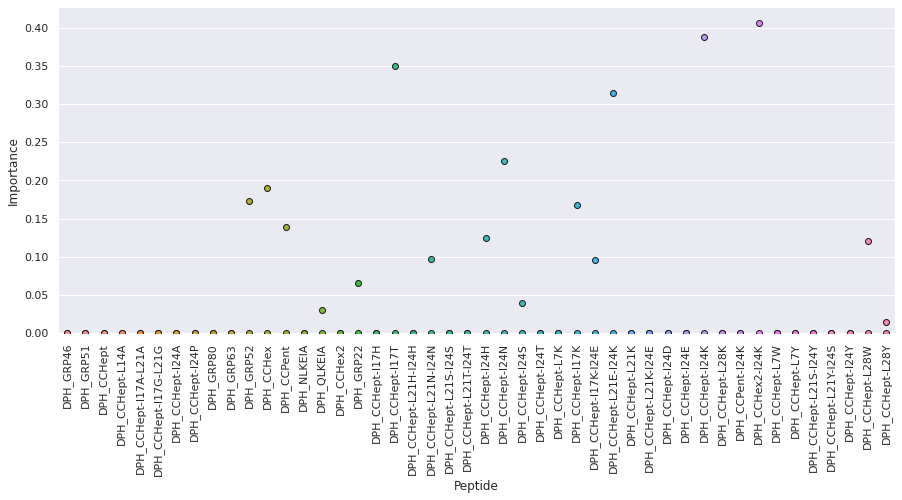

<Figure size 720x720 with 0 Axes>

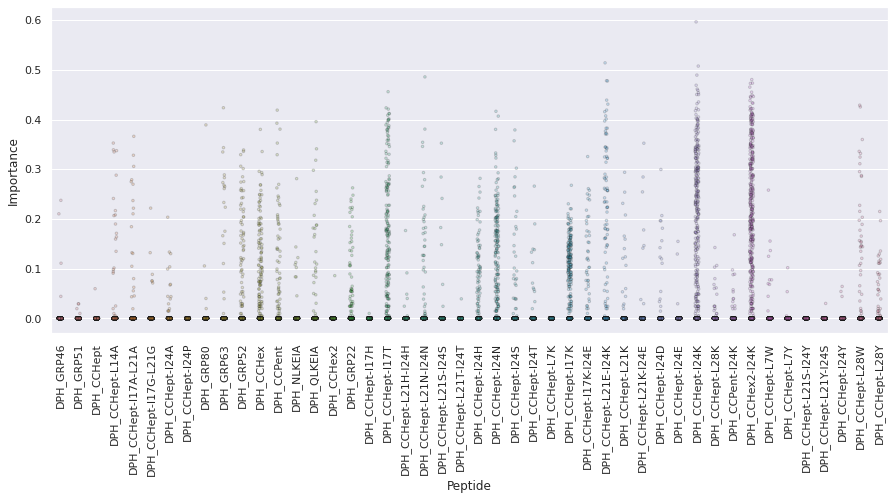

In [19]:
f1 = make_scorer(f1_score, average='weighted')
(
    median_permut_feat_importances_df, permut_feat_importances_dict
) = ml_2_classes.calc_feature_importances_permutation(
    x=ml_2_classes.x, y=ml_2_classes.y, features=None, classifier=AdaBoostClassifier,
    parameters={'n_estimators': np.array([10, 30, 100, 300, 1000])}, model_metric=f1, num_repeats=1000,
    scale=True, plt_name=''
)

In [20]:
print('Peptides ordered by median importance:')
median_permut_feat_importances_df

Peptides ordered by median importance:


,Feature,Score,Lower conf limit,Upper conf limit
0,DPH_GRP46,0.0,0.0,0.000000
1,DPH_CCHept-I24E,0.0,0.0,0.000000
2,DPH_CCHept-I24S,0.0,0.0,0.039060
3,DPH_CCHept-I24T,0.0,0.0,0.000000
4,DPH_CCHept-L7K,0.0,0.0,0.000000
5,DPH_CCHept-I17K,0.0,0.0,0.167520
6,DPH_CCHept-I17K-I24E,0.0,0.0,0.095908
7,DPH_CCHept-L21E-I24K,0.0,0.0,0.314373
8,DPH_CCHept-L21K,0.0,0.0,0.000000
9,DPH_CCHept-L21K-I24E,0.0,0.0,0.000000


In [21]:
mean_permut_feat_importances_df = OrderedDict({})
lower_conf_permut_feat_importances_df = OrderedDict({})
upper_conf_permut_feat_importances_df = OrderedDict({})

for feat, score_list in permut_feat_importances_dict.items():
    mean_permut_feat_importances_df[feat] = np.mean(score_list)
    lower_conf_permut_feat_importances_df[feat] = np.percentile(score_list, 2.5)
    upper_conf_permut_feat_importances_df[feat] = np.percentile(score_list, 97.5)

mean_permut_feat_importances_df = pd.DataFrame({
    'Feature': list(mean_permut_feat_importances_df.keys()),
    'Score': list(mean_permut_feat_importances_df.values()),
    'Lower conf limit': list(lower_conf_permut_feat_importances_df.values()),
    'Upper conf limit': list(upper_conf_permut_feat_importances_df.values())
})
mean_permut_feat_importances_df = mean_permut_feat_importances_df.sort_values(
    by=['Score'], axis=0, ascending=False
).reset_index(drop=True)

In [22]:
print('Peptides ordered by mean importance:')
mean_permut_feat_importances_df

Peptides ordered by mean importance:


,Feature,Score,Lower conf limit,Upper conf limit
0,DPH_CCHex2-I24K,0.082707,0.0,0.406806
1,DPH_CCHept-I24K,0.063410,0.0,0.388018
2,DPH_CCHept-I17T,0.031680,0.0,0.350337
3,DPH_CCHept-I24N,0.022640,0.0,0.225840
4,DPH_CCHept-I17K,0.020598,0.0,0.167520
5,DPH_CCHept-L21E-I24K,0.018135,0.0,0.314373
6,DPH_CCHex,0.013664,0.0,0.190089
7,DPH_GRP52,0.009708,0.0,0.172846
8,DPH_CCPent,0.007820,0.0,0.139110
9,DPH_CCHept-I24H,0.007606,0.0,0.125226


In [23]:
with open('{}/Permutation_feat_importances.pkl'.format(ml_2_classes.results_dir), 'wb') as f:
    pickle.dump((permut_feat_importances_dict), f)

In permutation analysis, importance scores are calculated by training two ML models (in this case I have selected AdaBoost classifiers). The first model is trained using all features, the second is trained with one of the features randomly scrambled: the importance score of the feature is then calculated as the difference in performance (in this case measured via model F1 score) between the two models. Hence this method does take into account correlations between features, and the output importance scores represent the unique information that a feature provides about the output class label.

The results obtained with permutation look more different as compared to the difference between the KBest and ExtraTrees analysis, which is perhaps not surprising given that as described above permutation analysis takes feature correlation into account (whereas the former two methods do not).

Interestingly, none of the peptides has an especially high importance score (the median value for every peptide is 0), thus indicating that none of the peptides provides much unique information about the output class that is not captured by one or more of the other barrels. Looking at the mean importance scores, there is good agreement of the barrels ranked as most important as compared to the KBest and ExtraTrees analysis above, with CCHex2-I24K and CCHept-I24K again being identified as two of the most important barrels, whilst there is unsurprisingly greater disagreement between the relative order of the peptides measured as being less important.

- What percentage of the signal in the data can be measured by N principal components?

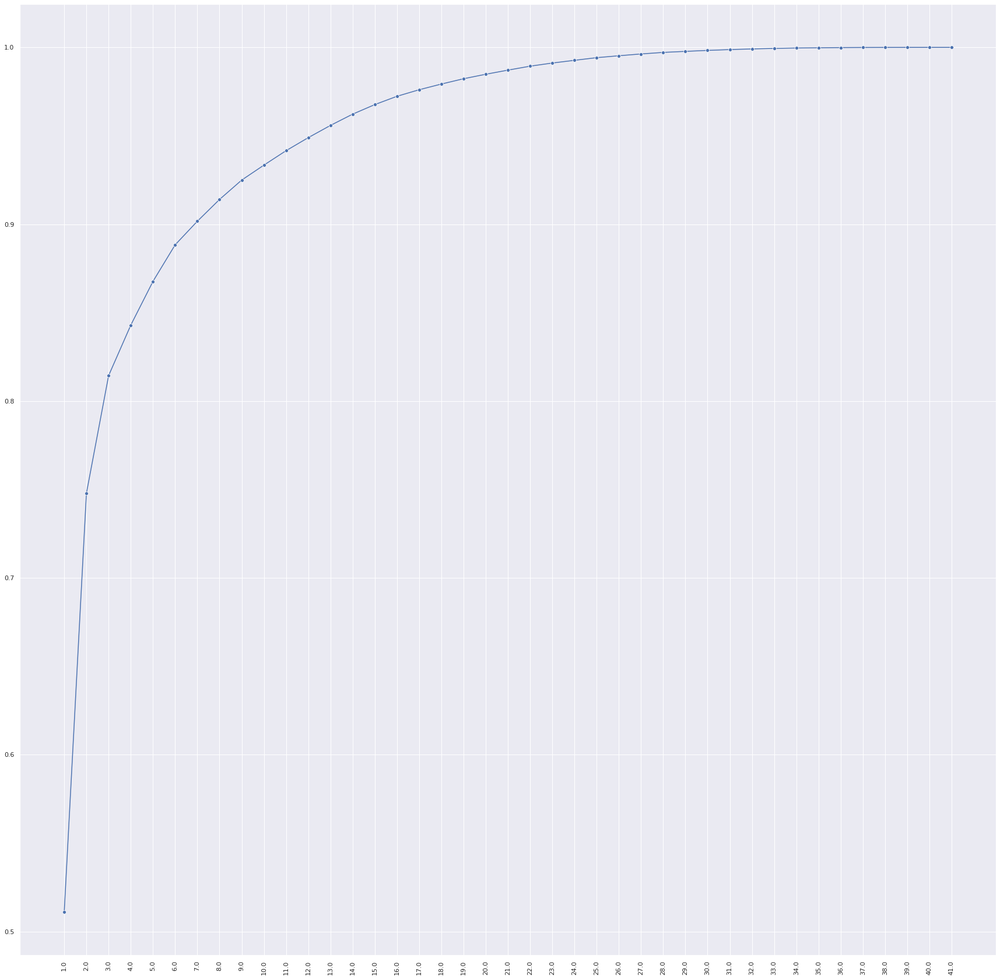

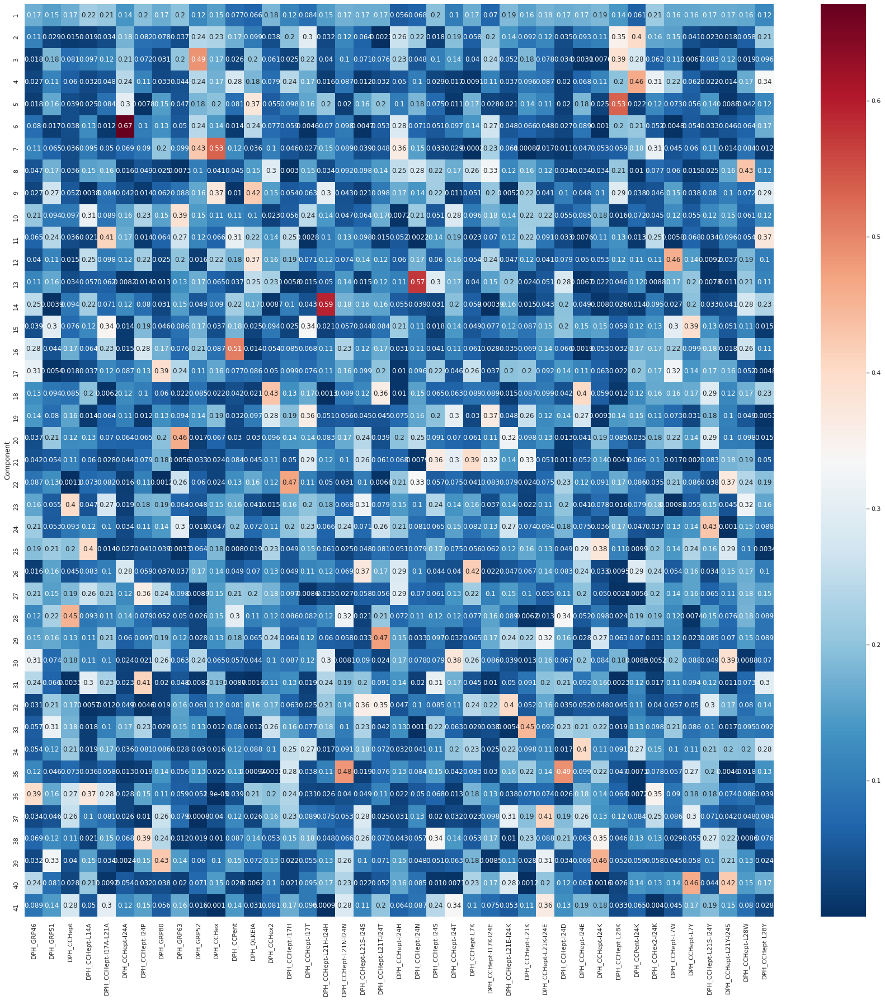

In [24]:
plt.rcParams['figure.figsize'] = (30, 30)  # Sets figure size
pca_model, pca_components = ml_2_classes.run_pca(
    fluor_data=copy.deepcopy(ml_2_classes.fluor_data).drop(kbest_feat_importances_df['Feature'].tolist()[41:], axis=1),
    scale=True, plt_name=''
)
plt.rcParams['figure.figsize'] = (10, 10)  # Resets default figure size

7 components are required to represent ~90% of the variance in the data. Many of the peptides make ~ similar contributions to the first component, whereas the subsequent components tend to be dominated by the signal from one/a few peptides.

Scatter plots of data transformed to PCA dimensions

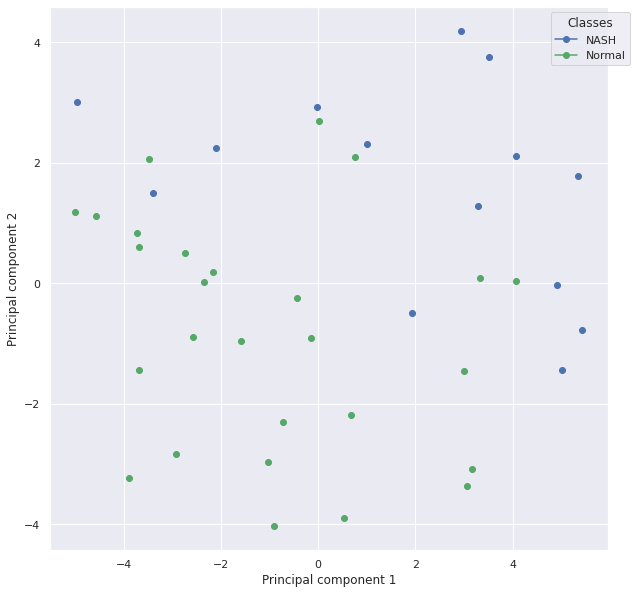

In [25]:
ml_2_classes.plot_scatter_on_pca_axes(
    x=copy.deepcopy(ml_2_classes.fluor_data).drop(kbest_feat_importances_df['Feature'].tolist()[41:], axis=1).to_numpy(),
    y=ml_2_classes.y, subclasses=ml_2_classes.sub_classes, num_dimensions=2,
    scale=True, plt_name=''
)

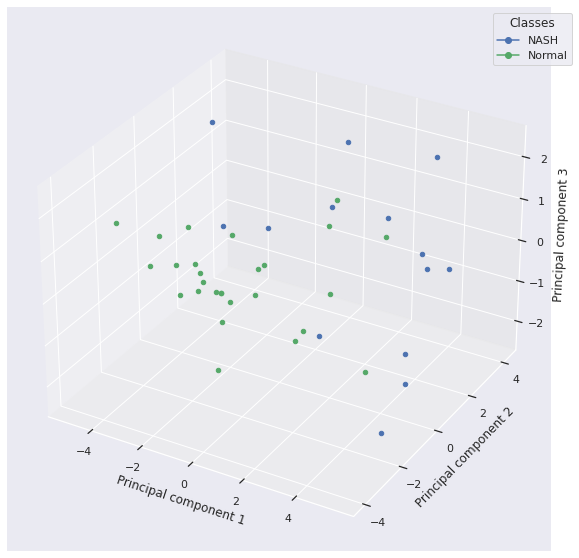

In [26]:
ml_2_classes.plot_scatter_on_pca_axes(
    x=copy.deepcopy(ml_2_classes.fluor_data).drop(kbest_feat_importances_df['Feature'].tolist()[41:], axis=1).to_numpy(),
    y=ml_2_classes.y, subclasses=ml_2_classes.sub_classes, num_dimensions=3,
    scale=True, plt_name=''
)

The 2 classes can clearly be separated by eye on these plots (although there is some overlap). Therefore expect to be able to train ML models to distinguish between the  classes better than random guessing - will be interesting to see how good a performance can be achieved!

#### How well does a model trained with all features perform?

Runs grid search with nested cross-validation to spot check 6 different ML algorithms and 2 dummy (random) classifiers. Inner loop identifies the optimal parameter values to use with the ML algorithm; outer loop measures the performance of a model trained using these parameter values.

In [27]:
algorithms = [DummyClassifier, DummyClassifier, KNeighborsClassifier, GaussianNB, LinearDiscriminantAnalysis,
              LinearSVC, SVC, AdaBoostClassifier]
resampling_methods = ['no_balancing', 'max_sampling', 'smote'] # Classes are imbalanced

n_components_pca = None
run = 'gridsearch'
n_iter = None
cv_folds_inner_loop = 5
cv_folds_outer_loop = 5
train_scoring_metric = make_scorer(f1_score, average='weighted', zero_division=0)
test_scoring_funcs={accuracy_score: {},
                    recall_score: {'average': 'weighted',
                                   'zero_division': 0},
                    precision_score: {'average': 'weighted',
                                      'zero_division': 0},
                    f1_score: {'average': 'weighted',
                               'zero_division': 0}}

all_feat_searches = OrderedDict({})
all_feat_score_dict = OrderedDict({'Algorithm': [],
                                   'Resampling_method': [],
                                   'Average_accuracy': [],
                                   'Std_dev_accuracy': [],
                                   'Average_recall': [],
                                   'Std_dev_recall': [],
                                   'Average_precision': [],
                                   'Std_dev_precision': [],
                                   'Average_f1': [],
                                   'Std_dev_f1': []})

for index, algorithm in enumerate(algorithms):
    for resampling_method in resampling_methods:
        if index == 0:
            fixed_params = OrderedDict({'strategy': 'prior',
                                        'random_state': 1})
            tuned_params = OrderedDict({})
        elif index == 1:
            fixed_params = OrderedDict({'strategy': 'stratified',
                                        'random_state': 1})
            tuned_params = OrderedDict({})
        else:
            fixed_params = ml_2_classes.define_fixed_model_params(classifier=algorithm())
            if algorithm.__name__ in ['LinearSVC', 'SVC', 'AdaBoostClassifier']:
                fixed_params['random_state'] = 1
            tuned_params = ml_2_classes.define_tuned_model_params(
                classifier=algorithm(), x_train=ml_2_classes.x, n_folds=cv_folds_inner_loop
            )

        nested_cv_search = ml_2_classes.run_nested_CV(
            clf=algorithm, x=ml_2_classes.x, y=ml_2_classes.y, groups=None,
            selected_features=list(ml_2_classes.features), inner_splits=None, outer_splits=None,
            const_split=True, resampling_method=resampling_method, n_components_pca=n_components_pca, run=run,
            fixed_params=fixed_params, tuned_params=tuned_params, train_scoring_metric=train_scoring_metric,
            test_scoring_funcs=test_scoring_funcs, n_iter=n_iter, cv_folds_inner_loop=cv_folds_inner_loop,
            cv_folds_outer_loop=cv_folds_outer_loop, draw_conf_mat=False, plt_name=''
        )
        
        if index == 0:
            all_feat_searches[
                'DummyClassifierPrior__{}'.format(resampling_method)
            ] = copy.deepcopy(nested_cv_search)
        elif index == 1:
            all_feat_searches[
                'DummyClassifierStratified__{}'.format(resampling_method)
            ] = copy.deepcopy(nested_cv_search)
        else:
            all_feat_searches[
                '{}__{}'.format(algorithm.__name__, resampling_method)
            ] = copy.deepcopy(nested_cv_search)

        if index == 0:
            all_feat_score_dict['Algorithm'].append('DummyClassifier_prior')
        elif index == 1:
            all_feat_score_dict['Algorithm'].append('DummyClassifier_stratified')
        else:
            all_feat_score_dict['Algorithm'].append(algorithm.__name__)
        all_feat_score_dict['Resampling_method'].append(resampling_method)
        all_feat_score_dict['Average_accuracy'].append(nested_cv_search['average_test_scores']['accuracy'])
        all_feat_score_dict['Std_dev_accuracy'].append(nested_cv_search['stddev_test_scores']['accuracy'])
        all_feat_score_dict['Average_recall'].append(nested_cv_search['average_test_scores']['recall'])
        all_feat_score_dict['Std_dev_recall'].append(nested_cv_search['stddev_test_scores']['recall'])
        all_feat_score_dict['Average_precision'].append(nested_cv_search['average_test_scores']['precision'])
        all_feat_score_dict['Std_dev_precision'].append(nested_cv_search['stddev_test_scores']['precision'])
        all_feat_score_dict['Average_f1'].append(nested_cv_search['average_test_scores']['f1'])
        all_feat_score_dict['Std_dev_f1'].append(nested_cv_search['stddev_test_scores']['f1'])

        # Print output of nested CV
        for n, params in enumerate(nested_cv_search['outer_loop_params']):
            print('\n\n\n')
            print('{}: {}'.format(algorithm.__name__, resampling_method))
            print('Parameters: {}'.format(params))
            print('Accuracy: {}'.format(nested_cv_search['test_scores']['accuracy'][n]))
            print('F1: {}'.format(nested_cv_search['test_scores']['f1'][n]))





DummyClassifier: no_balancing
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.6666666666666666
F1: 0.5333333333333334




DummyClassifier: no_balancing
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.625
F1: 0.4807692307692308




DummyClassifier: no_balancing
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.625
F1: 0.4807692307692308




DummyClassifier: no_balancing
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.625
F1: 0.4807692307692308




DummyClassifier: no_balancing
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.6428571428571428




DummyClassifier: max_sampling
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.3333333333333333
F1: 0.16666666666666666




DummyClassifier: max_sampling
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.





GaussianNB: smote
Parameters: OrderedDict()
Accuracy: 0.7777777777777778
F1: 0.7777777777777778




GaussianNB: smote
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.8681818181818182




GaussianNB: smote
Parameters: OrderedDict()
Accuracy: 0.625
F1: 0.6309523809523809




GaussianNB: smote
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.876984126984127




GaussianNB: smote
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.8818181818181818




LinearDiscriminantAnalysis: no_balancing
Parameters: OrderedDict()
Accuracy: 0.8888888888888888
F1: 0.8917748917748918




LinearDiscriminantAnalysis: no_balancing
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.8681818181818182




LinearDiscriminantAnalysis: no_balancing
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.8681818181818182




LinearDiscriminantAnalysis: no_balancing
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.8681818181818182




LinearDiscriminantAnalysis: no_balancing
Parameters: OrderedDict()
Accuracy: 1.0
F1: 1.0




Lin





AdaBoostClassifier: smote
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 0.6666666666666666
F1: 0.6753246753246753




AdaBoostClassifier: smote
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.75
F1: 0.7083333333333333




AdaBoostClassifier: smote
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.75
F1: 0.7500000000000001




AdaBoostClassifier: smote
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 100)])
Accuracy: 1.0
F1: 1.0




AdaBoostClassifier: smote
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 1000)])
Accuracy: 0.75
F1: 0.75


In [28]:
all_feat_score_df = pd.DataFrame(all_feat_score_dict)

In [29]:
all_feat_score_df

,Algorithm,Resampling_method,Average_accuracy,Std_dev_accuracy,Average_recall,Std_dev_recall,Average_precision,Std_dev_precision,Average_f1,Std_dev_f1
0,DummyClassifier_prior,no_balancing,0.658333,0.054327,0.658333,0.054327,0.435764,0.074582,0.523700,0.070392
1,DummyClassifier_prior,max_sampling,0.341667,0.054327,0.341667,0.054327,0.119097,0.034122,0.176061,0.045573
2,DummyClassifier_prior,smote,0.341667,0.054327,0.341667,0.054327,0.119097,0.034122,0.176061,0.045573
3,DummyClassifier_stratified,no_balancing,0.780556,0.054149,0.780556,0.054149,0.838095,0.031044,0.744414,0.065325
4,DummyClassifier_stratified,max_sampling,0.780556,0.054149,0.780556,0.054149,0.838095,0.031044,0.744414,0.065325
5,DummyClassifier_stratified,smote,0.780556,0.054149,0.780556,0.054149,0.838095,0.031044,0.744414,0.065325
6,KNeighborsClassifier,no_balancing,0.805556,0.140614,0.805556,0.140614,0.764931,0.232229,0.777106,0.192489
7,KNeighborsClassifier,max_sampling,0.855556,0.098503,0.855556,0.098503,0.883750,0.089927,0.855700,0.097263
8,KNeighborsClassifier,smote,0.830556,0.107762,0.830556,0.107762,0.874583,0.090720,0.832063,0.107313
9,GaussianNB,no_balancing,0.805556,0.109361,0.805556,0.109361,0.830556,0.112443,0.807143,0.107337


In [30]:
with open('{}/All_features_CV_search_models.pkl'.format(ml_2_classes.results_dir), 'wb') as f:
    pickle.dump((all_feat_searches, all_feat_score_df), f)

Most algorithms perform better than random guessing (although note how high a performance can be achieved by random guessing with the dummy classifiers given that the dataset is small and imbalanced => will make it more difficult to detect whether the trained classifiers perform better than random guessing). Three models perform equally well: Linear SVC with no class balancing, LinearSVC with class balancing via SMOTE, and SVC with no class balancing. Have selected LinearSVC with no class balancing.

In [31]:
all_feat_searches['LinearSVC__no_balancing']['outer_loop_params']

[OrderedDict([('dual', False),
              ('max_iter', 10000),
              ('random_state', 1),
              ('C', 0.125)]),
 OrderedDict([('dual', False),
              ('max_iter', 10000),
              ('random_state', 1),
              ('C', 0.25)]),
 OrderedDict([('dual', False),
              ('max_iter', 10000),
              ('random_state', 1),
              ('C', 0.0625)]),
 OrderedDict([('dual', False),
              ('max_iter', 10000),
              ('random_state', 1),
              ('C', 0.0625)]),
 OrderedDict([('dual', False),
              ('max_iter', 10000),
              ('random_state', 1),
              ('C', 0.5)])]

In [32]:
all_feat_searches['LinearSVC__no_balancing']['best_outer_loop_params']

OrderedDict([('accuracy',
              OrderedDict([('dual', False),
                           ('max_iter', 10000),
                           ('random_state', 1),
                           ('C', 0.25)])),
             ('recall',
              OrderedDict([('dual', False),
                           ('max_iter', 10000),
                           ('random_state', 1),
                           ('C', 0.25)])),
             ('precision',
              OrderedDict([('dual', False),
                           ('max_iter', 10000),
                           ('random_state', 1),
                           ('C', 0.25)])),
             ('f1',
              OrderedDict([('dual', False),
                           ('max_iter', 10000),
                           ('random_state', 1),
                           ('C', 0.25)]))])

In [33]:
all_feat_searches['LinearSVC__no_balancing']['test_scores']['accuracy']

[0.8888888888888888, 1.0, 0.875, 1.0, 0.875]

In [34]:
all_feat_nested_pred = all_feat_searches['LinearSVC__no_balancing']['predictions']
all_feat_nested_y_true = all_feat_searches['LinearSVC__no_balancing']['y_true']
all_feat_nested_x_true = all_feat_searches['LinearSVC__no_balancing']['x_true']

all_feat_flat_pred = np.array([pred for pred_array in all_feat_nested_pred for pred in pred_array])
all_feat_flat_y_true = np.array([y for y_array in all_feat_nested_y_true for y in y_array])
all_feat_flat_x_true = np.array([x for x_array in all_feat_nested_x_true for x in x_array])

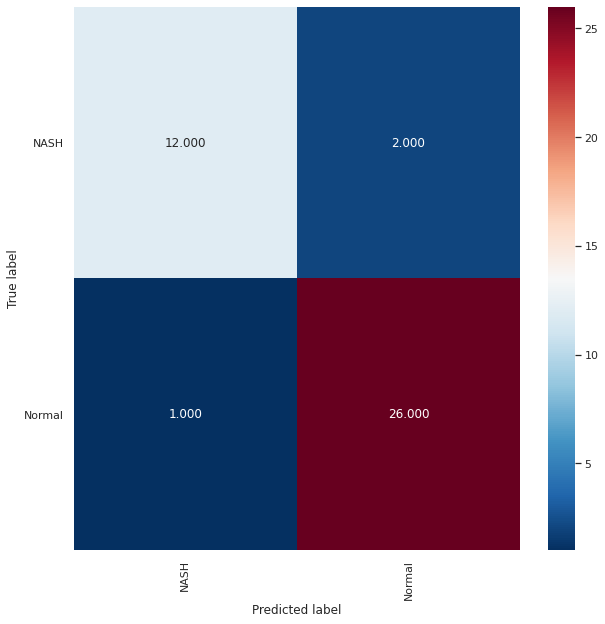

Normalised over true label (rows)


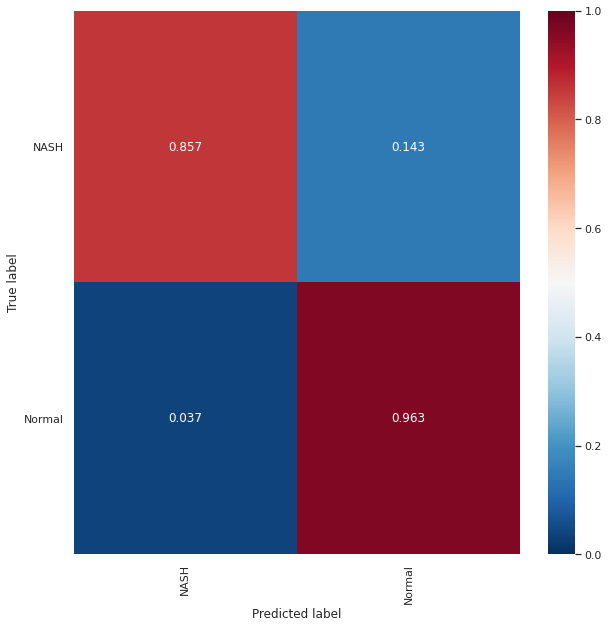

Normalised over pred label (columns)


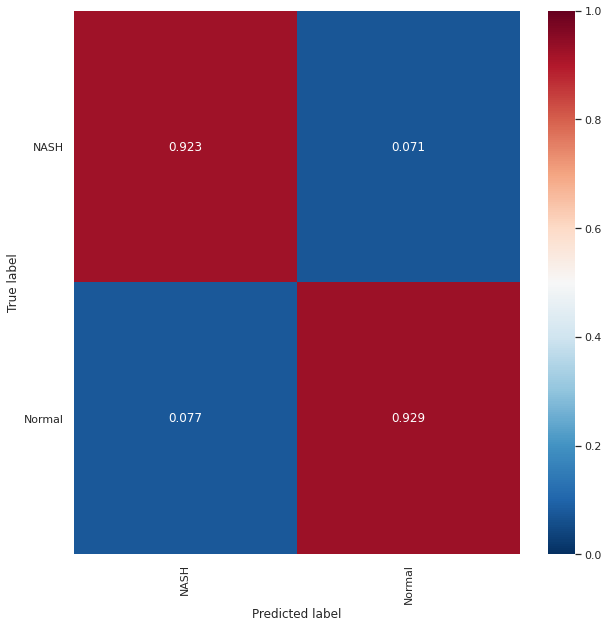

In [35]:
draw_conf_matrices(all_feat_flat_y_true, all_feat_flat_pred, ml_2_classes.results_dir, 'All_features')

In [36]:
all_feat_true_hue = []
for index, y in enumerate(all_feat_flat_y_true):
    if all_feat_flat_pred[index] == y:
        all_feat_true_hue.append('{}_correct'.format(y))
    else:
        all_feat_true_hue.append('{}_incorrect'.format(y))

sub_all_feat_true_hue = []
sub_all_feat_flat_x_true = []
sub_all_feat_flat_y_true = []
for i, true_hue in enumerate(all_feat_true_hue):
    if true_hue.endswith('_incorrect'):
        sub_all_feat_true_hue.append(true_hue)
        sub_all_feat_flat_x_true.append(all_feat_flat_x_true[i])
        sub_all_feat_flat_y_true.append(all_feat_flat_y_true[i])

all_feat_true_hue = np.array(all_feat_true_hue)
sub_all_feat_true_hue = np.array(sub_all_feat_true_hue)
sub_all_feat_flat_x_true = np.array(sub_all_feat_flat_x_true)
sub_all_feat_flat_y_true = np.array(sub_all_feat_flat_y_true)

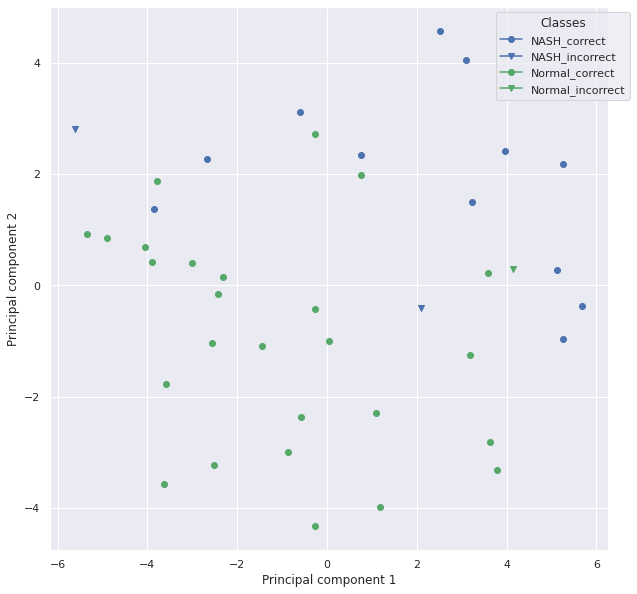

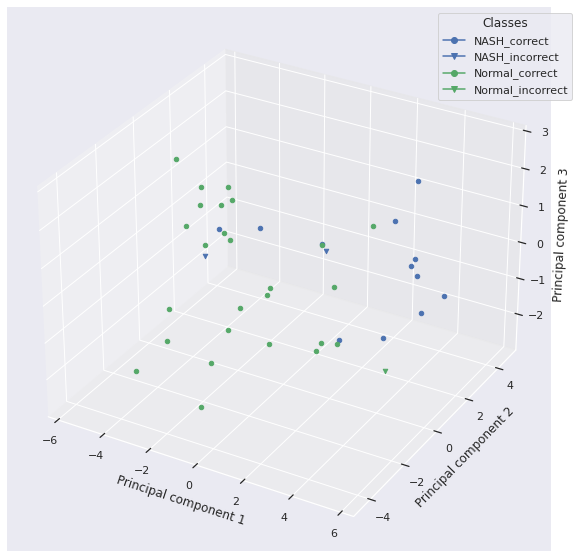

In [37]:
# Scatter plot (axes = top two principal components)
ml_2_classes.plot_scatter_on_pca_axes(
    x=all_feat_flat_x_true, y=all_feat_flat_y_true, subclasses=all_feat_true_hue, num_dimensions=2,
    scale=True, plt_name='All_features_coloured_by_pred'
)

# Scatter plot (axes = top three principal components)
ml_2_classes.plot_scatter_on_pca_axes(
    x=all_feat_flat_x_true, y=all_feat_flat_y_true, subclasses=all_feat_true_hue, num_dimensions=3,
    scale=True, plt_name='All_features_coloured_by_pred'
)

# NASH_incorrect = Value that is actually NASH is predicted to be something else

It is possible to train an ML model that is able to identify, better than random guessing (see significance tests below), the class labels of subclasses it was not exposed to during training, i.e. in this case the model can predict the class ("Normal" or "NASH") of a sample from a patient it hasn't seen before.

The earlier correlation coefficients and importance analysis in this notebook indicate that many of the peptides provide similar information to one another. Is it therefore possible to maintain/improve model performance by reducing the number of features?

#### Is it possible to maintain/improve model performance when reducing the number of peptides?

Sequentially include features via their feature importance (as measured via KBest/permutation analysis), measure if there is any difference in trained classifier performance.

In [38]:
algorithms = [DummyClassifier, DummyClassifier, KNeighborsClassifier, GaussianNB, LinearDiscriminantAnalysis,
              LinearSVC, SVC, AdaBoostClassifier]
resampling_methods = ['no_balancing', 'max_sampling', 'smote']
num_features_list = [1, 2, 3, 4, 5, 10, 15, 20, 30, 46]

ordered_features = {'KBest_Fscore': kbest_feat_importances_df['Feature'].tolist(),
                    'Permutation_score': mean_permut_feat_importances_df['Feature'].tolist()}

n_components_pca = None
run = 'gridsearch'
n_iter = None
cv_folds_inner_loop = 5
cv_folds_outer_loop = 5
train_scoring_metric = make_scorer(f1_score, average='weighted', zero_division=0)
test_scoring_funcs = {accuracy_score: {},
                      recall_score: {'average': 'weighted',
                                     'zero_division': 0},
                      precision_score: {'average': 'weighted',
                                        'zero_division': 0},
                      f1_score: {'average': 'weighted',
                                 'zero_division': 0}}

red_feat_searches = OrderedDict({})
red_feat_score_dict = OrderedDict({'Algorithm': [],
                                   'Resampling_method': [],
                                   'Feature_selection_method': [],
                                   'Num_features': [],
                                   'Average_accuracy': [],
                                   'Std_dev_accuracy': [],
                                   'Average_recall': [],
                                   'Std_dev_recall': [],
                                   'Average_precision': [],
                                   'Std_dev_precision': [],
                                   'Average_f1': [],
                                   'Std_dev_f1': []})
for index, algorithm in enumerate(algorithms):
    for resampling_method in resampling_methods:
        for feat_method, all_features in ordered_features.items():
            for num_features in num_features_list:
                if index == 0:
                    fixed_params = OrderedDict({'strategy': 'prior',
                                                'random_state': 1})
                    tuned_params = OrderedDict({})
                elif index == 1:
                    fixed_params = OrderedDict({'strategy': 'stratified',
                                                'random_state': 1})
                    tuned_params = OrderedDict({})
                else:
                    fixed_params = ml_2_classes.define_fixed_model_params(classifier=algorithm())
                    if algorithm.__name__ in ['LinearSVC', 'SVC', 'AdaBoostClassifier']:
                        fixed_params['random_state'] = 1
                    tuned_params = ml_2_classes.define_tuned_model_params(
                        classifier=algorithm(), x_train=ml_2_classes.x, n_folds=cv_folds_inner_loop
                    )

                selected_features = all_features[:num_features]

                nested_cv_search = ml_2_classes.run_nested_CV(
                    clf=algorithm, x=ml_2_classes.x, y=ml_2_classes.y, groups=None,
                    selected_features=selected_features, inner_splits=None, outer_splits=None, const_split=True,
                    resampling_method=resampling_method, n_components_pca=n_components_pca, run=run,
                    fixed_params=fixed_params, tuned_params=tuned_params,
                    train_scoring_metric=train_scoring_metric, test_scoring_funcs=test_scoring_funcs,
                    n_iter=n_iter, cv_folds_inner_loop=cv_folds_inner_loop,
                    cv_folds_outer_loop=cv_folds_outer_loop, draw_conf_mat=False, plt_name=''
                )
                
                if index == 0:
                    red_feat_searches[
                        'DummyClassifierPrior__{}__{}__{}'.format(resampling_method, feat_method, num_features)
                    ] = copy.deepcopy(nested_cv_search)
                elif index == 1:
                    red_feat_searches[
                        'DummyClassifierStratified__{}__{}__{}'.format(
                            resampling_method, feat_method, num_features
                        )
                    ] = copy.deepcopy(nested_cv_search)
                else:
                    red_feat_searches[
                        '{}__{}__{}__{}'.format(algorithm.__name__, resampling_method, feat_method, num_features)
                    ] = copy.deepcopy(nested_cv_search)

                if index == 0:
                    red_feat_score_dict['Algorithm'].append('DummyClassifier_prior')
                elif index == 1:
                    red_feat_score_dict['Algorithm'].append('DummyClassifier_stratified')
                else:
                    red_feat_score_dict['Algorithm'].append(algorithm.__name__)
                red_feat_score_dict['Resampling_method'].append(resampling_method)
                red_feat_score_dict['Feature_selection_method'].append(feat_method)
                red_feat_score_dict['Num_features'].append(num_features)
                red_feat_score_dict['Average_accuracy'].append(nested_cv_search['average_test_scores']['accuracy'])
                red_feat_score_dict['Std_dev_accuracy'].append(nested_cv_search['stddev_test_scores']['accuracy'])
                red_feat_score_dict['Average_recall'].append(nested_cv_search['average_test_scores']['recall'])
                red_feat_score_dict['Std_dev_recall'].append(nested_cv_search['stddev_test_scores']['recall'])
                red_feat_score_dict['Average_precision'].append(nested_cv_search['average_test_scores']['precision'])
                red_feat_score_dict['Std_dev_precision'].append(nested_cv_search['stddev_test_scores']['precision'])
                red_feat_score_dict['Average_f1'].append(nested_cv_search['average_test_scores']['f1'])
                red_feat_score_dict['Std_dev_f1'].append(nested_cv_search['stddev_test_scores']['f1'])

                # Print output of nested CV
                for n, params in enumerate(nested_cv_search['outer_loop_params']):
                    print('\n\n\n')
                    print('{}: {},  {},  {}'.format(
                        algorithm.__name__, resampling_method, feat_method, num_features
                    ))
                    print('Parameters: {}'.format(params))
                    print('Accuracy: {}'.format(nested_cv_search['test_scores']['accuracy'][n]))
                    print('F1: {}'.format(nested_cv_search['test_scores']['f1'][n]))





DummyClassifier: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.6666666666666666
F1: 0.5333333333333334




DummyClassifier: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.625
F1: 0.4807692307692308




DummyClassifier: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.625
F1: 0.4807692307692308




DummyClassifier: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.625
F1: 0.4807692307692308




DummyClassifier: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.6428571428571428




DummyClassifier: no_balancing,  KBest_Fscore,  2
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.6666666666666666
F1: 0.5333333333333334









DummyClassifier: no_balancing,  Permutation_score,  1
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.6666666666666666
F1: 0.5333333333333334




DummyClassifier: no_balancing,  Permutation_score,  1
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.625
F1: 0.4807692307692308




DummyClassifier: no_balancing,  Permutation_score,  1
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.625
F1: 0.4807692307692308




DummyClassifier: no_balancing,  Permutation_score,  1
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.625
F1: 0.4807692307692308




DummyClassifier: no_balancing,  Permutation_score,  1
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.6428571428571428




DummyClassifier: no_balancing,  Permutation_score,  2
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.6666666666666





DummyClassifier: max_sampling,  KBest_Fscore,  1
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.3333333333333333
F1: 0.16666666666666666




DummyClassifier: max_sampling,  KBest_Fscore,  1
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.375
F1: 0.20454545454545453




DummyClassifier: max_sampling,  KBest_Fscore,  1
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.375
F1: 0.20454545454545453




DummyClassifier: max_sampling,  KBest_Fscore,  1
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.375
F1: 0.20454545454545453




DummyClassifier: max_sampling,  KBest_Fscore,  1
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.25
F1: 0.1




DummyClassifier: max_sampling,  KBest_Fscore,  2
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.3333333333333333
F1: 0.16666666666666666




DummyClas





DummyClassifier: max_sampling,  Permutation_score,  2
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.3333333333333333
F1: 0.16666666666666666




DummyClassifier: max_sampling,  Permutation_score,  2
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.375
F1: 0.20454545454545453




DummyClassifier: max_sampling,  Permutation_score,  2
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.375
F1: 0.20454545454545453




DummyClassifier: max_sampling,  Permutation_score,  2
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.375
F1: 0.20454545454545453




DummyClassifier: max_sampling,  Permutation_score,  2
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.25
F1: 0.1




DummyClassifier: max_sampling,  Permutation_score,  3
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.3333333333333333
F1: 0.1





DummyClassifier: smote,  KBest_Fscore,  2
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.3333333333333333
F1: 0.16666666666666666




DummyClassifier: smote,  KBest_Fscore,  2
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.375
F1: 0.20454545454545453




DummyClassifier: smote,  KBest_Fscore,  2
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.375
F1: 0.20454545454545453




DummyClassifier: smote,  KBest_Fscore,  2
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.375
F1: 0.20454545454545453




DummyClassifier: smote,  KBest_Fscore,  2
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.25
F1: 0.1




DummyClassifier: smote,  KBest_Fscore,  3
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.3333333333333333
F1: 0.16666666666666666




DummyClassifier: smote,  KBest_Fscore,  3
Parameter





DummyClassifier: smote,  Permutation_score,  3
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.3333333333333333
F1: 0.16666666666666666




DummyClassifier: smote,  Permutation_score,  3
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.375
F1: 0.20454545454545453




DummyClassifier: smote,  Permutation_score,  3
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.375
F1: 0.20454545454545453




DummyClassifier: smote,  Permutation_score,  3
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.375
F1: 0.20454545454545453




DummyClassifier: smote,  Permutation_score,  3
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.25
F1: 0.1




DummyClassifier: smote,  Permutation_score,  4
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.3333333333333333
F1: 0.16666666666666666




DummyClassifier: smot





DummyClassifier: no_balancing,  KBest_Fscore,  4
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.7777777777777778
F1: 0.738095238095238




DummyClassifier: no_balancing,  KBest_Fscore,  4
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.7083333333333333




DummyClassifier: no_balancing,  KBest_Fscore,  4
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.7083333333333333




DummyClassifier: no_balancing,  KBest_Fscore,  4
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.7083333333333333




DummyClassifier: no_balancing,  KBest_Fscore,  4
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.875
F1: 0.8589743589743589




DummyClassifier: no_balancing,  KBest_Fscore,  5
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.7777777777777778





DummyClassifier: no_balancing,  Permutation_score,  4
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.7777777777777778
F1: 0.738095238095238




DummyClassifier: no_balancing,  Permutation_score,  4
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.7083333333333333




DummyClassifier: no_balancing,  Permutation_score,  4
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.7083333333333333




DummyClassifier: no_balancing,  Permutation_score,  4
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.7083333333333333




DummyClassifier: no_balancing,  Permutation_score,  4
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.875
F1: 0.8589743589743589




DummyClassifier: no_balancing,  Permutation_score,  5
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)]





DummyClassifier: max_sampling,  KBest_Fscore,  4
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.7777777777777778
F1: 0.738095238095238




DummyClassifier: max_sampling,  KBest_Fscore,  4
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.7083333333333333




DummyClassifier: max_sampling,  KBest_Fscore,  4
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.7083333333333333




DummyClassifier: max_sampling,  KBest_Fscore,  4
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.7083333333333333




DummyClassifier: max_sampling,  KBest_Fscore,  4
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.875
F1: 0.8589743589743589




DummyClassifier: max_sampling,  KBest_Fscore,  5
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.7777777777777778





DummyClassifier: max_sampling,  Permutation_score,  4
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.7777777777777778
F1: 0.738095238095238




DummyClassifier: max_sampling,  Permutation_score,  4
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.7083333333333333




DummyClassifier: max_sampling,  Permutation_score,  4
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.7083333333333333




DummyClassifier: max_sampling,  Permutation_score,  4
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.7083333333333333




DummyClassifier: max_sampling,  Permutation_score,  4
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.875
F1: 0.8589743589743589




DummyClassifier: max_sampling,  Permutation_score,  5
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)]





DummyClassifier: smote,  KBest_Fscore,  4
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.7777777777777778
F1: 0.738095238095238




DummyClassifier: smote,  KBest_Fscore,  4
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.7083333333333333




DummyClassifier: smote,  KBest_Fscore,  4
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.7083333333333333




DummyClassifier: smote,  KBest_Fscore,  4
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.7083333333333333




DummyClassifier: smote,  KBest_Fscore,  4
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.875
F1: 0.8589743589743589




DummyClassifier: smote,  KBest_Fscore,  5
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.7777777777777778
F1: 0.738095238095238




DummyClassifier





DummyClassifier: smote,  Permutation_score,  5
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.7777777777777778
F1: 0.738095238095238




DummyClassifier: smote,  Permutation_score,  5
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.7083333333333333




DummyClassifier: smote,  Permutation_score,  5
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.7083333333333333




DummyClassifier: smote,  Permutation_score,  5
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.7083333333333333




DummyClassifier: smote,  Permutation_score,  5
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.875
F1: 0.8589743589743589




DummyClassifier: smote,  Permutation_score,  10
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.7777777777777778
F1: 0.7380





KNeighborsClassifier: no_balancing,  KBest_Fscore,  4
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 5), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.7777777777777778
F1: 0.7777777777777778




KNeighborsClassifier: no_balancing,  KBest_Fscore,  4
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 5), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.875
F1: 0.8681818181818182




KNeighborsClassifier: no_balancing,  KBest_Fscore,  4
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 5), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.75
F1: 0.7083333333333333




KNeighborsClassifier: no_balancing,  KBest_Fscore,  4
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 5), ('p', 2), ('weights', 'uniform')])
Accuracy: 1.0
F1: 1.0




KNeighborsClassifier: no_balancing,  KBest_Fscore,  4
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neigh





KNeighborsClassifier: no_balancing,  Permutation_score,  2
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 3), ('p', 1), ('weights', 'distance')])
Accuracy: 0.7777777777777778
F1: 0.7833333333333334




KNeighborsClassifier: no_balancing,  Permutation_score,  2
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 7), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.875
F1: 0.8681818181818182




KNeighborsClassifier: no_balancing,  Permutation_score,  2
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 7), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.75
F1: 0.7083333333333333




KNeighborsClassifier: no_balancing,  Permutation_score,  2
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 7), ('p', 2), ('weights', 'uniform')])
Accuracy: 1.0
F1: 1.0




KNeighborsClassifier: no_balancing,  Permutation_score,  2
Parameters: OrderedDict([('metric', 'minkowski'),





KNeighborsClassifier: no_balancing,  Permutation_score,  46
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 3), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.7777777777777778
F1: 0.7777777777777778




KNeighborsClassifier: no_balancing,  Permutation_score,  46
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 2), ('p', 1), ('weights', 'distance')])
Accuracy: 1.0
F1: 1.0




KNeighborsClassifier: no_balancing,  Permutation_score,  46
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 7), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.625
F1: 0.4807692307692308




KNeighborsClassifier: no_balancing,  Permutation_score,  46
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 2), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.875
F1: 0.876984126984127




KNeighborsClassifier: no_balancing,  Permutation_score,  46
Parameters: OrderedDict([('metric', 'minkows





KNeighborsClassifier: max_sampling,  KBest_Fscore,  20
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 2), ('p', 1), ('weights', 'distance')])
Accuracy: 0.6666666666666666
F1: 0.6461538461538461




KNeighborsClassifier: max_sampling,  KBest_Fscore,  20
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 6), ('p', 2), ('weights', 'distance')])
Accuracy: 0.875
F1: 0.8681818181818182




KNeighborsClassifier: max_sampling,  KBest_Fscore,  20
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 2), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.625
F1: 0.6309523809523809




KNeighborsClassifier: max_sampling,  KBest_Fscore,  20
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 4), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.875
F1: 0.876984126984127




KNeighborsClassifier: max_sampling,  KBest_Fscore,  20
Parameters: OrderedDict([('metric', 'minkowski'), (





KNeighborsClassifier: max_sampling,  Permutation_score,  10
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 2), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.8888888888888888
F1: 0.8917748917748918




KNeighborsClassifier: max_sampling,  Permutation_score,  10
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 2), ('p', 1), ('weights', 'distance')])
Accuracy: 0.875
F1: 0.8681818181818182




KNeighborsClassifier: max_sampling,  Permutation_score,  10
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 5), ('p', 1), ('weights', 'distance')])
Accuracy: 1.0
F1: 1.0




KNeighborsClassifier: max_sampling,  Permutation_score,  10
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 5), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.875
F1: 0.876984126984127




KNeighborsClassifier: max_sampling,  Permutation_score,  10
Parameters: OrderedDict([('metric', 'minkow





KNeighborsClassifier: smote,  KBest_Fscore,  4
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 4), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.5555555555555556
F1: 0.5333333333333333




KNeighborsClassifier: smote,  KBest_Fscore,  4
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 5), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.875
F1: 0.8681818181818182




KNeighborsClassifier: smote,  KBest_Fscore,  4
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 7), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.5
F1: 0.5




KNeighborsClassifier: smote,  KBest_Fscore,  4
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 7), ('p', 2), ('weights', 'distance')])
Accuracy: 0.75
F1: 0.7499999999999999




KNeighborsClassifier: smote,  KBest_Fscore,  4
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 3), ('p', 2), ('weights', '





KNeighborsClassifier: smote,  Permutation_score,  2
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 3), ('p', 1), ('weights', 'distance')])
Accuracy: 0.6666666666666666
F1: 0.6666666666666666




KNeighborsClassifier: smote,  Permutation_score,  2
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 2), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.875
F1: 0.8681818181818182




KNeighborsClassifier: smote,  Permutation_score,  2
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 5), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.625
F1: 0.6309523809523809




KNeighborsClassifier: smote,  Permutation_score,  2
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 4), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.75
F1: 0.7499999999999999




KNeighborsClassifier: smote,  Permutation_score,  2
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), (





KNeighborsClassifier: smote,  Permutation_score,  46
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 2), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.7777777777777778
F1: 0.7833333333333334




KNeighborsClassifier: smote,  Permutation_score,  46
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 2), ('p', 1), ('weights', 'distance')])
Accuracy: 1.0
F1: 1.0




KNeighborsClassifier: smote,  Permutation_score,  46
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 7), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.75
F1: 0.7499999999999999




KNeighborsClassifier: smote,  Permutation_score,  46
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 4), ('p', 1), ('weights', 'distance')])
Accuracy: 0.875
F1: 0.876984126984127




KNeighborsClassifier: smote,  Permutation_score,  46
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors





GaussianNB: no_balancing,  Permutation_score,  4
Parameters: OrderedDict()
Accuracy: 0.8888888888888888
F1: 0.8917748917748918




GaussianNB: no_balancing,  Permutation_score,  4
Parameters: OrderedDict()
Accuracy: 1.0
F1: 1.0




GaussianNB: no_balancing,  Permutation_score,  4
Parameters: OrderedDict()
Accuracy: 0.75
F1: 0.7500000000000001




GaussianNB: no_balancing,  Permutation_score,  4
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.876984126984127




GaussianNB: no_balancing,  Permutation_score,  4
Parameters: OrderedDict()
Accuracy: 0.75
F1: 0.75




GaussianNB: no_balancing,  Permutation_score,  5
Parameters: OrderedDict()
Accuracy: 0.8888888888888888
F1: 0.8917748917748918




GaussianNB: no_balancing,  Permutation_score,  5
Parameters: OrderedDict()
Accuracy: 1.0
F1: 1.0




GaussianNB: no_balancing,  Permutation_score,  5
Parameters: OrderedDict()
Accuracy: 0.75
F1: 0.7500000000000001




GaussianNB: no_balancing,  Permutation_score,  5
Parameters: OrderedDict()
Acc





GaussianNB: max_sampling,  KBest_Fscore,  30
Parameters: OrderedDict()
Accuracy: 0.7777777777777778
F1: 0.7777777777777778




GaussianNB: max_sampling,  KBest_Fscore,  30
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.8681818181818182




GaussianNB: max_sampling,  KBest_Fscore,  30
Parameters: OrderedDict()
Accuracy: 0.625
F1: 0.6309523809523809




GaussianNB: max_sampling,  KBest_Fscore,  30
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.876984126984127




GaussianNB: max_sampling,  KBest_Fscore,  30
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.8818181818181818




GaussianNB: max_sampling,  KBest_Fscore,  46
Parameters: OrderedDict()
Accuracy: 0.7777777777777778
F1: 0.7777777777777778




GaussianNB: max_sampling,  KBest_Fscore,  46
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.8681818181818182




GaussianNB: max_sampling,  KBest_Fscore,  46
Parameters: OrderedDict()
Accuracy: 0.625
F1: 0.6309523809523809




GaussianNB: max_sampling,  KBest_Fscore,  46
Parameters: Or





GaussianNB: smote,  KBest_Fscore,  4
Parameters: OrderedDict()
Accuracy: 0.6666666666666666
F1: 0.6753246753246753




GaussianNB: smote,  KBest_Fscore,  4
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.8681818181818182




GaussianNB: smote,  KBest_Fscore,  4
Parameters: OrderedDict()
Accuracy: 0.625
F1: 0.6309523809523809




GaussianNB: smote,  KBest_Fscore,  4
Parameters: OrderedDict()
Accuracy: 0.75
F1: 0.7499999999999999




GaussianNB: smote,  KBest_Fscore,  4
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.8818181818181818




GaussianNB: smote,  KBest_Fscore,  5
Parameters: OrderedDict()
Accuracy: 0.6666666666666666
F1: 0.6753246753246753




GaussianNB: smote,  KBest_Fscore,  5
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.8681818181818182




GaussianNB: smote,  KBest_Fscore,  5
Parameters: OrderedDict()
Accuracy: 0.625
F1: 0.6309523809523809




GaussianNB: smote,  KBest_Fscore,  5
Parameters: OrderedDict()
Accuracy: 0.75
F1: 0.7499999999999999




GaussianNB: smote,





GaussianNB: smote,  Permutation_score,  30
Parameters: OrderedDict()
Accuracy: 0.7777777777777778
F1: 0.7777777777777778




GaussianNB: smote,  Permutation_score,  30
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.8681818181818182




GaussianNB: smote,  Permutation_score,  30
Parameters: OrderedDict()
Accuracy: 0.75
F1: 0.7500000000000001




GaussianNB: smote,  Permutation_score,  30
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.876984126984127




GaussianNB: smote,  Permutation_score,  30
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.8818181818181818




GaussianNB: smote,  Permutation_score,  46
Parameters: OrderedDict()
Accuracy: 0.7777777777777778
F1: 0.7777777777777778




GaussianNB: smote,  Permutation_score,  46
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.8681818181818182




GaussianNB: smote,  Permutation_score,  46
Parameters: OrderedDict()
Accuracy: 0.625
F1: 0.6309523809523809




GaussianNB: smote,  Permutation_score,  46
Parameters: OrderedDict()
Accurac





LinearDiscriminantAnalysis: no_balancing,  Permutation_score,  3
Parameters: OrderedDict()
Accuracy: 0.7777777777777778
F1: 0.7777777777777778




LinearDiscriminantAnalysis: no_balancing,  Permutation_score,  3
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.8681818181818182




LinearDiscriminantAnalysis: no_balancing,  Permutation_score,  3
Parameters: OrderedDict()
Accuracy: 0.75
F1: 0.7500000000000001




LinearDiscriminantAnalysis: no_balancing,  Permutation_score,  3
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.8681818181818182




LinearDiscriminantAnalysis: no_balancing,  Permutation_score,  3
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.8589743589743589




LinearDiscriminantAnalysis: no_balancing,  Permutation_score,  4
Parameters: OrderedDict()
Accuracy: 0.7777777777777778
F1: 0.7833333333333334




LinearDiscriminantAnalysis: no_balancing,  Permutation_score,  4
Parameters: OrderedDict()
Accuracy: 1.0
F1: 1.0




LinearDiscriminantAnalysis: no_balancing,  Permuta





LinearDiscriminantAnalysis: max_sampling,  KBest_Fscore,  10
Parameters: OrderedDict()
Accuracy: 0.6666666666666666
F1: 0.6753246753246753




LinearDiscriminantAnalysis: max_sampling,  KBest_Fscore,  10
Parameters: OrderedDict()
Accuracy: 1.0
F1: 1.0




LinearDiscriminantAnalysis: max_sampling,  KBest_Fscore,  10
Parameters: OrderedDict()
Accuracy: 0.375
F1: 0.38492063492063494




LinearDiscriminantAnalysis: max_sampling,  KBest_Fscore,  10
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.876984126984127




LinearDiscriminantAnalysis: max_sampling,  KBest_Fscore,  10
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.8589743589743589




LinearDiscriminantAnalysis: max_sampling,  KBest_Fscore,  15
Parameters: OrderedDict()
Accuracy: 0.5555555555555556
F1: 0.5666666666666667




LinearDiscriminantAnalysis: max_sampling,  KBest_Fscore,  15
Parameters: OrderedDict()
Accuracy: 0.5
F1: 0.5




LinearDiscriminantAnalysis: max_sampling,  KBest_Fscore,  15
Parameters: OrderedDict()
Accurac





LinearDiscriminantAnalysis: max_sampling,  Permutation_score,  30
Parameters: OrderedDict()
Accuracy: 0.3333333333333333
F1: 0.30000000000000004




LinearDiscriminantAnalysis: max_sampling,  Permutation_score,  30
Parameters: OrderedDict()
Accuracy: 0.25
F1: 0.25




LinearDiscriminantAnalysis: max_sampling,  Permutation_score,  30
Parameters: OrderedDict()
Accuracy: 0.5
F1: 0.5




LinearDiscriminantAnalysis: max_sampling,  Permutation_score,  30
Parameters: OrderedDict()
Accuracy: 0.75
F1: 0.7500000000000001




LinearDiscriminantAnalysis: max_sampling,  Permutation_score,  30
Parameters: OrderedDict()
Accuracy: 0.75
F1: 0.75




LinearDiscriminantAnalysis: max_sampling,  Permutation_score,  46
Parameters: OrderedDict()
Accuracy: 0.7777777777777778
F1: 0.7833333333333334




LinearDiscriminantAnalysis: max_sampling,  Permutation_score,  46
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.8681818181818182




LinearDiscriminantAnalysis: max_sampling,  Permutation_score,  46
Parame





LinearDiscriminantAnalysis: smote,  Permutation_score,  3
Parameters: OrderedDict()
Accuracy: 0.7777777777777778
F1: 0.7777777777777778




LinearDiscriminantAnalysis: smote,  Permutation_score,  3
Parameters: OrderedDict()
Accuracy: 1.0
F1: 1.0




LinearDiscriminantAnalysis: smote,  Permutation_score,  3
Parameters: OrderedDict()
Accuracy: 0.75
F1: 0.7500000000000001




LinearDiscriminantAnalysis: smote,  Permutation_score,  3
Parameters: OrderedDict()
Accuracy: 0.75
F1: 0.7500000000000001




LinearDiscriminantAnalysis: smote,  Permutation_score,  3
Parameters: OrderedDict()
Accuracy: 0.75
F1: 0.75




LinearDiscriminantAnalysis: smote,  Permutation_score,  4
Parameters: OrderedDict()
Accuracy: 0.7777777777777778
F1: 0.7833333333333334




LinearDiscriminantAnalysis: smote,  Permutation_score,  4
Parameters: OrderedDict()
Accuracy: 1.0
F1: 1.0




LinearDiscriminantAnalysis: smote,  Permutation_score,  4
Parameters: OrderedDict()
Accuracy: 0.75
F1: 0.7500000000000001




Linear

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: no_balancing,  KBest_Fscore,  3
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 2.0)])
Accuracy: 0.6666666666666666
F1: 0.6753246753246753




LinearSVC: no_balancing,  KBest_Fscore,  3
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.0625)])
Accuracy: 0.875
F1: 0.8681818181818182




LinearSVC: no_balancing,  KBest_Fscore,  3
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.75
F1: 0.7083333333333333




LinearSVC: no_balancing,  KBest_Fscore,  3
Parameters: Ord





LinearSVC: no_balancing,  KBest_Fscore,  20
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.0625)])
Accuracy: 0.6666666666666666
F1: 0.6753246753246753




LinearSVC: no_balancing,  KBest_Fscore,  20
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.875
F1: 0.8681818181818182




LinearSVC: no_balancing,  KBest_Fscore,  20
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.75
F1: 0.7500000000000001




LinearSVC: no_balancing,  KBest_Fscore,  20
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.875
F1: 0.876984126984127




LinearSVC: no_balancing,  KBest_Fscore,  20
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.5)])
Accuracy: 0.625
F1: 0.6454545454545454
Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0,

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: no_balancing,  Permutation_score,  4
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 1024.0)])
Accuracy: 0.7777777777777778
F1: 0.7833333333333334




LinearSVC: no_balancing,  Permutation_score,  4
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 1.0
F1: 1.0




LinearSVC: no_balancing,  Permutation_score,  4
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 4.0)])
Accuracy: 0.75
F1: 0.7500000000000001




LinearSVC: no_balancing,  Permutation_score,  4
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 1.0)])
Accuracy: 0.875
F1: 0.8681818181818182




LinearSVC: no_balancing,  Permutation_score,  4
Parameter





LinearSVC: no_balancing,  Permutation_score,  46
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.125)])
Accuracy: 0.8888888888888888
F1: 0.8917748917748918




LinearSVC: no_balancing,  Permutation_score,  46
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.25)])
Accuracy: 1.0
F1: 1.0




LinearSVC: no_balancing,  Permutation_score,  46
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.0625)])
Accuracy: 0.875
F1: 0.8681818181818182




LinearSVC: no_balancing,  Permutation_score,  46
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.0625)])
Accuracy: 1.0
F1: 1.0




LinearSVC: no_balancing,  Permutation_score,  46
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.5)])
Accuracy: 0.875
F1: 0.8589743589743589
Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: max_sampling,  KBest_Fscore,  15
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 1.0)])
Accuracy: 0.4444444444444444
F1: 0.4588744588744588




LinearSVC: max_sampling,  KBest_Fscore,  15
Parameters: Ord

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: max_sampling,  Permutation_score,  3
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.5)])
Accuracy: 0.7777777777777778
F1: 0.7777777777777778




LinearSVC: max_sampling,  Permutation_score,  3
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 1.0
F1: 1.0




LinearSVC: max_sampling,  Permutation_score,  3
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 64.0)])
Accuracy: 0.75
F1: 0.7500000000000001




LinearSVC: max_sampling,  Permutation_score,  3
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 1.0)])
Accuracy: 0.875
F1: 0.8681818181818182




LinearSVC: max_sampling,  Permutation_score,  3
Parameters:

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: max_sampling,  Permutation_score,  30
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 2.0)])
Accuracy: 0.7777777777777778
F1: 0.7833333333333334




LinearSVC: max_sampling,  Permutation_score,  30
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 2.0)])
Accuracy: 0.875
F1: 0.8681818181818182




LinearSVC: max_sampling,  Permutation_score,  30
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.125)])
Accuracy: 0.875
F1: 0.8681818181818182




LinearSVC: max_sampling,  Permutation_score,

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: smote,  KBest_Fscore,  10
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 1.0)])
Accuracy: 0.7777777777777778
F1: 0.7777777777777778




LinearSVC: smote,  KBest_Fscore,  10
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.875
F1: 0.8681818181818182




LinearSVC: smote,  KBest_Fscore,  10
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 4.0)])
Accuracy: 0.625
F1: 0.6309523809523809




LinearSVC: smote,  KBest_Fscore,  10
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.875
F1: 0.876984126984127




LinearSVC: smote,  KBest_Fscore,  10
Parameters: OrderedDict([('dual', False), ('ma





LinearSVC: smote,  Permutation_score,  2
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 1.0)])
Accuracy: 0.4444444444444444
F1: 0.4444444444444444




LinearSVC: smote,  Permutation_score,  2
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.25)])
Accuracy: 0.875
F1: 0.8681818181818182




LinearSVC: smote,  Permutation_score,  2
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.5)])
Accuracy: 0.625
F1: 0.6045454545454545




LinearSVC: smote,  Permutation_score,  2
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 4.0)])
Accuracy: 0.875
F1: 0.876984126984127




LinearSVC: smote,  Permutation_score,  2
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.25)])
Accuracy: 0.875
F1: 0.8818181818181818
Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0,

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: smote,  Permutation_score,  20
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.8888888888888888
F1: 0.8917748917748918




LinearSVC: smote,  Permutation_score,  20
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 1.0)])
Accuracy: 0.875
F1: 0.8681818181818182




LinearSVC: smote,  Permutation_score,  20
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.125)])
Accuracy: 0.75
F1: 0.7500000000000001




LinearSVC: smote,  Permutation_score,  20
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.875
F1: 0.876984126984127




LinearSVC: smote,  Permutation_score,  20
Parameters: OrderedD





SVC: no_balancing,  KBest_Fscore,  10
Parameters: OrderedDict([('random_state', 1), ('C', 8.0), ('gamma', 0.25), ('kernel', 'rbf')])
Accuracy: 0.7777777777777778
F1: 0.7777777777777778




SVC: no_balancing,  KBest_Fscore,  10
Parameters: OrderedDict([('random_state', 1), ('C', 0.5), ('gamma', 0.0625), ('kernel', 'rbf')])
Accuracy: 0.875
F1: 0.8681818181818182




SVC: no_balancing,  KBest_Fscore,  10
Parameters: OrderedDict([('random_state', 1), ('C', 0.5), ('gamma', 0.03125), ('kernel', 'rbf')])
Accuracy: 0.75
F1: 0.7083333333333333




SVC: no_balancing,  KBest_Fscore,  10
Parameters: OrderedDict([('random_state', 1), ('C', 0.5), ('gamma', 0.0625), ('kernel', 'rbf')])
Accuracy: 1.0
F1: 1.0




SVC: no_balancing,  KBest_Fscore,  10
Parameters: OrderedDict([('random_state', 1), ('C', 0.5), ('gamma', 0.0625), ('kernel', 'rbf')])
Accuracy: 0.75
F1: 0.75




SVC: no_balancing,  KBest_Fscore,  15
Parameters: OrderedDict([('random_state', 1), ('C', 512.0), ('gamma', 0.001953125), ('ker





SVC: no_balancing,  Permutation_score,  5
Parameters: OrderedDict([('random_state', 1), ('C', 256.0), ('gamma', 0.015625), ('kernel', 'rbf')])
Accuracy: 0.8888888888888888
F1: 0.8917748917748918




SVC: no_balancing,  Permutation_score,  5
Parameters: OrderedDict([('random_state', 1), ('C', 32.0), ('gamma', 0.015625), ('kernel', 'rbf')])
Accuracy: 0.875
F1: 0.8681818181818182




SVC: no_balancing,  Permutation_score,  5
Parameters: OrderedDict([('random_state', 1), ('C', 128.0), ('gamma', 0.03125), ('kernel', 'rbf')])
Accuracy: 0.75
F1: 0.7500000000000001




SVC: no_balancing,  Permutation_score,  5
Parameters: OrderedDict([('random_state', 1), ('C', 16.0), ('gamma', 0.00390625), ('kernel', 'rbf')])
Accuracy: 0.875
F1: 0.8681818181818182




SVC: no_balancing,  Permutation_score,  5
Parameters: OrderedDict([('random_state', 1), ('C', 16.0), ('gamma', 0.015625), ('kernel', 'rbf')])
Accuracy: 0.75
F1: 0.7666666666666667




SVC: no_balancing,  Permutation_score,  10
Parameters: Or

Range tested: [3.0517578125e-05, 6.103515625e-05, 0.0001220703125, 0.000244140625, 0.00048828125, 0.0009765625, 0.001953125, 0.00390625, 0.0078125, 0.015625, 0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0]
Value selected: 8.0






SVC: max_sampling,  KBest_Fscore,  2
Parameters: OrderedDict([('random_state', 1), ('C', 0.03125), ('gamma', 3.0517578125e-05), ('kernel', 'rbf')])
Accuracy: 0.7777777777777778
F1: 0.7777777777777778




SVC: max_sampling,  KBest_Fscore,  2
Parameters: OrderedDict([('random_state', 1), ('C', 0.03125), ('gamma', 0.03125), ('kernel', 'rbf')])
Accuracy: 0.875
F1: 0.8681818181818182




SVC: max_sampling,  KBest_Fscore,  2
Parameters: OrderedDict([('random_state', 1), ('C', 0.03125), ('gamma', 3.0517578125e-05), ('kernel', 'rbf')])
Accuracy: 0.75
F1: 0.7500000000000001




SVC: max_sampling,  KBest_Fscore,  2
Parameters: OrderedDict([('random_state', 1), ('C', 8.0), ('gamma', 0.00390625), ('kernel', 'rbf')])
Accuracy: 0.75
F1: 0.7499999999999999




SVC: 





SVC: max_sampling,  KBest_Fscore,  15
Parameters: OrderedDict([('random_state', 1), ('C', 2048.0), ('gamma', 0.0009765625), ('kernel', 'rbf')])
Accuracy: 0.4444444444444444
F1: 0.4588744588744588




SVC: max_sampling,  KBest_Fscore,  15
Parameters: OrderedDict([('random_state', 1), ('C', 0.03125), ('gamma', 0.03125), ('kernel', 'rbf')])
Accuracy: 0.875
F1: 0.8681818181818182




SVC: max_sampling,  KBest_Fscore,  15
Parameters: OrderedDict([('random_state', 1), ('C', 0.25), ('gamma', 0.0625), ('kernel', 'rbf')])
Accuracy: 0.625
F1: 0.6309523809523809




SVC: max_sampling,  KBest_Fscore,  15
Parameters: OrderedDict([('random_state', 1), ('C', 2.0), ('gamma', 0.03125), ('kernel', 'rbf')])
Accuracy: 0.875
F1: 0.876984126984127




SVC: max_sampling,  KBest_Fscore,  15
Parameters: OrderedDict([('random_state', 1), ('C', 16.0), ('gamma', 0.125), ('kernel', 'rbf')])
Accuracy: 0.875
F1: 0.8589743589743589




SVC: max_sampling,  KBest_Fscore,  20
Parameters: OrderedDict([('random_state'

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [3.0517578125e-05, 6.103515625e-05, 0.0001220703125, 0.000244140625, 0.00048828125, 0.0009765625, 0.001953125, 0.00390625, 0.0078125, 0.015625, 0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0]
Value selected: 3.0517578125e-05






SVC: max_sampling,  Permutation_score,  4
Parameters: OrderedDict([('random_state', 1), ('C', 32.0), ('gamma', 0.0078125), ('kernel', 'rbf')])
Accuracy: 0.7777777777777778
F1: 0.7833333333333334




SVC: max_sampling,  Permutation_score,  4
Parameters: OrderedDict([('random_state', 1), ('C', 0.03125), ('gamma', 3.0517578125e-05), ('kernel', 'rbf')])
Accuracy: 1.0
F1: 1.0




SVC: max_sampling,  Permutation_score,  4
Parameters: OrderedDict([('random_state', 1), ('C', 0.5), ('gamma', 0.0625), ('kernel', 'rbf')])
Accuracy: 0.75
F1: 0.7500000000000001




SVC:





SVC: max_sampling,  Permutation_score,  46
Parameters: OrderedDict([('random_state', 1), ('C', 16.0), ('gamma', 0.015625), ('kernel', 'rbf')])
Accuracy: 0.8888888888888888
F1: 0.8917748917748918




SVC: max_sampling,  Permutation_score,  46
Parameters: OrderedDict([('random_state', 1), ('C', 32.0), ('gamma', 0.00390625), ('kernel', 'rbf')])
Accuracy: 0.875
F1: 0.8681818181818182




SVC: max_sampling,  Permutation_score,  46
Parameters: OrderedDict([('random_state', 1), ('C', 2.0), ('gamma', 0.00390625), ('kernel', 'rbf')])
Accuracy: 0.75
F1: 0.7500000000000001




SVC: max_sampling,  Permutation_score,  46
Parameters: OrderedDict([('random_state', 1), ('C', 1.0), ('gamma', 0.0078125), ('kernel', 'rbf')])
Accuracy: 0.875
F1: 0.876984126984127




SVC: max_sampling,  Permutation_score,  46
Parameters: OrderedDict([('random_state', 1), ('C', 64.0), ('gamma', 0.001953125), ('kernel', 'rbf')])
Accuracy: 0.875
F1: 0.8589743589743589
Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0





SVC: smote,  KBest_Fscore,  15
Parameters: OrderedDict([('random_state', 1), ('C', 2048.0), ('gamma', 0.0009765625), ('kernel', 'rbf')])
Accuracy: 0.4444444444444444
F1: 0.4588744588744588




SVC: smote,  KBest_Fscore,  15
Parameters: OrderedDict([('random_state', 1), ('C', 0.5), ('gamma', 0.015625), ('kernel', 'rbf')])
Accuracy: 0.875
F1: 0.8681818181818182




SVC: smote,  KBest_Fscore,  15
Parameters: OrderedDict([('random_state', 1), ('C', 0.25), ('gamma', 0.0625), ('kernel', 'rbf')])
Accuracy: 0.625
F1: 0.6309523809523809




SVC: smote,  KBest_Fscore,  15
Parameters: OrderedDict([('random_state', 1), ('C', 2.0), ('gamma', 0.0625), ('kernel', 'rbf')])
Accuracy: 0.875
F1: 0.876984126984127




SVC: smote,  KBest_Fscore,  15
Parameters: OrderedDict([('random_state', 1), ('C', 4.0), ('gamma', 0.25), ('kernel', 'rbf')])
Accuracy: 0.75
F1: 0.75
Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [3.0517578125e-05, 6.103515625e-05, 0.0001220703125, 0.000244140625, 0.00048828125, 0.0009765625, 0.001953125, 0.00390625, 0.0078125, 0.015625, 0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0]
Value selected: 3.0517578125e-05






SVC: smote,  Permutation_score,  3
Parameters: OrderedDict([('random_state', 1), ('C', 256.0), ('gamma', 0.0078125), ('kernel', 'rbf')])
Accuracy: 0.8888888888888888
F1: 0.8917748917748918




SVC: smote,  Permutation_score,  3
Parameters: OrderedDict([('random_state', 1), ('C', 8192.0), ('gamma', 0.125), ('kernel', 'rbf')])
Accuracy: 0.875
F1: 0.8681818181818182




SVC: smote,  Permutation_score,  3
Parameters: OrderedDict([('random_state', 1), ('C', 0.03125), ('gamma', 3.0517578125e-05), ('kernel', 'rbf')])
Accuracy: 0.625
F1: 0.6309523809523809




SVC:

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






SVC: smote,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('C', 1024.0), ('gamma', 0.0001220703125), ('kernel', 'rbf')])
Accuracy: 1.0
F1: 1.0




SVC: smote,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('C', 16.0), ('gamma', 0.0078125), ('kernel', 'rbf')])
Accuracy: 0.875
F1: 0.8681818181818182




SVC: smote,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('C', 64.0), ('gamma', 0.001953125), ('kernel', 'rbf')])
Accuracy: 0.875
F1: 0.8681818181818182




SVC: smote,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('C', 0.03125), ('gamma', 0.0078125), ('kernel', 'rbf')])
Accuracy: 0.875
F1: 0.876984126984127




SVC: smote,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('C', 4.0), ('





AdaBoostClassifier: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 0.6666666666666666
F1: 0.6666666666666666




AdaBoostClassifier: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 1.0
F1: 1.0




AdaBoostClassifier: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.75
F1: 0.7083333333333333




AdaBoostClassifier: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 3162)])
Accuracy: 1.0
F1: 1.0




AdaBoostClassifier: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.75
F1: 0.75




AdaBoostClassifier: no_balancing,  KBest_Fscore,  46
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 0.6666666666666666
F1: 0.6666666666666666




AdaBoostClassifier: no_balan





AdaBoostClassifier: no_balancing,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.7777777777777778
F1: 0.7833333333333334




AdaBoostClassifier: no_balancing,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 0.875
F1: 0.8681818181818182




AdaBoostClassifier: no_balancing,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.75
F1: 0.7500000000000001




AdaBoostClassifier: no_balancing,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 1.0
F1: 1.0




AdaBoostClassifier: no_balancing,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.75
F1: 0.75




AdaBoostClassifier: no_balancing,  Permutation_score,  46
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 0.6666666666666666
F1: 0.6666





AdaBoostClassifier: max_sampling,  KBest_Fscore,  46
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 0.5555555555555556
F1: 0.5666666666666667




AdaBoostClassifier: max_sampling,  KBest_Fscore,  46
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 0.875
F1: 0.8681818181818182




AdaBoostClassifier: max_sampling,  KBest_Fscore,  46
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 1000)])
Accuracy: 0.875
F1: 0.8681818181818182




AdaBoostClassifier: max_sampling,  KBest_Fscore,  46
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 100)])
Accuracy: 1.0
F1: 1.0




AdaBoostClassifier: max_sampling,  KBest_Fscore,  46
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 100)])
Accuracy: 0.75
F1: 0.75




AdaBoostClassifier: max_sampling,  Permutation_score,  1
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.6666666666666666
F1: 0.6753246753246753




AdaB





AdaBoostClassifier: max_sampling,  Permutation_score,  46
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 0.5555555555555556
F1: 0.5666666666666667




AdaBoostClassifier: max_sampling,  Permutation_score,  46
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 100)])
Accuracy: 0.875
F1: 0.8681818181818182




AdaBoostClassifier: max_sampling,  Permutation_score,  46
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 100)])
Accuracy: 0.875
F1: 0.8681818181818182




AdaBoostClassifier: max_sampling,  Permutation_score,  46
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 316)])
Accuracy: 1.0
F1: 1.0




AdaBoostClassifier: max_sampling,  Permutation_score,  46
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 100)])
Accuracy: 0.75
F1: 0.75




AdaBoostClassifier: smote,  KBest_Fscore,  1
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.6666666666666666
F1: 0.666666666666





AdaBoostClassifier: smote,  Permutation_score,  1
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.6666666666666666
F1: 0.6666666666666666




AdaBoostClassifier: smote,  Permutation_score,  1
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.875
F1: 0.8681818181818182




AdaBoostClassifier: smote,  Permutation_score,  1
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.625
F1: 0.6045454545454545




AdaBoostClassifier: smote,  Permutation_score,  1
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.75
F1: 0.7499999999999999




AdaBoostClassifier: smote,  Permutation_score,  1
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.75
F1: 0.75




AdaBoostClassifier: smote,  Permutation_score,  2
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.6666666666666666
F1: 0.6666666666666666




AdaBoostClassi

In [39]:
red_feat_score_df = pd.DataFrame(red_feat_score_dict)

In [40]:
red_feat_score_df

,Algorithm,Resampling_method,Feature_selection_method,Num_features,Average_accuracy,Std_dev_accuracy,Average_recall,Std_dev_recall,Average_precision,Std_dev_precision,Average_f1,Std_dev_f1
0,DummyClassifier_prior,no_balancing,KBest_Fscore,1,0.658333,0.054327,0.658333,0.054327,0.435764,0.074582,0.523700,0.070392
1,DummyClassifier_prior,no_balancing,KBest_Fscore,2,0.658333,0.054327,0.658333,0.054327,0.435764,0.074582,0.523700,0.070392
2,DummyClassifier_prior,no_balancing,KBest_Fscore,3,0.658333,0.054327,0.658333,0.054327,0.435764,0.074582,0.523700,0.070392
3,DummyClassifier_prior,no_balancing,KBest_Fscore,4,0.658333,0.054327,0.658333,0.054327,0.435764,0.074582,0.523700,0.070392
4,DummyClassifier_prior,no_balancing,KBest_Fscore,5,0.658333,0.054327,0.658333,0.054327,0.435764,0.074582,0.523700,0.070392
...,...,...,...,...,...,...,...,...,...,...,...,...
475,AdaBoostClassifier,smote,Permutation_score,10,0.802778,0.114278,0.802778,0.114278,0.828333,0.104972,0.804719,0.104873
476,AdaBoostClassifier,smote,Permutation_score,15,0.733333,0.095924,0.733333,0.095924,0.740000,0.105516,0.729610,0.098262
477,AdaBoostClassifier,smote,Permutation_score,20,0.733333,0.095924,0.733333,0.095924,0.728571,0.113708,0.723776,0.103041
478,AdaBoostClassifier,smote,Permutation_score,30,0.733333,0.095924,0.733333,0.095924,0.728571,0.113708,0.723776,0.103041


In [41]:
with open('{}/Red_features_CV_search_models.pkl'.format(ml_2_classes.results_dir), 'wb') as f:
    pickle.dump((red_feat_searches, red_feat_score_df), f)

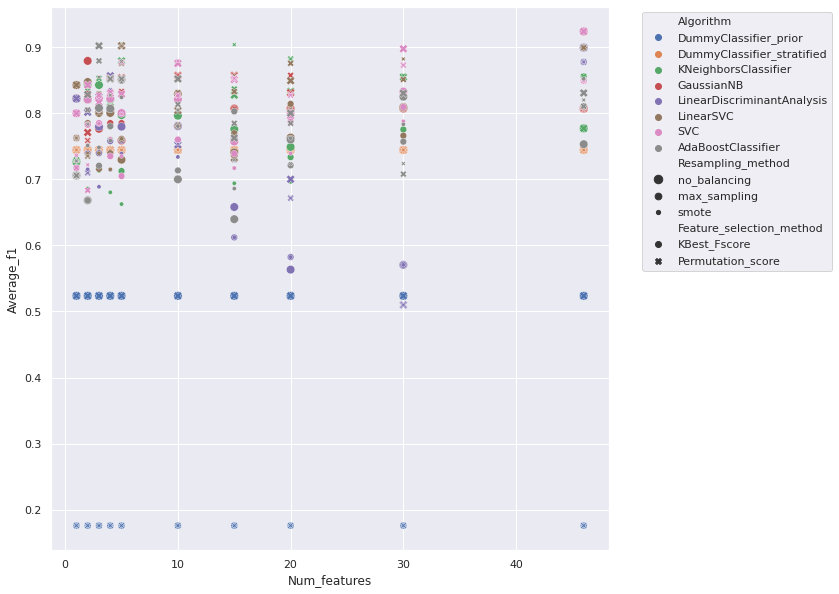

In [42]:
plt.clf()
sns.scatterplot(
    x=red_feat_score_df['Num_features'], y=red_feat_score_df['Average_f1'],
    hue=red_feat_score_df['Algorithm'], style=red_feat_score_df['Feature_selection_method'],
    size=red_feat_score_df['Resampling_method']
)
plt.legend(bbox_to_anchor=(1.05,1))
plt.savefig('{}/Number_of_features_vs_performance_scatter_plot.svg'.format(ml_2_classes.results_dir))
plt.show()

So, model performance plateaus after ~3-5 features (depending upon the algorithm).

As always, it's important to bear in mind that this is a very small dataset => small differences in model performance may be due to random error rather than being real.

In [43]:
sub_red_feat_score_df = red_feat_score_df[
      (red_feat_score_df['Num_features'] == 5)
].reset_index(drop=True)

In [44]:
sub_red_feat_score_df

,Algorithm,Resampling_method,Feature_selection_method,Num_features,Average_accuracy,Std_dev_accuracy,Average_recall,Std_dev_recall,Average_precision,Std_dev_precision,Average_f1,Std_dev_f1
0,DummyClassifier_prior,no_balancing,KBest_Fscore,5,0.658333,0.054327,0.658333,0.054327,0.435764,0.074582,0.523700,0.070392
1,DummyClassifier_prior,no_balancing,Permutation_score,5,0.658333,0.054327,0.658333,0.054327,0.435764,0.074582,0.523700,0.070392
2,DummyClassifier_prior,max_sampling,KBest_Fscore,5,0.341667,0.054327,0.341667,0.054327,0.119097,0.034122,0.176061,0.045573
3,DummyClassifier_prior,max_sampling,Permutation_score,5,0.341667,0.054327,0.341667,0.054327,0.119097,0.034122,0.176061,0.045573
4,DummyClassifier_prior,smote,KBest_Fscore,5,0.341667,0.054327,0.341667,0.054327,0.119097,0.034122,0.176061,0.045573
5,DummyClassifier_prior,smote,Permutation_score,5,0.341667,0.054327,0.341667,0.054327,0.119097,0.034122,0.176061,0.045573
6,DummyClassifier_stratified,no_balancing,KBest_Fscore,5,0.780556,0.054149,0.780556,0.054149,0.838095,0.031044,0.744414,0.065325
7,DummyClassifier_stratified,no_balancing,Permutation_score,5,0.780556,0.054149,0.780556,0.054149,0.838095,0.031044,0.744414,0.065325
8,DummyClassifier_stratified,max_sampling,KBest_Fscore,5,0.780556,0.054149,0.780556,0.054149,0.838095,0.031044,0.744414,0.065325
9,DummyClassifier_stratified,max_sampling,Permutation_score,5,0.780556,0.054149,0.780556,0.054149,0.838095,0.031044,0.744414,0.065325


Many algorithms perform similarly well - are multiple options I could take forwards to compare with the classifier trained on all features. Will select LinearSVC with no class balancing and feature selection via permutation analysis, since this is one of the best performing algorithms, plus a LinearSVC with no class balancing was selected above when looking at model training with all features.

In [45]:
red_feat_searches['LinearSVC__no_balancing__Permutation_score__5']['outer_loop_params']

[OrderedDict([('dual', False),
              ('max_iter', 10000),
              ('random_state', 1),
              ('C', 4.0)]),
 OrderedDict([('dual', False),
              ('max_iter', 10000),
              ('random_state', 1),
              ('C', 512.0)]),
 OrderedDict([('dual', False),
              ('max_iter', 10000),
              ('random_state', 1),
              ('C', 4.0)]),
 OrderedDict([('dual', False),
              ('max_iter', 10000),
              ('random_state', 1),
              ('C', 0.03125)]),
 OrderedDict([('dual', False),
              ('max_iter', 10000),
              ('random_state', 1),
              ('C', 4.0)])]

In [46]:
red_feat_searches['LinearSVC__no_balancing__Permutation_score__5']['best_outer_loop_params']

OrderedDict([('accuracy',
              OrderedDict([('dual', False),
                           ('max_iter', 10000),
                           ('random_state', 1),
                           ('C', 0.03125)])),
             ('recall',
              OrderedDict([('dual', False),
                           ('max_iter', 10000),
                           ('random_state', 1),
                           ('C', 0.03125)])),
             ('precision',
              OrderedDict([('dual', False),
                           ('max_iter', 10000),
                           ('random_state', 1),
                           ('C', 0.03125)])),
             ('f1',
              OrderedDict([('dual', False),
                           ('max_iter', 10000),
                           ('random_state', 1),
                           ('C', 0.03125)]))])

In [47]:
red_feat_nested_pred = red_feat_searches['LinearSVC__no_balancing__Permutation_score__5']['predictions']
red_feat_nested_y_true = red_feat_searches['LinearSVC__no_balancing__Permutation_score__5']['y_true']
red_feat_nested_x_true = red_feat_searches['LinearSVC__no_balancing__Permutation_score__5']['x_true']

red_feat_flat_pred = np.array([pred for pred_array in red_feat_nested_pred for pred in pred_array])
red_feat_flat_y_true = np.array([y for y_array in red_feat_nested_y_true for y in y_array])
red_feat_flat_x_true = np.array([x for x_array in red_feat_nested_x_true for x in x_array])

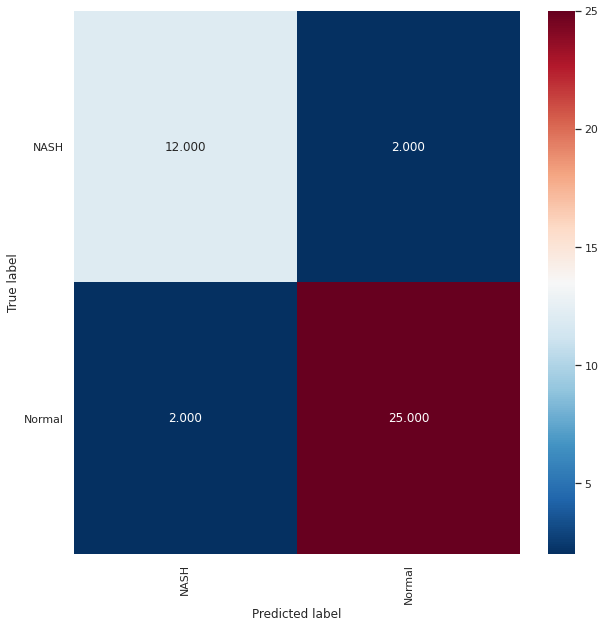

Normalised over true label (rows)


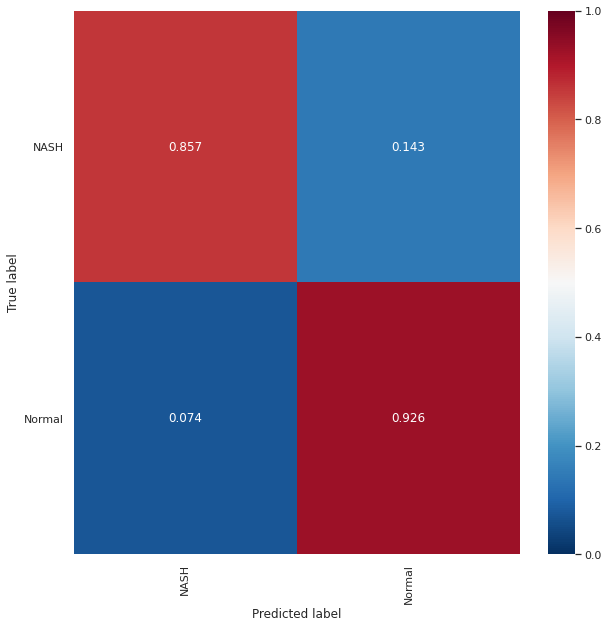

Normalised over pred label (columns)


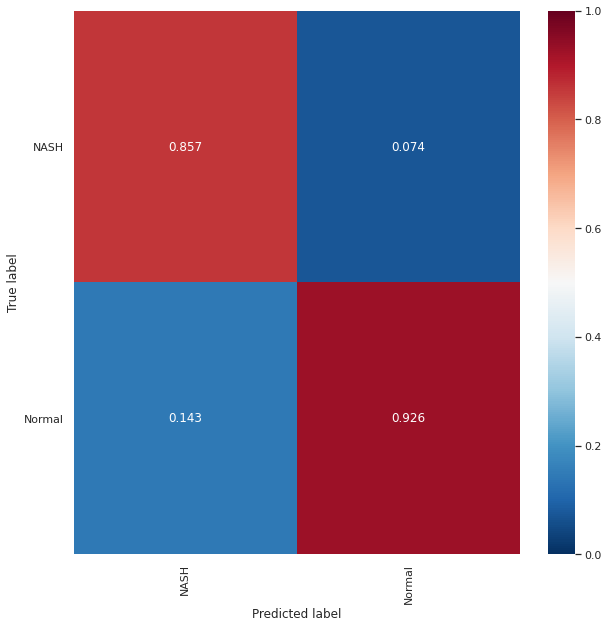

In [48]:
draw_conf_matrices(red_feat_flat_y_true, red_feat_flat_pred, ml_2_classes.results_dir, 'Red_features')

In [49]:
red_feat_true_hue = []
for index, y in enumerate(red_feat_flat_y_true):
    if red_feat_flat_pred[index] == y:
        red_feat_true_hue.append('{}_correct'.format(y))
    else:
        red_feat_true_hue.append('{}_incorrect'.format(y))

sub_red_feat_true_hue = []
sub_red_feat_flat_x_true = []
sub_red_feat_flat_y_true = []
for i, true_hue in enumerate(red_feat_true_hue):
    if true_hue.endswith('_incorrect'):
        sub_red_feat_true_hue.append(true_hue)
        sub_red_feat_flat_x_true.append(red_feat_flat_x_true[i])
        sub_red_feat_flat_y_true.append(red_feat_flat_y_true[i])

red_feat_true_hue = np.array(red_feat_true_hue)
sub_red_feat_true_hue = np.array(sub_red_feat_true_hue)
sub_red_feat_flat_x_true = np.array(sub_red_feat_flat_x_true)
sub_red_feat_flat_y_true = np.array(sub_red_feat_flat_y_true)

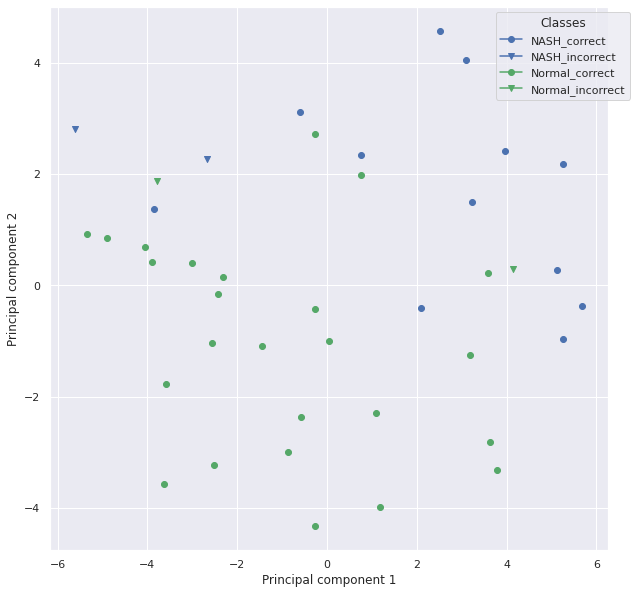

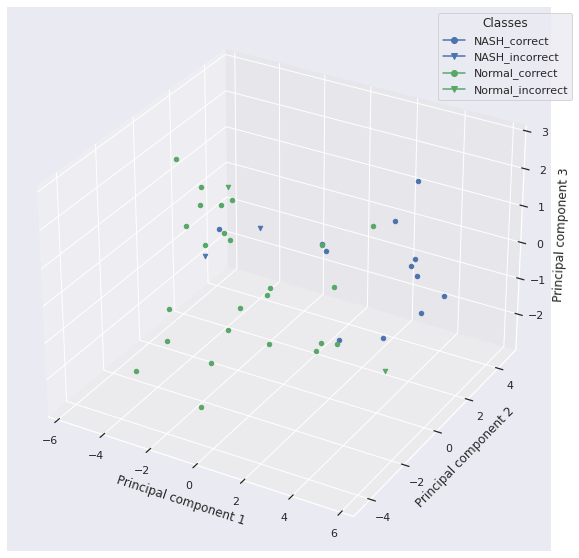

In [50]:
# Scatter plot (axes = top two principal components)
ml_2_classes.plot_scatter_on_pca_axes(
    x=red_feat_flat_x_true, y=red_feat_flat_y_true, subclasses=red_feat_true_hue, num_dimensions=2,
    scale=True, plt_name='Red_features_coloured_by_pred'
)

# Scatter plot (axes = top three principal components)
ml_2_classes.plot_scatter_on_pca_axes(
    x=red_feat_flat_x_true, y=red_feat_flat_y_true, subclasses=red_feat_true_hue, num_dimensions=3,
    scale=True, plt_name='Red_features_coloured_by_pred'
)

# Black_incorrect = Value that is actually black is predicted to be something else

So, a LinearSVC model trained with 5 peptides (selected as most important by permutation analysis) performs similarly well to a LinearSVC model trained with data from all 46 peptides (with no class balancing applied in both cases).

**Am I overestimating classifier performance by performing feature selection outside of the CV loop?**

In order to test whether the number of features in the array can be reduced, I want to select the same subset of features in every CV fold. This subset has been selected from feature importance analysis on the entire dataset. Therefore there is a danger of information "leakage" between the training and test sets, and consequent overestimation of model performance. Consequently, as a sanity check on the results above, below I perform feature selection (via KBest analysis) within the CV loop.

In [51]:
algorithms = [DummyClassifier, DummyClassifier, KNeighborsClassifier, GaussianNB, LinearDiscriminantAnalysis,
              LinearSVC, SVC, AdaBoostClassifier]
resampling_methods = ['no_balancing', 'max_sampling', 'smote']
num_features_list = [1, 2, 3, 4, 5, 10, 15, 20, 30, 46]

n_components_pca = None
run = 'gridsearch'
n_iter = None
cv_folds_inner_loop = 5
cv_folds_outer_loop = 5
train_scoring_metric = make_scorer(f1_score, average='weighted', zero_division=0)
test_scoring_funcs = {accuracy_score: {},
                      recall_score: {'average': 'weighted',
                                     'zero_division': 0},
                      precision_score: {'average': 'weighted',
                                        'zero_division': 0},
                      f1_score: {'average': 'weighted',
                                 'zero_division': 0}}

cv_imp_feat_searches = OrderedDict({})
cv_imp_feat_score_dict = OrderedDict({'Algorithm': [],
                                      'Resampling_method': [],
                                      'Num_features': [],
                                      'Average_accuracy': [],
                                      'Std_dev_accuracy': [],
                                      'Average_recall': [],
                                      'Std_dev_recall': [],
                                      'Average_precision': [],
                                      'Std_dev_precision': [],
                                      'Average_f1': [],
                                      'Std_dev_f1': []})
for index, algorithm in enumerate(algorithms):
    for resampling_method in resampling_methods:
        for num_features in num_features_list:
            if index == 0:
                fixed_params = OrderedDict({'strategy': 'prior',
                                            'random_state': 1})
                tuned_params = OrderedDict({})
            elif index == 1:
                fixed_params = OrderedDict({'strategy': 'stratified',
                                            'random_state': 1})
                tuned_params = OrderedDict({})
            else:
                fixed_params = ml_2_classes.define_fixed_model_params(classifier=algorithm())
                if algorithm.__name__ in ['LinearSVC', 'SVC', 'AdaBoostClassifier']:
                    fixed_params['random_state'] = 1
                tuned_params = ml_2_classes.define_tuned_model_params(
                    classifier=algorithm(), x_train=ml_2_classes.x, n_folds=cv_folds_inner_loop
                )

            nested_cv_search = ml_2_classes.run_nested_CV(
                clf=algorithm, x=ml_2_classes.x, y=ml_2_classes.y, groups=None,
                selected_features=num_features, inner_splits=None, outer_splits=None, const_split=True,
                resampling_method=resampling_method, n_components_pca=n_components_pca, run=run,
                fixed_params=fixed_params, tuned_params=tuned_params,
                train_scoring_metric=train_scoring_metric, test_scoring_funcs=test_scoring_funcs,
                n_iter=n_iter, cv_folds_inner_loop=cv_folds_inner_loop,
                cv_folds_outer_loop=cv_folds_outer_loop, draw_conf_mat=False, plt_name=''
            )

            if index == 0:
                cv_imp_feat_searches[
                    'DummyClassifierPrior__{}__{}'.format(resampling_method, num_features)
                ] = copy.deepcopy(nested_cv_search)
            elif index == 1:
                cv_imp_feat_searches[
                    'DummyClassifierStratified__{}__{}'.format(resampling_method, num_features)
                ] = copy.deepcopy(nested_cv_search)
            else:
                cv_imp_feat_searches[
                    '{}__{}__{}'.format(algorithm.__name__, resampling_method, num_features)
                ] = copy.deepcopy(nested_cv_search)

            if index == 0:
                cv_imp_feat_score_dict['Algorithm'].append('DummyClassifier_prior')
            elif index == 1:
                cv_imp_feat_score_dict['Algorithm'].append('DummyClassifier_stratified')
            else:
                cv_imp_feat_score_dict['Algorithm'].append(algorithm.__name__)
            cv_imp_feat_score_dict['Resampling_method'].append(resampling_method)
            cv_imp_feat_score_dict['Num_features'].append(num_features)
            cv_imp_feat_score_dict['Average_accuracy'].append(nested_cv_search['average_test_scores']['accuracy'])
            cv_imp_feat_score_dict['Std_dev_accuracy'].append(nested_cv_search['stddev_test_scores']['accuracy'])
            cv_imp_feat_score_dict['Average_recall'].append(nested_cv_search['average_test_scores']['recall'])
            cv_imp_feat_score_dict['Std_dev_recall'].append(nested_cv_search['stddev_test_scores']['recall'])
            cv_imp_feat_score_dict['Average_precision'].append(nested_cv_search['average_test_scores']['precision'])
            cv_imp_feat_score_dict['Std_dev_precision'].append(nested_cv_search['stddev_test_scores']['precision'])
            cv_imp_feat_score_dict['Average_f1'].append(nested_cv_search['average_test_scores']['f1'])
            cv_imp_feat_score_dict['Std_dev_f1'].append(nested_cv_search['stddev_test_scores']['f1'])

            # Print output of nested CV
            for n, params in enumerate(nested_cv_search['outer_loop_params']):
                print('\n\n\n')
                print('{}: {},  {}'.format(algorithm.__name__, resampling_method, num_features))
                print('Parameters: {}'.format(params))
                print('Accuracy: {}'.format(nested_cv_search['test_scores']['accuracy'][n]))
                print('F1: {}'.format(nested_cv_search['test_scores']['f1'][n]))





DummyClassifier: no_balancing,  1
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.6666666666666666
F1: 0.5333333333333334




DummyClassifier: no_balancing,  1
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.625
F1: 0.4807692307692308




DummyClassifier: no_balancing,  1
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.625
F1: 0.4807692307692308




DummyClassifier: no_balancing,  1
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.625
F1: 0.4807692307692308




DummyClassifier: no_balancing,  1
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.6428571428571428




DummyClassifier: no_balancing,  2
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.6666666666666666
F1: 0.5333333333333334




DummyClassifier: no_balancing,  2
Parameters: OrderedDict([('strategy', 'prior'), ('rando





DummyClassifier: max_sampling,  2
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.3333333333333333
F1: 0.16666666666666666




DummyClassifier: max_sampling,  2
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.375
F1: 0.20454545454545453




DummyClassifier: max_sampling,  2
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.375
F1: 0.20454545454545453




DummyClassifier: max_sampling,  2
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.375
F1: 0.20454545454545453




DummyClassifier: max_sampling,  2
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.25
F1: 0.1




DummyClassifier: max_sampling,  3
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.3333333333333333
F1: 0.16666666666666666




DummyClassifier: max_sampling,  3
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 





DummyClassifier: smote,  4
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.3333333333333333
F1: 0.16666666666666666




DummyClassifier: smote,  4
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.375
F1: 0.20454545454545453




DummyClassifier: smote,  4
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.375
F1: 0.20454545454545453




DummyClassifier: smote,  4
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.375
F1: 0.20454545454545453




DummyClassifier: smote,  4
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.25
F1: 0.1




DummyClassifier: smote,  5
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.3333333333333333
F1: 0.16666666666666666




DummyClassifier: smote,  5
Parameters: OrderedDict([('strategy', 'prior'), ('random_state', 1)])
Accuracy: 0.375
F1: 0.20454545454545453










DummyClassifier: no_balancing,  10
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.7777777777777778
F1: 0.738095238095238




DummyClassifier: no_balancing,  10
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.7083333333333333




DummyClassifier: no_balancing,  10
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.7083333333333333




DummyClassifier: no_balancing,  10
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.7083333333333333




DummyClassifier: no_balancing,  10
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.875
F1: 0.8589743589743589




DummyClassifier: no_balancing,  15
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.7777777777777778
F1: 0.738095238095238




DummyClassifier: no_balancing,  15
Parameters: OrderedDic





DummyClassifier: max_sampling,  15
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.7777777777777778
F1: 0.738095238095238




DummyClassifier: max_sampling,  15
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.7083333333333333




DummyClassifier: max_sampling,  15
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.7083333333333333




DummyClassifier: max_sampling,  15
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.7083333333333333




DummyClassifier: max_sampling,  15
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.875
F1: 0.8589743589743589




DummyClassifier: max_sampling,  20
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.7777777777777778
F1: 0.738095238095238




DummyClassifier: max_sampling,  20
Parameters: OrderedDic





DummyClassifier: smote,  20
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.7777777777777778
F1: 0.738095238095238




DummyClassifier: smote,  20
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.7083333333333333




DummyClassifier: smote,  20
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.7083333333333333




DummyClassifier: smote,  20
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.75
F1: 0.7083333333333333




DummyClassifier: smote,  20
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.875
F1: 0.8589743589743589




DummyClassifier: smote,  30
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1)])
Accuracy: 0.7777777777777778
F1: 0.738095238095238




DummyClassifier: smote,  30
Parameters: OrderedDict([('strategy', 'stratified'), ('random_state', 1





KNeighborsClassifier: no_balancing,  15
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 4), ('p', 1), ('weights', 'distance')])
Accuracy: 0.6666666666666666
F1: 0.6753246753246753




KNeighborsClassifier: no_balancing,  15
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 7), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.875
F1: 0.8681818181818182




KNeighborsClassifier: no_balancing,  15
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 5), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.75
F1: 0.7083333333333333




KNeighborsClassifier: no_balancing,  15
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 7), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.875
F1: 0.876984126984127




KNeighborsClassifier: no_balancing,  15
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 6), ('p', 2), ('weights', 'uniform')])
Accurac





KNeighborsClassifier: max_sampling,  10
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 2), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.5555555555555556
F1: 0.5666666666666667




KNeighborsClassifier: max_sampling,  10
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 7), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.875
F1: 0.8681818181818182




KNeighborsClassifier: max_sampling,  10
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 2), ('p', 2), ('weights', 'distance')])
Accuracy: 0.75
F1: 0.7083333333333333




KNeighborsClassifier: max_sampling,  10
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 2), ('p', 2), ('weights', 'distance')])
Accuracy: 1.0
F1: 1.0




KNeighborsClassifier: max_sampling,  10
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 5), ('p', 2), ('weights', 'distance')])
Accuracy: 0.625
F1: 0





KNeighborsClassifier: smote,  5
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 7), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.5555555555555556
F1: 0.5666666666666667




KNeighborsClassifier: smote,  5
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 6), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.875
F1: 0.8681818181818182




KNeighborsClassifier: smote,  5
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 2), ('p', 2), ('weights', 'distance')])
Accuracy: 0.75
F1: 0.7083333333333333




KNeighborsClassifier: smote,  5
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 5), ('p', 1), ('weights', 'distance')])
Accuracy: 1.0
F1: 1.0




KNeighborsClassifier: smote,  5
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 2), ('p', 1), ('weights', 'distance')])
Accuracy: 1.0
F1: 1.0




KNeighborsClassifier: smote,  10
Pa





GaussianNB: no_balancing,  10
Parameters: OrderedDict()
Accuracy: 0.7777777777777778
F1: 0.7777777777777778




GaussianNB: no_balancing,  10
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.8681818181818182




GaussianNB: no_balancing,  10
Parameters: OrderedDict()
Accuracy: 0.625
F1: 0.6309523809523809




GaussianNB: no_balancing,  10
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.876984126984127




GaussianNB: no_balancing,  10
Parameters: OrderedDict()
Accuracy: 0.75
F1: 0.75




GaussianNB: no_balancing,  15
Parameters: OrderedDict()
Accuracy: 0.7777777777777778
F1: 0.7777777777777778




GaussianNB: no_balancing,  15
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.8681818181818182




GaussianNB: no_balancing,  15
Parameters: OrderedDict()
Accuracy: 0.625
F1: 0.6309523809523809




GaussianNB: no_balancing,  15
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.876984126984127




GaussianNB: no_balancing,  15
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.8818181818181818







GaussianNB: smote,  3
Parameters: OrderedDict()
Accuracy: 0.6666666666666666
F1: 0.6753246753246753




GaussianNB: smote,  3
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.8681818181818182




GaussianNB: smote,  3
Parameters: OrderedDict()
Accuracy: 0.625
F1: 0.6309523809523809




GaussianNB: smote,  3
Parameters: OrderedDict()
Accuracy: 0.75
F1: 0.7499999999999999




GaussianNB: smote,  3
Parameters: OrderedDict()
Accuracy: 0.75
F1: 0.75




GaussianNB: smote,  4
Parameters: OrderedDict()
Accuracy: 0.6666666666666666
F1: 0.6753246753246753




GaussianNB: smote,  4
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.8681818181818182




GaussianNB: smote,  4
Parameters: OrderedDict()
Accuracy: 0.625
F1: 0.6309523809523809




GaussianNB: smote,  4
Parameters: OrderedDict()
Accuracy: 0.75
F1: 0.7499999999999999




GaussianNB: smote,  4
Parameters: OrderedDict()
Accuracy: 0.75
F1: 0.75




GaussianNB: smote,  5
Parameters: OrderedDict()
Accuracy: 0.7777777777777778
F1: 0.777777777





LinearDiscriminantAnalysis: no_balancing,  30
Parameters: OrderedDict()
Accuracy: 0.2222222222222222
F1: 0.2424242424242424




LinearDiscriminantAnalysis: no_balancing,  30
Parameters: OrderedDict()
Accuracy: 0.5
F1: 0.5




LinearDiscriminantAnalysis: no_balancing,  30
Parameters: OrderedDict()
Accuracy: 0.625
F1: 0.6309523809523809




LinearDiscriminantAnalysis: no_balancing,  30
Parameters: OrderedDict()
Accuracy: 0.375
F1: 0.38492063492063494




LinearDiscriminantAnalysis: no_balancing,  30
Parameters: OrderedDict()
Accuracy: 0.625
F1: 0.6454545454545454




LinearDiscriminantAnalysis: no_balancing,  46
Parameters: OrderedDict()
Accuracy: 0.8888888888888888
F1: 0.8917748917748918




LinearDiscriminantAnalysis: no_balancing,  46
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.8681818181818182




LinearDiscriminantAnalysis: no_balancing,  46
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.8681818181818182




LinearDiscriminantAnalysis: no_balancing,  46
Parameters: OrderedD





LinearDiscriminantAnalysis: smote,  4
Parameters: OrderedDict()
Accuracy: 0.5555555555555556
F1: 0.5666666666666667




LinearDiscriminantAnalysis: smote,  4
Parameters: OrderedDict()
Accuracy: 1.0
F1: 1.0




LinearDiscriminantAnalysis: smote,  4
Parameters: OrderedDict()
Accuracy: 0.5
F1: 0.5




LinearDiscriminantAnalysis: smote,  4
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.876984126984127




LinearDiscriminantAnalysis: smote,  4
Parameters: OrderedDict()
Accuracy: 0.75
F1: 0.75




LinearDiscriminantAnalysis: smote,  5
Parameters: OrderedDict()
Accuracy: 0.6666666666666666
F1: 0.6753246753246753




LinearDiscriminantAnalysis: smote,  5
Parameters: OrderedDict()
Accuracy: 1.0
F1: 1.0




LinearDiscriminantAnalysis: smote,  5
Parameters: OrderedDict()
Accuracy: 0.75
F1: 0.7500000000000001




LinearDiscriminantAnalysis: smote,  5
Parameters: OrderedDict()
Accuracy: 0.75
F1: 0.7500000000000001




LinearDiscriminantAnalysis: smote,  5
Parameters: OrderedDict()
Accuracy: 0.

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: no_balancing,  4
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 4.0)])
Accuracy: 0.7777777777777778
F1: 0.7777777777777778




LinearSVC: no_balancing,  4
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 16.0)])
Accuracy: 1.0
F1: 1.0




LinearSVC: no_balancing,  4
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.75
F1: 0.7083333333333333




LinearSVC: no_balancing,  4
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 2.0)

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: max_sampling,  1
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.125)])
Accuracy: 0.4444444444444444
F1: 0.4444444444444444




LinearSVC: max_sampling,  1
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.875
F1: 0.8681818181818182




LinearSVC: max_sampling,  1
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.5
F1: 0.5




LinearSVC: max_sampling,  1
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C'

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: max_sampling,  15
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 512.0)])
Accuracy: 0.4444444444444444
F1: 0.4588744588744588




LinearSVC: max_sampling,  15
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 1.0
F1: 1.0




LinearSVC: max_sampling,  15
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: smote,  3
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 4.0)])
Accuracy: 0.5555555555555556
F1: 0.5333333333333333




LinearSVC: smote,  3
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 1.0
F1: 1.0




LinearSVC: smote,  3
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.0625)])
Accuracy: 0.625
F1: 0.6309523809523809




LinearSVC: smote,  3
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 16.0)])
Accuracy: 1.0
F1: 1.0

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: smote,  30
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.25)])
Accuracy: 0.7777777777777778
F1: 0.7833333333333334




LinearSVC: smote,  30
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 64.0)])
Accuracy: 1.0
F1: 1.0




LinearSVC: smote,  30
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.125)])
Accuracy: 0.75
F1: 0.7500000000000001




LinearSVC: smote,  30
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.875
F1: 0.876984126984127




LinearSVC: smote,  30
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 64.0)])
Accuracy: 0.875
F1: 0.8589743589743589








SVC: no_balancing,  30
Parameters: OrderedDict([('random_state', 1), ('C', 256.0), ('gamma', 0.0009765625), ('kernel', 'rbf')])
Accuracy: 0.6666666666666666
F1: 0.6753246753246753




SVC: no_balancing,  30
Parameters: OrderedDict([('random_state', 1), ('C', 64.0), ('gamma', 0.00390625), ('kernel', 'rbf')])
Accuracy: 1.0
F1: 1.0




SVC: no_balancing,  30
Parameters: OrderedDict([('random_state', 1), ('C', 2.0), ('gamma', 0.03125), ('kernel', 'rbf')])
Accuracy: 0.75
F1: 0.7500000000000001




SVC: no_balancing,  30
Parameters: OrderedDict([('random_state', 1), ('C', 2.0), ('gamma', 0.0625), ('kernel', 'rbf')])
Accuracy: 0.875
F1: 0.876984126984127




SVC: no_balancing,  30
Parameters: OrderedDict([('random_state', 1), ('C', 32.0), ('gamma', 0.0078125), ('kernel', 'rbf')])
Accuracy: 0.875
F1: 0.8589743589743589




SVC: no_balancing,  46
Parameters: OrderedDict([('random_state', 1), ('C', 64.0), ('gamma', 0.001953125), ('kernel', 'rbf')])
Accuracy: 0.8888888888888888
F1: 0.89177489





SVC: max_sampling,  5
Parameters: OrderedDict([('random_state', 1), ('C', 2048.0), ('gamma', 0.0009765625), ('kernel', 'rbf')])
Accuracy: 0.5555555555555556
F1: 0.5666666666666667




SVC: max_sampling,  5
Parameters: OrderedDict([('random_state', 1), ('C', 16.0), ('gamma', 0.25), ('kernel', 'rbf')])
Accuracy: 0.875
F1: 0.8681818181818182




SVC: max_sampling,  5
Parameters: OrderedDict([('random_state', 1), ('C', 2.0), ('gamma', 0.015625), ('kernel', 'rbf')])
Accuracy: 0.5
F1: 0.5




SVC: max_sampling,  5
Parameters: OrderedDict([('random_state', 1), ('C', 128.0), ('gamma', 0.0625), ('kernel', 'rbf')])
Accuracy: 0.75
F1: 0.7500000000000001




SVC: max_sampling,  5
Parameters: OrderedDict([('random_state', 1), ('C', 16.0), ('gamma', 0.00390625), ('kernel', 'rbf')])
Accuracy: 0.875
F1: 0.8818181818181818




SVC: max_sampling,  10
Parameters: OrderedDict([('random_state', 1), ('C', 128.0), ('gamma', 0.00390625), ('kernel', 'rbf')])
Accuracy: 0.4444444444444444
F1: 0.4588744588744

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [3.0517578125e-05, 6.103515625e-05, 0.0001220703125, 0.000244140625, 0.00048828125, 0.0009765625, 0.001953125, 0.00390625, 0.0078125, 0.015625, 0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0]
Value selected: 3.0517578125e-05






SVC: smote,  2
Parameters: OrderedDict([('random_state', 1), ('C', 0.03125), ('gamma', 0.03125), ('kernel', 'rbf')])
Accuracy: 0.6666666666666666
F1: 0.6753246753246753




SVC: smote,  2
Parameters: OrderedDict([('random_state', 1), ('C', 0.03125), ('gamma', 3.0517578125e-05), ('kernel', 'rbf')])
Accuracy: 0.875
F1: 0.8681818181818182




SVC: smote,  2
Parameters: OrderedDict([('random_state', 1), ('C', 0.25), ('gamma', 0.125), ('kernel', 'rbf')])
Accuracy: 0.625
F1: 0.6045454545454545




SVC: smote,  2
Parameters: OrderedDict([('random_state', 1), ('C',

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






SVC: smote,  15
Parameters: OrderedDict([('random_state', 1), ('C', 8192.0), ('gamma', 0.000244140625), ('kernel', 'rbf')])
Accuracy: 0.4444444444444444
F1: 0.4588744588744588




SVC: smote,  15
Parameters: OrderedDict([('random_state', 1), ('C', 128.0), ('gamma', 0.015625), ('kernel', 'rbf')])
Accuracy: 0.875
F1: 0.8681818181818182




SVC: smote,  15
Parameters: OrderedDict([('random_state', 1), ('C', 0.03125), ('gamma', 0.0625), ('kernel', 'rbf')])
Accuracy: 0.625
F1: 0.6309523809523809




SVC: smote,  15
Parameters: OrderedDict([('random_state', 1), ('C', 2.0), ('gamma', 0.0625), ('kernel', 'rbf')])
Accuracy: 0.875
F1: 0.876984126984127




SVC: smote,  15
Parameters: OrderedDict([('random_state', 1), ('C', 8.0), ('gamma', 0.125), ('kernel', 'rbf')])
Accuracy: 0.75
F1: 0.75




SVC: smote,  20






AdaBoostClassifier: no_balancing,  20
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 100)])
Accuracy: 0.6666666666666666
F1: 0.6666666666666666




AdaBoostClassifier: no_balancing,  20
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.5
F1: 0.5




AdaBoostClassifier: no_balancing,  20
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 100)])
Accuracy: 0.75
F1: 0.7083333333333333




AdaBoostClassifier: no_balancing,  20
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 316)])
Accuracy: 0.75
F1: 0.7500000000000001




AdaBoostClassifier: no_balancing,  20
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 100)])
Accuracy: 0.75
F1: 0.75




AdaBoostClassifier: no_balancing,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 0.6666666666666666
F1: 0.6461538461538461




AdaBoostClassifier: no_balancing,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators',





AdaBoostClassifier: max_sampling,  46
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 0.5555555555555556
F1: 0.5666666666666667




AdaBoostClassifier: max_sampling,  46
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.625
F1: 0.4807692307692308




AdaBoostClassifier: max_sampling,  46
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 0.75
F1: 0.7500000000000001




AdaBoostClassifier: max_sampling,  46
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 100)])
Accuracy: 1.0
F1: 1.0




AdaBoostClassifier: max_sampling,  46
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 100)])
Accuracy: 0.75
F1: 0.75




AdaBoostClassifier: smote,  1
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.6666666666666666
F1: 0.6666666666666666




AdaBoostClassifier: smote,  1
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 

In [52]:
cv_imp_feat_score_df = pd.DataFrame(cv_imp_feat_score_dict)

In [53]:
cv_imp_feat_score_df

,Algorithm,Resampling_method,Num_features,Average_accuracy,Std_dev_accuracy,Average_recall,Std_dev_recall,Average_precision,Std_dev_precision,Average_f1,Std_dev_f1
0,DummyClassifier_prior,no_balancing,1,0.658333,0.054327,0.658333,0.054327,0.435764,0.074582,0.523700,0.070392
1,DummyClassifier_prior,no_balancing,2,0.658333,0.054327,0.658333,0.054327,0.435764,0.074582,0.523700,0.070392
2,DummyClassifier_prior,no_balancing,3,0.658333,0.054327,0.658333,0.054327,0.435764,0.074582,0.523700,0.070392
3,DummyClassifier_prior,no_balancing,4,0.658333,0.054327,0.658333,0.054327,0.435764,0.074582,0.523700,0.070392
4,DummyClassifier_prior,no_balancing,5,0.658333,0.054327,0.658333,0.054327,0.435764,0.074582,0.523700,0.070392
...,...,...,...,...,...,...,...,...,...,...,...
235,AdaBoostClassifier,smote,10,0.711111,0.176066,0.711111,0.176066,0.749821,0.151694,0.710525,0.170529
236,AdaBoostClassifier,smote,15,0.613889,0.187988,0.613889,0.187988,0.634167,0.159437,0.610823,0.194766
237,AdaBoostClassifier,smote,20,0.633333,0.154223,0.633333,0.154223,0.690833,0.151279,0.631472,0.166929
238,AdaBoostClassifier,smote,30,0.755556,0.089257,0.755556,0.089257,0.755556,0.103865,0.750101,0.094731


In [54]:
with open('{}/CV_importance_features_CV_search_models.pkl'.format(ml_2_classes.results_dir), 'wb') as f:
    pickle.dump((cv_imp_feat_searches, cv_imp_feat_score_df), f)

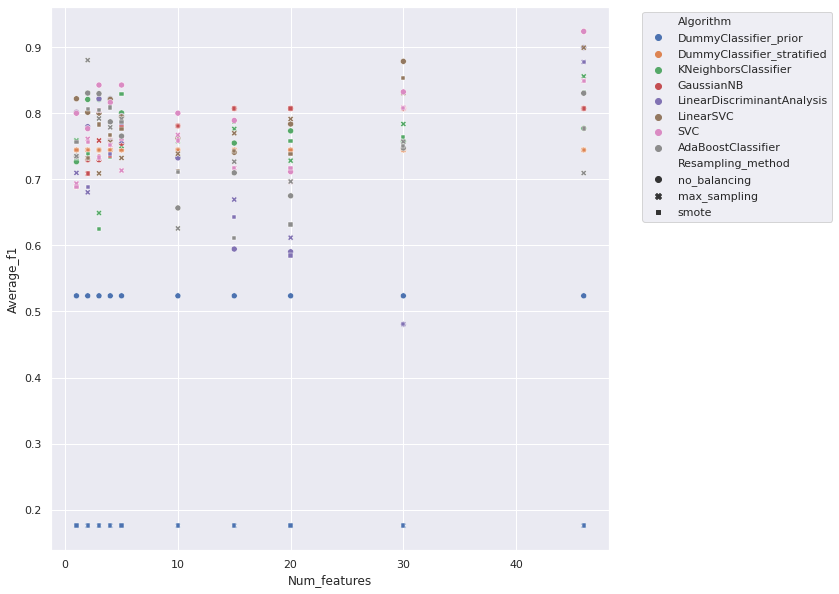

In [55]:
plt.clf()
sns.scatterplot(
    x=cv_imp_feat_score_df['Num_features'], y=cv_imp_feat_score_df['Average_f1'],
    hue=cv_imp_feat_score_df['Algorithm'], style=cv_imp_feat_score_df['Resampling_method']
)
plt.legend(bbox_to_anchor=(1.05,1))
plt.savefig('{}/CV_importance_feature_number_vs_performance_scatter_plot.svg'.format(ml_2_classes.results_dir))
plt.show()

So, the results obtained when feature selection is performed within the CV loop look broadly similarly to those obtained when feature selection is performed on the entire dataset. However, in the case of some of the algorithms model performance continues to increase slightly as more features are introduced as opposed to reaching a plateau after a small number of features (as was observed when feature selection was performed on the entire dataset), moreover the F1 score achieved with a smaller number of features is lower in this case => indicates that performing feature selection on the entire dataset as opposed to within the CV loop may be introducing some optimistic bias into my assessment of model performance using the former method. However, as mentioned above it is important to remember that the dataset is small, and hence the random error associated with these metric values will be large => small differences may well be caused by random error.

**Is there a significant difference in model performance when reduce the number of features?**

In [56]:
params_1 = all_feat_searches['LinearSVC__no_balancing']['best_outer_loop_params']['f1']
selected_features_1 = list(ml_2_classes.features)
params_2 = red_feat_searches['LinearSVC__no_balancing__Permutation_score__5']['best_outer_loop_params']['f1']
selected_features_2 = mean_permut_feat_importances_df['Feature'].tolist()[:5]

print('Model 1:')
print('Algorithm: LinearSVC')
print('Parameters:\n{}'.format(params_1))
print('Features:\n{}'.format(selected_features_1))
print('\n\n\n')
print('Model 2:')
print('Algorithm: LinearSVC')
print('Parameters:\n{}'.format(params_2))
print('Features:\n{}'.format(selected_features_2))

F, p = ml_2_classes.run_5x2_CV_combined_F_test(
    x=ml_2_classes.x, y=ml_2_classes.y, selected_features_1=selected_features_1,
    selected_features_2=selected_features_2, classifier_1=LinearSVC, classifier_2=LinearSVC,
    params_1=params_1, params_2=params_2, resampling_method_1='no_balancing', resampling_method_2='no_balancing',
    n_components_pca_1=None, n_components_pca_2=None
)

Model 1:
Algorithm: LinearSVC
Parameters:
OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.25)])
Features:
['DPH_GRP46', 'DPH_GRP51', 'DPH_CCHept', 'DPH_CCHept-L14A', 'DPH_CCHept-I17A-L21A', 'DPH_CCHept-I17G-L21G', 'DPH_CCHept-I24A', 'DPH_CCHept-I24P', 'DPH_GRP80', 'DPH_GRP63', 'DPH_GRP52', 'DPH_CCHex', 'DPH_CCPent', 'DPH_NLKEIA', 'DPH_QLKEIA', 'DPH_CCHex2', 'DPH_GRP22', 'DPH_CCHept-I17H', 'DPH_CCHept-I17T', 'DPH_CCHept-L21H-I24H', 'DPH_CCHept-L21N-I24N', 'DPH_CCHept-L21S-I24S', 'DPH_CCHept-L21T-I24T', 'DPH_CCHept-I24H', 'DPH_CCHept-I24N', 'DPH_CCHept-I24S', 'DPH_CCHept-I24T', 'DPH_CCHept-L7K', 'DPH_CCHept-I17K', 'DPH_CCHept-I17K-I24E', 'DPH_CCHept-L21E-I24K', 'DPH_CCHept-L21K', 'DPH_CCHept-L21K-I24E', 'DPH_CCHept-I24D', 'DPH_CCHept-I24E', 'DPH_CCHept-I24K', 'DPH_CCHept-L28K', 'DPH_CCPent-I24K', 'DPH_CCHex2-I24K', 'DPH_CCHept-L7W', 'DPH_CCHept-L7Y', 'DPH_CCHept-L21S-I24Y', 'DPH_CCHept-L21Y-I24S', 'DPH_CCHept-I24Y', 'DPH_CCHept-L28W', 'DPH_CCHept-L28Y']




In [57]:
print('F score: {}'.format(F))
print('p value: {}'.format(p))

F score: 1.1641993176090106
p value: 0.4600256669389534


So, there is no significant difference in performance when reduce the number of peptides from 46 to 5.

**Is there a significant difference between the best performing model and a random classifier?**

Dummy classifier - prior

In [58]:
params_1 = all_feat_searches['LinearSVC__no_balancing']['best_outer_loop_params']['f1']
selected_features_1 = list(ml_2_classes.features)
params_2 = all_feat_searches['DummyClassifierPrior__no_balancing']['best_outer_loop_params']['f1']
selected_features_2 = list(ml_2_classes.features)

print('Model 1:')
print('Algorithm: LinearSVC')
print('Parameters:\n{}'.format(params_1))
print('Features:\n{}'.format(selected_features_1))
print('\n\n\n')
print('Model 2:')
print('Algorithm: DummyClassifierPrior')
print('Parameters:\n{}'.format(params_2))
print('Features:\n{}'.format(selected_features_2))

F, p = ml_2_classes.run_5x2_CV_combined_F_test(
    x=ml_2_classes.x, y=ml_2_classes.y, selected_features_1=selected_features_1,
    selected_features_2=selected_features_2, classifier_1=LinearSVC, classifier_2=DummyClassifier,
    params_1=params_1, params_2=params_2, resampling_method_1='no_balancing', resampling_method_2='no_balancing',
    n_components_pca_1=None, n_components_pca_2=None
)

Model 1:
Algorithm: LinearSVC
Parameters:
OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.25)])
Features:
['DPH_GRP46', 'DPH_GRP51', 'DPH_CCHept', 'DPH_CCHept-L14A', 'DPH_CCHept-I17A-L21A', 'DPH_CCHept-I17G-L21G', 'DPH_CCHept-I24A', 'DPH_CCHept-I24P', 'DPH_GRP80', 'DPH_GRP63', 'DPH_GRP52', 'DPH_CCHex', 'DPH_CCPent', 'DPH_NLKEIA', 'DPH_QLKEIA', 'DPH_CCHex2', 'DPH_GRP22', 'DPH_CCHept-I17H', 'DPH_CCHept-I17T', 'DPH_CCHept-L21H-I24H', 'DPH_CCHept-L21N-I24N', 'DPH_CCHept-L21S-I24S', 'DPH_CCHept-L21T-I24T', 'DPH_CCHept-I24H', 'DPH_CCHept-I24N', 'DPH_CCHept-I24S', 'DPH_CCHept-I24T', 'DPH_CCHept-L7K', 'DPH_CCHept-I17K', 'DPH_CCHept-I17K-I24E', 'DPH_CCHept-L21E-I24K', 'DPH_CCHept-L21K', 'DPH_CCHept-L21K-I24E', 'DPH_CCHept-I24D', 'DPH_CCHept-I24E', 'DPH_CCHept-I24K', 'DPH_CCHept-L28K', 'DPH_CCPent-I24K', 'DPH_CCHex2-I24K', 'DPH_CCHept-L7W', 'DPH_CCHept-L7Y', 'DPH_CCHept-L21S-I24Y', 'DPH_CCHept-L21Y-I24S', 'DPH_CCHept-I24Y', 'DPH_CCHept-L28W', 'DPH_CCHept-L28Y']




In [59]:
print('F score: {}'.format(F))
print('p value: {}'.format(p))

F score: 17.70673578680897
p value: 0.002709368290098121


Dummy classifier - stratified

In [64]:
params_1 = all_feat_searches['LinearSVC__no_balancing']['best_outer_loop_params']['f1']
selected_features_1 = list(ml_2_classes.features)
params_2 = all_feat_searches['DummyClassifierStratified__no_balancing']['best_outer_loop_params']['f1']
selected_features_2 = list(ml_2_classes.features)

print('Model 1:')
print('Algorithm: LinearSVC')
print('Parameters:\n{}'.format(params_1))
print('Features:\n{}'.format(selected_features_1))
print('\n\n\n')
print('Model 2:')
print('Algorithm: DummyClassifierStratified')
print('Parameters:\n{}'.format(params_2))
print('Features:\n{}'.format(selected_features_2))

F, p = ml_2_classes.run_5x2_CV_combined_F_test(
    x=ml_2_classes.x, y=ml_2_classes.y, selected_features_1=selected_features_1,
    selected_features_2=selected_features_2, classifier_1=LinearSVC, classifier_2=DummyClassifier,
    params_1=params_1, params_2=params_2, resampling_method_1='no_balancing', resampling_method_2='no_balancing',
    n_components_pca_1=None, n_components_pca_2=None
)

Model 1:
Algorithm: LinearSVC
Parameters:
OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.25)])
Features:
['DPH_GRP46', 'DPH_GRP51', 'DPH_CCHept', 'DPH_CCHept-L14A', 'DPH_CCHept-I17A-L21A', 'DPH_CCHept-I17G-L21G', 'DPH_CCHept-I24A', 'DPH_CCHept-I24P', 'DPH_GRP80', 'DPH_GRP63', 'DPH_GRP52', 'DPH_CCHex', 'DPH_CCPent', 'DPH_NLKEIA', 'DPH_QLKEIA', 'DPH_CCHex2', 'DPH_GRP22', 'DPH_CCHept-I17H', 'DPH_CCHept-I17T', 'DPH_CCHept-L21H-I24H', 'DPH_CCHept-L21N-I24N', 'DPH_CCHept-L21S-I24S', 'DPH_CCHept-L21T-I24T', 'DPH_CCHept-I24H', 'DPH_CCHept-I24N', 'DPH_CCHept-I24S', 'DPH_CCHept-I24T', 'DPH_CCHept-L7K', 'DPH_CCHept-I17K', 'DPH_CCHept-I17K-I24E', 'DPH_CCHept-L21E-I24K', 'DPH_CCHept-L21K', 'DPH_CCHept-L21K-I24E', 'DPH_CCHept-I24D', 'DPH_CCHept-I24E', 'DPH_CCHept-I24K', 'DPH_CCHept-L28K', 'DPH_CCPent-I24K', 'DPH_CCHex2-I24K', 'DPH_CCHept-L7W', 'DPH_CCHept-L7Y', 'DPH_CCHept-L21S-I24Y', 'DPH_CCHept-L21Y-I24S', 'DPH_CCHept-I24Y', 'DPH_CCHept-L28W', 'DPH_CCHept-L28Y']




In [65]:
print('F score: {}'.format(F))
print('p value: {}'.format(p))

F score: 5.42346112232066
p value: 0.037954476153201015


So, (despite the relatively high performance of the random classifiers due to the small, imbalanced dataset) the trained model performs significantly better than a random classifier (both with predictions all set to the most frequent class (prior) and set to the true class labels randomly scrambled (stratified)).